In [1]:
#pip install fredapi

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.ticker import FuncFormatter
import requests
from bs4 import BeautifulSoup
import re
import time
from requests.adapters import HTTPAdapter
from requests.packages.urllib3.util.retry import Retry
from fredapi import Fred
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split
from statsmodels.nonparametric.smoothers_lowess import lowess
from sklearn.impute import SimpleImputer
import xgboost as xgb

# Load and clean Data

## Load 2024 Turkish scraped Used Card data (df_2024)

In [3]:
# Define the filename of your CSV file
csv_file = '2024_turkey_car_market.csv'  # Use the actual filename if different

# Load the data from the CSV file into a new DataFrame
df_2024 = pd.read_csv(csv_file)

######### Translate df_2024 column headers

# Create a dictionary with the old column names as keys and the new column names as values
column_rename_dict = {
    'İlan Tarihi': 'Ad Date',
    'Marka': 'Make',
    'Seri': 'Model',
    'Model': 'Package',
    'Yıl': 'Year',
    'Kilometre': 'Kilometers (km)',
    'Vites Tipi': 'Transmission',
    'Yakıt Tipi': 'Fuel Type',
    'Kasa Tipi': 'Body Type',
    'Renk': 'Color',
    'Motor Hacmi': 'Engine Size (cc)',
    'Motor Gücü': 'Engine Power (hp)',
    'Araç Durumu': 'Vehicle Condition',
    'Ort. Yakıt Tüketimi': 'Avg. Fuel Consumption (L/100km)',
    'Yakıt Deposu': 'Fuel Tank Size (L)',
    'Boya-değişen': 'Paint-changed',
    'Takasa Uygun': 'Willing to Exchange',
    'Kimden': 'From',
    'Fiyat': 'Price (Turkish Liras)',
    'Link': 'Link',
    'İlan No': 'Ad Number',
    'Page': 'Page',
    'Çekiş': 'Traction'
}

# Rename the columns using the rename method
df_2024.rename(columns=column_rename_dict, inplace=True)

# Add "Scraped Date"
df_2024['Scraped Date'] = pd.to_datetime('2024-05-26')

# Dictionary to map Turkish month names to their English equivalents
month_translation = {
    'Ocak': 'January',
    'Şubat': 'February',
    'Mart': 'March',
    'Nisan': 'April',
    'Mayıs': 'May',
    'Haziran': 'June',
    'Temmuz': 'July',
    'Ağustos': 'August',
    'Eylül': 'September',
    'Ekim': 'October',
    'Kasım': 'November',
    'Aralık': 'December'
}

# Function to replace Turkish month names with English month names
def translate_month(date_str):
    for turkish_month, english_month in month_translation.items():
        date_str = date_str.replace(turkish_month, english_month)
    return date_str

# Apply the translation function to the 'Ad Date' column
df_2024['Ad Date'] = df_2024['Ad Date'].apply(translate_month)

# Convert the 'Ad Date' column to datetime again after translation
df_2024['Ad Date'] = pd.to_datetime(df_2024['Ad Date'], errors='coerce')

# Check the result
print(df_2024.columns)

Index(['Ad Date', 'Make', 'Model', 'Package', 'Year', 'Kilometers (km)',
       'Transmission', 'Fuel Type', 'Body Type', 'Color', 'Engine Size (cc)',
       'Engine Power (hp)', 'Vehicle Condition',
       'Avg. Fuel Consumption (L/100km)', 'Fuel Tank Size (L)',
       'Paint-changed', 'Willing to Exchange', 'From', 'Price (Turkish Liras)',
       'Link', 'Ad Number', 'Page', 'Traction', 'Scraped Date'],
      dtype='object')


## Load 2020 Turkish scraped Used Card data (df_2020)

In [4]:
# Define 'path_to_file' for historic 2020 used car data
path_to_file = '2020_turkey_car_market.csv'

# Import the CSV file as a DataFrame
df_2020 = pd.read_csv(path_to_file)

In [5]:
######### Translate df_2020 column headers

# Define a dictionary to map old column names to new column names
column_mapping = {
    'İlan Tarihi': 'Ad Date',
    'Marka': 'Make',
    'Arac Tip Grubu': 'Vehicle Type',
    'Arac Tip': 'Model',
    'Model Yıl': 'Year',
    'Yakıt Turu': 'Fuel Type',
    'Vites': 'Transmission',
    'CCM': 'Engine Size (cc)',
    'Beygir Gucu': 'Engine Power (hp)',
    'Renk': 'Color',
    'Kasa Tipi': 'Body Type',
    'Kimden': 'From',
    'Durum': 'Vehicle Condition',
    'Km': 'Kilometers (km)',
    'Fiyat': 'Price (Turkish Liras)'
}

# Rename the columns using the rename() function
df_2020 = df_2020.rename(columns=column_mapping)

In [6]:
# Change 'Ad Date' column in 'df_2020' to datetime64 format
df_2020['Ad Date'] = pd.to_datetime(df_2020['Ad Date'], format='%d/%m/%Y')

## Merge 2020 and 2024 Turkich Used Car data (df_4yr)

In [7]:
# Concatenate 'df_2020' and 'df_2024' as 'df_4yr'

# Add missing columns to df_2020 with NaN values or appropriate defaults
missing_columns = [col for col in df_2024.columns if col not in df_2020.columns]

for col in missing_columns:
    df_2020[col] = pd.NA

# Reorder df_2020 columns to match df_2024 columns
df_2020 = df_2020[df_2024.columns]

# Concatenate the dataframes
df_4yr = pd.concat([df_2024, df_2020], ignore_index=True)

# Replace all NaN values in the "Scraped Date" column with "2020-06-17 00:00:00"
df_4yr['Scraped Date'].fillna('2020-06-17 00:00:00', inplace=True)

# Verify the changes
print(df_4yr['Scraped Date'])

# Verify the concatenated dataframe
print(df_4yr.columns)


0       2024-05-26
1       2024-05-26
2       2024-05-26
3       2024-05-26
4       2024-05-26
           ...    
81713   2020-06-17
81714   2020-06-17
81715   2020-06-17
81716   2020-06-17
81717   2020-06-17
Name: Scraped Date, Length: 81718, dtype: datetime64[ns]
Index(['Ad Date', 'Make', 'Model', 'Package', 'Year', 'Kilometers (km)',
       'Transmission', 'Fuel Type', 'Body Type', 'Color', 'Engine Size (cc)',
       'Engine Power (hp)', 'Vehicle Condition',
       'Avg. Fuel Consumption (L/100km)', 'Fuel Tank Size (L)',
       'Paint-changed', 'Willing to Exchange', 'From', 'Price (Turkish Liras)',
       'Link', 'Ad Number', 'Page', 'Traction', 'Scraped Date'],
      dtype='object')


## Translate and sanitize df_4yr

In [8]:
# Function to clean and convert 'Kilometers' column
def clean_kilometers(km_str):
    if isinstance(km_str, str):
        km_str = km_str.replace('.', '').replace(' km', '')
    if km_str != km_str:  # Check if km_str is NaN
        return km_str  # Return NaN as is
    return int(km_str)

# Function to clean and convert 'Avg. Fuel Consumption' and 'Fuel Tank Size (L)' columns
def clean_fuel_data(fuel_str):
    if isinstance(fuel_str, str):
        fuel_str = fuel_str.replace(',', '.').replace(' lt', '')
    return float(fuel_str)

# Function to clean and convert 'Price' column
def clean_price(price_str):
    if isinstance(price_str, str):
        price_str = price_str.replace('.', '').replace(' TL', '')
    return int(price_str)

# Function to clean and convert 'Engine Size (cc)' column
def clean_engine_size(engine_size_str):
    if isinstance(engine_size_str, str):
        # Remove non-numeric characters
        engine_size_str = ''.join(filter(str.isdigit, engine_size_str))
        if engine_size_str:
            return int(engine_size_str)
        else:
            return np.nan  # Replace empty values with NaN
    else:
        return np.nan

# Function to clean and convert 'Engine Power (hp)' column
def clean_engine_power(engine_power_str):
    if isinstance(engine_power_str, str):
        # Extract numerical part
        numerical_part = ''.join(filter(str.isdigit, engine_power_str))
        if numerical_part:
            return int(numerical_part)
        else:
            return np.nan  # Replace empty values with NaN
    else:
        return np.nan

# Function to clean and convert 'Ad Number' column
def clean_ad_number(ad_number_str):
    if isinstance(ad_number_str, str):
        # Extract numeric part
        numeric_part = ''.join(filter(str.isdigit, ad_number_str))
        if numeric_part:
            return int(numeric_part)
        else:
            return np.nan  # Replace empty values with NaN
    else:
        return np.nan

def adjust_engine_power(hp):
    hp_str = str(hp)
    if len(hp_str.split('.')[0]) == 6:
        return float(hp_str[:3])
    elif len(hp_str.split('.')[0]) == 5 or len(hp_str.split('.')[0]) == 4:
        return float(hp_str[:2])
    else:
        return hp  
    
# Define a function to rename BMW models
def rename_bmw_model(model):
    if model.startswith('1'):
        return '1 Series'
    elif model.startswith('2'):
        return '2 Series'
    elif model.startswith('3'):
        return '3 Series'
    elif model.startswith('4'):
        return '4 Series'
    elif model.startswith('5'):
        return '5 Series'
    elif model.startswith('6'):
        return '6 Series'
    elif model.startswith('7'):
        return '7 Series'
    else:
        return model
    
# Define a function to rename Mercedes models
def rename_mercedes_model(model):
    if any(sub in model for sub in ['EQE', 'EQS', 'SLK', 'CLC', 'CLK', 'CLA', 'AMG GT', 'SLC', 'GLA', 'CL', 'EQC', 'GLC', 'Viano', 'Vito']):
        return model
    elif 'AMG' in model:
        return 'AMG'
    elif 'Maybach' in model:
        return 'Maybach'
    elif model.startswith('A'):
        return 'A Class'
    elif model.startswith('B'):
        return 'B Class'
    elif model.startswith('C'):
        return 'C Class'
    elif model.startswith('E'):
        return 'E Class'
    elif model.startswith('G'):
        return 'G Wagen'
    elif model.startswith('S'):
        return 'S Class'
    else:
        return model
  
    
# Function to rename Fiat models starting with '500' to '500'
def rename_fiat_model(model):
    if model.startswith('500'):
        return '500'
    return model

# Function to rename Audi models based on their starting values
def rename_audi_model(model):
    if model.startswith('A3'):
        return 'A3'
    elif model.startswith('A4'):
        return 'A4'
    elif model.startswith('A5'):
        return 'A5'
    elif model.startswith('A6'):
        return 'A6'
    elif model.startswith('A7'):
        return 'A7'
    return model
  
    
    
# Define replacement dictionaries for each column
transmission_replacements = {
    'Düz': 'Manual',
    'Düz Vites': 'Manual',
    'Otomatik': 'Automatic',
    'Otomatik Vites': 'Automatic',
    'Yarı Otomatik': 'Semi-Automatic',
    'Yarı Otomatik Vites': 'Semi-Automatic'
}

fuel_type_replacements = {
    'Dizel': 'Diesel',
    'LPG & Benzin': 'LPG and Gasoline',
    'Benzin/LPG': 'LPG and Gasoline',
    'Benzin': 'Gasoline',
    'Hibrit': 'Hybrid',
    'Elektrik': 'Electric'
}

color_replacements = {
    'Beyaz': 'White',
    'Beyaz ': 'White',
    'Siyah': 'Black',
    'Siyah ': 'Black',
    'Sarı ': 'Yellow',
    'Bal Rengi ': 'Yellow', 
    'Gri': 'Gray',
    'Gri ': 'Gray',
    'Zeytin Gri ': "Gray",
    'Gri (Gümüş)': 'Silver',
    'Gümüş Gri ': 'Silver',
    'Gümüş ': 'Silver',
    'Kırmızı': 'Red',
    'Kırmızı ': 'Red',
    'Füme': 'Smoke',
    'Füme ': 'Smoke',
    'Mavi': 'Blue',
    'Gri (metalik)': 'Metallic Gray',
    'Lacivert': 'Navy Blue',
    'Lacivert ': 'Navy Blue',
    'Mavi (metalik)': 'Metallic Blue',
    "Mavi ": 'Blue',
    'Bordo': 'Dark Red',
    'Bordo ': 'Dark Red',
    'Bej': 'Beige',
    'Bej ': 'Beige',
    'Yeşil': 'Green',
    'Yeşil ': 'Green',
    'Kahverengi': 'Brown',
    'Kahverengi ': 'Brown',
    'Gri (titanyum)': 'Titanium Gray',
    'Yeşil (metalik)': 'Metallic Green',
    'Şampanya': 'Champagne',
    'Şampanya ': 'Champagne',
    'Sarı': 'Yellow',
    'Diğer': 'Other',
    'Diğer ': 'Other',
    'Turkuaz': 'Turquoise',
    'Turkuaz ': 'Turquoise',
    'Turuncu': 'Orange',
    'Turuncu ': 'Orange',
    'Altın': 'Gold',
    'Altın ': 'Gold',
    'Mor': 'Purple',
    'Pembe': 'Pink',
    'Pembe ': 'Pink',
    'Mor ': 'Purple',
    'Kum Rengi': 'Cream',
    'Krem ': 'Cream',
    'Amarant': 'Red',
    'Eflatun ': 'Purple',
    'Ihlamur ': 'Purple'
}

willing_to_exchange_replacements = {
    'Takasa Uygun': 'Yes',
    'Takasa Uygun Değil': 'Not interested',
    np.nan: 'Not interested'  # Replace NaN with 'Not interested'
}

from_replacements = {
    'Sahibinden': 'Owner',
    'Galeriden': 'Dealer',
    'Yetkili Bayiden': 'Manufacturer',
    'Yetkili ': 'Manufacturer',
    'Yetkili': 'Manufacturer'
}

vehicle_condition_replacements = {
    'İkinci El': 'Second Hand',
    '2. El': 'Second Hand',
    'Yurtdışından İthal Sıfır': 'Zero Imported from Abroad',
    'Sıfır': 'New',
    '0 km': "New",
    'Hasarlı': 'Damaged',
    'Klasik': "Classic"
}

traction_replacements = {
    'Önden Çekiş': 'Front-wheel-drive',
    'Arkadan İtiş': 'Rear-wheel-drive',
    '4WD (Sürekli)': '4WD (Continuous)',
    '4x2 (Önden Çekişli)': 'Front-wheel-drive',
    '4x2 (Arkadan İtişli)': 'Rear-wheel-drive',
    'AWD (Elektronik)': 'AWD (Electronic)'
}

# Replace both NaN and '-' with 'Front-wheel-drive' in the 'Traction' column
df_4yr['Traction'].replace({np.nan: 'Front-wheel-drive', '-': 'Front-wheel-drive'}, inplace=True)

body_type_replacements = {
    'Camlı Van': 'Glass Van',
    'Yarım Camlı Van': 'Half Glass Van',
    'Minibüs': 'Minibus',
    'Frigorifik Panelvan': 'Refrigerated Panel Van'
}

paint_changed_replacements = {
    'Belirtilmemiş': 'Unspecified',
    'Tamamı orjinal': 'All original',
    '2 boyalı': 'Twice',
    '1 boyalı': 'Once',
    '3 boyalı': 'Three Times',
    np.nan: 'Unspecified'  # Replace NaN with 'Unspecified'
}

# Apply the cleaning functions to the respective columns
df_4yr['Kilometers (km)'] = df_4yr['Kilometers (km)'].apply(clean_kilometers)
df_4yr['Avg. Fuel Consumption (L/100km)'] = df_4yr['Avg. Fuel Consumption (L/100km)'].apply(clean_fuel_data)
df_4yr['Fuel Tank Size (L)'] = df_4yr['Fuel Tank Size (L)'].apply(clean_fuel_data)
df_4yr['Price (Turkish Liras)'] = df_4yr['Price (Turkish Liras)'].apply(clean_price)
df_4yr['Engine Size (cc)'] = df_4yr['Engine Size (cc)'].apply(clean_engine_size)
df_4yr['Engine Power (hp)'] = df_4yr['Engine Power (hp)'].apply(clean_engine_power)
df_4yr['Transmission'] = df_4yr['Transmission'].replace(transmission_replacements)
df_4yr['Fuel Type'] = df_4yr['Fuel Type'].replace(fuel_type_replacements)
df_4yr['Color'] = df_4yr['Color'].replace(color_replacements)
df_4yr['Willing to Exchange'] = df_4yr['Willing to Exchange'].replace(willing_to_exchange_replacements)
df_4yr['From'] = df_4yr['From'].replace(from_replacements)
df_4yr['Vehicle Condition'] = df_4yr['Vehicle Condition'].replace(vehicle_condition_replacements)
df_4yr['Traction'] = df_4yr['Traction'].replace(traction_replacements)
df_4yr['Body Type'] = df_4yr['Body Type'].replace(body_type_replacements)
df_4yr['Ad Number'] = df_4yr['Ad Number'].apply(clean_ad_number)
df_4yr['Paint-changed'] = df_4yr['Paint-changed'].replace(paint_changed_replacements)
df_4yr['Engine Power (hp)'] = df_4yr['Engine Power (hp)'].apply(adjust_engine_power)  
df_4yr['Kilometers (km)'] = df_4yr['Kilometers (km)'].apply(lambda x: min(x, 950000))
df_4yr.loc[df_4yr['Make'] == 'BMW', 'Model'] = df_4yr.loc[df_4yr['Make'] == 'BMW', 'Model'].apply(rename_bmw_model)
df_4yr.loc[df_4yr['Make'] == 'Mercedes', 'Model'] = df_4yr.loc[df_4yr['Make'] == 'Mercedes', 'Model'].apply(rename_mercedes_model)    
df_4yr.loc[df_4yr['Make'] == 'Audi', 'Model'] = df_4yr.loc[df_4yr['Make'] == 'Audi', 'Model'].apply(rename_audi_model)
df_4yr.loc[df_4yr['Make'] == 'Fiat', 'Model'] = df_4yr.loc[df_4yr['Make'] == 'Fiat', 'Model'].apply(rename_fiat_model)
df_4yr['Make'] = df_4yr['Make'].replace('Mercedes - Benz', 'Mercedes')

# Removing rows with index values 14659 and 64884
df_4yr = df_4yr.drop([14659, 64884])
df_4yr.loc[76150, 'Price (Turkish Liras)'] = 50865.00

# Define the makes and models of motorcycles / scooters / tractors to be removed
makes_to_remove = ['Kuba', 'Arora', 'Falcom', 'SYM', 'RKS', 'Bajaj', 'Mondial', 'New Holland']
models_to_remove = ['Dio', 'PCX 125', 'cbr 125 R', 'NMax 155', 'Kisbee 50', 'JF 26', 'R 1100 RT']
# Remove the specified makes
df_4yr = df_4yr[~df_4yr['Make'].isin(makes_to_remove)]
# Remove the specified models
df_4yr = df_4yr[~df_4yr['Model'].isin(models_to_remove)]

# Check the result
print(df_4yr.head())
print(df_4yr.dtypes)


     Ad Date        Make          Model                            Package  \
0 2024-05-24        Fiat        Fiorino  Fiorino Combi 1.3 Multijet Premio   
1 2024-05-24     Citroen       Berlingo                      1.6 HDi Combi   
2 2024-05-24        Ford          Focus                     1.5 TDCi Style   
3 2024-05-24  Volkswagen           Golf                1.5 TSi Comfortline   
4 2024-05-24     Renault  Kangoo Multix                      1.5 dCi Touch   

     Year  Kilometers (km)    Transmission Fuel Type    Body Type  \
0  2016.0         270000.0          Manual    Diesel    Glass Van   
1  2011.0         250000.0          Manual    Diesel    Glass Van   
2  2017.0         186000.0  Semi-Automatic    Diesel        Sedan   
3  2020.0         134000.0  Semi-Automatic  Gasoline  Hatchback/5   
4  2018.0          86500.0          Manual    Diesel    Glass Van   

           Color  ...  Fuel Tank Size (L)        Paint-changed  \
0  Metallic Blue  ...                 NaN  1 değiş

In [9]:
# When scraping, the cars that had their price discounted currently show as 
# price: oldpricenewone (665000650000); they need to be separated

# Filter the DataFrame for values above 350 million Turkish Liras
prices_above_350m = df_4yr[df_4yr['Price (Turkish Liras)'] > 350000000]

# Print the filtered DataFrame
print(prices_above_350m['Price (Turkish Liras)'])


162      665000650000
265      699999675000
359      799000779000
410      630000615000
414      732000685000
             ...     
72257    500000450000
72388    334000328000
72402    348000310000
72413    630000620000
72447    480000470000
Name: Price (Turkish Liras), Length: 3189, dtype: int64


In [10]:
# Define a function to extract original and discounted prices
def extract_prices(price_str):
    # Convert price_str to string
    price_str = str(price_str)
    
    # Check the number of digits
    if len(price_str) >= 12:
        # Split the price into two halves and convert them to integers
        original_price = int(price_str[:len(price_str)//2])
        discounted_price = int(price_str[len(price_str)//2:])
    else:
        # If the number of digits is less than 12, consider the entire string as both original and discounted prices
        original_price = int(price_str)
        discounted_price = int(price_str)
    
    return original_price, discounted_price

# Apply the function to create new columns "Original Price" and "Discounted Price"
df_4yr['Original Price'], df_4yr['Discounted Price'] = zip(*df_4yr['Price (Turkish Liras)'].apply(extract_prices))

# Create a new column "Discounted" with the difference between original and discounted prices
df_4yr['Discounted'] = df_4yr['Original Price'] - df_4yr['Discounted Price']

# Replace the "Price" column with the discounted price where applicable
df_4yr['Price (Turkish Liras)'] = df_4yr.apply(lambda row: row['Discounted Price'] if row['Original Price'] != row['Discounted Price'] else row['Price (Turkish Liras)'], axis=1)

# Drop the intermediate columns "Original Price" and "Discounted Price"
df_4yr.drop(['Original Price', 'Discounted Price'], axis=1, inplace=True)

# Check the updated DataFrame
print(df_4yr.head())

# Get the value counts for the "Price (Turkish Liras)" column
price_value_counts = df_4yr['Price (Turkish Liras)'].value_counts()

# Manually change some values in the "Price (Turkish Liras)" column
df_4yr.at[30523, 'Price (Turkish Liras)'] = 1180000
df_4yr.at[44198, 'Price (Turkish Liras)'] = 16000
df_4yr.at[37121, 'Price (Turkish Liras)'] = 43000
df_4yr.at[4536, 'Price (Turkish Liras)'] = 745000

     Ad Date        Make          Model                            Package  \
0 2024-05-24        Fiat        Fiorino  Fiorino Combi 1.3 Multijet Premio   
1 2024-05-24     Citroen       Berlingo                      1.6 HDi Combi   
2 2024-05-24        Ford          Focus                     1.5 TDCi Style   
3 2024-05-24  Volkswagen           Golf                1.5 TSi Comfortline   
4 2024-05-24     Renault  Kangoo Multix                      1.5 dCi Touch   

     Year  Kilometers (km)    Transmission Fuel Type    Body Type  \
0  2016.0         270000.0          Manual    Diesel    Glass Van   
1  2011.0         250000.0          Manual    Diesel    Glass Van   
2  2017.0         186000.0  Semi-Automatic    Diesel        Sedan   
3  2020.0         134000.0  Semi-Automatic  Gasoline  Hatchback/5   
4  2018.0          86500.0          Manual    Diesel    Glass Van   

           Color  ...        Paint-changed  Willing to Exchange    From  \
0  Metallic Blue  ...  1 değişen, 9 boyal

In [11]:
# Calculate Ad Age in days
df_4yr['Ad Age (days)'] = (df_4yr['Scraped Date'] - df_4yr['Ad Date']).dt.days

# Calculate Car Age (Years)
df_4yr['Car Age (Years)'] = 2024 - df_4yr['Year']

In [12]:
#REORDER COLUMNS

# Define the desired column order
desired_column_order = ['Make', 'Model', 'Year', 'Kilometers (km)', 'Ad Age (days)', 'Car Age (Years)', 'Price (Turkish Liras)', 'Discounted', 'Transmission', 'Fuel Type', 'Body Type', 'Color', 'Package', 'Engine Size (cc)', 'Engine Power (hp)', 'Vehicle Condition', 'Avg. Fuel Consumption (L/100km)', 'Fuel Tank Size (L)', 'Paint-changed', 'Willing to Exchange', 'From', 'Traction', 'Ad Date', 'Scraped Date', 'Ad Number', 'Page', 'Link']

# Reorder the columns in df_from_csv
df_4yr = df_4yr[desired_column_order]

df_4yr.columns

Index(['Make', 'Model', 'Year', 'Kilometers (km)', 'Ad Age (days)',
       'Car Age (Years)', 'Price (Turkish Liras)', 'Discounted',
       'Transmission', 'Fuel Type', 'Body Type', 'Color', 'Package',
       'Engine Size (cc)', 'Engine Power (hp)', 'Vehicle Condition',
       'Avg. Fuel Consumption (L/100km)', 'Fuel Tank Size (L)',
       'Paint-changed', 'Willing to Exchange', 'From', 'Traction', 'Ad Date',
       'Scraped Date', 'Ad Number', 'Page', 'Link'],
      dtype='object')

##  Load 2024 US used car scraped data (df_US)

In [13]:
# Import the CSV file
df_US = pd.read_csv('2024_US_craigslist.csv')

## Clean df_US

In [14]:
# Delete the first 63 rows because they only have a link each and no other useful data
df_US = df_US.iloc[63:]

# Print the initial row count
initial_row_count = len(df_US)
print(f"Initial row count: {initial_row_count}")

# Rename the columns to remove colons
df_US.rename(columns={
    'vin:': 'vin',
    'condition:': 'condition',
    'cylinders:': 'cylinders',
    'drive:': 'drive',
    'fuel:': 'fuel',
    'odometer:': 'odometer',
    'paint color:': 'paint color',
    'title status:': 'title status',
    'transmission:': 'transmission',
    'type:': 'type',
    'price': 'price USD'
}, inplace=True)

# Convert the specified columns to datetime64
df_US['Ad Date'] = pd.to_datetime(df_US['Ad Date'], errors='coerce')
df_US['Scraped on'] = pd.to_datetime(df_US['Scraped on'], errors='coerce')

# Convert the 'Ad Age (days)' column to integer
df_US['Ad Age (days)'] = pd.to_numeric(df_US['Ad Age (days)'], errors='coerce').fillna(0).astype(int)

# Handle NaN values before converting to integers
df_US['post id'] = pd.to_numeric(df_US['post id'], errors='coerce').fillna(0).astype(int)
df_US['price USD'] = pd.to_numeric(df_US['price USD'], errors='coerce').fillna(0).astype(int)
df_US['odometer'] = pd.to_numeric(df_US['odometer'], errors='coerce').fillna(0).astype(int)
df_US['Year'] = pd.to_numeric(df_US['Year'], errors='coerce').fillna(0).astype(int)

# Drop duplicate rows based on 'post id' and count the rows dropped
if 'post id' in df_US.columns:
    post_id_duplicates = df_US.duplicated(subset=['post id']).sum()
    df_US.drop_duplicates(subset=['post id'], inplace=True)
    print(f"Rows dropped based on 'post id': {post_id_duplicates}")
else:
    print("Column 'post id' not found in the DataFrame")

# Check for duplicates based on vin
nan_count = df_US['vin'].isna().sum()
total_count = df_US['vin'].shape[0]

print(f"Number of NaN/empty cells in 'vin' column: {nan_count}")
print(f"Total number of cells in 'vin' column: {total_count}")

# Check if 'vin' column exists
if 'vin' in df_US.columns:
    # Drop rows where 'vin' is NaN
    df_US_nonan = df_US.dropna(subset=['vin']).copy()

    # Find duplicate VIN numbers
    vin_counts = df_US_nonan['vin'].value_counts()
    duplicate_vins = vin_counts[vin_counts > 1]
    
    # Print the list of duplicate VIN numbers sorted in descending order and display the first 20
    duplicate_vins_sorted = duplicate_vins.sort_values(ascending=False)
    print("Top 20 duplicate VIN numbers and their counts:")
    print(duplicate_vins_sorted.head(20))

    # Drop duplicate rows based on 'vin'
    vin_duplicates = df_US_nonan.duplicated(subset=['vin']).sum()
    df_US_nonan.drop_duplicates(subset=['vin'], inplace=True)
    print(f"Rows dropped based on 'vin': {vin_duplicates}")

    # Concatenate the DataFrame with non-NaN VINs and the original DataFrame with NaN VINs
    df_US = pd.concat([df_US_nonan, df_US[df_US['vin'].isna()]], ignore_index=True)
else:
    print("Column 'vin' not found in the DataFrame")

# Print the final row count
final_row_count = len(df_US)
print(f"Final row count: {final_row_count}")

# Save the cleaned DataFrame to a new CSV file
df_US.to_csv('2024_US_craigslist_cleaned.csv', index=False)


Initial row count: 6081
Rows dropped based on 'post id': 0
Number of NaN/empty cells in 'vin' column: 2800
Total number of cells in 'vin' column: 6081
Top 20 duplicate VIN numbers and their counts:
vin
3VW217AU9FM015146    2
Name: count, dtype: int64
Rows dropped based on 'vin': 1
Final row count: 6080


In [15]:
df_US.shape

(6080, 19)

In [16]:
df_US.columns

Index(['post id', 'condition', 'cylinders', 'drive', 'fuel', 'odometer',
       'title status', 'transmission', 'type', 'Ad Date', 'price USD', 'Make',
       'Model', 'Year', 'Scraped on', 'Ad Age (days)', 'Page', 'paint color',
       'vin'],
      dtype='object')

In [17]:
# Define the new column order
new_column_order = [
    'post id', 'Ad Date', 'Scraped on', 'Ad Age (days)', 'price USD', 'Year', 'Make', 
    'Model', 'type', 'odometer', 'paint color', 'vin', 'title status', 
    'transmission', 'condition', 'cylinders', 'drive', 'fuel'
]

# Reorder the columns and drop the "Page" column
df_US = df_US[new_column_order]

# Print the first few rows to verify the changes
print(df_US.head())

# Save the updated DataFrame to a new CSV file if needed
df_US.to_csv('2024_US_craigslist_updated.csv', index=False)


      post id    Ad Date Scraped on  Ad Age (days)  price USD  Year      Make  \
0  7753405931 2024-06-03 2024-06-03              0      11870  2018    Subaru   
1  7753404869 2024-06-03 2024-06-03              0      25995  2021  INFINITI   
2  7753391939 2024-06-03 2024-06-03              0       8400  2008       BMW   
3  7753385746 2024-06-03 2024-06-03              0      31969  2020     Acura   
4  7753384013 2024-06-03 2024-06-03              0      12987  2013       BMW   

                      Model         type  odometer paint color  \
0  Forester Premium Black E          NaN    176974       white   
1                 QX50 LUXE          SUV     35617       black   
2                   328i CV  convertible    106982         NaN   
3                       RDX          NaN     39963       white   
4                      528I        sedan     81766         NaN   

                 vin title status transmission  condition    cylinders drive  \
0  JF2SJAGCXJH542867        clean   

In [18]:
# Print the value counts for the "title status" column
title_status_counts = df_US['title status'].value_counts()
print(title_status_counts)

title status
clean         5462
salvage        398
rebuilt         28
lien            16
missing         11
parts only       6
Name: count, dtype: int64


In [19]:
# Filter the DataFrame to keep only 'clean' or 'lien' in the 'title status' column
df_US = df_US[df_US['title status'].isin(['clean', 'lien'])]

# Print the value counts for the "title status" column to verify
title_status_counts = df_US['title status'].value_counts()
print(title_status_counts)


title status
clean    5462
lien       16
Name: count, dtype: int64


In [20]:
# Set the display format for floating-point numbers
pd.options.display.float_format = '{:.2f}'.format

# Running describe to get statistics on the specified columns: Kilometers (km), USD Absolute, Engine Power (hp)
description_US = df_US['price USD'].describe()

# Display the description
print(description_US)

count     5478.00
mean     16169.94
std      29902.84
min          0.00
25%       4999.25
50%       9995.00
75%      18698.75
max     899998.00
Name: price USD, dtype: float64


In [21]:
# check data types of each column in df_US
print(df_US.dtypes)

post id                   int64
Ad Date          datetime64[ns]
Scraped on       datetime64[ns]
Ad Age (days)             int64
price USD                 int64
Year                      int64
Make                     object
Model                    object
type                     object
odometer                  int64
paint color              object
vin                      object
title status             object
transmission             object
condition                object
cylinders                object
drive                    object
fuel                     object
dtype: object


In [22]:
# Check values in "Make" column

# Set pandas to display all rows
pd.options.display.max_rows = None

# Print the value counts for the "Make" column
make_counts = df_US['Make'].value_counts()
print(make_counts.to_string())

Make
Toyota           558
toyota           444
Honda            291
Ford             285
ford             268
Chevrolet        210
honda            201
BMW              197
Jeep             174
Nissan           173
nissan           163
Tesla            155
Kia              133
Hyundai          126
chevrolet        116
Audi             113
jeep             110
Mercedes-Benz     99
hyundai           89
Volkswagen        84
TOYOTA            71
audi              66
kia               62
HONDA             59
Range Rover       59
bmw               53
FORD              52
Chrysler          50
chrysler          49
land              47
volkswagen        47
volvo             46
NISSAN            46
mini              44
vw                43
HYUNDAI           42
jaguar            37
fiat              33
Volvo             32
Jaguar            32
AUDI              31
KIA               31
Land Rover        30
MERCEDES-BENZ     27
JEEP              26
MINI              26
CHEVROLET         21
VW      

In [23]:
# Standardize the "Make" column to have the first letter capitalized and the rest in lowercase
df_US['Make'] = df_US['Make'].str.capitalize()
df_US['Model'] = df_US['Model'].str.capitalize()

# Define a dictionary for the replacements
replacements = {
    'Chevorlet': 'Chevrolet',
    'Toyta': 'Toyota',
    'Hyandai': 'Hyundai',
    'Rolls': 'Rolls-Royce',
    'Rolls-royce': 'Rolls-Royce',
    'Rolls royce': 'Rolls-Royce',
    'Volkswagen': 'VW',
    'Vw': 'VW',
    'Bmw': 'BMW',
    'Ford,': 'Ford',
    'Mercedes-benz': 'Mercedes',
    'Mercdes': 'Mercedes',
    'Mercedesbenz': 'Mercedes',
    'Chevy': 'Chevrolet',
    'Range': 'Range Rover',
    'Range rover': 'Range Rover',
    'Landrover': 'Land Rover',
    'Land': 'Land Rover',
    'Land rover': 'Land Rover'
}

# Replace the values in the "Make" column
df_US['Make'] = df_US['Make'].replace(replacements)

# Print the value counts for the "Make" column to verify
make_counts = df_US['Make'].value_counts()
print(make_counts.to_string())

Make
Toyota         1073
Ford            606
Honda           551
Nissan          382
Chevrolet       377
Jeep            310
Hyundai         257
BMW             251
Kia             226
Audi            210
VW              199
Tesla           190
Mercedes        139
Chrysler        105
Land Rover       86
Mini             82
Volvo            81
Jaguar           74
Range Rover      65
Fiat             57
Rolls-Royce      25
Maserati         21
Ferrari          18
Alfa             15
Lamborghini      13
Acura             9
Lexus             6
Amigo             4
Willys            4
Corvette          3
Subaru            3
Porsche           3
Dodge             3
Infiniti          2
Mazda             2
Scion             2
Cadillac          2
Tonka             2
Isuzu             2
Amc               1
Corvette,         1
Cj                1
Pheaton           1
Speedstar         1
79                1
Bluebird          1
Detomaso          1
Buick             1
Saturn            1
Zimmer         

In [24]:
# Check the "Model" column

# Define a dictionary for model replacements
toyota_model_replacements = {
    'Camry': 'Camry',
    'Corolla': 'Corolla',
    'Priu': 'Prius',
    'Tacoma': 'Tacoma',
    'Sienna': 'Sienna',
    'Rav4': 'Rav4',
    'Yaris': 'Yaris',
    'Tundra': 'Tundra',
    'Avalon': 'Avalon'
}

# Function to rename the model based on the dictionary
def rename_toyota_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in toyota_model_replacements.keys():
            if key in model:
                return toyota_model_replacements[key]
    return model


# Define a dictionary for model replacements
ford_model_replacements = {
    'F-150': 'F-150',
    'F150': 'F-150',
    'F-250': 'F-250',
    'F250': 'F-250',
    'F-350': 'F-350',
    'F350': 'F-350',
    'F-550': 'F-550',
    'F550': 'F-550',
    'Flex': 'Flex',
    'Mustang': 'Mustang',
    'Explorer': 'Explorer',
    'Escape': 'Escape',
    'Focus': 'Focus',
    'Fiesta': 'Fiesta',
    'Fusion': 'Fusion',
    'Ranger': 'Ranger',
    'Transit': 'Transit'
}

# Function to rename the model based on the dictionary
def rename_ford_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in ford_model_replacements.keys():
            if key in model:
                return ford_model_replacements[key]
    return model


# Define a dictionary for model replacements
honda_model_replacements = {
    'Accord': 'Accord',
    'Civic': 'Civic',
    'Cr-v': 'CR-V',
    'Hr-v': 'Hr-v',
    'Crv': 'CR-V',
    'Odyssey': 'Odyssey',
    'Pilot': 'Pilot',
    'Fit': 'Fit',
    'Clarity': 'Clarity',
    'Ridgeline': 'Ridgeline'
}

# Function to rename the model based on the dictionary
def rename_honda_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in honda_model_replacements.keys():
            if key in model:
                return honda_model_replacements[key]
    return model

# Define a dictionary for model replacements
bmw_model_replacements = {
    '3': '3 Series',
    '5': '5 Series',
    '7': '7 Series',
    'X5': 'X5',
    'X3': 'X3',
    'X1': 'X1',
    'X6': 'X6',
    '8': '8 Series',
    'Z4': 'Z4'
}

# Function to rename the model based on the dictionary
def rename_bmw_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in bmw_model_replacements.keys():
            if key in model:
                return bmw_model_replacements[key]
    return model

# Define a dictionary for model replacements
nissan_model_replacements = {
    'Altima': 'Altima',
    'Sentra': 'Sentra',
    'Versa': 'Versa',
    'Rogue': 'Rogue',
    'Pathfinder': 'Pathfinder',
    'Murano': 'Murano',
    'Frontier': 'Frontier',
    'Maxima': 'Maxima',
    'Cube': 'Cube',
    'Leaf': 'Leaf',
    'Juke': 'Juke'
}

# Function to rename the model based on the dictionary
def rename_nissan_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in nissan_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return nissan_model_replacements[key]
    return model


# Define a dictionary for model replacements for Kia
kia_model_replacements = {
    'Optima': 'Optima',
    'Forte': 'Forte',
    'Soul': 'Soul',
    'Sorento': 'Sorento',
    'Sorrento': 'Sorento',
    'Sportage': 'Sportage',
    'Rio': 'Rio',
    'Niro': 'Niro',
    'Spectra': 'Spectra',
    'Sedona': 'Sedona',
    'Ev6': 'Ev6',
    'Telluride': 'Telluride'
}

# Function to rename the model based on the dictionary
def rename_kia_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in kia_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return kia_model_replacements[key]
    return model

# Define a dictionary for model replacements for Audi
audi_model_replacements = {
    'A4': 'A4',
    'Q7': 'Q7',
    'A3': 'A3',
    'Q3': 'Q3',
    'Q5': 'Q5',
    'A6': 'A6',
    'A5': 'A5',
    'R8': 'R8',
    'S4': 'S4',
    'TT': 'TT',
    'Tt': 'TT',  # In case it appears in lowercase
    'S5': 'S5',
    'S6': 'S6',
    'S3': 'S3',
    'A8': 'A8',
    'S7': 'S7',
    'S8': 'S8',
    'A7': 'A7',
    'RS': 'RS',
    'Rs': 'RS'  # In case it appears in lowercase
}

# Function to rename the model based on the dictionary
def rename_audi_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in audi_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return audi_model_replacements[key]
    return model

# Define a dictionary for model replacements for VW
vw_model_replacements = {
    'Jetta': 'Jetta',
    'jetta': 'Jetta',
    'Passat': 'Passat',
    'passat': 'Passat',
    'Golf': 'Golf',
    'golf': 'Golf',
    'GTI': 'Golf',
    'Gti': 'Golf',
    'gti': 'Golf',
    'Rabbit': 'Golf',
    'rabbit': 'Golf',
    'Tiguan': 'Tiguan',
    'tiguan': 'Tiguan',
    'Beetle': 'Beetle',
    'beetle': 'Beetle',
    'Beatle': 'Beetle',
    'E-golf': 'E-golf',
    'CC': 'CC',
    'Cc': 'CC',
    'cc': 'CC',
    'Atlas': 'Atlas',
    'atlas': 'Atlas',
    'Touareg': 'Touareg'
}

# Function to rename the model based on the dictionary
def rename_vw_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in vw_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return vw_model_replacements[key]
    return model

# Define a dictionary for model replacements for Chevrolet
chevrolet_model_replacements = {
    'Corvette': 'Corvette',
    'corvette': 'Corvette',
    'Camaro': 'Camaro',
    'camaro': 'Camaro',
    'Malibu': 'Malibu',
    'malibu': 'Malibu',
    'Cruze': 'Cruze',
    'Silverado': 'Silverado',
    'silverado': 'Silverado',
    'Avalanche': 'Avalanche',
    'Volt': 'Volt',
    'volt': 'Volt',
    'Tahoe': 'Tahoe',
    'tahoe': 'Tahoe',
    'Suburban': 'Suburban',
    'suburban': 'Suburban',
    'Colorado': 'Colorado',
    'Stingray': 'Stingray',
    'stingray': 'Stingray',
    'Bolt': 'Bolt',
    'bolt': 'Bolt',
    'Traverse': 'Traverse',
    'traverse': 'Traverse',
    'Sonic': 'Sonic',
    'sonic': 'Sonic',
    'Impala': 'Impala',
    'impala': 'Impala',
    'Equinox': 'Equinox',
    'equinox': 'Equinox',
    'Trax': 'Trax',
    'Spark': 'Spark'
}

# Function to rename the model based on the dictionary
def rename_chevrolet_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in chevrolet_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return chevrolet_model_replacements[key]
    return model

# Define a dictionary for model replacements for Mercedes
mercedes_model_replacements = {
    'C-class': 'C-Class',
    'C class': 'C-Class',
    'c 63': 'C-Class',
    'C250': 'C-Class',
    'C 250': 'C-Class',
    'c 43': 'C-Class',
    'C 300': 'C-Class',
    'c-class': 'C-Class',
    'E-class': 'E-Class',
    '280 e': 'E-Class',
    'e class': 'E-Class',
    'E 350': 'E-Class',
    'e 350': 'E-Class',
    'E 320': 'E-Class',
    'E 63': 'E-Class',
    'E 450': 'E-Class',
    'E class': 'E-Class',
    'G-class': 'G-Class',
    'G 550': 'G-Class',
    'g 63': 'G-Class',
    'g-class': 'G-Class'
}

# Function to rename the model based on the dictionary
def rename_mercedes_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in mercedes_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return mercedes_model_replacements[key]
    return model

# Define a dictionary for model replacements for Fiat
fiat_model_replacements = {
    '500': '500'
}

# Function to rename the model based on the dictionary
def rename_fiat_model(model):
    if isinstance(model, str):  # Check if the model is a string
        for key in fiat_model_replacements.keys():
            if key in model:  # Check if the key is anywhere in the model
                return fiat_model_replacements[key]
    return model

# Define the dictionary with the old values as keys and the new values as values
body_type_replacements = {
    'Hatchback': 'Hatchback',
    'Sedan': 'Sedan',
    'Coupe': 'Coupe',
    'Arazi Aracı': 'Off-Road',
    'Cabrio': 'Cabrio',
    'Hard top': 'Cabrio',
    'Roadster': 'Cabrio',
    'Van': 'Van',
    'van': 'Van',
    'Bus': 'Bus',
    'bus': 'Bus',
    'Diğer': 'Other',
    '-': 'Sedan'
}

# Define a function to rename the body type
def rename_body_type(body):
    if isinstance(body, str):  # Check if the body type is a string
        for key in body_type_replacements.keys():
            if key in body:
                return body_type_replacements[key]
    return body



df_US.loc[df_US['Make'] == 'Toyota', 'Model'] = df_US.loc[df_US['Make'] == 'Toyota', 'Model'].apply(rename_toyota_model)
df_US.loc[df_US['Make'] == 'Ford', 'Model'] = df_US.loc[df_US['Make'] == 'Ford', 'Model'].apply(rename_ford_model)
df_US.loc[df_US['Make'] == 'Honda', 'Model'] = df_US.loc[df_US['Make'] == 'Honda', 'Model'].apply(rename_honda_model)
df_US.loc[df_US['Make'] == 'BMW', 'Model'] = df_US.loc[df_US['Make'] == 'BMW', 'Model'].apply(rename_bmw_model)
df_US.loc[df_US['Make'] == 'Nissan', 'Model'] = df_US.loc[df_US['Make'] == 'Nissan', 'Model'].apply(rename_nissan_model)
df_US.loc[df_US['Make'] == 'Kia', 'Model'] = df_US.loc[df_US['Make'] == 'Kia', 'Model'].apply(rename_kia_model)
df_US.loc[df_US['Make'] == 'Audi', 'Model'] = df_US.loc[df_US['Make'] == 'Audi', 'Model'].apply(rename_audi_model)
df_US.loc[df_US['Make'] == 'VW', 'Model'] = df_US.loc[df_US['Make'] == 'VW', 'Model'].apply(rename_vw_model)
df_US.loc[df_US['Make'] == 'Chevrolet', 'Model'] = df_US.loc[df_US['Make'] == 'Chevrolet', 'Model'].apply(rename_chevrolet_model)
df_US.loc[df_US['Make'] == 'Mercedes', 'Model'] = df_US.loc[df_US['Make'] == 'Mercedes', 'Model'].apply(rename_mercedes_model)
df_US.loc[df_US['Make'] == 'Fiat', 'Model'] = df_US.loc[df_US['Make'] == 'Fiat', 'Model'].apply(rename_fiat_model)
df_4yr['Body Type'] = df_4yr['Body Type'].apply(rename_body_type)


# Adjust historic Turkish Price Data (df_4yr - add "Absolute USD")

In [25]:
# From FRED import CPI Index which will be used to bring historic Turkish Lira values to today's value
# Then from FRED take the most recent USD exchange course and convert to USD and save as "Absolute USD"

# My FRED API key
fred_api_key = '4408f4be06af83c9c9559b5b636546a9'

# Initialize FRED
fred = Fred(api_key=fred_api_key)

# Fetch historical exchange rates (USD/TRY)
def get_exchange_rate_data(api_key, start_date='2020-01-01'):
    fred = Fred(api_key=api_key)
    exchange_rate = fred.get_series('CCUSMA02TRM618N', observation_start=start_date)
    exchange_rate_df = exchange_rate.reset_index()
    exchange_rate_df.columns = ['Date', 'Exchange Rate']
    return exchange_rate_df

# Fetch CPI data
def get_cpi_data(api_key, start_date='2020-01-01'):
    fred = Fred(api_key=api_key)
    cpi = fred.get_series('TURCPIALLMINMEI', observation_start=start_date)
    cpi_df = cpi.reset_index()
    cpi_df.columns = ['Date', 'CPI Index']
    return cpi_df

# Define start date for data fetching
start_date = '2020-01-01'

# Fetch data
exchange_rate_df = get_exchange_rate_data(fred_api_key, start_date)
cpi_df = get_cpi_data(fred_api_key, start_date)

# Ensure the date columns are in datetime format
df_4yr['Ad Date'] = pd.to_datetime(df_4yr['Ad Date'], errors='coerce')

# Fill NaT values in 'Ad Date' with a placeholder date
df_4yr['Ad Date'].fillna(pd.Timestamp('1970-01-01'), inplace=True)

# Create the Ad Date Monthly column based on the conditions specified
df_4yr['Ad Date Monthly'] = df_4yr['Ad Date'].apply(
    lambda x: pd.Timestamp('2024-04-01') if x >= pd.Timestamp('2024-04-01') and x <= pd.Timestamp('2024-06-30') 
    else x.to_period('M').to_timestamp()
)

# Get the most recent CPI Index value for April 2024
latest_cpi_index = cpi_df[cpi_df['Date'] == '2024-04-01']['CPI Index'].values[0]

# Rename columns to avoid conflicts during merge
cpi_df = cpi_df.rename(columns={'CPI Index': 'CPI Index Merged'})
exchange_rate_df = exchange_rate_df.rename(columns={'Exchange Rate': 'Exchange Rate Merged'})

# Merge CPI data based on month and year
df_4yr = df_4yr.merge(cpi_df, left_on='Ad Date Monthly', right_on='Date', how='left')
df_4yr = df_4yr.rename(columns={'CPI Index Merged': 'CPI Index'})

# Drop duplicate 'CPI Index' columns if they exist
df_4yr = df_4yr.loc[:,~df_4yr.columns.duplicated()]

# Drop the 'Date' column from the merge
df_4yr.drop(columns=['Date'], inplace=True)

# Ensure the columns are in numeric format
df_4yr['Price (Turkish Liras)'] = pd.to_numeric(df_4yr['Price (Turkish Liras)'], errors='coerce')

# Debugging step: check if 'CPI Index' column exists after merge
print(f"'CPI Index' column exists: {'CPI Index' in df_4yr.columns}")
print(df_4yr[['Ad Date Monthly', 'CPI Index']].head())

# Ensure the 'CPI Index' column is numeric
df_4yr['CPI Index'] = pd.to_numeric(df_4yr['CPI Index'], errors='coerce')

# Adjust prices based on CPI
df_4yr['Adjusted Price (Turkish Liras)'] = df_4yr.apply(
    lambda row: row['Price (Turkish Liras)'] if row['Ad Date Monthly'] == pd.Timestamp('2024-04-01') 
    else (row['Price (Turkish Liras)'] / row['CPI Index'] * latest_cpi_index),
    axis=1
)

# Get the most recent exchange rate for April 2024
latest_exchange_rate = exchange_rate_df[exchange_rate_df['Date'] == '2024-04-01']['Exchange Rate Merged'].values[0]

# Calculate USD_Absolute as Adjusted Price (Turkish Liras) / the most recent exchange rate
df_4yr['USD Absolute'] = df_4yr['Adjusted Price (Turkish Liras)'] / latest_exchange_rate

# Save the result to a CSV file
df_4yr.to_csv('df_4yr_with_adjusted_prices_and_usd_absolute.csv', index=False)

# Print the resulting DataFrame
print(df_4yr.head())

'CPI Index' column exists: True
  Ad Date Monthly  CPI Index
0      2024-04-01     847.13
1      2024-04-01     847.13
2      2024-04-01     847.13
3      2024-04-01     847.13
4      2024-04-01     847.13
         Make          Model    Year  Kilometers (km)  Ad Age (days)  \
0        Fiat        Fiorino 2016.00        270000.00           2.00   
1     Citroen       Berlingo 2011.00        250000.00           2.00   
2        Ford          Focus 2017.00        186000.00           2.00   
3  Volkswagen           Golf 2020.00        134000.00           2.00   
4     Renault  Kangoo Multix 2018.00         86500.00           2.00   

   Car Age (Years)  Price (Turkish Liras)  Discounted    Transmission  \
0             8.00              499900.00        0.00          Manual   
1            13.00              495900.00        0.00          Manual   
2             7.00              705000.00        0.00  Semi-Automatic   
3             4.00             1015950.00        0.00  Semi-Automatic

In [26]:
# Set the display format for floating-point numbers
pd.options.display.float_format = '{:.2f}'.format

# Running describe to get statistics on the specified columns: Kilometers (km), USD Absolute, Engine Power (hp)
description = df_4yr['USD Absolute'].describe()

# Display the description
print(description)

count     81689.00
mean      21012.15
std       30529.40
min          57.32
25%       11463.75
50%       16575.96
75%       23554.45
max     2463156.52
Name: USD Absolute, dtype: float64


In [27]:
###### Check the most expensive Makes and Models

# Sorting the values in the "USD Absolute" column in ascending order
sorted_df = df_4yr.sort_values(by='USD Absolute', ascending=False)

# Listing the first 50 highest values along with Make, Model, and Year
top_50 = sorted_df[['Make', 'Model', 'Year', 'USD Absolute', 'Ad Date', 'Kilometers (km)', 'Adjusted Price (Turkish Liras)', 'Price (Turkish Liras)', 'Ad Date']].head(50)

# Printing the top 50 highest values
print(top_50)

              Make          Model    Year  USD Absolute    Ad Date  \
2038   Rolls-Royce        Phantom 2023.00    2463156.52 2024-04-16   
2039   Rolls-Royce          Ghost 2023.00    1840396.19 2024-04-13   
156        Bentley    Continental 2022.00    1611121.24 2024-05-01   
2037   Rolls-Royce           Dawn 2023.00    1409731.09 2024-04-30   
1758       Porsche            911 2023.00    1378747.99 2024-05-20   
31391     Mercedes      Maybach S 2024.00    1278052.91 2024-05-19   
1786       Porsche            911 2023.00    1177357.83 2024-05-13   
455        Ferrari             F8 2022.00    1175808.68 2024-05-24   
57570     Mercedes            SLS 2011.00    1169612.06 2024-05-08   
29504     Mercedes      Maybach S 2023.00    1045679.65 2024-05-20   
62065     Mercedes      Maybach S 2023.00    1037933.88 2024-05-03   
20074     Mercedes      Maybach S 2024.00    1010049.09 2024-05-22   
62064     Mercedes              S 2023.00    1003852.47 2024-05-03   
15775     Mercedes  

In [28]:
print(df_4yr['Make'].value_counts())

Make
Renault               11227
Volkswagen             8838
Fiat                   7945
Opel                   6526
Ford                   6075
Hyundai                4691
Peugeot                3471
BMW                    3324
Honda                  3077
Mercedes               3008
Toyota                 2992
Citroen                2609
Tofaş                  2450
Skoda                  2443
Audi                   2365
Seat                   1968
Chevrolet              1502
Dacia                  1501
Kia                    1154
Nissan                  983
Volvo                   677
Mazda                   444
Lada                    387
Mitsubishi              344
Suzuki                  258
Alfa Romeo              231
Land Rover              191
MINI                    172
Porsche                 151
Tata                    119
Jeep                     94
Rover                    92
Jaguar                   89
Subaru                   64
Acura                    42
Mini           

## Check df_4yr for Missing / Zero / Infinite values

In [29]:
# Check for zero, NaN and infinity values
def count_values(df):
    zero_counts = (df == 0).sum()
    nan_counts = df.isna().sum()
    inf_counts = df.isin([float('inf'), float('-inf')]).sum()
    return pd.DataFrame({'Zero Values': zero_counts, 'NaN Values': nan_counts, 'Infinity Values': inf_counts})

# Get the counts
value_counts = count_values(df_4yr)

# Print the counts
print(value_counts)

                                 Zero Values  NaN Values  Infinity Values
Make                                       0           8                0
Model                                      0          18                0
Year                                       0           1                0
Kilometers (km)                          158          20                0
Ad Age (days)                             15           1                0
Car Age (Years)                           52           1                0
Price (Turkish Liras)                      0           0                0
Discounted                             78505           1                0
Transmission                               0          23                0
Fuel Type                                  0          22                0
Body Type                                  0         188                0
Color                                      0          35                0
Package                               

In [30]:
# Remove rows with NaN in specified columns
columns_to_check = ["Make", "Year", "CPI Index", "Kilometers (km)", "Car Age (Years)", "Discounted", "Paint-changed", "Willing to Exchange", "From", "Traction"]
df_4yr.dropna(subset=columns_to_check, inplace=True)

# Replace NaN in specified columns with most likely values
df_4yr['Transmission'].fillna('Manual', inplace=True)
df_4yr['Fuel Type'].fillna('Gasoline', inplace=True)
df_4yr['Body Type'].fillna('Sedan', inplace=True)
df_4yr['Color'].fillna('White', inplace=True)
df_4yr['Model'].fillna('Other', inplace=True)

# Fill NaN values in "Vehicle Condition" with the mode (most frequent value)
df_4yr['Vehicle Condition'].fillna(df_4yr['Vehicle Condition'].mode()[0], inplace=True)

# Fill NaN values in "Avg. Fuel Consumption (L/100km)" and "Fuel Tank Size (L)" with median values
df_4yr['Avg. Fuel Consumption (L/100km)'].fillna(df_4yr['Avg. Fuel Consumption (L/100km)'].median(), inplace=True)
df_4yr['Fuel Tank Size (L)'].fillna(df_4yr['Fuel Tank Size (L)'].median(), inplace=True)

'# Define categorical features for creating dummy variables\ncategorical_features = ["Make", "Model", "Package"]\n\n# Convert categorical features to dummy variables\ndf_dummies = pd.get_dummies(df_4yr[categorical_features], drop_first=True, prefix=categorical_features, prefix_sep=\'_\')\n\n# Ensure dummy variables are present in both subsets\ndf_4yr = df_4yr.join(df_dummies, rsuffix=\'_dummy\')\n\n# Function to fill NaN values using regression\ndef fill_nan_with_regression(df, target, features):\n    df_notnull = df[df[target].notnull()]\n    df_null = df[df[target].isnull()]\n    \n    if df_null.empty:\n        return df\n\n    X_train = df_notnull[features]\n    y_train = df_notnull[target]\n    X_test = df_null[features]\n\n    model = LinearRegression()\n    model.fit(X_train, y_train)\n    df.loc[df[target].isnull(), target] = model.predict(X_test)\n    return df\n\n# Combine numeric features and dummy variables for regression\nnumeric_features = ["Price (Turkish Liras)", "Fuel 

In [31]:
# Check for any remaining NaN values
print(df_4yr.isna().sum())

Make                                  0
Model                                 0
Year                                  0
Kilometers (km)                       0
Ad Age (days)                         0
Car Age (Years)                       0
Price (Turkish Liras)                 0
Discounted                            0
Transmission                          0
Fuel Type                             0
Body Type                             0
Color                                 0
Package                            9133
Engine Size (cc)                   1812
Engine Power (hp)                  7738
Vehicle Condition                     0
Avg. Fuel Consumption (L/100km)       0
Fuel Tank Size (L)                    0
Paint-changed                         0
Willing to Exchange                   0
From                                  0
Traction                              0
Ad Date                               0
Scraped Date                          0
Ad Number                          9042


# Exploratory Data Analysis

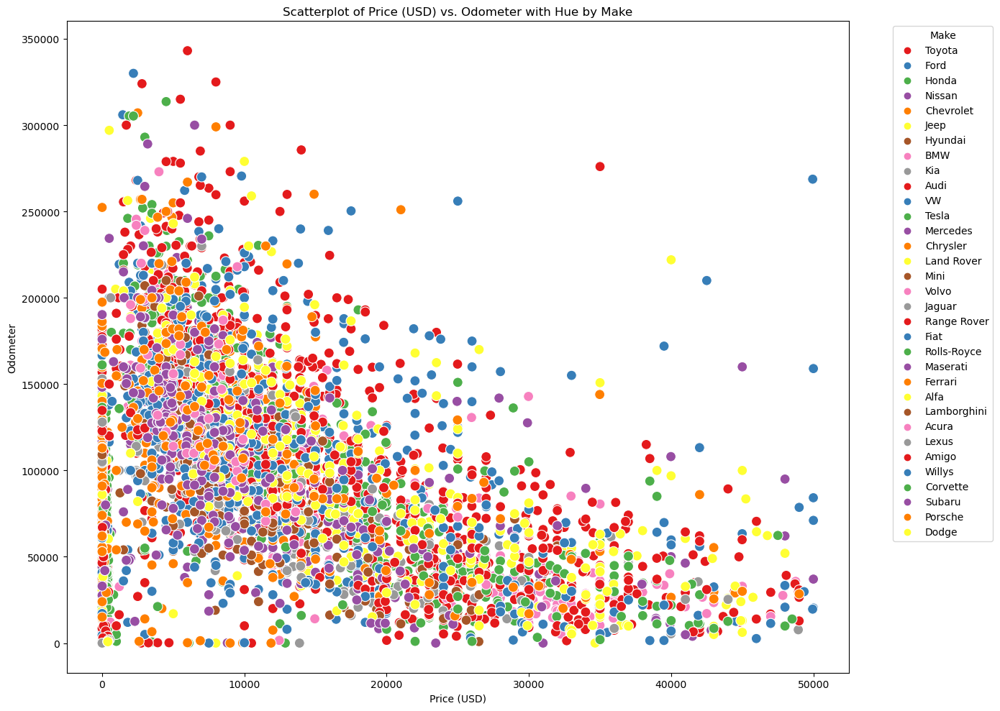

In [32]:
# Remove Makes that have 1 or 2 value counts
make_counts = df_US['Make'].value_counts()
makes_to_keep = make_counts[make_counts > 2].index

filtered_df = df_US[df_US['Make'].isin(makes_to_keep)]

# Further filter the DataFrame for the specified conditions
filtered_df = filtered_df[(filtered_df['price USD'] < 50000) & 
                          (filtered_df['odometer'] < 350000) & 
                          (filtered_df['Year'] > 1979)]

# Sort makes by value counts in descending order
sorted_makes = make_counts.loc[makes_to_keep].sort_values(ascending=False).index

# Create a scatterplot with 'price USD' on the x-axis, 'odometer' on the y-axis, and color by 'Make'
plt.figure(figsize=(14, 10))
scatter_plot = sns.scatterplot(data=filtered_df, x='price USD', y='odometer', hue='Make', hue_order=sorted_makes, palette='Set1', s=100)

# Set plot title and labels
scatter_plot.set_title('Scatterplot of Price (USD) vs. Odometer with Hue by Make')
scatter_plot.set_xlabel('Price (USD)')
scatter_plot.set_ylabel('Odometer')

# Adjust the legend
plt.legend(title='Make', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()


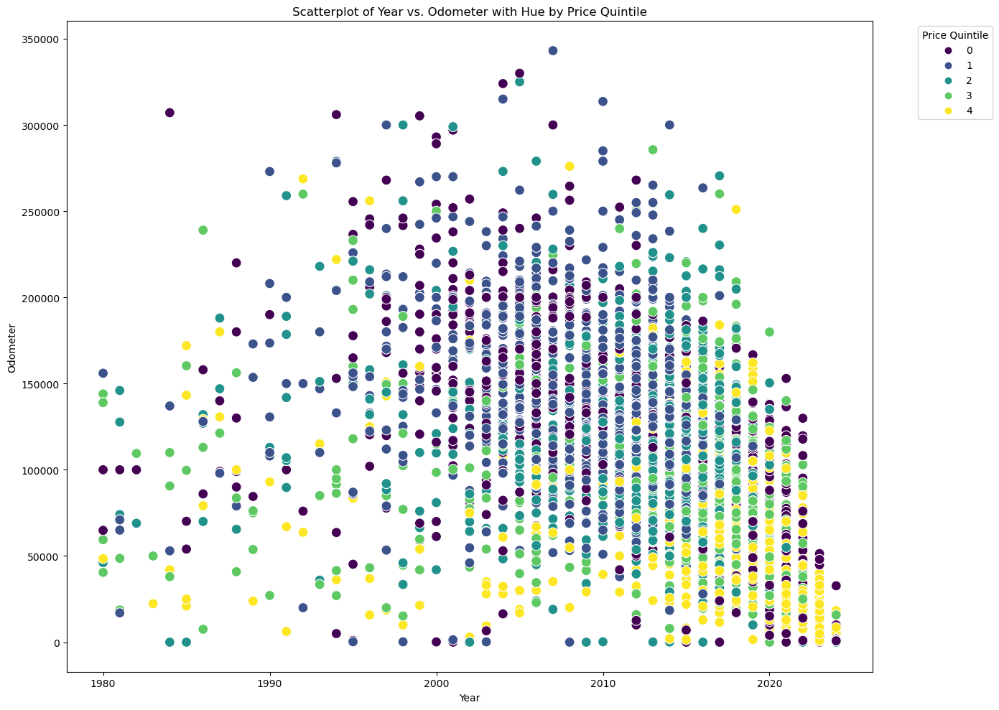

In [33]:
# Create quintiles for 'Price USD'
filtered_df['Price Quintile'] = pd.qcut(filtered_df['price USD'], 5, labels=False)

# Create a scatterplot with 'Year' on the x-axis, 'odometer' on the y-axis, and color by 'Price Quintile'
plt.figure(figsize=(14, 10))
scatter_plot = sns.scatterplot(data=filtered_df, x='Year', y='odometer', hue='Price Quintile', palette='viridis', s=100)

# Set plot title and labels
scatter_plot.set_title('Scatterplot of Year vs. Odometer with Hue by Price Quintile')
scatter_plot.set_xlabel('Year')
scatter_plot.set_ylabel('Odometer')

# Adjust the legend
plt.legend(title='Price Quintile', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()


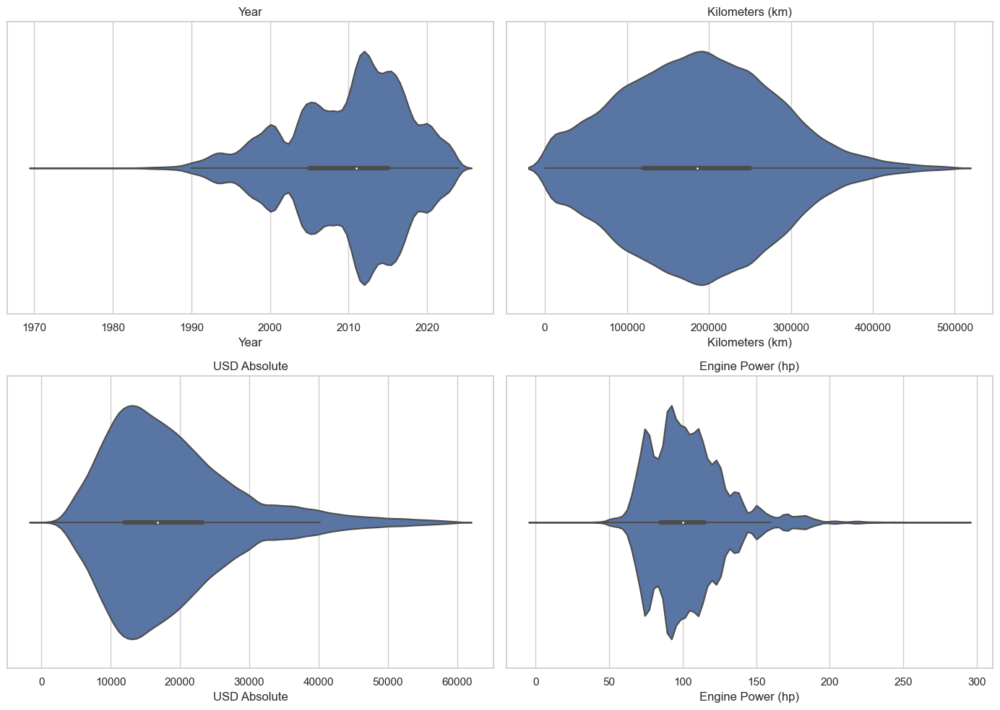

In [34]:
# violin plots for 2024 data

# Let's remove some outliers by filtering df_4yr
filtered_df = df_4yr[
    (df_4yr['Ad Date'] > pd.Timestamp('2023-01-01')) &    # keep only 2024 Turkish Scraped cars
    (df_4yr['Engine Power (hp)'] < 300) &                 # ignore powerful cars of over 300hp
    (df_4yr['USD Absolute'] < 60000) &                    # ignore expensive cars of over $60K
    (df_4yr['Kilometers (km)'] < 500000)                  # ignore cars with over 500,000 km (~310K miles)
]

# Set the style of the plots
sns.set(style="whitegrid")

# Initialize the matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Plotting the violin plots
sns.violinplot(ax=axes[0, 0], x=filtered_df['Year'])
axes[0, 0].set_title('Year')

sns.violinplot(ax=axes[0, 1], x=filtered_df['Kilometers (km)'])
axes[0, 1].set_title('Kilometers (km)')

# Plotting the violin plot for USD Absolute with regular scale
sns.violinplot(ax=axes[1, 0], x=filtered_df['USD Absolute'])
axes[1, 0].set_title('USD Absolute')

# Set y-axis limits and scale for USD Absolute
#axes[1, 0].set_ylim(0, 0.1)
#axes[1, 0].yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: '{:.2f}'.format(x)))

sns.violinplot(ax=axes[1, 1], x=filtered_df['Engine Power (hp)'])
axes[1, 1].set_title('Engine Power (hp)')

# Adjust the space between plots
plt.tight_layout()

# Show the plots
plt.show()


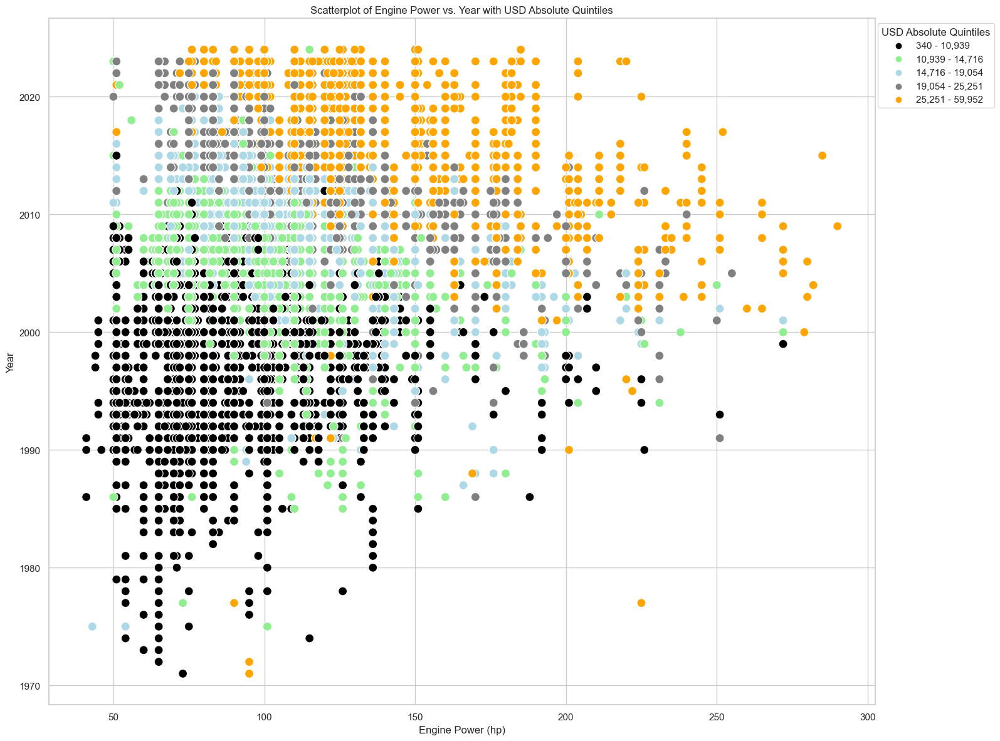

In [35]:
# Filter the DataFrame for year > 1970 and horsepower > 40
filtered_df = filtered_df[(filtered_df['Year'] > 1970) & (filtered_df['Engine Power (hp)'] > 40)]

# Create quintiles for the USD Absolute column
filtered_df['USD Quintile'] = pd.qcut(filtered_df['USD Absolute'], q=5, labels=False)

# Get the quintile ranges and sort them by interval
quintile_ranges = pd.qcut(filtered_df['USD Absolute'], q=5).unique()
quintile_ranges.sort_values(inplace=True)

# Map quintile values to their interval ranges
quintile_labels = {i: f'{int(interval.left):,} - {int(interval.right):,}' for i, interval in enumerate(quintile_ranges)}

# Replace quintile numbers with interval ranges in the legend
filtered_df['USD Quintile'] = filtered_df['USD Quintile'].map(quintile_labels)

# Dynamically create the custom color palette based on the quintile ranges
colors = ['black', 'lightgreen', 'lightblue', 'gray', 'orange']
custom_palette = {label: color for label, color in zip(quintile_labels.values(), colors)}

plt.figure(figsize=(16, 12))
scatter_plot = sns.scatterplot(data=filtered_df, x='Engine Power (hp)', y='Year', hue='USD Quintile', palette=custom_palette, s=100)

# Set plot title and labels
scatter_plot.set_title('Scatterplot of Engine Power vs. Year with USD Absolute Quintiles')
scatter_plot.set_xlabel('Engine Power (hp)')
scatter_plot.set_ylabel('Year')

# Adjust the legend and order it by the interval ranges
handles, labels = scatter_plot.get_legend_handles_labels()
sorted_labels_handles = sorted(zip(labels, handles), key=lambda x: int(x[0].split(' - ')[0].replace(',', '')))
sorted_labels, sorted_handles = zip(*sorted_labels_handles)
scatter_plot.legend(sorted_handles, sorted_labels, title='USD Absolute Quintiles', loc='upper right', bbox_to_anchor=(1.15, 1))

# Show the plot
plt.tight_layout()
plt.show()

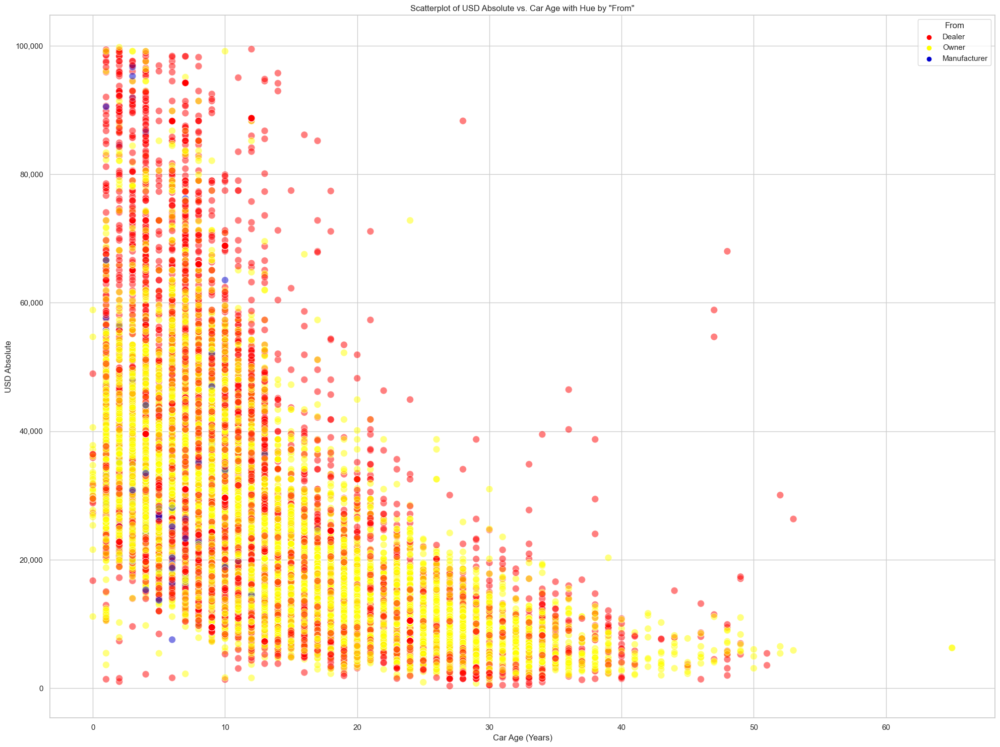

In [36]:
# Filter the DataFrame with multiple conditions
filtered_df = df_4yr[
    # (df_4yr['Ad Date'] > pd.Timestamp('2023-01-01')) &
    (df_4yr['Engine Power (hp)'] < 300) &
    (df_4yr['USD Absolute'] < 100000) &
    (df_4yr['Kilometers (km)'] < 500000)
].copy()

# Check if 'From' column exists
if 'From' not in filtered_df.columns:
    print("Column 'From' not found in DataFrame. Please check your data.")
else:
    # Create a custom color palette
    unique_values = filtered_df['From'].unique()
    custom_palette = dict(zip(unique_values, ['red', 'yellow', 'mediumblue']))

    # Create a scatterplot with the custom palette and adjusted alpha
    plt.figure(figsize=(20, 15))
    scatter_plot = sns.scatterplot(data=filtered_df, x='Car Age (Years)', y='USD Absolute', hue='From', palette=custom_palette, s=100, alpha=0.5)

    # Set plot title and labels
    scatter_plot.set_title('Scatterplot of USD Absolute vs. Car Age with Hue by "From"')
    scatter_plot.set_xlabel('Car Age (Years)')
    scatter_plot.set_ylabel('USD Absolute')

    # Format y-axis with thousand separator
    formatter = FuncFormatter(lambda x, pos: f'{int(x):,}')
    scatter_plot.yaxis.set_major_formatter(formatter)

    # Show the plot
    plt.tight_layout()
    plt.show()


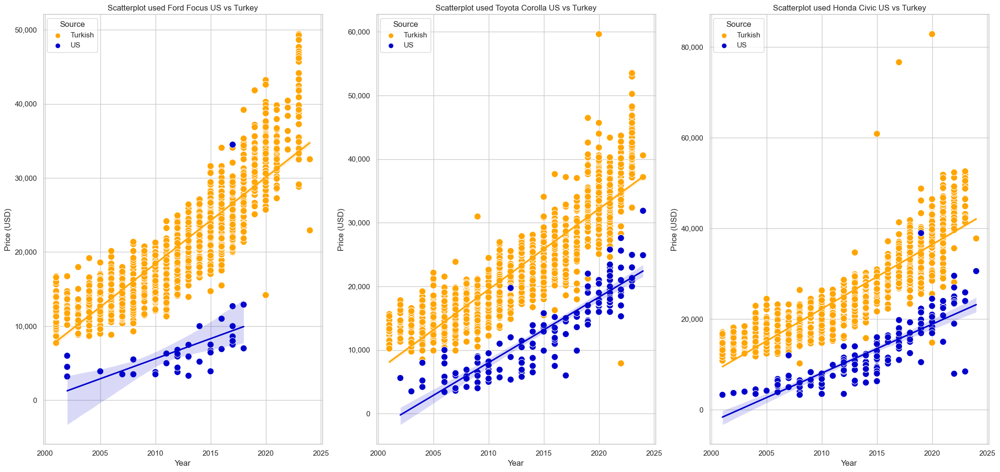

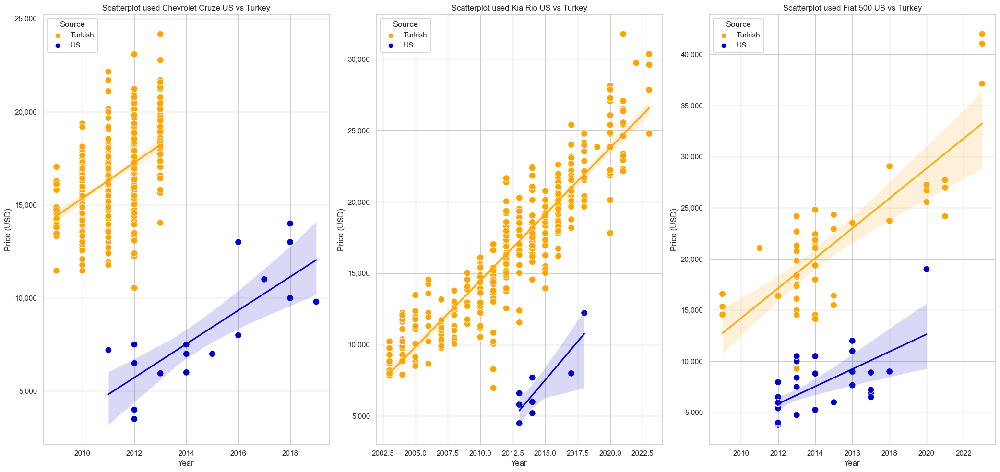

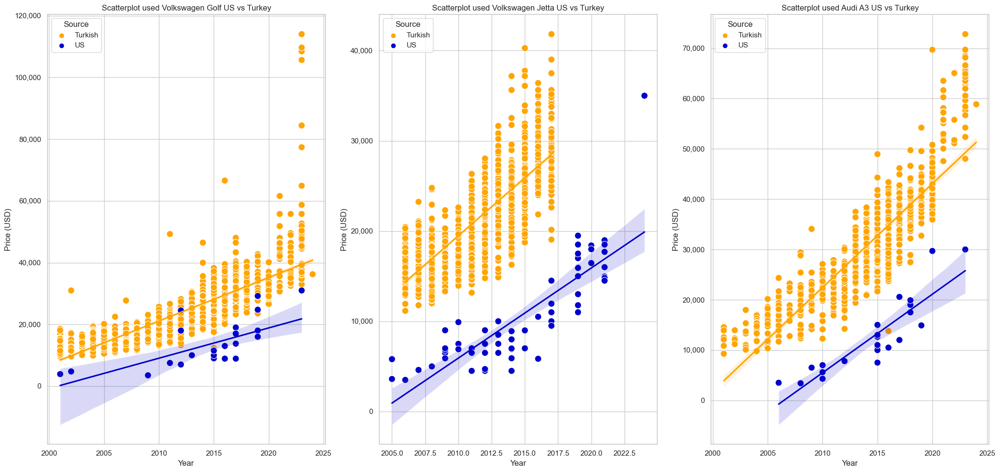

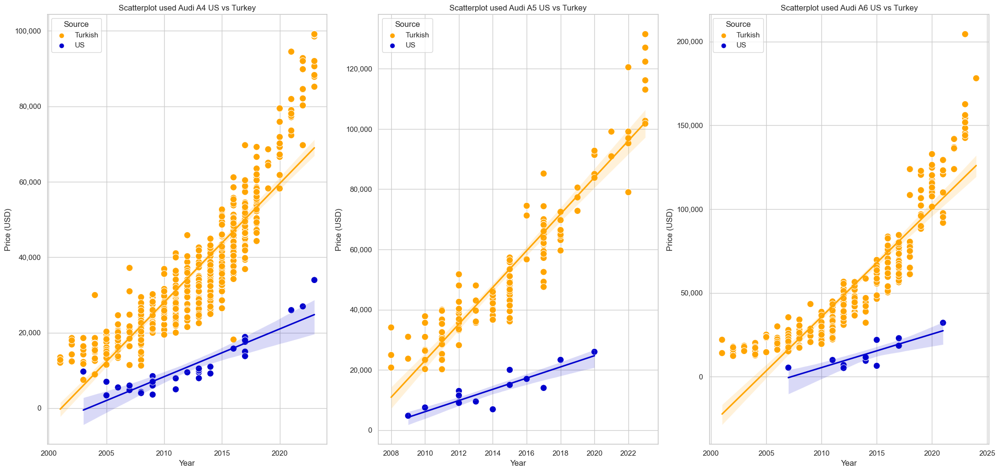

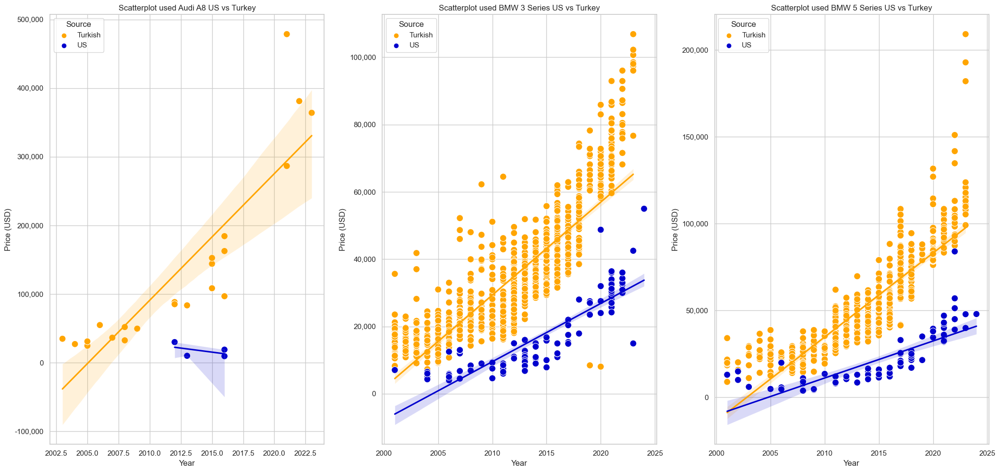

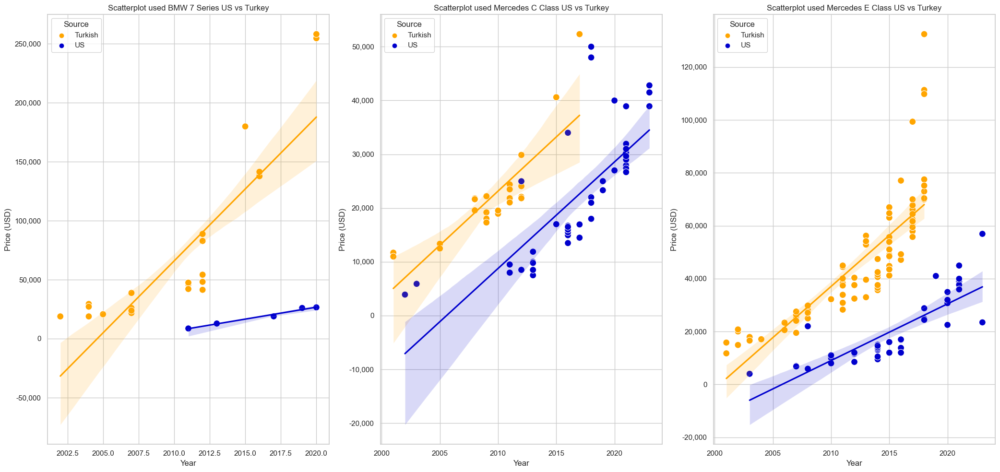

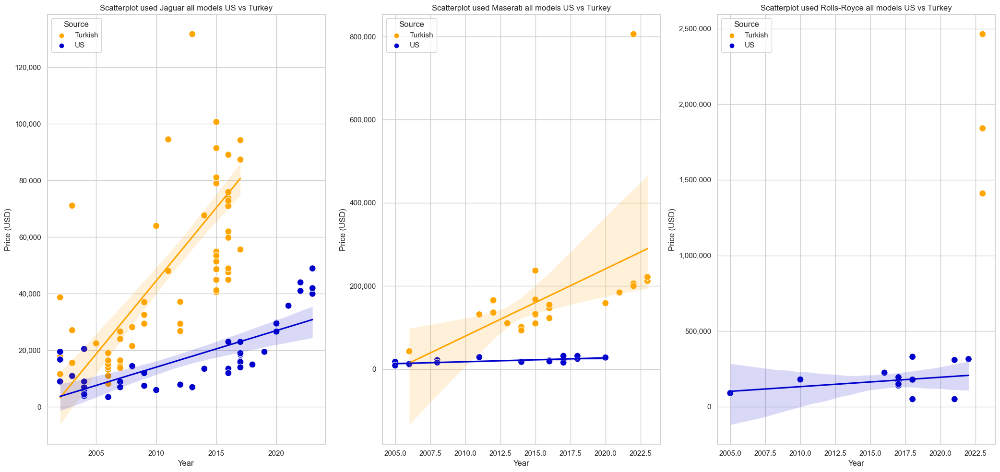

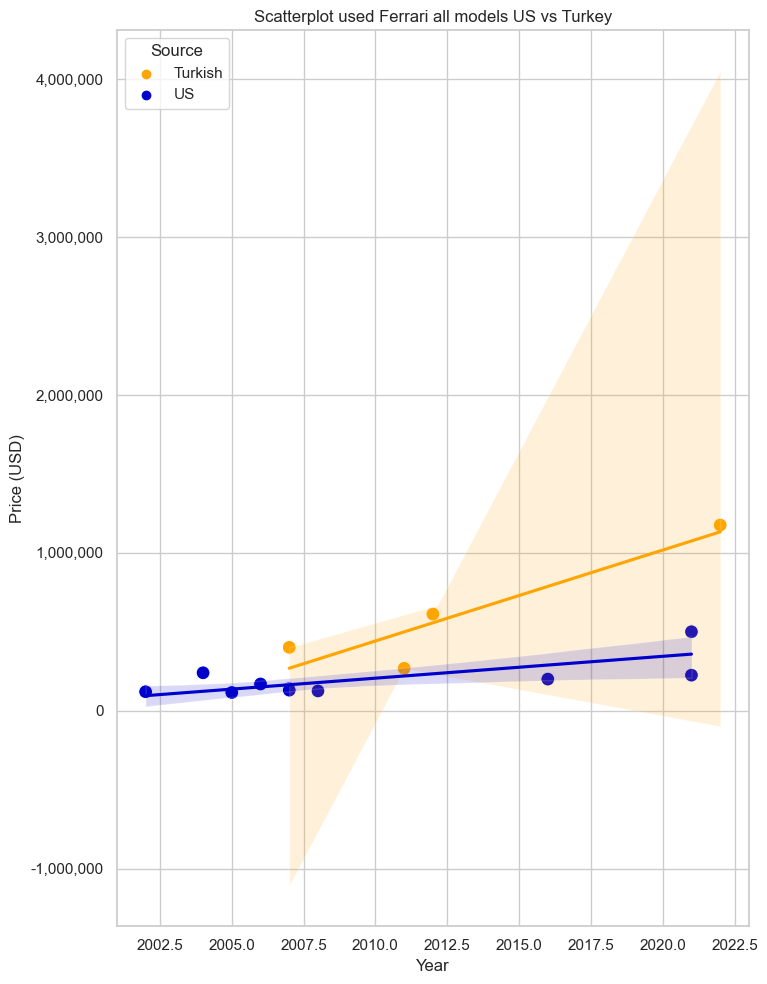

In [37]:
# Compare the same Make and Model between the 2024 Turkish Scraped cars and the 2024 US scraped cars 
# to get an idea of the proce difference in the two markets

# Function to create scatter plots for given Make and Model pairs
def create_scatterplot(df_4yr, df_US, make_model_pairs):
    for i, pair in enumerate(make_model_pairs):
        make_4yr, model_4yr, make_us, model_us = pair
        
        # Filter the data for the specific Make and Model
        if model_4yr:
            df_4yr_filtered = df_4yr[(df_4yr['Make'] == make_4yr) & (df_4yr['Model'] == model_4yr)].copy()
        else:
            df_4yr_filtered = df_4yr[df_4yr['Make'] == make_4yr].copy()

        if model_us:
            df_US_filtered = df_US[(df_US['Make'] == make_us) & (df_US['Model'] == model_us)].copy()
        else:
            df_US_filtered = df_US[df_US['Make'] == make_us].copy()
        
        # Filter by Year > 2000 and Price > 3000
        df_4yr_filtered = df_4yr_filtered[(df_4yr_filtered['Year'] > 2000) & (df_4yr_filtered['USD Absolute'] > 3000)]
        df_US_filtered = df_US_filtered[(df_US_filtered['Year'] > 2000) & (df_US_filtered['price USD'] > 3000)]
        
        # Additional filter for Volkswagen Jetta in Turkish dataframe
        if make_4yr == 'Volkswagen' and model_4yr == 'Jetta':
            df_4yr_filtered = df_4yr_filtered[df_4yr_filtered['USD Absolute'] < 50000]
        
        # Convert Year to int
        if not df_4yr_filtered.empty:
            df_4yr_filtered['Year'] = df_4yr_filtered['Year'].astype(int)
        if not df_US_filtered.empty:
            df_US_filtered['Year'] = df_US_filtered['Year'].astype(int)
        
        # Proceed only if both filtered DataFrames are not empty
        if not df_4yr_filtered.empty and not df_US_filtered.empty:
            # Create a combined DataFrame with an additional column to differentiate between Turkish and US data
            df_4yr_filtered.loc[:, 'Source'] = 'Turkish'
            df_US_filtered.loc[:, 'Source'] = 'US'
            
            # Ensure the columns are the same for merging
            df_4yr_filtered = df_4yr_filtered.rename(columns={'USD Absolute': 'price USD'})
            df_combined = pd.concat([df_4yr_filtered[['Make', 'Model', 'Year', 'price USD', 'Source']], 
                                     df_US_filtered[['Make', 'Model', 'Year', 'price USD', 'Source']]])
            
            # Plot the data
            if i % 3 == 0:
                if i > 0:
                    plt.tight_layout()
                    plt.show()
                plt.figure(figsize=(21, 10))

            plt.subplot(1, 3, i % 3 + 1)
            sns.scatterplot(data=df_combined, x='Year', y='price USD', hue='Source', palette={'Turkish': 'orange', 'US': 'mediumblue'}, s=100)
            
            # Add trendlines
            sns.regplot(data=df_4yr_filtered, x='Year', y='price USD', scatter=False, color='orange', line_kws={'label': 'Turkish Trendline'})
            sns.regplot(data=df_US_filtered, x='Year', y='price USD', scatter=False, color='mediumblue', line_kws={'label': 'US Trendline'})
            
            # Set plot title and labels
            plt.title(f'Scatterplot used {make_4yr} {model_4yr if model_4yr else "all models"} US vs Turkey')
            plt.xlabel('Year')
            plt.ylabel('Price (USD)')
            
            # Add thousand separators to the y-axis
            plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))
            
            # Adjust the legend
            plt.legend(title='Source', loc='upper left')

    plt.tight_layout()
    plt.show()

# Define the make and model pairs for comparison
make_model_pairs = [
    ('Ford', 'Focus', 'Ford', 'Focus'),
    ('Toyota', 'Corolla', 'Toyota', 'Corolla'),
    ('Honda', 'Civic', 'Honda', 'Civic'),
    ('Chevrolet', 'Cruze', 'Chevrolet', 'Cruze'),
    ('Kia', 'Rio', 'Kia', 'Rio'),
    ('Fiat', '500', 'Fiat', '500'),
    ('Volkswagen', 'Golf', 'VW', 'Golf'),
    ('Volkswagen', 'Jetta', 'VW', 'Jetta'),
    ('Audi', 'A3', 'Audi', 'A3'),
    ('Audi', 'A4', 'Audi', 'A4'),
    ('Audi', 'A5', 'Audi', 'A5'),
    ('Audi', 'A6', 'Audi', 'A6'),
    ('Audi', 'A8', 'Audi', 'A8'),
    ('BMW', '3 Series', 'BMW', '3 Series'),
    ('BMW', '5 Series', 'BMW', '5 Series'),
    ('BMW', '7 Series', 'BMW', '7 Series'),
    ('Mercedes', 'C Class', 'Mercedes', 'C-Class'),
    ('Mercedes', 'E Class', 'Mercedes', 'E-Class'),
    ('Jaguar', '', 'Jaguar', ''),
    ('Maserati', '', 'Maserati', ''),
    ('Rolls-Royce', '', 'Rolls-Royce', ''),
    ('Ferrari', '', 'Ferrari', '')
]

# Call the function to create scatter plots
create_scatterplot(df_4yr, df_US, make_model_pairs)

# Calculate models trying to predict "USD Absolute"

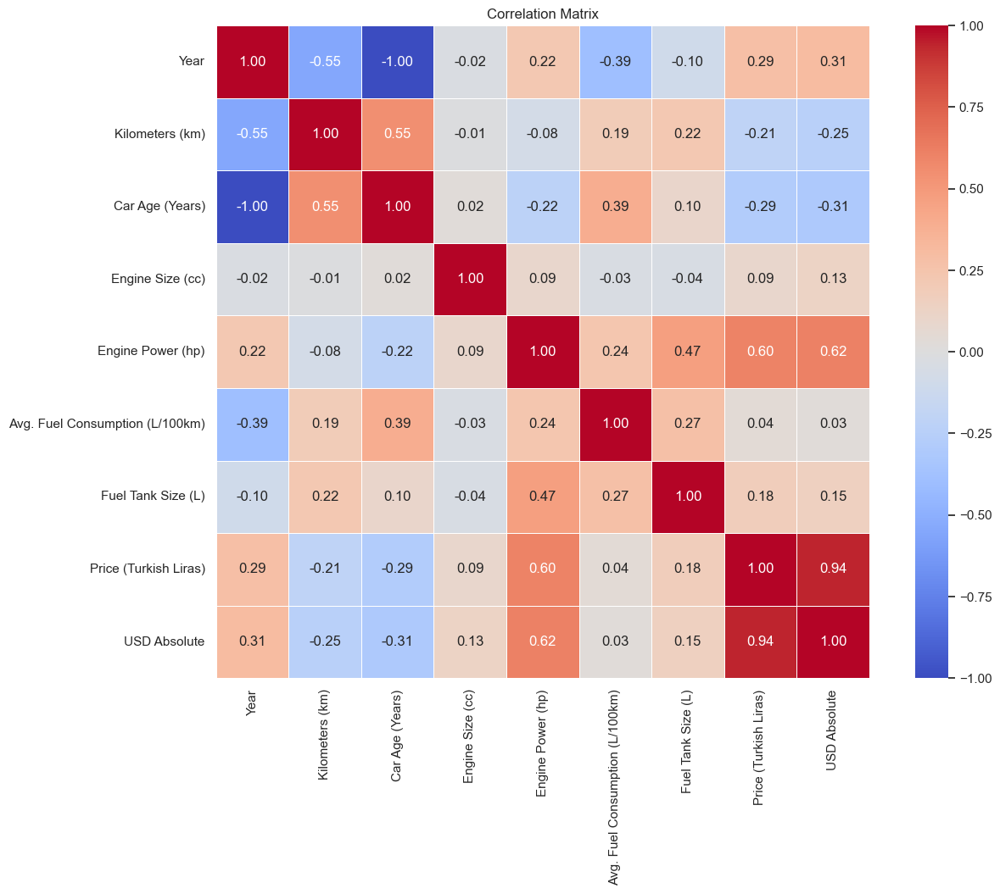

In [38]:
# Select relevant columns for the correlation matrix
relevant_columns = [
    'Year', 'Kilometers (km)', 'Car Age (Years)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Avg. Fuel Consumption (L/100km)', 'Fuel Tank Size (L)', 'Price (Turkish Liras)', 'USD Absolute'
]

# Ensure relevant columns are present
df_corr = df_4yr[relevant_columns].copy()

# Compute the correlation matrix
correlation_matrix = df_corr.corr()

# Set up the matplotlib figure
plt.figure(figsize=(14, 10))

# Draw the heatmap with the correlation matrix
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True, linewidths=.5)

# Set the title
plt.title('Correlation Matrix')

# Show the plot
plt.show()

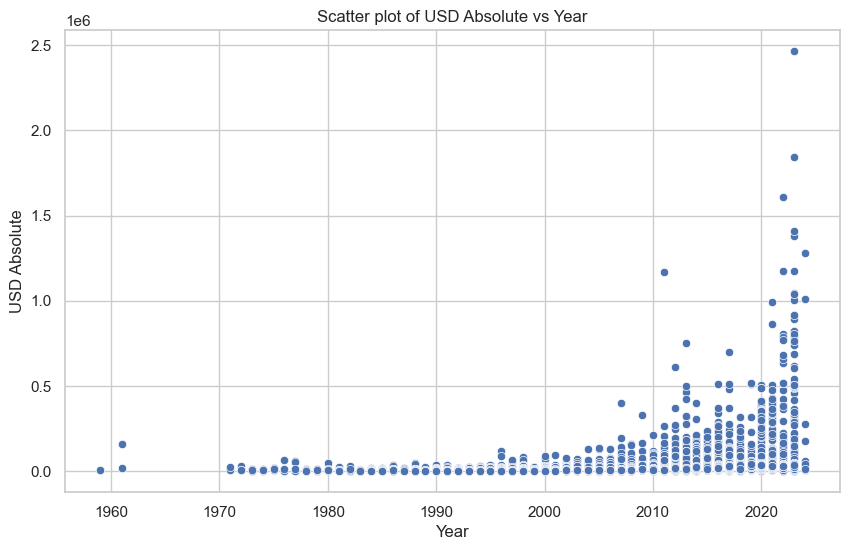

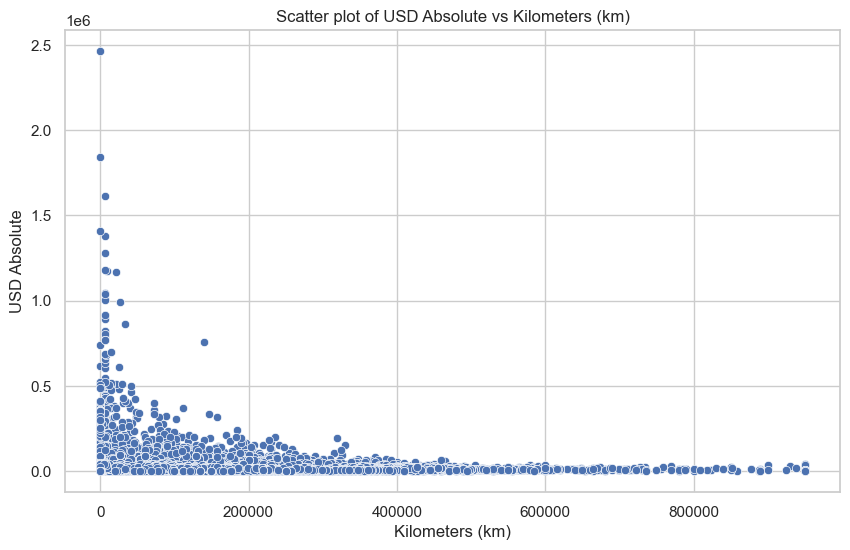

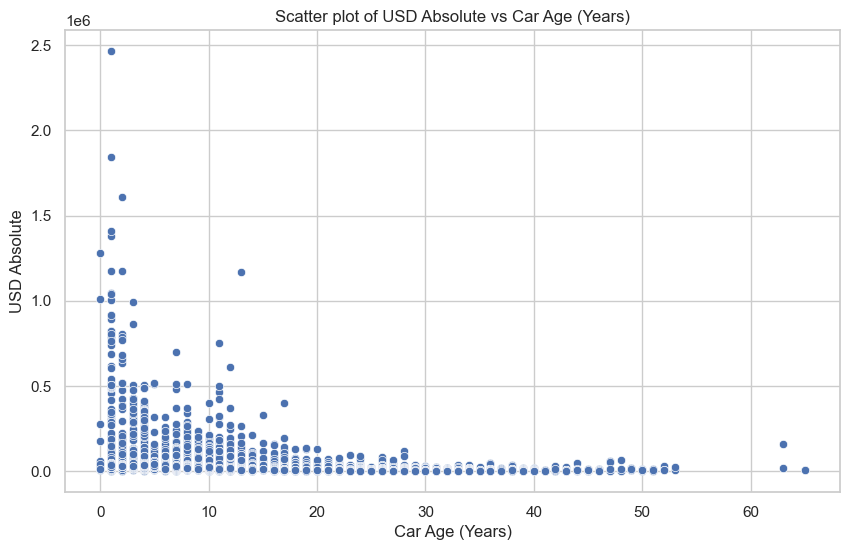

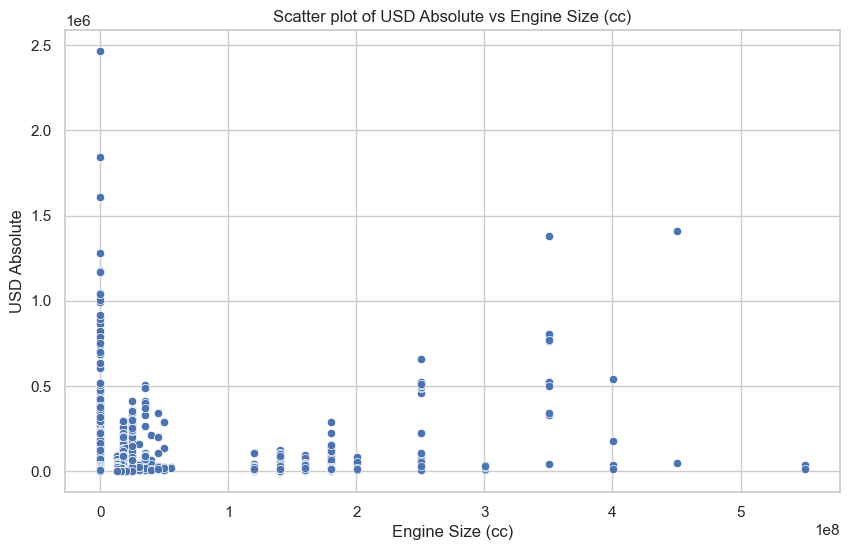

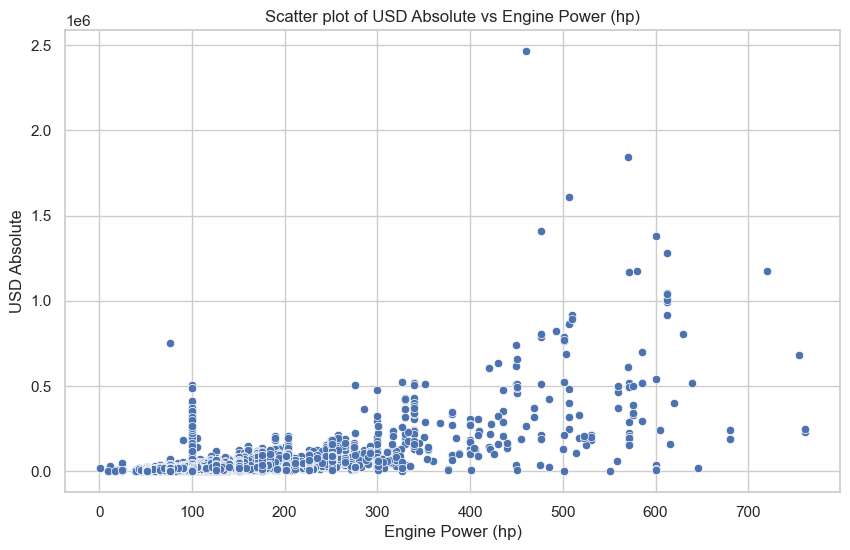

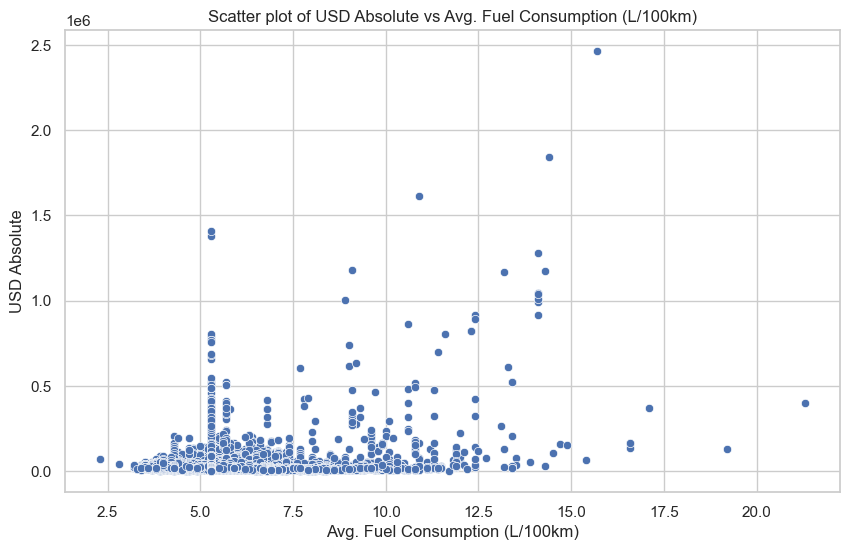

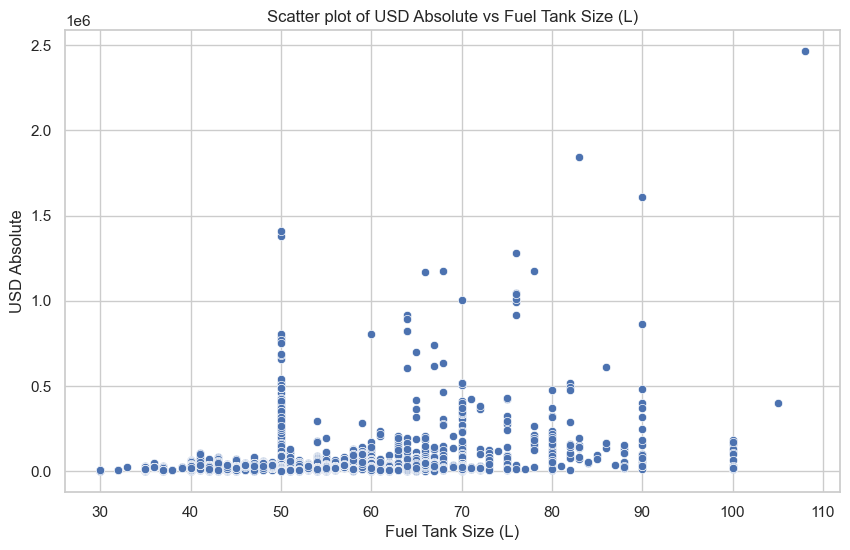

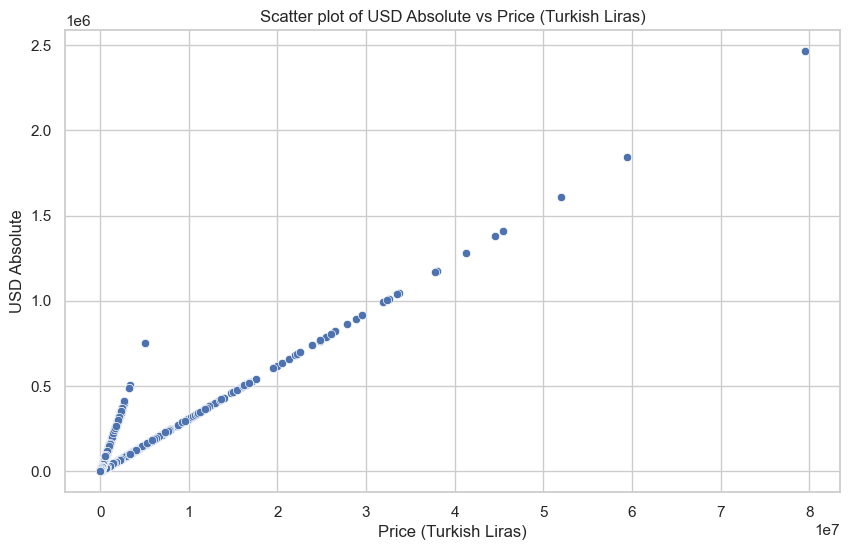

In [39]:
# Prepare the data: drop rows with missing dependent variable
df_regression = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_regression.select_dtypes(include=['object']).columns:
    df_regression[col].fillna(df_regression[col].mode()[0], inplace=True)
for col in df_regression.select_dtypes(exclude=['object']).columns:
    df_regression[col].fillna(df_regression[col].median(), inplace=True)

# One-hot encode categorical variables
categorical_cols = df_regression.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)  # Updated to suppress the warning
encoded_cols = pd.DataFrame(encoder.fit_transform(df_regression[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_regression.drop(columns=categorical_cols).join(encoded_cols)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute'])
y = df_encoded['USD Absolute']

# Plotting each variable against the dependent variable
for column in X.columns:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=df_encoded[column], y=y)
    plt.title(f'Scatter plot of USD Absolute vs {column}')
    plt.xlabel(column)
    plt.ylabel('USD Absolute')
    plt.show()

                               Results: Ordinary least squares
Model:                        OLS                      Adj. R-squared:             0.766     
Dependent Variable:           log_USD_Absolute         AIC:                        33417.3499
Date:                         2024-06-10 12:45         BIC:                        33687.3445
No. Observations:             81647                    Log-Likelihood:             -16680.   
Df Model:                     28                       F-statistic:                9531.     
Df Residuals:                 81618                    Prob (F-statistic):         0.00      
R-squared:                    0.766                    Scale:                      0.088130  
---------------------------------------------------------------------------------------------
                                             Coef.  Std.Err.     t     P>|t|   [0.025  0.975]
-------------------------------------------------------------------------------------------

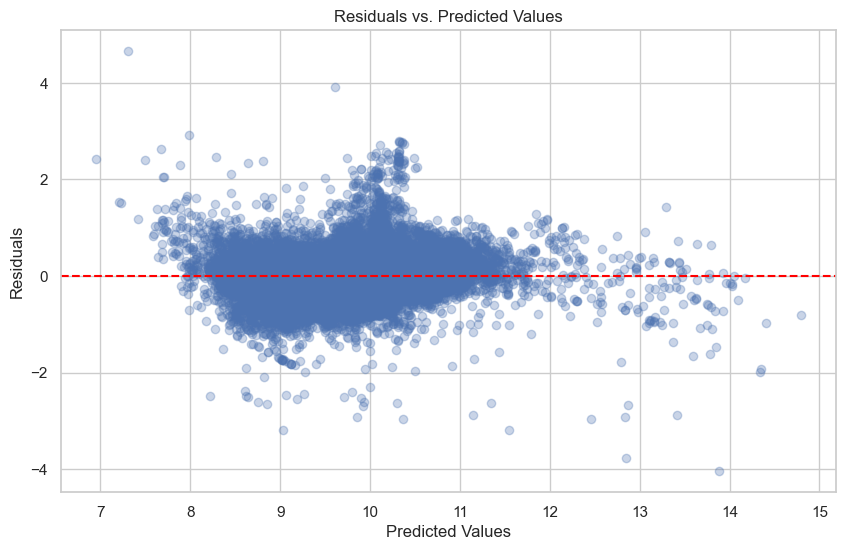

                                        feature  VIF
0                                          Year 1.66
1                               Kilometers (km) 1.53
2                              Engine Size (cc) 1.03
3                             Engine Power (hp) 1.64
4                            Fuel Tank Size (L) 1.46
5                           Transmission_Manual 1.81
6                   Transmission_Semi-Automatic 1.70
7                            Fuel Type_Electric 1.02
8                            Fuel Type_Gasoline 1.24
9                              Fuel Type_Hybrid 1.03
10                   Fuel Type_LPG and Gasoline 1.35
11                             Body Type_Cabrio 1.01
12                              Body Type_Coupe 1.03
13                          Body Type_Crossover 1.01
14                                Body Type_MPV 1.00
15                              Body Type_Other 1.06
16                                Body Type_SUV 1.00
17                      Body Type_Station Wago

In [40]:
# Select relevant columns for the regression, excluding 'Paint-changed', 'Price (Turkish Liras)',
# 'Willing to Exchange', 'Avg. Fuel Consumption (L/100km)', and specified body types and vehicle condition
relevant_columns = [
    'Year', 'Kilometers (km)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Fuel Tank Size (L)', 'USD Absolute',
    'Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition',
    'From', 'Traction'
]

# Prepare the data: drop rows with missing dependent variable
df_regression = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_regression.select_dtypes(include=['object']).columns:
    df_regression[col].fillna(df_regression[col].mode()[0], inplace=True)
for col in df_regression.select_dtypes(exclude=['object']).columns:
    df_regression[col].fillna(df_regression[col].median(), inplace=True)

# Log transform the dependent variable
df_regression['log_USD_Absolute'] = np.log(df_regression['USD Absolute'])

# One-hot encode categorical variables
categorical_cols = df_regression.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)  # Updated to suppress the warning
encoded_cols = pd.DataFrame(encoder.fit_transform(df_regression[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_regression.drop(columns=categorical_cols).join(encoded_cols)

# Drop specified columns from the independent variables
columns_to_drop = [
    'Body Type_Hatchback', 'Body Type_Sedan', 'Body Type_Station wagon',
    'Body Type_Off-Road', 'Vehicle Condition_Damaged'
]
df_encoded.drop(columns=columns_to_drop, inplace=True)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute', 'log_USD_Absolute'])
y = df_encoded['log_USD_Absolute']

# Scale the independent variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Add a constant to the independent variables
X_scaled = sm.add_constant(X_scaled)

# Fit the OLS regression model
model = sm.OLS(y, X_scaled).fit()

# Display the regression results with variable names
variable_names = ['const'] + list(X.columns)
print(model.summary2(xname=variable_names))

# Calculate RMSE
y_pred = model.predict(X_scaled)
rmse = np.sqrt(mean_squared_error(y, y_pred))
print(f"RMSE: {rmse}")

# Plot the residuals
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, y - y_pred, alpha=0.3)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs. Predicted Values')
plt.show()

# Checking for Multicollinearity
# Remove the constant column for VIF calculation
X_scaled_no_const = X_scaled[:, 1:]

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X_scaled_no_const, i) for i in range(X_scaled_no_const.shape[1])]

print(vif_data)

# Grid search for optimal alpha values for Ridge and Lasso Regression
ridge = Ridge()
lasso = Lasso()

alphas = np.logspace(-4, 4, 50)

ridge_grid = GridSearchCV(ridge, param_grid={'alpha': alphas}, cv=5, scoring='neg_mean_squared_error')
lasso_grid = GridSearchCV(lasso, param_grid={'alpha': alphas}, cv=5, scoring='neg_mean_squared_error')

ridge_grid.fit(X_scaled, y)
lasso_grid.fit(X_scaled, y)

# Get the best models
best_ridge = ridge_grid.best_estimator_
best_lasso = lasso_grid.best_estimator_

# Fit and predict with the best models
y_pred_ridge = best_ridge.predict(X_scaled)
y_pred_lasso = best_lasso.predict(X_scaled)

# Calculate RMSE for the best models
rmse_ridge = np.sqrt(mean_squared_error(y, y_pred_ridge))
rmse_lasso = np.sqrt(mean_squared_error(y, y_pred_lasso))

# Calculate R-squared for the best models
r2_ridge = r2_score(y, y_pred_ridge)
r2_lasso = r2_score(y, y_pred_lasso)

print(f"Best Ridge Regression Alpha: {best_ridge.alpha}")
print(f"Ridge Regression RMSE: {rmse_ridge}")
print(f"Ridge Regression R2: {r2_ridge}")
print(f"Ridge Regression Coefficients: {best_ridge.coef_}")

print(f"Best Lasso Regression Alpha: {best_lasso.alpha}")
print(f"Lasso Regression RMSE: {rmse_lasso}")
print(f"Lasso Regression R2: {r2_lasso}")
print(f"Lasso Regression Coefficients: {best_lasso.coef_}")

In [41]:
####### Try taking log('USD Absolute')

# Select relevant columns for the regression, excluding 'Paint-changed', 'Price (Turkish Liras)',
# 'Willing to Exchange', 'Avg. Fuel Consumption (L/100km)', and specified body types and vehicle condition
relevant_columns = [
    'Year', 'Make', 'Kilometers (km)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Fuel Tank Size (L)', 'USD Absolute',
    'Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition',
    'From', 'Traction'
]

# Prepare the data: drop rows with missing dependent variable
df_regression = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_regression.select_dtypes(include=['object']).columns:
    df_regression[col].fillna(df_regression[col].mode()[0], inplace=True)
for col in df_regression.select_dtypes(exclude=['object']).columns:
    df_regression[col].fillna(df_regression[col].median(), inplace=True)

# Log transform the dependent variable
df_regression['log_USD_Absolute'] = np.log(df_regression['USD Absolute'])

# One-hot encode categorical variables
categorical_cols = df_regression.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)  # Updated to suppress the warning
encoded_cols = pd.DataFrame(encoder.fit_transform(df_regression[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_regression.drop(columns=categorical_cols).join(encoded_cols)

# Drop specified columns from the independent variables
columns_to_drop = [
    'Body Type_Hatchback', 'Body Type_Sedan', 'Body Type_Station wagon',
    'Body Type_Off-Road', 'Vehicle Condition_Damaged'
]
df_encoded.drop(columns=columns_to_drop, inplace=True)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute', 'log_USD_Absolute'])
y = df_encoded['log_USD_Absolute']

# Scale the independent variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

                               Results: Ordinary least squares
Model:                       OLS                       Adj. R-squared:              0.814     
Dependent Variable:          log_USD_Absolute          AIC:                         14540.1237
Date:                        2024-06-10 12:45          BIC:                         15405.9686
No. Observations:            81647                     Log-Likelihood:              -7177.1   
Df Model:                    92                        F-statistic:                 3890.     
Df Residuals:                81554                     Prob (F-statistic):          0.00      
R-squared:                   0.814                     Scale:                       0.069883  
----------------------------------------------------------------------------------------------
                                             Coef.  Std.Err.     t      P>|t|   [0.025  0.975]
----------------------------------------------------------------------------------

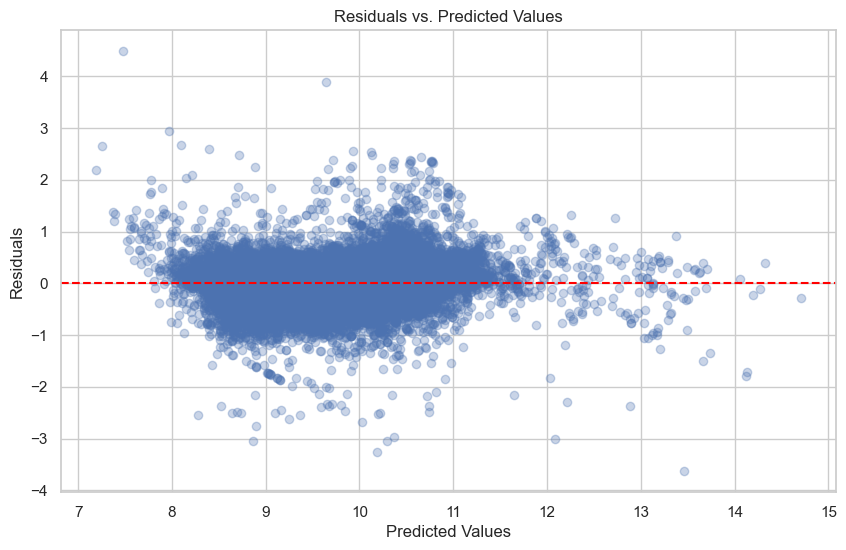

                                        feature    VIF
0                                          Year   1.90
1                               Kilometers (km)   1.62
2                              Engine Size (cc)   1.04
3                             Engine Power (hp)   1.98
4                            Fuel Tank Size (L)   1.72
5                               Make_Alfa Romeo   6.78
6                                     Make_Apec   1.05
7                                     Make_Audi  58.57
8                                      Make_BMC   1.08
9                                      Make_BMW  82.22
10                                 Make_Bentley   1.23
11                                   Make_Chery   1.18
12                               Make_Chevrolet  38.06
13                                Make_Chrysler   1.33
14                                 Make_Citroen  64.43
15                                   Make_Cupra   1.03
16                          Make_DS Automobiles   1.03
17        

In [42]:
# Add a constant to the independent variables
X_scaled = sm.add_constant(X_scaled)

# Fit the OLS regression model
model = sm.OLS(y, X_scaled).fit()

# Display the regression results with variable names
variable_names = ['const'] + list(X.columns)
print(model.summary2(xname=variable_names))

# Calculate RMSE
y_pred = model.predict(X_scaled)
rmse = np.sqrt(mean_squared_error(y, y_pred))
print(f"RMSE: {rmse}")

# Plot the residuals
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, y - y_pred, alpha=0.3)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs. Predicted Values')
plt.show()

# Checking for Multicollinearity
# Remove the constant column for VIF calculation
X_scaled_no_const = X_scaled[:, 1:]

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X_scaled_no_const, i) for i in range(X_scaled_no_const.shape[1])]

print(vif_data)

In [43]:
###### Try running Ridge and Lasso to optimize model

# Define the models
ridge = Ridge()
lasso = Lasso()

# Define the parameter grid
alphas = np.logspace(-4, 4, 50)

# Perform Grid Search CV for Ridge
ridge_grid = GridSearchCV(ridge, param_grid={'alpha': alphas}, cv=5, scoring='neg_mean_squared_error')
ridge_grid.fit(X_scaled, y)

# Perform Grid Search CV for Lasso
lasso_grid = GridSearchCV(lasso, param_grid={'alpha': alphas}, cv=5, scoring='neg_mean_squared_error')
lasso_grid.fit(X_scaled, y)

# Get the best models
best_ridge = ridge_grid.best_estimator_
best_lasso = lasso_grid.best_estimator_

# Fit and predict with the best models
y_pred_ridge = best_ridge.predict(X_scaled)
y_pred_lasso = best_lasso.predict(X_scaled)

# Calculate RMSE for the best models
rmse_ridge = np.sqrt(mean_squared_error(y, y_pred_ridge))
rmse_lasso = np.sqrt(mean_squared_error(y, y_pred_lasso))

# Calculate R-squared for the best models
r2_ridge = r2_score(y, y_pred_ridge)
r2_lasso = r2_score(y, y_pred_lasso)

print(f"Best Ridge Regression Alpha: {best_ridge.alpha}")
print(f"Ridge Regression RMSE: {rmse_ridge}")
print(f"Ridge Regression R2: {r2_ridge}")
print(f"Ridge Regression Coefficients: {best_ridge.coef_}")

print(f"Best Lasso Regression Alpha: {best_lasso.alpha}")
print(f"Lasso Regression RMSE: {rmse_lasso}")
print(f"Lasso Regression R2: {r2_lasso}")
print(f"Lasso Regression Coefficients: {best_lasso.coef_}")

Best Ridge Regression Alpha: 719.6856730011514
Ridge Regression RMSE: 0.26424664141717485
Ridge Regression R2: 0.8143629053558321
Ridge Regression Coefficients: [ 0.00000000e+00  3.82487094e-01 -6.99018129e-02  1.18727368e-02
  1.72481322e-01  4.82599255e-02 -9.10070467e-03  3.63131022e-04
  4.20244507e-02  4.42176364e-04  6.92961083e-02  5.56412722e-03
  9.49972124e-05 -1.55169893e-02 -7.26009908e-03 -2.13347798e-02
  1.20950321e-03 -1.39282826e-05 -2.57704649e-02  1.26369241e-03
  3.92922113e-03 -5.90816706e-02 -9.02527424e-03  1.12509195e-03
  1.47461091e-03  4.17312938e-04 -1.63622042e-03  1.50078537e-02
 -1.68932204e-02 -5.62866924e-03 -3.69814730e-03 -2.33187211e-04
  5.35513415e-04  6.05045487e-03  7.64132674e-03 -9.49114851e-03
 -2.11487940e-03 -2.68889368e-02  3.08631580e-02  1.57167251e-03
  9.18994274e-03  1.08582810e-02  4.00686800e-03  8.50337274e-02
  2.88052875e-03 -4.88049591e-03 -3.75065022e-04  2.09296419e-03
  4.46072820e-03  5.78850570e-03  1.39777109e-03 -1.9341672

In [44]:
###### We have a great R2 value but let's try more complex models, like: Decision Tree, 
###### Random Forest, SVR, KNN, XGBoost Regressor; to speed it up we'll run this on a 10,000 sample

# Select relevant columns for the regression, excluding 'Paint-changed', 'Price (Turkish Liras)',
# 'Willing to Exchange', 'Avg. Fuel Consumption (L/100km)', and specified body types and vehicle condition
relevant_columns = [
    'Year', 'Kilometers (km)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Fuel Tank Size (L)', 'USD Absolute',
    'Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition',
    'From', 'Traction'
]

# Prepare the data: drop rows with missing dependent variable
df_regression = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_regression.select_dtypes(include=['object']).columns:
    df_regression[col].fillna(df_regression[col].mode()[0], inplace=True)
for col in df_regression.select_dtypes(exclude=['object']).columns:
    df_regression[col].fillna(df_regression[col].median(), inplace=True)

# Log transform the dependent variable
df_regression['log_USD_Absolute'] = np.log(df_regression['USD Absolute'])

# One-hot encode categorical variables
categorical_cols = df_regression.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)  # Updated to suppress the warning
encoded_cols = pd.DataFrame(encoder.fit_transform(df_regression[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_regression.drop(columns=categorical_cols).join(encoded_cols)

# Drop specified columns from the independent variables
columns_to_drop = [
    'Body Type_Hatchback', 'Body Type_Sedan', 'Body Type_Station wagon',
    'Body Type_Off-Road', 'Vehicle Condition_Damaged'
]
df_encoded.drop(columns=columns_to_drop, inplace=True)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute', 'log_USD_Absolute'])
y = df_encoded['log_USD_Absolute']

# Sample the data to reduce runtime
df_sampled = df_encoded.sample(n=10000, random_state=42)  # Sample 10,000 rows
X_sampled = df_sampled.drop(columns=['USD Absolute', 'log_USD_Absolute'])
y_sampled = df_sampled['log_USD_Absolute']

# Scale the independent variables
scaler = StandardScaler()
X_sampled_scaled = scaler.fit_transform(X_sampled)

# Add a constant to the independent variables
X_sampled_scaled = sm.add_constant(X_sampled_scaled)

# Define models to evaluate
models = {
    'Decision Tree Regressor': DecisionTreeRegressor(),
    'Random Forest Regressor': RandomForestRegressor(),
    'Support Vector Regressor': SVR(),
    'K-Nearest Neighbors Regressor': KNeighborsRegressor(),
    'XGBoost Regressor': xgb.XGBRegressor()
}

# Reduced grid search for optimal hyperparameters
param_grids_reduced = {
    'Decision Tree Regressor': {'max_depth': [None, 10, 20]},
    'Random Forest Regressor': {'n_estimators': [10, 50], 'max_depth': [None, 10]},
    'Support Vector Regressor': {'C': [0.1, 1, 10], 'epsilon': [0.1, 1]},
    'K-Nearest Neighbors Regressor': {'n_neighbors': [5, 10, 15]},
    'XGBoost Regressor': {'n_estimators': [10, 50], 'learning_rate': [0.1, 0.2]}
}

# Evaluate models with reduced grid search
results = {}

for name, model in models.items():
    if name in param_grids_reduced:
        grid_search = GridSearchCV(model, param_grids_reduced[name], cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
        grid_search.fit(X_sampled_scaled, y_sampled)
        best_model = grid_search.best_estimator_
    else:
        best_model = model
        best_model.fit(X_sampled_scaled, y_sampled)
    
    y_pred = best_model.predict(X_sampled_scaled)
    rmse = np.sqrt(mean_squared_error(y_sampled, y_pred))
    r2 = r2_score(y_sampled, y_pred)
    
    results[name] = {
        'RMSE': rmse,
        'R2': r2,
        'Best Params': grid_search.best_params_ if name in param_grids_reduced else None
    }

# Print results
for name, result in results.items():
    print(f"{name} Results:")
    print(f"RMSE: {result['RMSE']}")
    print(f"R2: {result['R2']}")
    if result['Best Params']:
        print(f"Best Params: {result['Best Params']}")
    print("\n")

Decision Tree Regressor Results:
RMSE: 0.1974222584026552
R2: 0.8994310389754823
Best Params: {'max_depth': 10}


Random Forest Regressor Results:
RMSE: 0.08800238999690307
R2: 0.9800170010241525
Best Params: {'max_depth': None, 'n_estimators': 50}


Support Vector Regressor Results:
RMSE: 0.24336364750158648
R2: 0.8471789624593722
Best Params: {'C': 10, 'epsilon': 0.1}


K-Nearest Neighbors Regressor Results:
RMSE: 0.25530594379525245
R2: 0.8318125509262988
Best Params: {'n_neighbors': 5}


XGBoost Regressor Results:
RMSE: 0.17057861111182665
R2: 0.9249205850051347
Best Params: {'learning_rate': 0.2, 'n_estimators': 50}




Random Forest Regressor Training R2: 0.983981692664006
Random Forest Regressor Training RMSE: 0.07749465798188963
Random Forest Regressor Test R2: 0.896160248637661
Random Forest Regressor Test RMSE: 0.19887197641016832


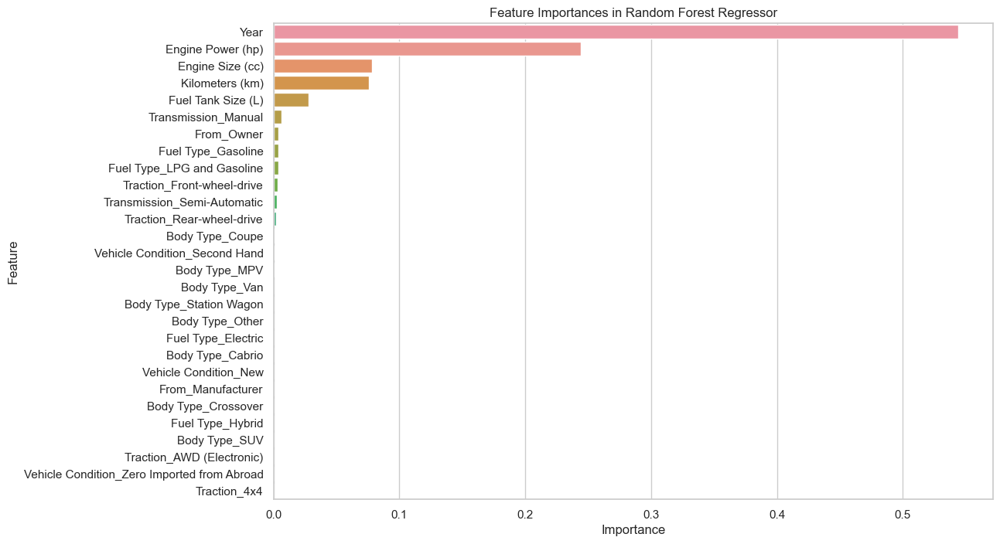

In [46]:
# Random Forest: R2: 0.98 looks amazing; running the model on the full data

# Select relevant columns for the regression, excluding 'Paint-changed', 'Price (Turkish Liras)',
# 'Willing to Exchange', 'Avg. Fuel Consumption (L/100km)', and specified body types and vehicle condition
relevant_columns = [
    'Year', 'Kilometers (km)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Fuel Tank Size (L)', 'USD Absolute',
    'Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition',
    'From', 'Traction'
]

# Prepare the data: drop rows with missing dependent variable
df_regression = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_regression.select_dtypes(include=['object']).columns:
    df_regression[col].fillna(df_regression[col].mode()[0], inplace=True)
for col in df_regression.select_dtypes(exclude=['object']).columns:
    df_regression[col].fillna(df_regression[col].median(), inplace=True)

# Log transform the dependent variable
df_regression['log_USD_Absolute'] = np.log(df_regression['USD Absolute'])

# One-hot encode categorical variables
categorical_cols = df_regression.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)  # Updated to suppress the warning
encoded_cols = pd.DataFrame(encoder.fit_transform(df_regression[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_regression.drop(columns=categorical_cols).join(encoded_cols)

# Drop specified columns from the independent variables
columns_to_drop = [
    'Body Type_Hatchback', 'Body Type_Sedan', 'Body Type_Station wagon',
    'Body Type_Off-Road', 'Vehicle Condition_Damaged'
]
df_encoded.drop(columns=columns_to_drop, inplace=True)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute', 'log_USD_Absolute'])
y = df_encoded['log_USD_Absolute']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the independent variables
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define and fit the Random Forest Regressor with optimal hyperparameters
random_forest = RandomForestRegressor(n_estimators=100, max_depth=30, random_state=42)
random_forest.fit(X_train_scaled, y_train)

# Predict and evaluate the model
y_pred_train = random_forest.predict(X_train_scaled)
y_pred_test = random_forest.predict(X_test_scaled)

# Calculate R2 and RMSE for the training and test sets
r2_train = r2_score(y_train, y_pred_train)
r2_test = r2_score(y_test, y_pred_test)
rmse_train = np.sqrt(mean_squared_error(y_train, y_pred_train))
rmse_test = np.sqrt(mean_squared_error(y_test, y_pred_test))

print(f"Random Forest Regressor Training R2: {r2_train}")
print(f"Random Forest Regressor Training RMSE: {rmse_train}")
print(f"Random Forest Regressor Test R2: {r2_test}")
print(f"Random Forest Regressor Test RMSE: {rmse_test}")

# Extract feature importances
importances = random_forest.feature_importances_
feature_names = X.columns

# Create a DataFrame for better visualization
feature_importances = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=feature_importances)
plt.title('Feature Importances in Random Forest Regressor')
plt.show()

Random Forest Classifier Accuracy: 0.911328842620943
Random Forest Classifier Precision: 0.9105814100138732
Random Forest Classifier Recall: 0.907149139339113
Random Forest Classifier F1 Score: 0.9088620342396777
              precision    recall  f1-score   support

           0       0.91      0.92      0.91      8371
           1       0.91      0.91      0.91      7959

    accuracy                           0.91     16330
   macro avg       0.91      0.91      0.91     16330
weighted avg       0.91      0.91      0.91     16330



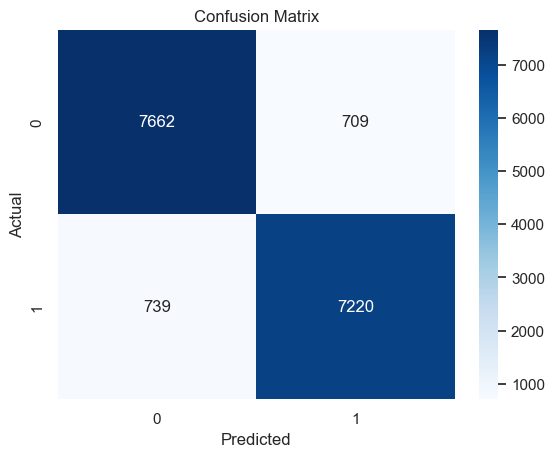

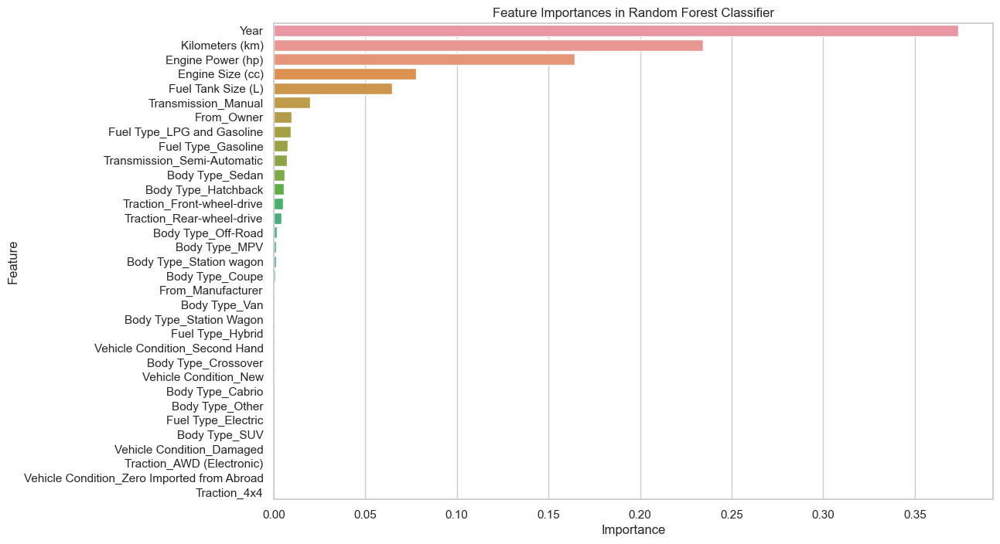

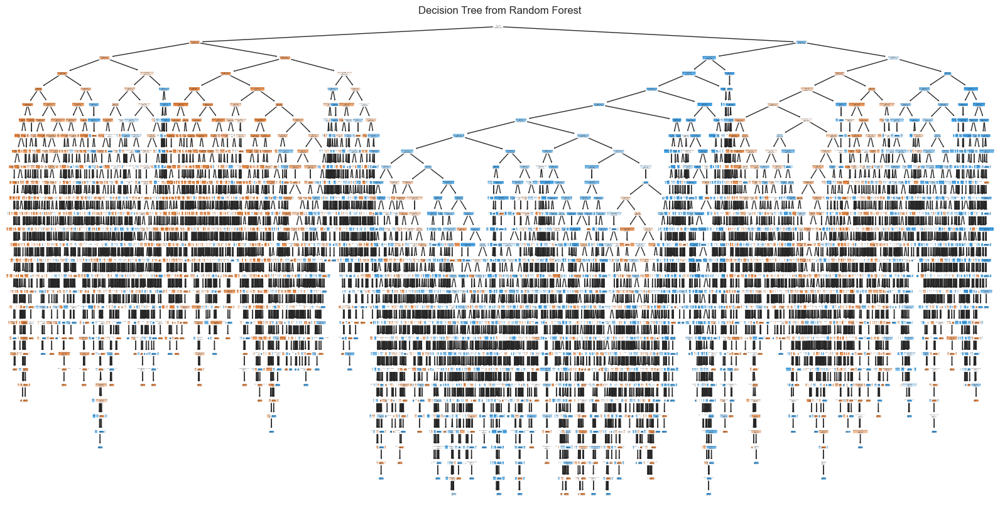

Fitting 3 folds for each of 216 candidates, totalling 648 fits
Best Parameters: {'bootstrap': True, 'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}
Optimized Random Forest Classifier Accuracy: 0.9163502755664421
Optimized Random Forest Classifier Precision: 0.9135616610212018
Optimized Random Forest Classifier Recall: 0.9149390626963186
Optimized Random Forest Classifier F1 Score: 0.9142498430634023
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   2.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   3.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   2.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_es

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   5.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   5.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=50; total time=   2.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   7.5s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=5, n_estimators=50; total time=   1.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=5, n_estimators=100; total time=   3.7s
[CV] END bootstrap=True, max_depth=None, min_sa

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   5.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   5.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=50; total time=   2.5s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=200; total time=   9.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=50; total time=   2.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   9.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=50; total time=   1.7s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   3.8s
[CV] END bootstrap=True, max_depth=None, min_samp

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=  10.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=50; total time=   2.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=200; total time=   9.5s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=50; total time=   2.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   9.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=50; total time=   1.8s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   3.6s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=5, n_estimators=50; total time=   2.0s
[CV] END bootstrap=True, max_depth=None, min_sampl

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   5.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   4.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=50; total time=   2.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   4.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=50; total time=   1.8s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   5.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   4.8s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   8.3s
[CV] END bootstrap=True, max_depth=None, min_sam

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=  10.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   4.4s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=50; total time=   1.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   5.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   9.7s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=100; total time=   3.7s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   3.7s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=2, n_estimators=200; total time=   7.5s
[CV] END bootstrap=True, max_depth=None, min_sa

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   1.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=  10.8s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=   4.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   4.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=50; total time=   2.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total time=   5.0s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=50; total time=   2.3s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   7.7s
[CV] END bootstrap=True, max_depth=None, min_sam

[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   1.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   3.1s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=   4.9s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   8.7s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=  10.6s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=100; total time=   4.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=2, min_samples_split=10, n_estimators=200; total time=   8.2s
[CV] END bootstrap=True, max_depth=None, min_samples_leaf=4, min_samples_split=5, n_estimators=200; total time=   7.3s
[CV] END bootstrap=True, max_depth=10, min_sampl

In [54]:
###################
# TAKES A WHILE TO RUN - OPTIMIZE RANDOM FOREST
###################
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn import tree

# Select relevant columns for the classification
relevant_columns = [
    'Year', 'Kilometers (km)', 'Engine Size (cc)', 'Engine Power (hp)',
    'Fuel Tank Size (L)', 'USD Absolute',
    'Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition',
    'From', 'Traction'
]

# Prepare the data: drop rows with missing dependent variable
df_classification = df_4yr.dropna(subset=['USD Absolute'])[relevant_columns].copy()

# Handle missing values: fill numeric columns with median and categorical with mode
for col in df_classification.select_dtypes(include=['object']).columns:
    df_classification[col].fillna(df_classification[col].mode()[0], inplace=True)
for col in df_classification.select_dtypes(exclude=['object']).columns:
    df_classification[col].fillna(df_classification[col].median(), inplace=True)

# Create a binary classification target variable
median_price = df_classification['USD Absolute'].median()
df_classification['Above_Median_Price'] = (df_classification['USD Absolute'] > median_price).astype(int)

# One-hot encode categorical variables
categorical_cols = df_classification.select_dtypes(include=['object']).columns
encoder = OneHotEncoder(drop='first', sparse_output=False)
encoded_cols = pd.DataFrame(encoder.fit_transform(df_classification[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))

# Drop original categorical columns and add encoded ones
df_encoded = df_classification.drop(columns=categorical_cols).join(encoded_cols)

# Ensure no inf or NaN values
df_encoded.replace([np.inf, -np.inf], np.nan, inplace=True)
df_encoded.dropna(inplace=True)

# Define dependent and independent variables
X = df_encoded.drop(columns=['USD Absolute', 'Above_Median_Price'])
y = df_encoded['Above_Median_Price']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the independent variables
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define and fit the Random Forest Classifier
random_forest = RandomForestClassifier(n_estimators=100, max_depth=30, random_state=42)
random_forest.fit(X_train_scaled, y_train)

# Predict and evaluate the model
y_pred_train = random_forest.predict(X_train_scaled)
y_pred_test = random_forest.predict(X_test_scaled)

# Calculate classification metrics for the test set
accuracy = accuracy_score(y_test, y_pred_test)
precision = precision_score(y_test, y_pred_test)
recall = recall_score(y_test, y_pred_test)
f1 = f1_score(y_test, y_pred_test)

print(f"Random Forest Classifier Accuracy: {accuracy}")
print(f"Random Forest Classifier Precision: {precision}")
print(f"Random Forest Classifier Recall: {recall}")
print(f"Random Forest Classifier F1 Score: {f1}")

# Print classification report
print(classification_report(y_test, y_pred_test))

# Plot confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred_test)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Feature importance visualization
importances = random_forest.feature_importances_
feature_names = list(X.columns)
feature_importances = pd.DataFrame({'Feature': feature_names, 'Importance': importances}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=feature_importances)
plt.title('Feature Importances in Random Forest Classifier')
plt.show()

# Plot a single decision tree from the Random Forest
estimator = random_forest.estimators_[0]
plt.figure(figsize=(20, 10))
tree.plot_tree(estimator, filled=True, feature_names=feature_names, rounded=True)
plt.title('Decision Tree from Random Forest')
plt.show()

# Hyperparameter tuning using GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}
grid_search = GridSearchCV(estimator=RandomForestClassifier(random_state=42), param_grid=param_grid, cv=3, n_jobs=-1, verbose=2, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)

best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
print(f"Best Parameters: {best_params}")

# Evaluate the best model on the test set
y_pred_test_best = best_model.predict(X_test_scaled)
accuracy_best = accuracy_score(y_test, y_pred_test_best)
precision_best = precision_score(y_test, y_pred_test_best)
recall_best = recall_score(y_test, y_pred_test_best)
f1_best = f1_score(y_test, y_pred_test_best)

print(f"Optimized Random Forest Classifier Accuracy: {accuracy_best}")
print(f"Optimized Random Forest Classifier Precision: {precision_best}")
print(f"Optimized Random Forest Classifier Recall: {recall_best}")
print(f"Optimized Random Forest Classifier F1 Score: {f1_best}")


# Calculate yearly Loss of Value for each Make-Model

## To find recommendations for year / make / model that loses the least %/year

Processing Honda Civic
Columns in median_prices for Honda Civic: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


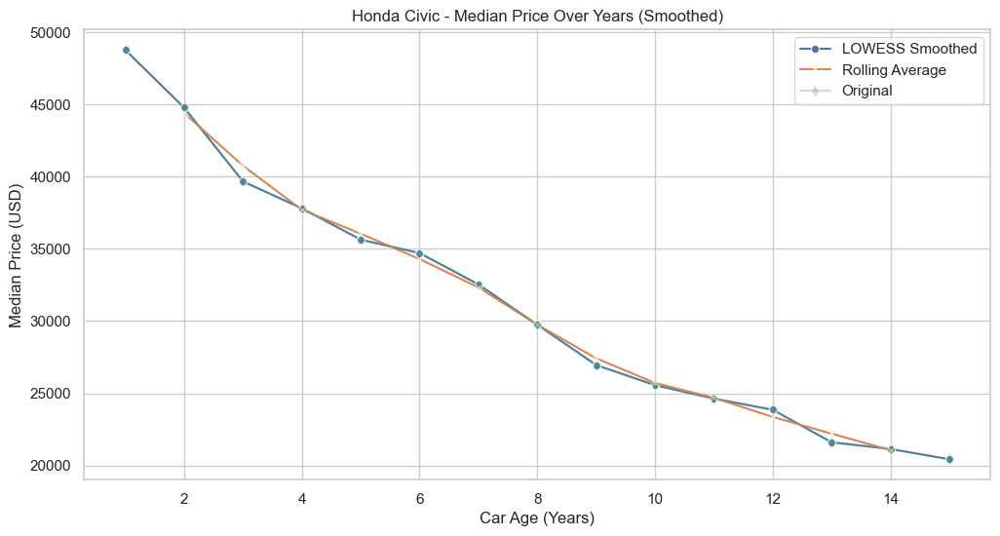

Honda Civic - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         18      48759.65
2                 2            -8.18         33      44770.58
3                 3           -11.42        125      39658.37
4                 4            -4.69        128      37799.38
5                 5            -5.74        119      35630.57
6                 6            -2.61        184      34701.07
7                 7            -6.25        139      32532.26
8                 8            -8.57         67      29743.78
9                 9            -9.38         57      26955.30
10               10            -5.17         62      25561.06
11               11            -3.64         97      24631.57
12               12            -3.14        123      23856.99
13               13            -9.42         78      21609.16
14               14            -2.14         76      21145.95
15               15          

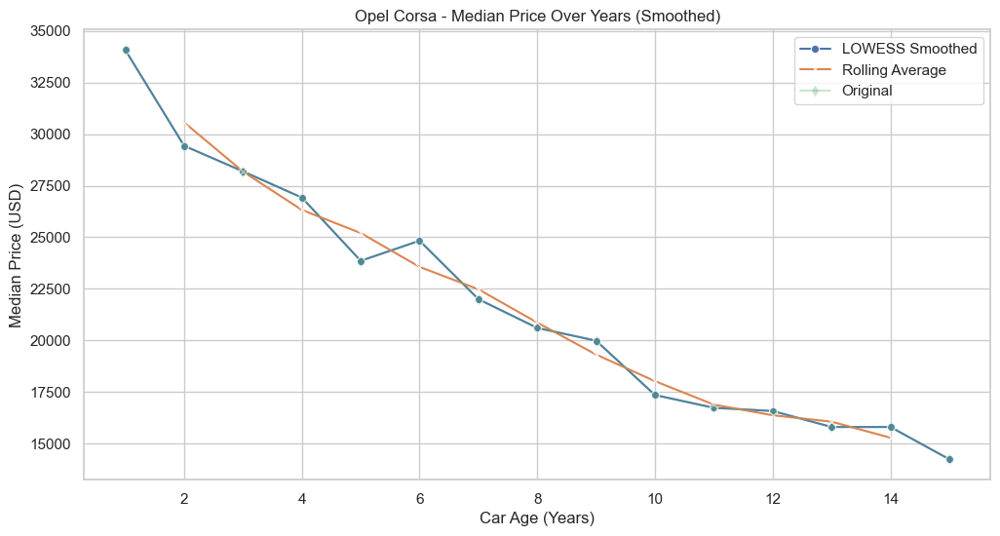

Opel Corsa - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         77      34081.41
2                 2           -13.64         39      29433.95
3                 3            -4.21         31      28194.62
4                 4            -4.51         51      26924.31
5                 5           -11.39         17      23856.99
6                 6             4.09          6      24832.96
7                 7           -11.42         55      21998.00
8                 8            -6.34         45      20603.76
9                 9            -3.01         85      19984.10
10               10           -13.18        115      17350.54
11               11            -3.57        171      16730.87
12               12            -0.93        167      16575.96
13               13            -4.67        137      15801.38
14               14             0.00         75      15801.38
15               15           

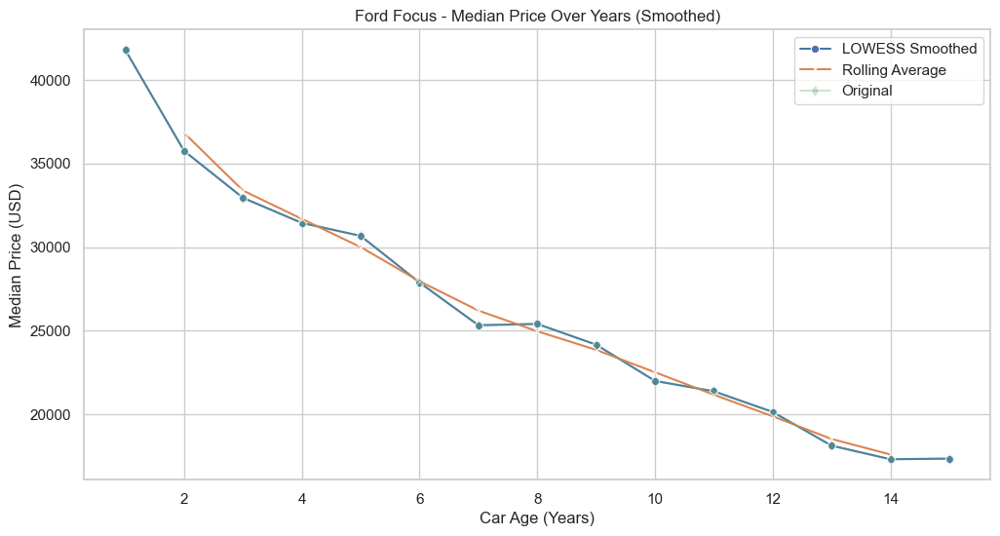

Ford Focus - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         39      41796.20
2                 2           -14.46          8      35754.50
3                 3            -7.84         28      32950.53
4                 4            -4.56        143      31447.85
5                 5            -2.46         53      30673.27
6                 6            -9.10         84      27880.92
7                 7            -9.15        133      25328.68
8                 8             0.31        127      25406.14
9                 9            -4.88        175      24166.82
10               10            -8.97        122      21998.00
11               11            -2.82        128      21378.34
12               12            -5.80        139      20139.02
13               13           -10.00        159      18125.11
14               14            -4.49        105      17311.81
15               15           

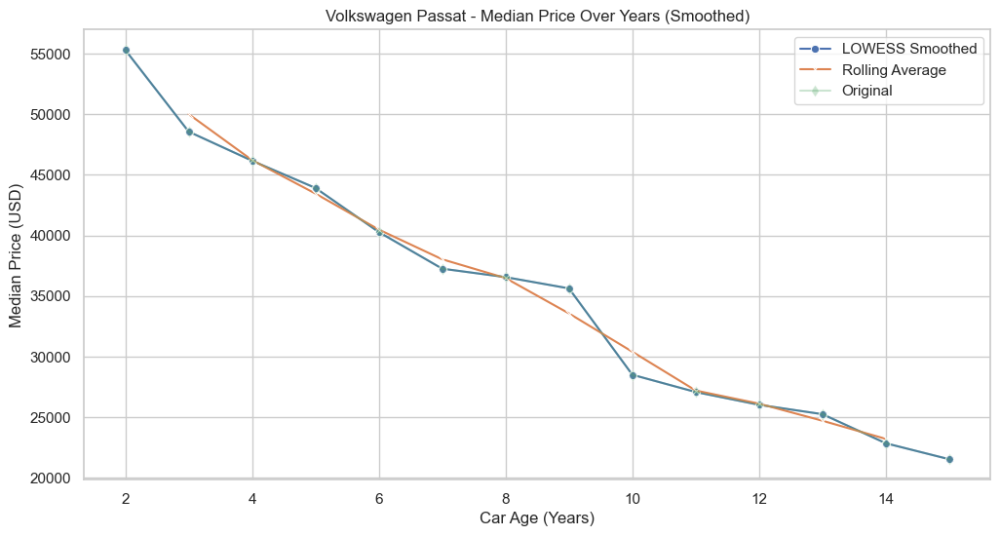

Volkswagen Passat - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 2              NaN         29      55304.83
2                 3           -12.18         54      48566.01
3                 4            -4.94        181      46164.82
4                 5            -4.87         94      43918.55
5                 6            -8.29        151      40278.03
6                 7            -7.50        214      37257.18
7                 8            -1.87        194      36560.06
8                 9            -2.54        202      35630.57
9                10           -20.00        126      28504.45
10               11            -5.00         97      27079.23
11               12            -3.89        102      26025.80
12               13            -2.98         57      25251.23
13               14            -9.51         30      22850.04
14               15            -5.76         21      21533.26
Processing Volkswagen P

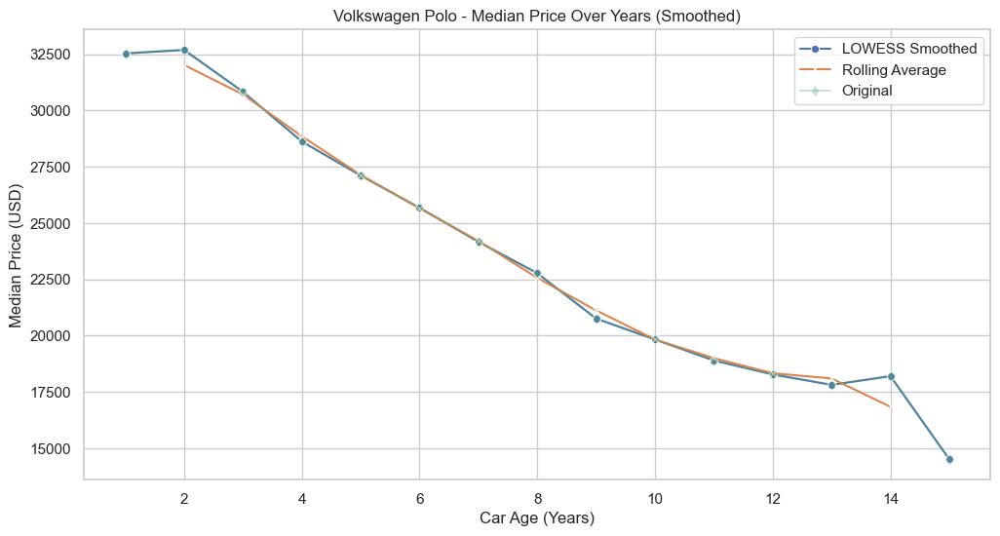

Volkswagen Polo - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         57      32532.26
2                 2             0.48         19      32687.17
3                 3            -5.69         59      30828.19
4                 4            -7.16         48      28620.64
5                 5            -5.28         27      27110.21
6                 6            -5.29         62      25677.24
7                 7            -5.88        109      24166.82
8                 8            -5.77        157      22772.58
9                 9            -8.84        140      20758.68
10               10            -4.48        154      19829.18
11               11            -4.69        180      18899.69
12               12            -3.29        174      18278.48
13               13            -2.53         72      17815.28
14               14             2.17         26      18202.57
15               15      

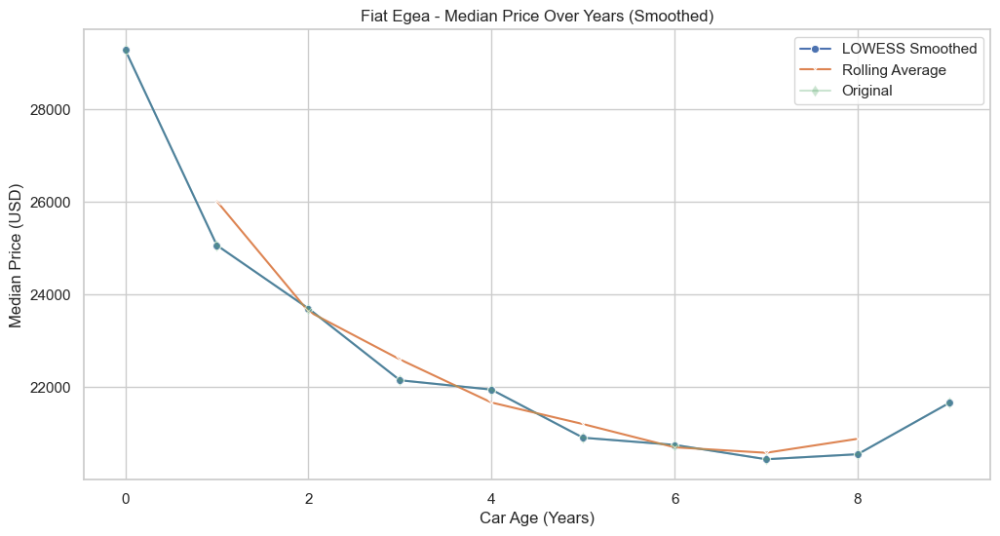

Fiat Egea - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                0              NaN         13      29279.03
1                1           -14.39        296      25065.33
2                2            -5.44        287      23702.07
3                3            -6.54        243      22152.92
4                4            -0.91        322      21951.53
5                5            -4.73        141      20913.59
6                6            -0.74         61      20758.68
7                7            -1.49         59      20448.85
8                8             0.53         49      20557.29
9                9             5.39          8      21664.93
Processing Toyota Corolla
Columns in median_prices for Toyota Corolla: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


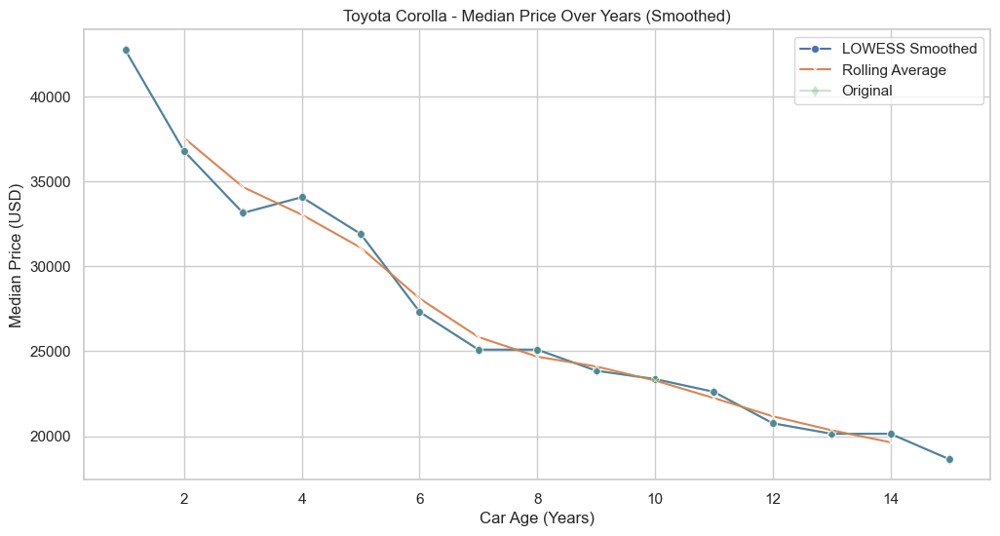

Toyota Corolla - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         69      42756.68
2                 2           -13.95         70      36792.43
3                 3            -9.89        146      33151.92
4                 4             2.80        164      34081.41
5                 5            -6.36         70      31912.59
6                 6           -14.37         64      27327.09
7                 7            -8.16        110      25096.31
8                 8             0.00        133      25096.31
9                 9            -4.94        132      23856.99
10               10            -2.08         59      23361.26
11               11            -3.22         55      22609.92
12               12            -8.19         51      20758.68
13               13            -2.99         88      20139.02
14               14             0.00         28      20139.02
15               15       

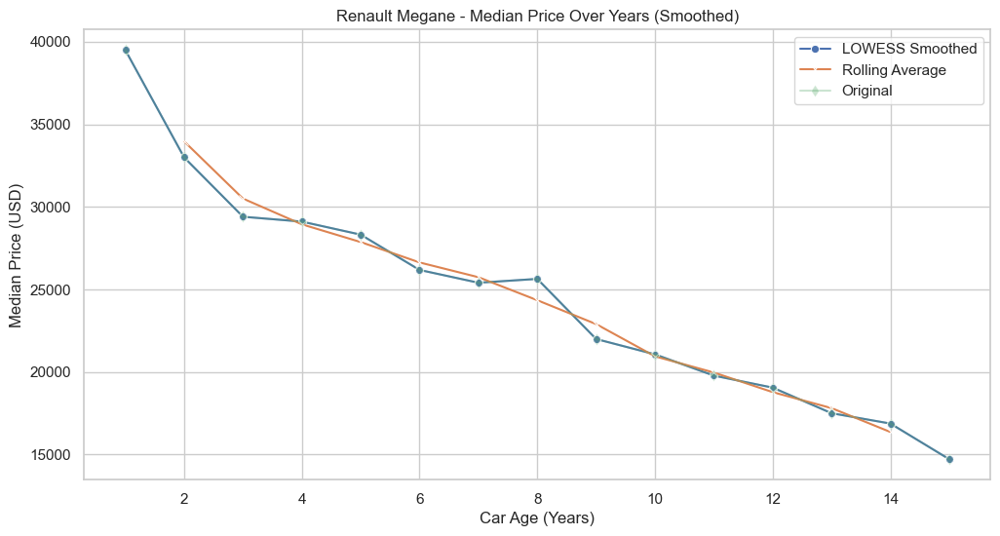

Renault Megane - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         82      39503.45
2                 2           -16.47         79      32997.00
3                 3           -10.89        101      29402.96
4                 4            -1.00        215      29108.62
5                 5            -2.71        118      28318.55
6                 6            -7.55        139      26180.72
7                 7            -2.96        182      25406.14
8                 8             0.91         76      25638.52
9                 9           -14.20         29      21998.00
10               10            -4.23         19      21068.51
11               11            -6.10         25      19782.71
12               12            -3.68         71      19054.61
13               13            -8.13         69      17505.45
14               14            -3.58         36      16878.04
15               15       

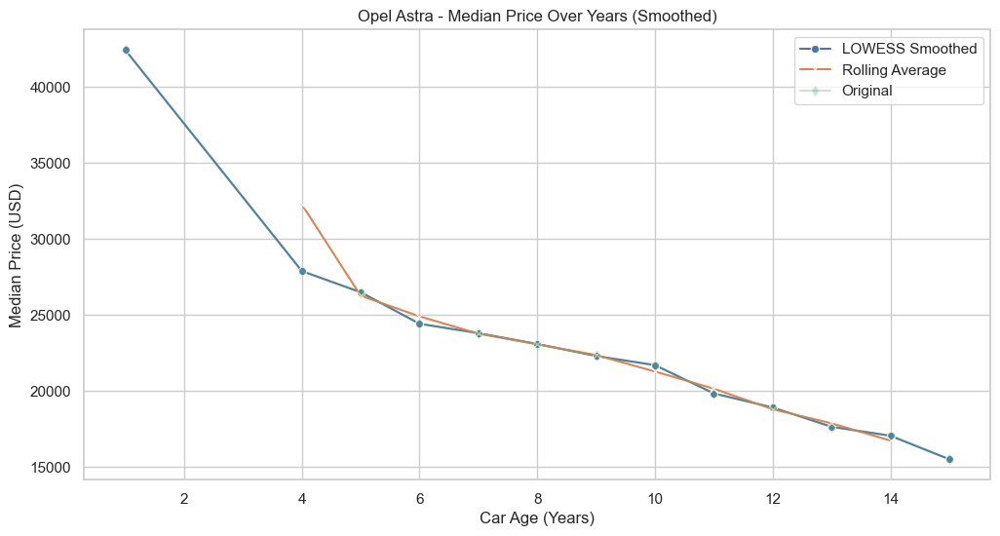

Opel Astra - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         22      42446.85
3                 4           -34.31         53      27884.79
4                 5            -5.00         40      26490.55
5                 6            -7.84         43      24414.68
6                 7            -2.54        145      23795.02
7                 8            -2.99        148      23082.41
8                 9            -3.42        128      22292.34
9                10            -2.71         89      21688.17
10               11            -8.57        173      19829.18
11               12            -4.69        227      18899.69
12               13            -6.72        180      17629.38
13               14            -3.34         64      17040.71
14               15            -9.09         33      15491.55
Processing Renault Clio
Columns in median_prices for Renault Clio: Index(['Car Age (Years)',

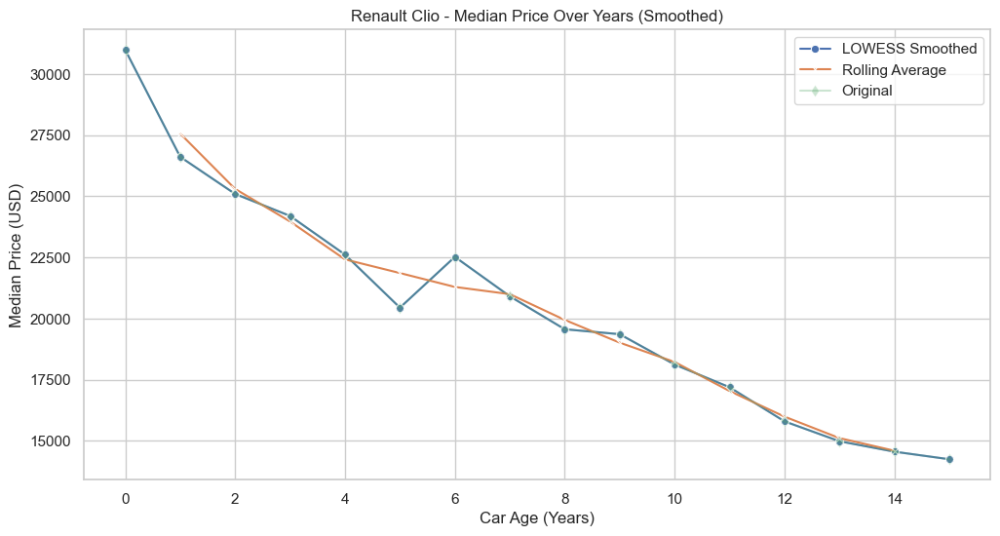

Renault Clio - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 0              NaN          7      30983.10
1                 1           -14.11        162      26612.93
2                 2            -5.70        111      25096.31
3                 3            -3.58        104      24197.80
4                 4            -6.53        190      22616.89
5                 5            -9.59         89      20448.85
6                 6            10.15         92      22524.71
7                 7            -7.15         98      20913.59
8                 8            -6.44         90      19565.83
9                 9            -1.03         95      19364.44
10               10            -6.40         77      18125.11
11               11            -5.13         94      17195.62
12               12            -8.11         47      15801.38
13               13            -5.15         28      14988.08
14               14         

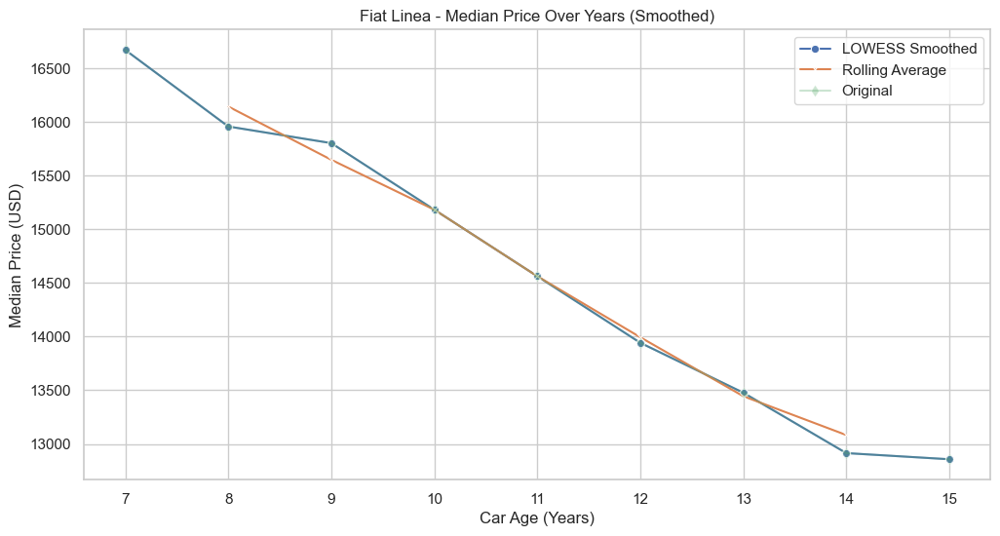

Fiat Linea - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                7              NaN        108      16668.91
2                8            -4.28         81      15956.30
3                9            -0.97        283      15801.38
4               10            -3.92        268      15181.72
5               11            -4.08        277      14562.06
6               12            -4.26        383      13942.40
7               13            -3.33        202      13477.65
8               14            -4.17         81      12915.19
9               15            -0.44         54      12857.99
Processing Volkswagen Golf
Columns in median_prices for Volkswagen Golf: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


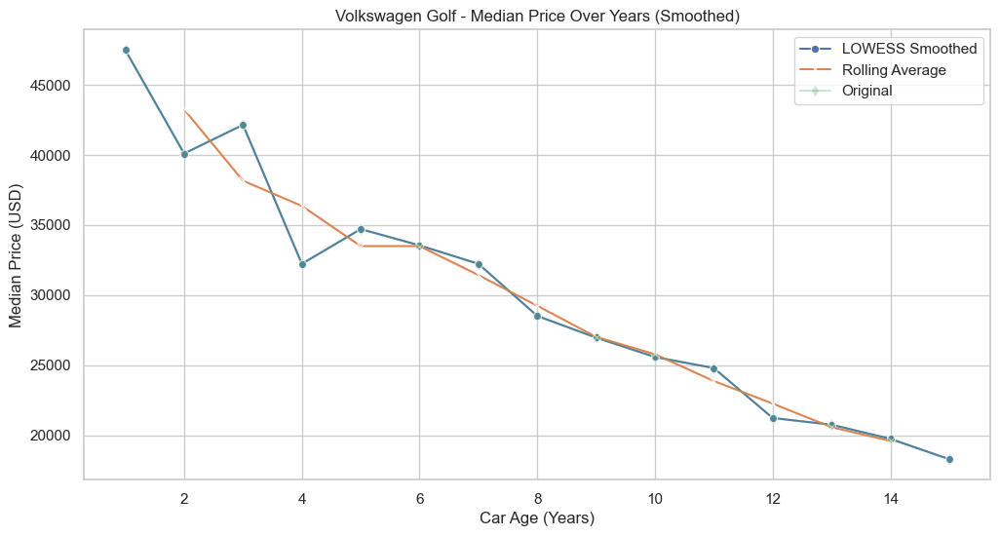

Volkswagen Golf - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         30      47481.60
2                 2           -15.56         33      40092.13
3                 3             5.10         29      42137.02
4                 4           -23.53         30      32222.42
5                 5             7.69         56      34701.07
6                 6            -3.35         76      33539.21
7                 7            -3.93        129      32222.42
8                 8           -11.54        201      28504.45
9                 9            -5.43        209      26955.30
10               10            -5.12         99      25574.63
11               11            -3.08        154      24786.48
12               12           -14.38        134      21223.42
13               13            -2.26         74      20743.19
14               14            -4.85         41      19736.24
15               15      

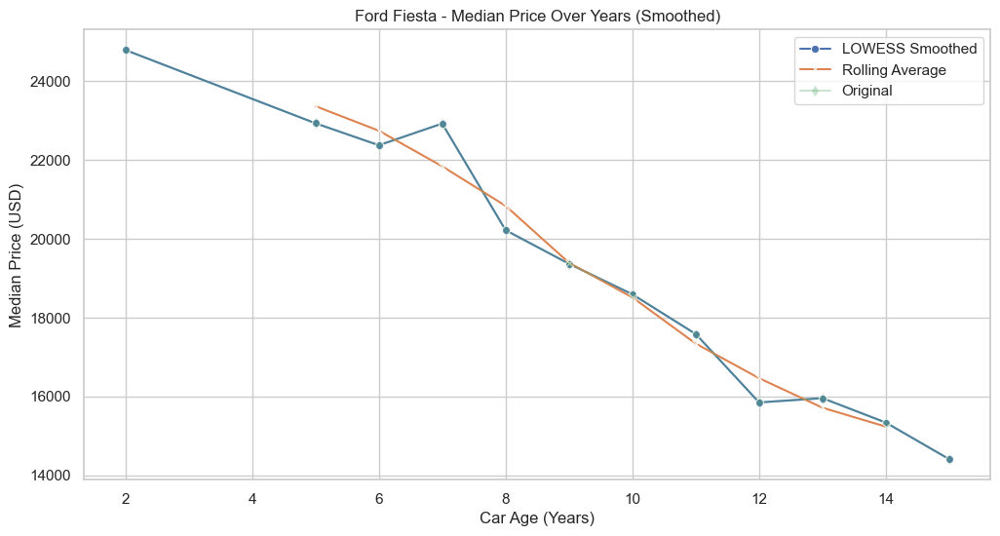

Ford Fiesta - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 2              NaN          5      24786.48
4                 5            -7.50         11      22927.49
5                 6            -2.43         10      22369.80
6                 7             2.46         33      22919.75
7                 8           -11.79         76      20216.47
8                 9            -4.21        106      19364.44
9                10            -4.00         70      18589.86
10               11            -5.42        203      17582.56
11               12            -9.87        258      15847.86
12               13             0.68        238      15956.30
13               14            -3.88        136      15336.63
14               15            -6.06         75      14407.14
Processing Renault Symbol
Columns in median_prices for Renault Symbol: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'L

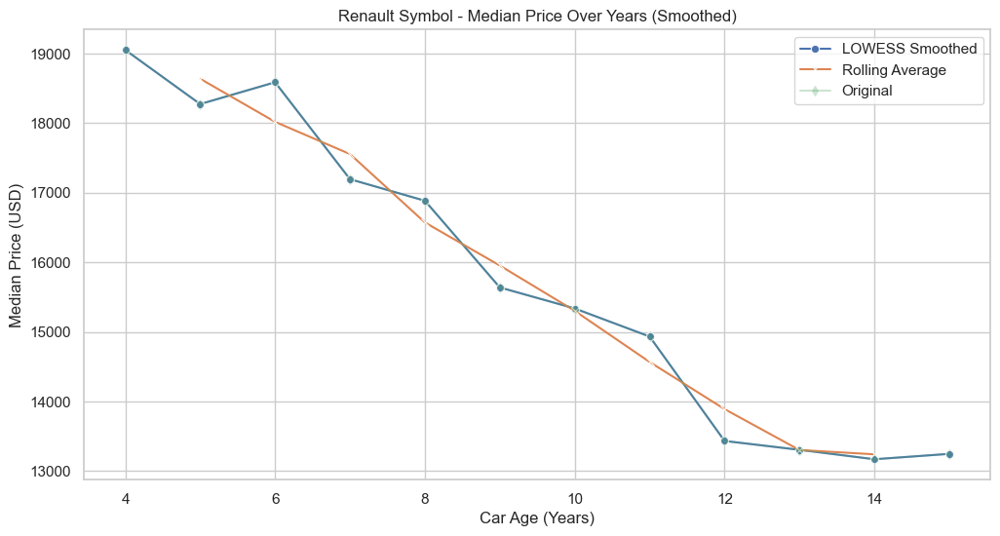

Renault Symbol - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 4              NaN         56      19054.61
1                 5            -4.09         42      18276.16
2                 6             1.72         44      18589.86
3                 7            -7.50        119      17195.62
4                 8            -1.80        154      16885.79
5                 9            -7.39        148      15638.72
6                10            -1.93        106      15336.63
7                11            -2.64        152      14932.51
8                12           -10.05        168      13431.17
9                13            -0.95        180      13303.37
10               14            -1.02        120      13167.82
11               15             0.59        101      13245.28
Processing Renault Fluence
Columns in median_prices for Renault Fluence: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
    

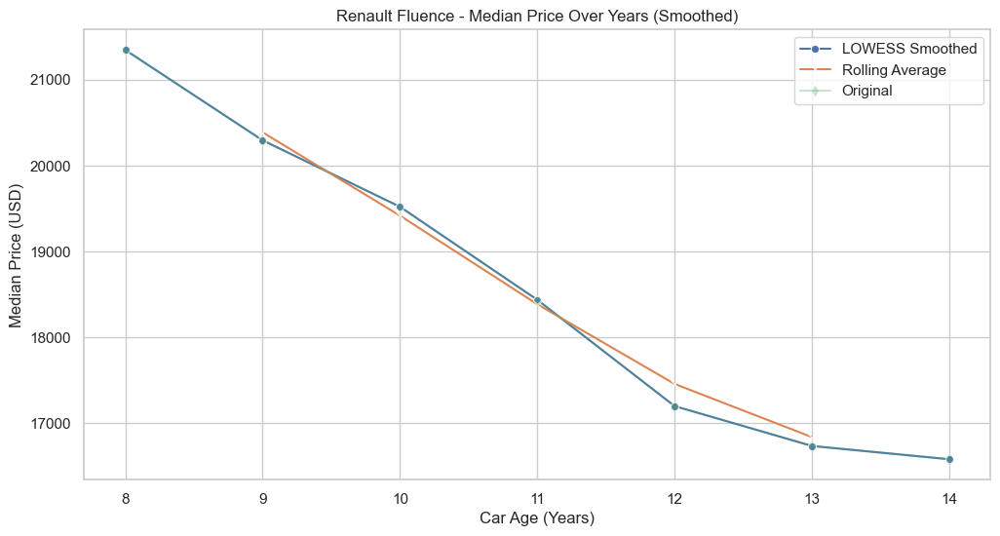

Renault Fluence - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                8              NaN        207      21347.36
1                9            -4.93        244      20293.93
2               10            -3.82        234      19519.35
3               11            -5.56        207      18434.94
4               12            -6.72        219      17195.62
5               13            -2.70        211      16730.87
6               14            -0.93         85      16575.96
Processing BMW 3 Series
Columns in median_prices for BMW 3 Series: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


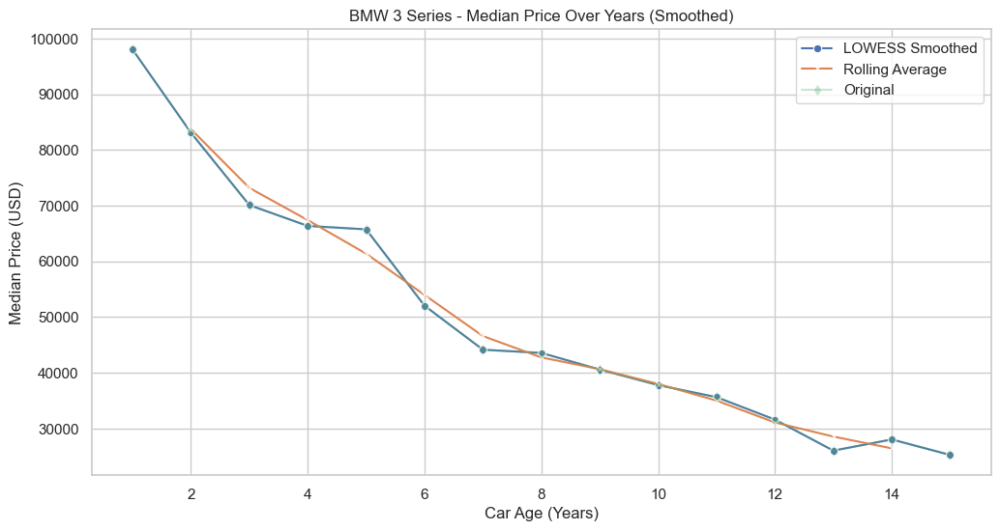

BMW 3 Series - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          9      98061.51
1                 2           -15.24         15      83117.55
2                 3           -15.63         32      70122.50
3                 4            -5.34         36      66381.29
4                 5            -0.93         14      65761.63
5                 6           -20.85         49      52051.61
6                 7           -15.18         49      44150.92
7                 8            -1.30        120      43575.95
8                 9            -6.86        130      40587.86
9                10            -6.87        151      37799.38
10               11            -5.74        103      35630.57
11               12           -11.30        115      31602.76
12               13           -17.65         66      26025.80
13               14             7.74         33      28039.71
14               15         

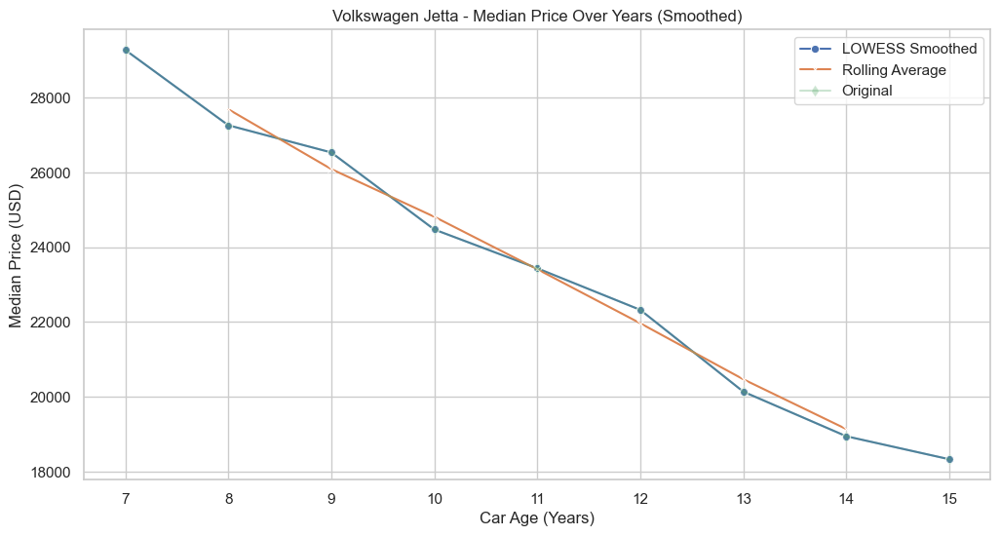

Volkswagen Jetta - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN         87      29279.03
1                8            -6.88         94      27265.13
2                9            -2.67        178      26537.03
3               10            -7.76        165      24476.65
4               11            -4.24        168      23438.72
5               12            -4.74        204      22326.83
6               13            -9.80        121      20139.02
7               14            -5.92         40      18946.17
8               15            -3.25         24      18330.90
Processing Hyundai i20
Columns in median_prices for Hyundai i20: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


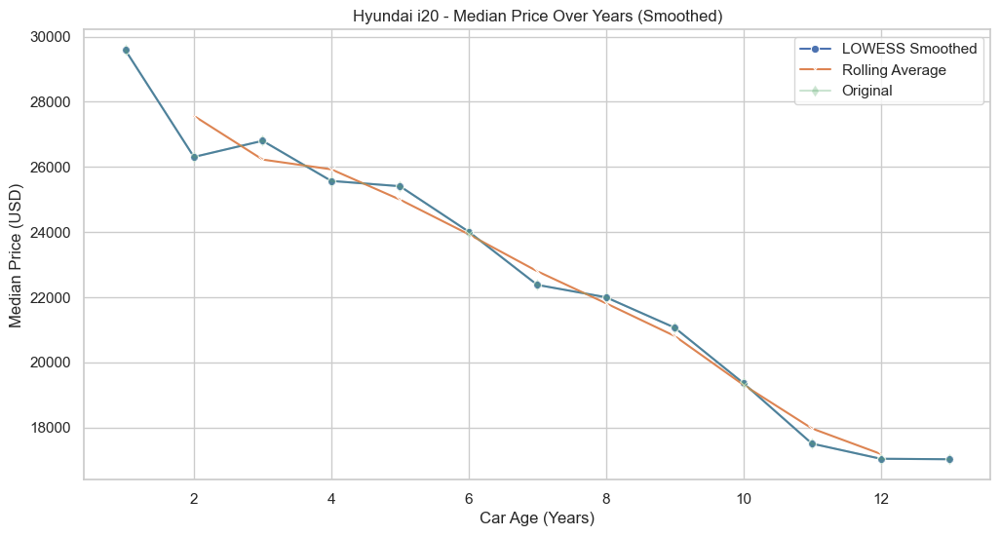

Hyundai i20 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         66      29588.86
2                 2           -11.10         63      26304.65
3                 3             1.88         65      26800.38
4                 4            -4.60         30      25568.03
5                 5            -0.63         33      25406.14
6                 6            -5.49         67      24011.90
7                 7            -6.81         79      22377.80
8                 8            -1.70        101      21998.00
9                 9            -4.24        107      21065.41
10               10            -8.07         80      19364.44
11               11            -9.60         57      17505.45
12               12            -2.65         37      17040.71
13               13            -0.09         12      17025.21
Processing Tofaş Şahin
No data available for Tofaş Şahin after applying filters.
Processing

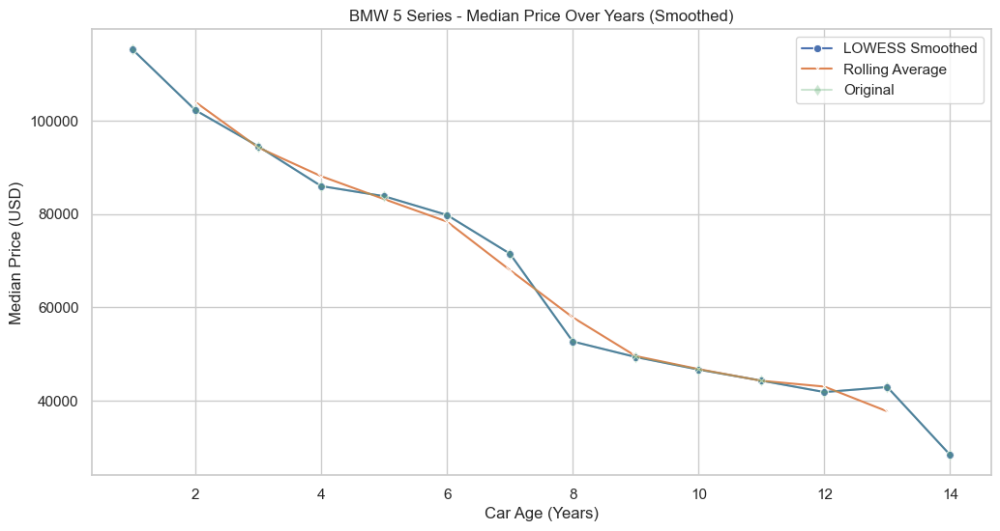

BMW 5 Series - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         21     115257.14
1                 2           -11.29         23     102244.23
2                 3            -7.58         19      94498.46
3                 4            -9.02         31      85978.10
4                 5            -2.53          8      83806.38
5                 6            -4.80         63      79781.48
6                 7           -10.39         82      71493.51
7                 8           -26.33         87      52669.72
8                 9            -6.32         72      49340.59
9                10            -5.47         80      46643.47
10               11            -5.08         63      44274.85
11               12            -5.53         57      41827.19
12               13             2.59         34      42911.59
13               14           -33.94          5      28346.44
Processing Opel Vectra
No da

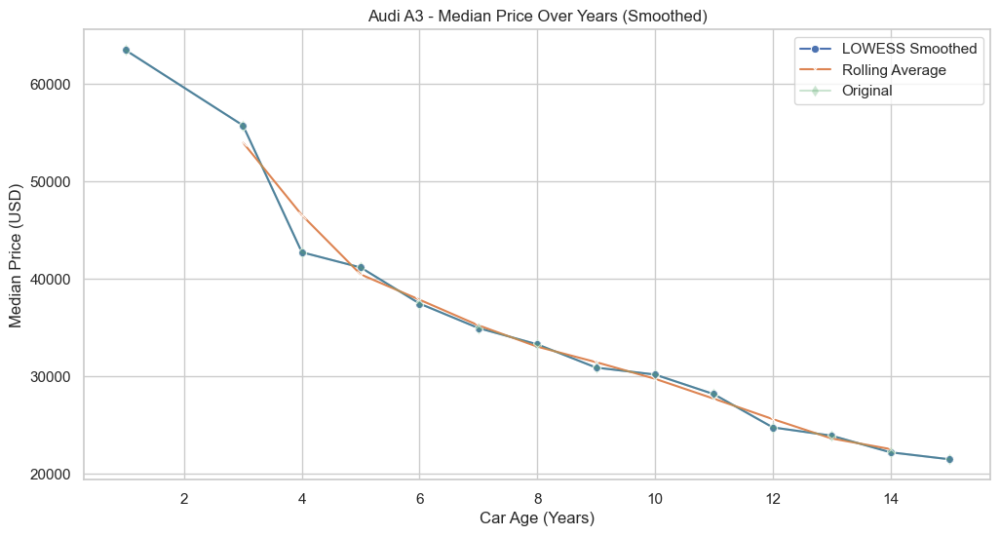

Audi A3 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         26      63513.81
3                 3           -12.19         17      55769.58
4                 4           -23.33         61      42756.68
5                 5            -3.66         38      41192.03
6                 6            -8.99         37      37489.55
7                 7            -6.69         93      34979.92
8                 8            -4.78         99      33306.83
9                 9            -7.16        103      30921.13
10               10            -2.30         49      30208.52
11               11            -6.67         39      28194.62
12               12           -12.09         43      24786.48
13               13            -3.44         22      23934.45
14               14            -7.12         14      22230.37
15               15            -3.21         16      21516.21
Processing Fiat Palio
Columns in 

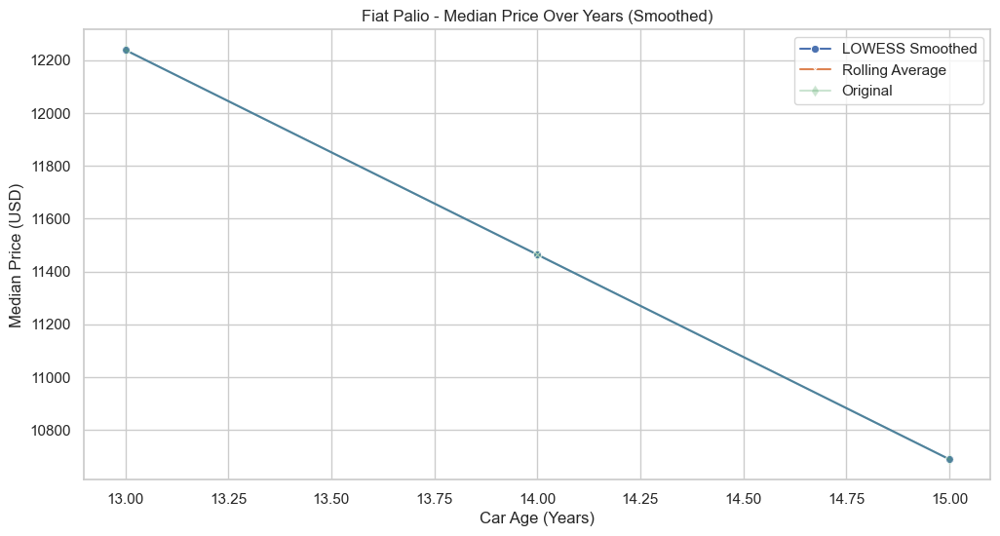

Fiat Palio - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
4               13              NaN         13      12238.32
5               14            -6.33         11      11463.75
6               15            -6.76         15      10689.17
Processing Fiat Punto
Columns in median_prices for Fiat Punto: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


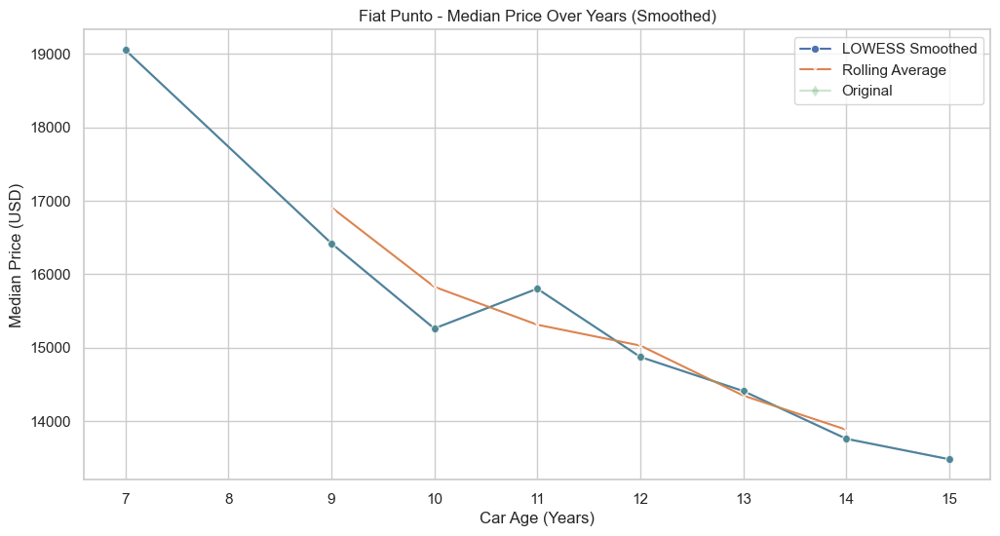

Fiat Punto - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN          5      19054.61
2                9           -13.82         17      16421.04
3               10            -7.08         32      15259.18
4               11             3.55         63      15801.38
5               12            -5.88        129      14871.89
6               13            -3.12        152      14407.14
7               14            -4.52         47      13756.50
8               15            -2.03         65      13477.65
Processing Tofaş Doğan
No data available for Tofaş Doğan after applying filters.
Processing Mercedes C
Columns in median_prices for Mercedes C: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


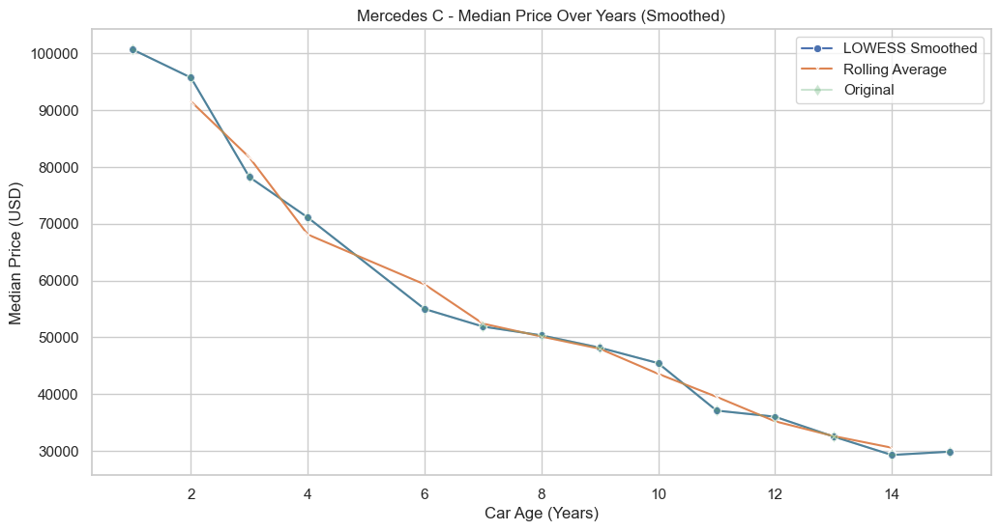

Mercedes C - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         11     100695.08
1                 2            -4.92         30      95737.78
2                 3           -18.28         21      78232.33
3                 4            -9.11         23      71106.22
5                 6           -22.66         49      54995.00
6                 7            -5.63         81      51896.69
7                 8            -2.99        101      50347.54
8                 9            -4.31         70      48178.72
9                10            -5.66         24      45450.66
10               11           -18.38         34      37098.39
11               12            -2.91         48      36017.85
12               13            -9.68         49      32532.26
13               14           -10.00         23      29279.03
14               15             2.00         18      29863.84
Processing Seat Leon
Columns i

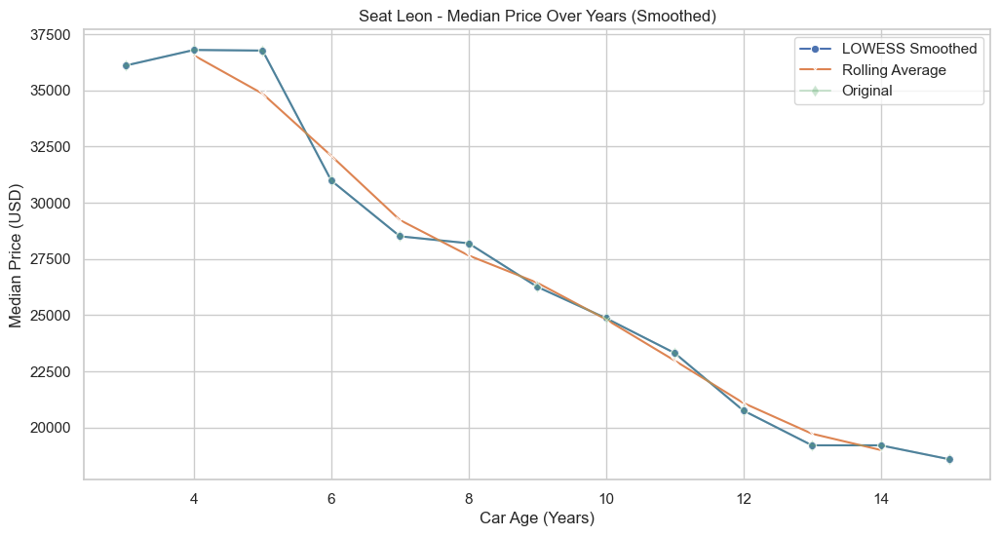

Seat Leon - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2                 3              NaN         17      36095.31
3                 4             1.93         48      36792.43
4                 5            -0.08         25      36763.53
5                 6           -15.72         62      30983.10
6                 7            -8.00        106      28504.45
7                 8            -1.09        115      28194.62
8                 9            -6.87         68      26258.18
9                10            -5.31         40      24863.94
10               11            -6.23         24      23314.78
11               12           -10.96         27      20758.68
12               13            -7.46         23      19209.52
13               14             0.00         13      19209.52
14               15            -3.23          9      18589.86
Processing Peugeot 206
Columns in median_prices for Peugeot 206: Index(['Car Age (Years)', 'U

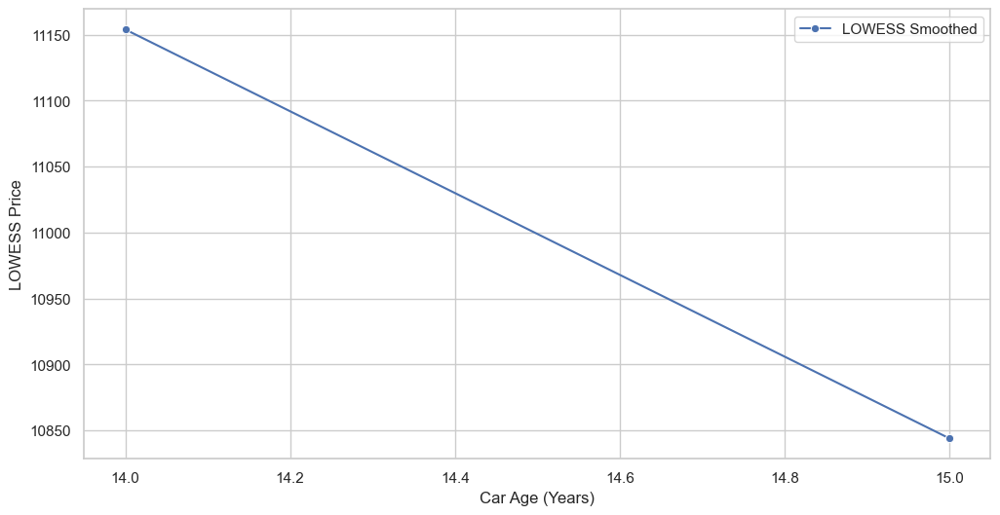

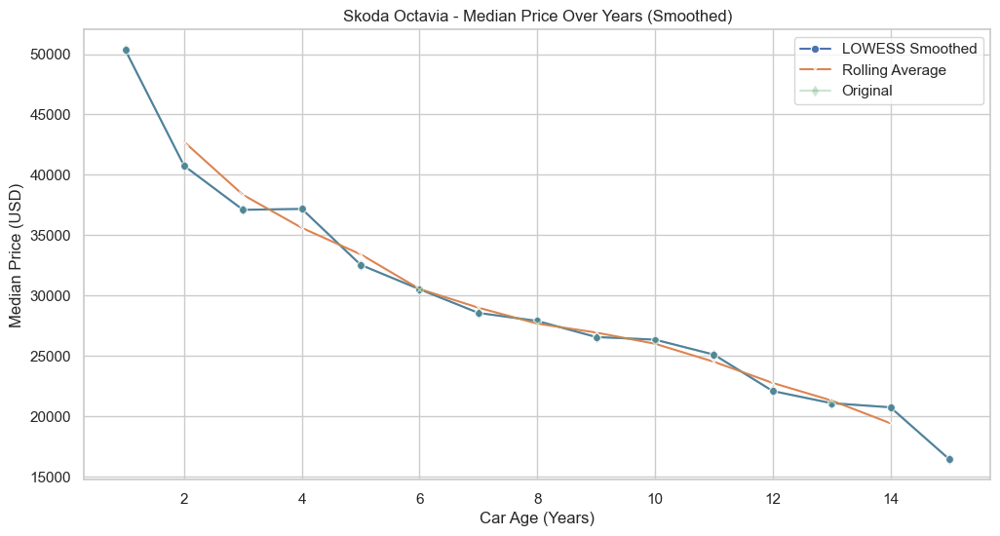

Skoda Octavia - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         11      50347.54
2                 2           -19.08          5      40742.78
3                 3            -8.94         26      37098.39
4                 4             0.20         11      37171.98
5                 5           -12.48         61      32532.26
6                 6            -6.20         40      30514.48
7                 7            -6.43         48      28550.93
8                 8            -2.33         76      27884.79
9                 9            -4.78         70      26552.52
10               10            -0.82         31      26335.64
11               11            -4.71         27      25096.31
12               12           -12.04         34      22075.46
13               13            -4.56         19      21068.51
14               14            -1.62         11      20727.69
15               15        

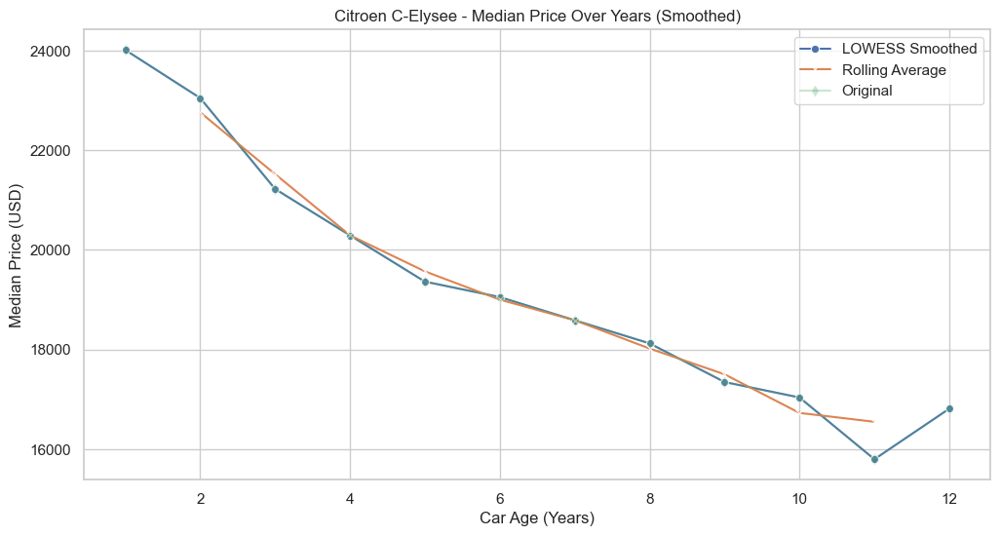

Citroen C-Elysee - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         17      24011.90
1                 2            -4.02         22      23047.55
2                 3            -7.91         39      21223.42
3                 4            -4.39         32      20292.38
4                 5            -4.57         30      19364.44
5                 6            -1.60         33      19054.61
6                 7            -2.44         60      18589.85
7                 8            -2.50         80      18125.11
8                 9            -4.27         69      17350.54
9                10            -1.79         40      17040.71
10               11            -7.27         71      15801.38
11               12             6.42          9      16816.08
Processing Mercedes E
Columns in median_prices for Mercedes E: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWE

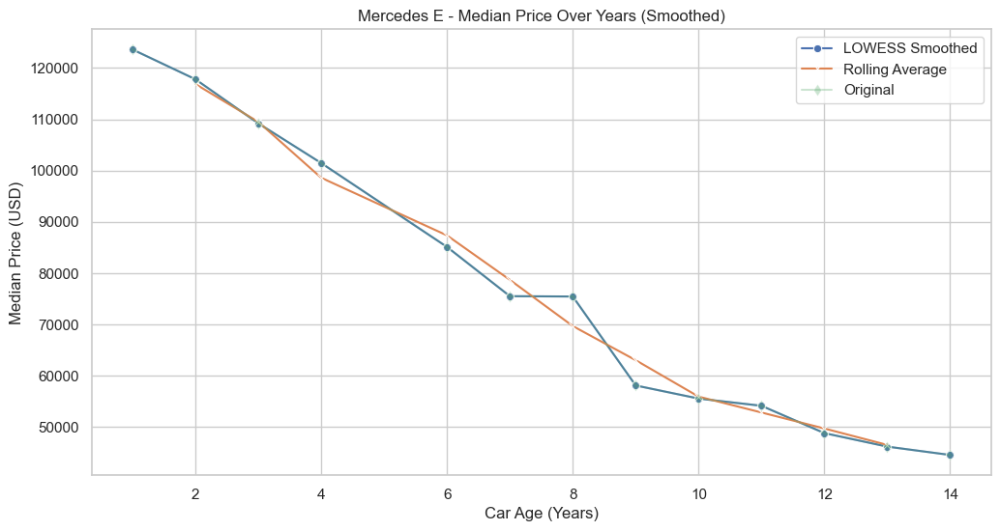

Mercedes E - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         15     123622.57
1                 2            -4.70         16     117813.24
2                 3            -7.30          9     109215.43
3                 4            -7.09         31     101469.66
5                 6           -16.12         22      85110.58
6                 7           -11.29         24      75504.27
7                 8            -0.08         30      75443.85
8                 9           -23.00         38      58091.76
9                10            -4.40         42      55537.21
10               11            -2.54         29      54127.48
11               12            -9.85         19      48798.38
12               13            -5.40         27      46164.82
13               14            -3.53         14      44536.66
Processing Dacia Sandero
Columns in median_prices for Dacia Sandero: Index(['Car Age (Years)

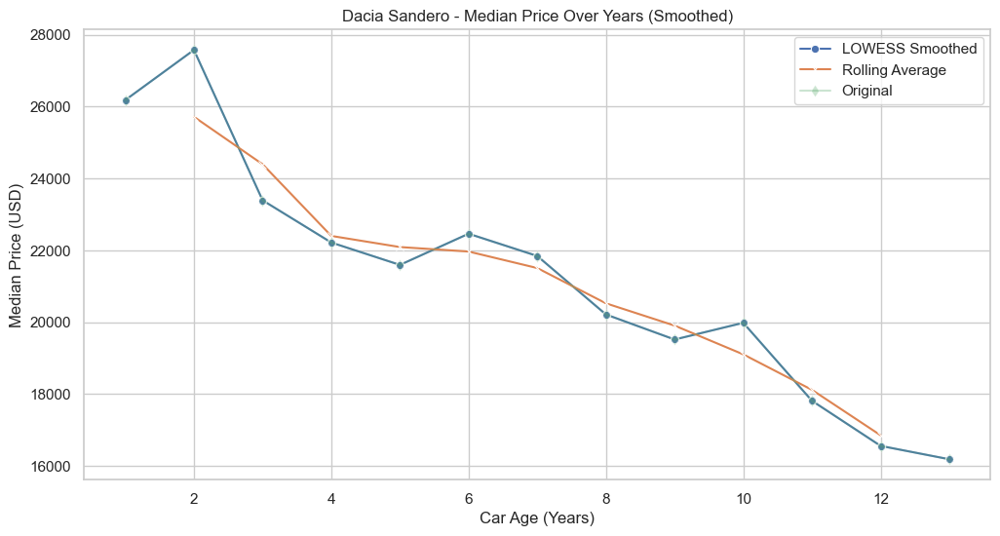

Dacia Sandero - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          8      26179.95
1                 2             5.33          9      27574.96
2                 3           -15.17         27      23392.24
3                 4            -5.02         25      22217.96
4                 5            -2.80         42      21595.22
5                 6             4.02         39      22462.75
6                 7            -2.76         70      21843.09
7                 8            -7.45         65      20216.47
8                 9            -3.45         44      19519.35
9                10             2.38         15      19984.10
10               11           -10.85         34      17815.28
11               12            -7.04         16      16560.47
12               13            -2.25         14      16188.67
Processing Audi A4
Columns in median_prices for Audi A4: Index(['Car Age (Years)', 'USD A

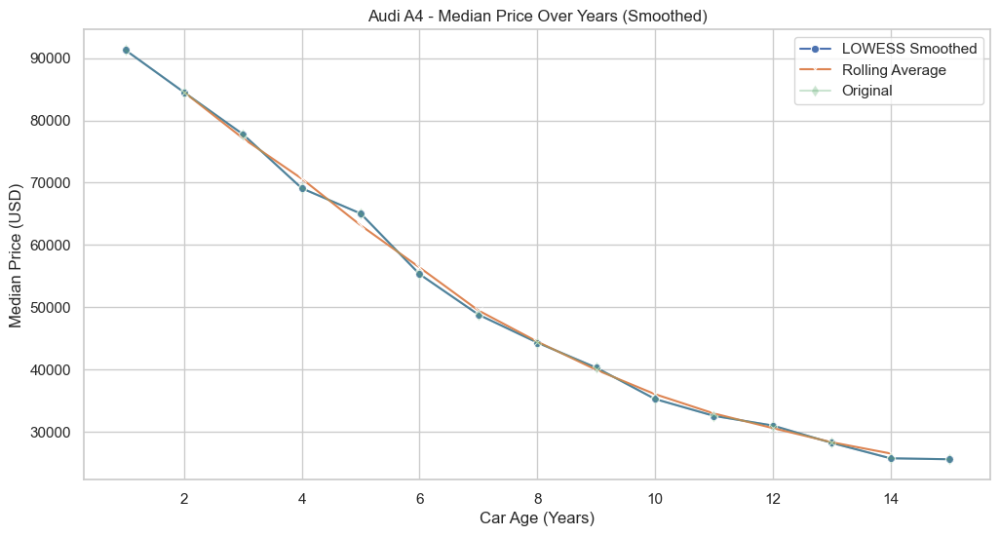

Audi A4 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          8      91322.69
1                 2            -7.46          8      84506.41
2                 3            -7.97          8      77767.57
3                 4           -11.16         13      69092.31
4                 5            -5.87          5      65033.53
5                 6           -14.97         38      55300.96
6                 7           -11.76         42      48798.38
7                 8            -9.21         65      44305.83
8                 9            -9.09         41      40278.03
9                10           -12.50         46      35243.28
10               11            -7.69         25      32532.26
11               12            -4.76         22      30983.09
12               13            -9.00         28      28194.62
13               14            -8.79         19      25715.97
14               15            -0

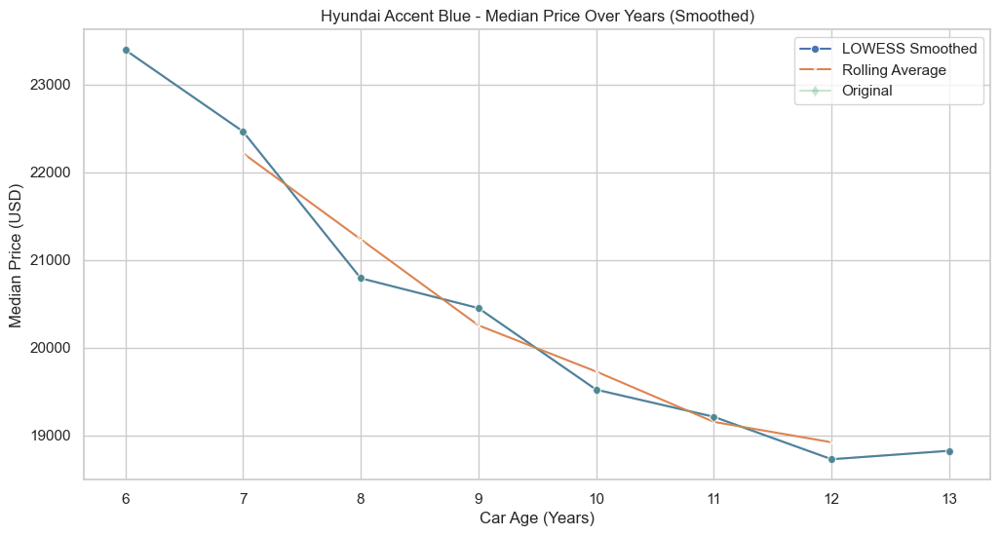

Hyundai Accent Blue - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN         59      23392.24
2                7            -3.97         44      22462.75
3                8            -7.45         63      20789.66
4                9            -1.64         94      20448.85
5               10            -4.55         62      19519.35
6               11            -1.59         62      19209.52
7               12            -2.52         76      18725.57
8               13             0.52         16      18822.23
Processing Citroen C4
Columns in median_prices for Citroen C4: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


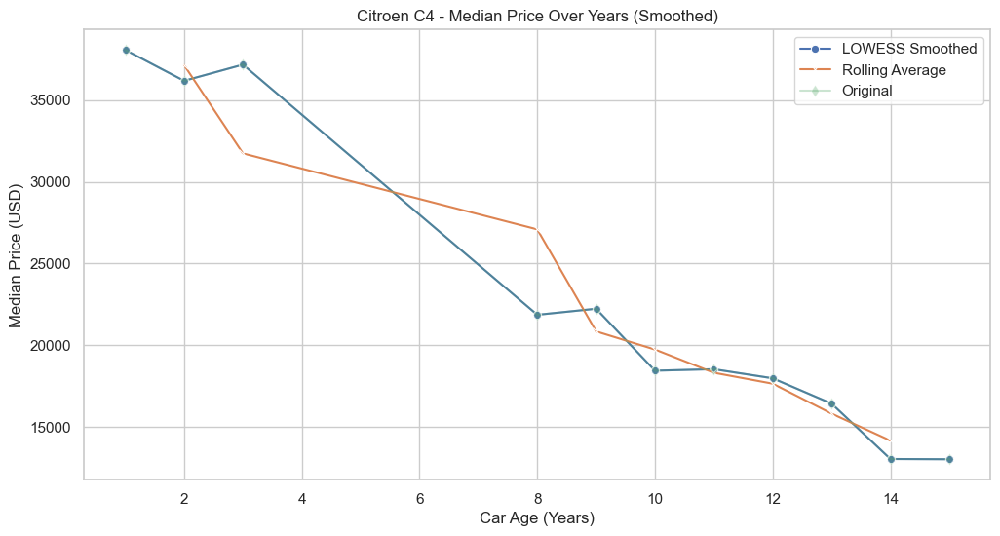

Citroen C4 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         15      38078.23
1                 2            -4.96          7      36188.26
2                 3             2.74          7      37179.72
7                 8           -41.21          7      21858.58
8                 9             1.70         18      22230.37
9                10           -17.07         17      18434.94
10               11             0.50         35      18527.89
11               12            -3.01         97      17970.20
12               13            -8.62         45      16421.04
13               14           -20.66         23      13028.39
14               15            -0.12         34      13012.90
Processing Seat Ibiza
Columns in median_prices for Seat Ibiza: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


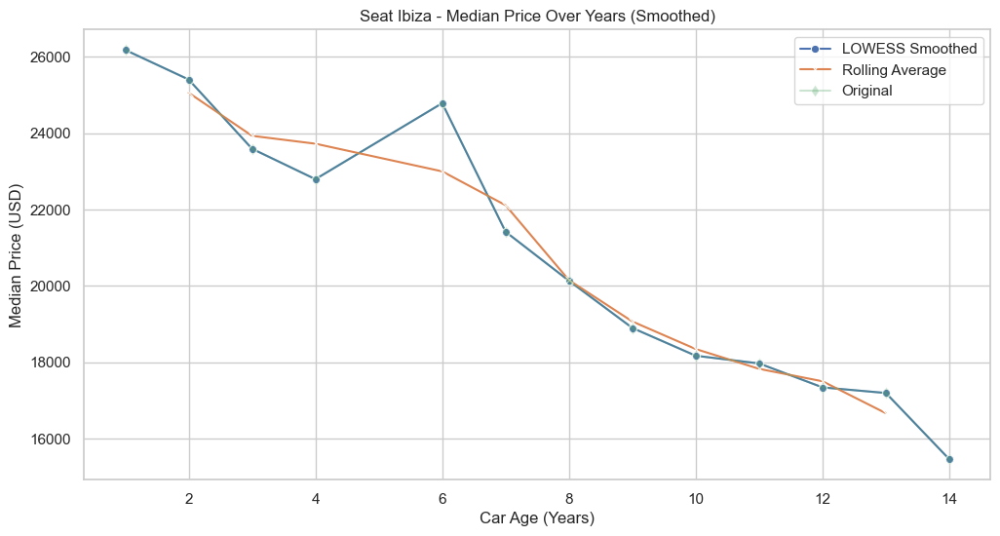

Seat Ibiza - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         11      26180.72
1                 2            -2.96         13      25406.14
2                 3            -7.14         24      23592.86
3                 4            -3.38         11      22795.82
5                 6             8.73          9      24786.48
6                 7           -13.59         39      21418.75
7                 8            -5.99         58      20135.14
8                 9            -6.14         50      18899.69
9                10            -3.85         36      18171.59
10               11            -1.11         27      17970.20
11               12            -3.49         28      17342.80
12               13            -0.85         17      17195.62
13               14           -10.09          5      15460.57
Processing Ford Mondeo
Columns in median_prices for Ford Mondeo: Index(['Car Age (Years)', '

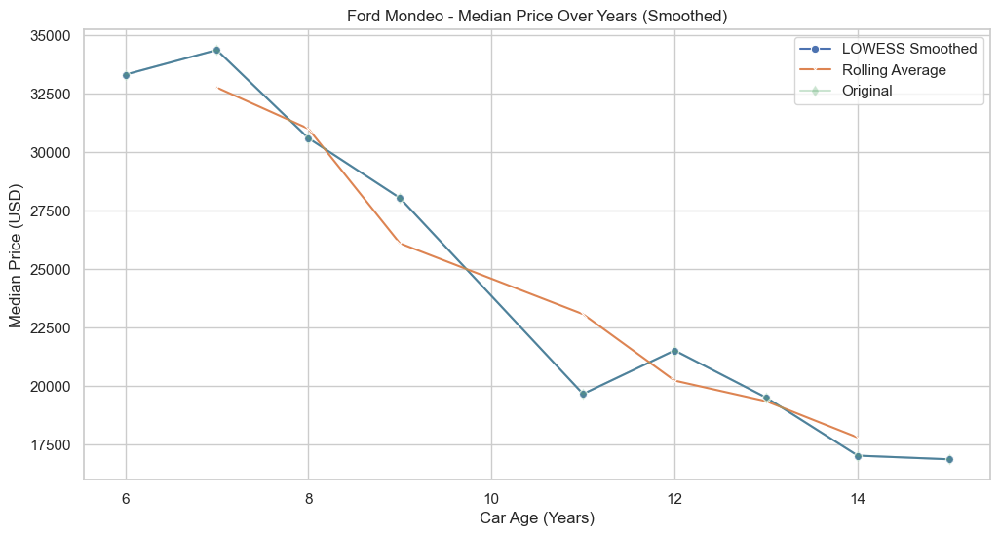

Ford Mondeo - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2                 6              NaN          5      33306.83
3                 7             3.16          9      34360.26
4                 8           -10.96         13      30595.81
5                 9            -8.35         33      28039.71
7                11           -29.83          7      19674.27
8                12             9.45         33      21533.26
9                13            -9.35         37      19519.35
10               14           -12.70         22      17040.71
11               15            -0.91         29      16885.79
Processing Chevrolet Cruze
Columns in median_prices for Chevrolet Cruze: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


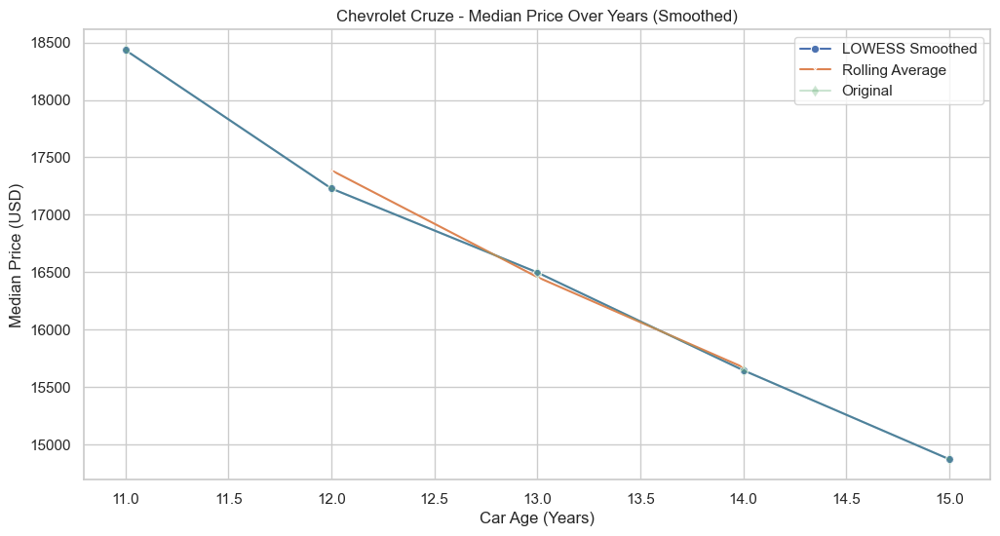

Chevrolet Cruze - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               11              NaN         41      18434.94
1               12            -6.54        144      17229.25
2               13            -4.24        120      16498.50
3               14            -5.16        111      15646.47
4               15            -4.95         15      14871.89
Processing Citroen C3
Columns in median_prices for Citroen C3: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


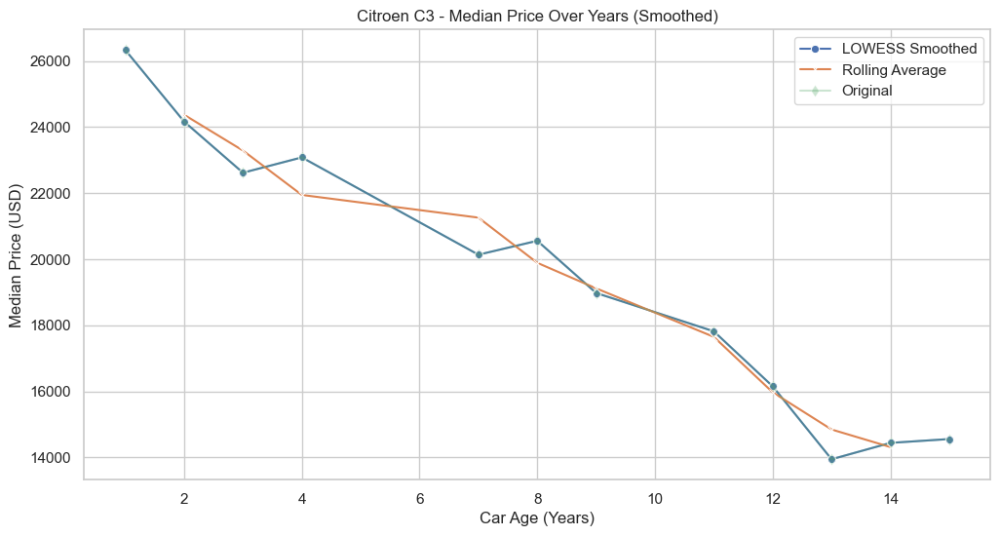

Citroen C3 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         34      26335.64
2                 2            -8.24         16      24166.82
3                 3            -6.41         31      22617.66
4                 4             2.05         38      23082.41
7                 7           -12.77         25      20135.92
8                 8             2.09          6      20557.29
9                 9            -7.69          6      18977.15
11               11            -6.12         15      17815.28
12               12            -9.35         20      16149.94
13               13           -13.67         27      13942.40
14               14             3.56         12      14438.12
15               15             0.80          6      14554.31
Processing Skoda SuperB
Columns in median_prices for Skoda SuperB: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS

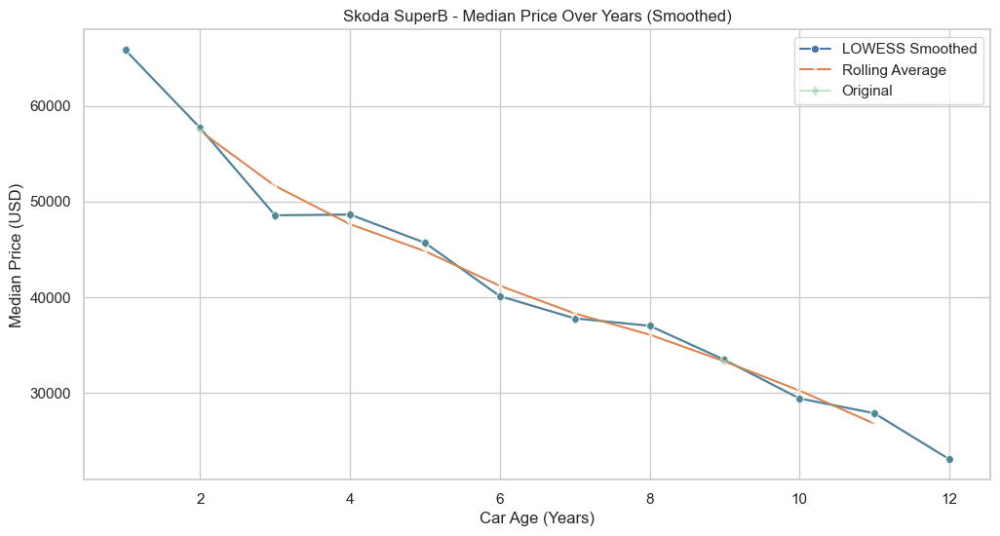

Skoda SuperB - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         19      65839.09
1                 2           -12.38         12      57690.53
2                 3           -15.82         12      48566.01
3                 4             0.16         43      48643.47
4                 5            -6.05         21      45700.07
5                 6           -12.20         35      40123.12
6                 7            -5.79         61      37799.38
7                 8            -2.05         47      37024.81
8                 9            -9.62         28      33461.75
9                10           -12.04         18      29433.95
10               11            -5.26         14      27884.79
11               12           -17.22          9      23082.41
Processing BMW 1 Series
Columns in median_prices for BMW 1 Series: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWE

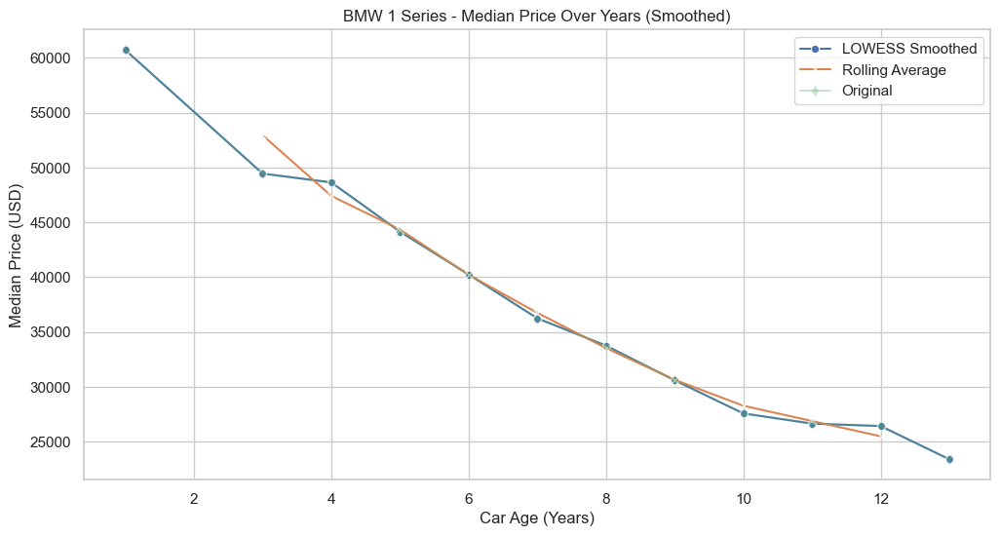

BMW 1 Series - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          5      60726.88
2                 3           -18.57         13      49449.03
3                 4            -1.63         15      48643.47
4                 5            -9.24          8      44150.92
5                 6            -8.84         17      40247.05
6                 7            -9.93         33      36250.23
7                 8            -6.87         42      33761.34
8                 9            -9.38         38      30595.81
9                10            -9.87         35      27574.96
10               11            -3.37         29      26645.47
11               12            -0.84         44      26421.69
12               13           -11.47         30      23392.24
Processing Skoda Fabia
Columns in median_prices for Skoda Fabia: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS

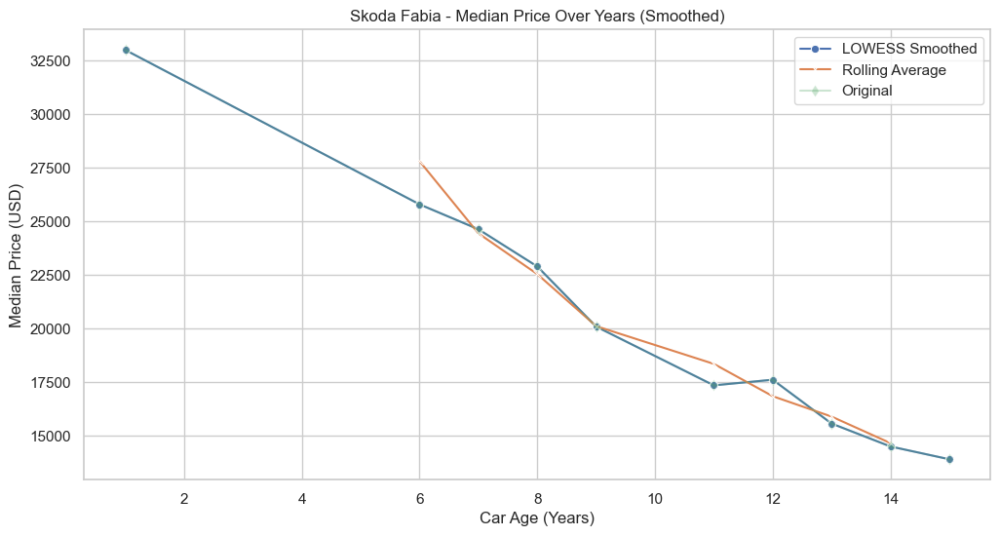

Skoda Fabia - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         12      32997.00
5                 6           -21.83          8      25793.43
6                 7            -4.50         13      24631.57
7                 8            -7.04         18      22896.51
8                 9           -12.25         15      20092.54
10               11           -13.65          5      17350.54
11               12             1.52         18      17613.89
12               13           -11.61         30      15569.01
13               14            -6.87          5      14500.09
14               15            -4.11          6      13903.67
Processing Chevrolet Aveo
Columns in median_prices for Chevrolet Aveo: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


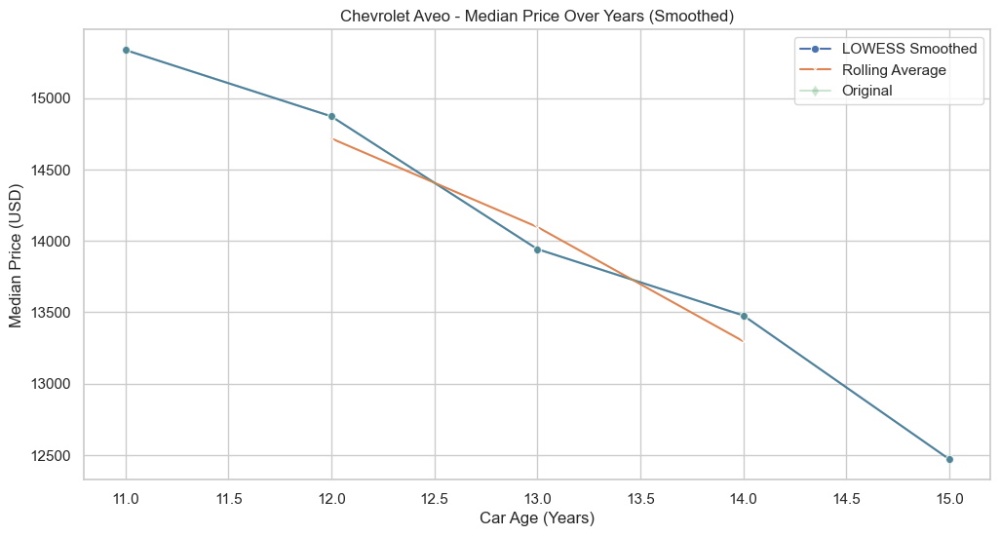

Chevrolet Aveo - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1               11              NaN         31      15336.63
2               12            -3.03        128      14871.89
3               13            -6.25         89      13942.40
4               14            -3.33         21      13477.65
5               15            -7.47         16      12470.70
Processing Peugeot 301
Columns in median_prices for Peugeot 301: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


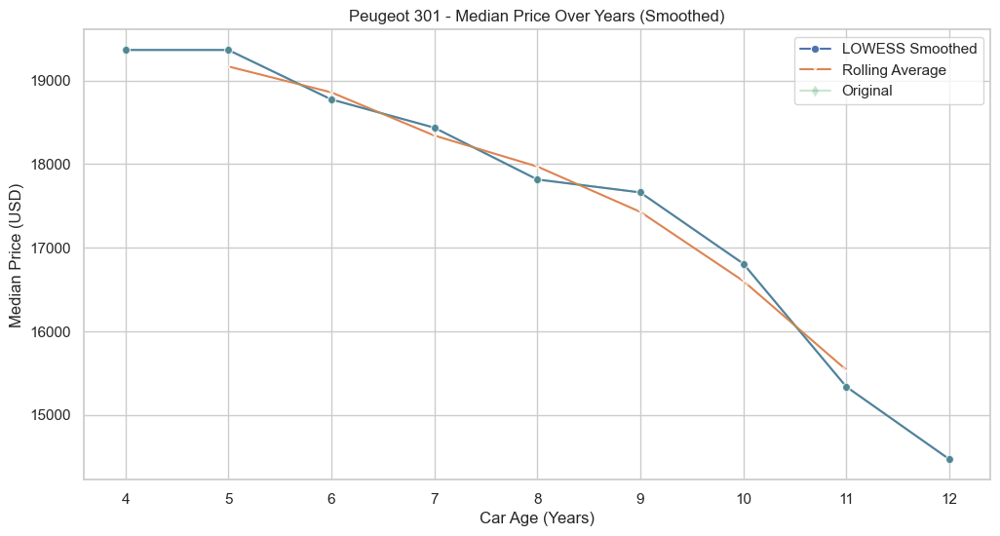

Peugeot 301 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                4              NaN         39      19364.44
1                5             0.00         37      19364.44
2                6            -3.06         53      18772.66
3                7            -1.80         59      18434.94
4                8            -3.36         37      17815.28
5                9            -0.87         25      17660.37
6               10            -4.82         20      16808.33
7               11            -8.76         19      15336.63
8               12            -5.66          5      14469.11
Processing Renault 1.5 dCi Joy
Columns in median_prices for Renault 1.5 dCi Joy: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


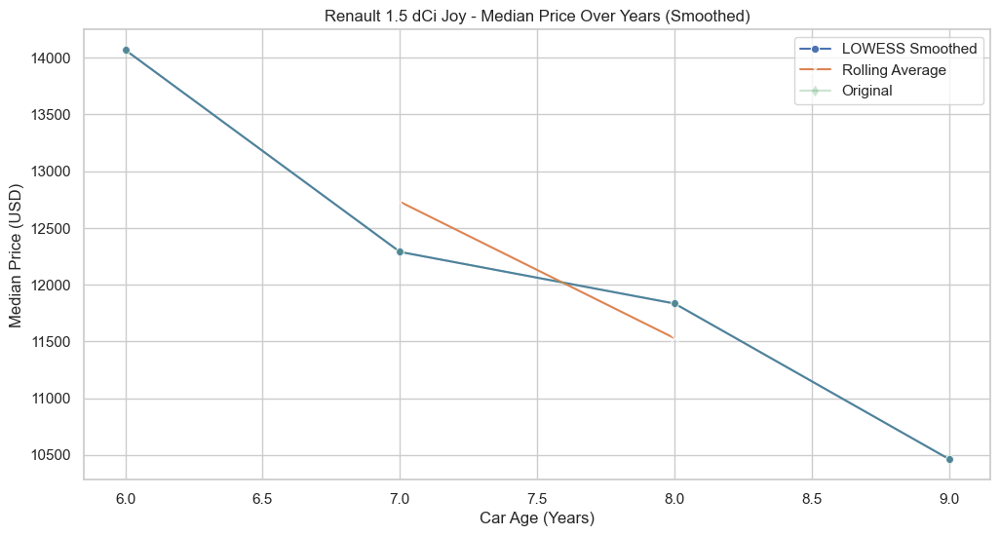

Renault 1.5 dCi Joy - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN         11      14068.96
2                7           -12.65        291      12288.95
3                8            -3.70         44      11833.66
4                9           -11.60          6      10460.98
Processing Renault Laguna
Columns in median_prices for Renault Laguna: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Renault Laguna: 'y'
Processing Hyundai Accent Era
Columns in median_prices for Hyundai Accent Era: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


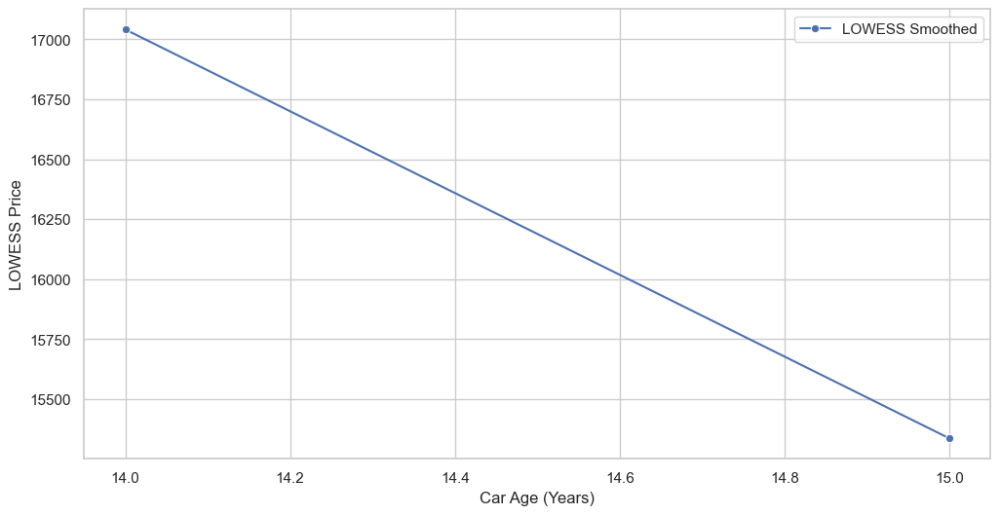

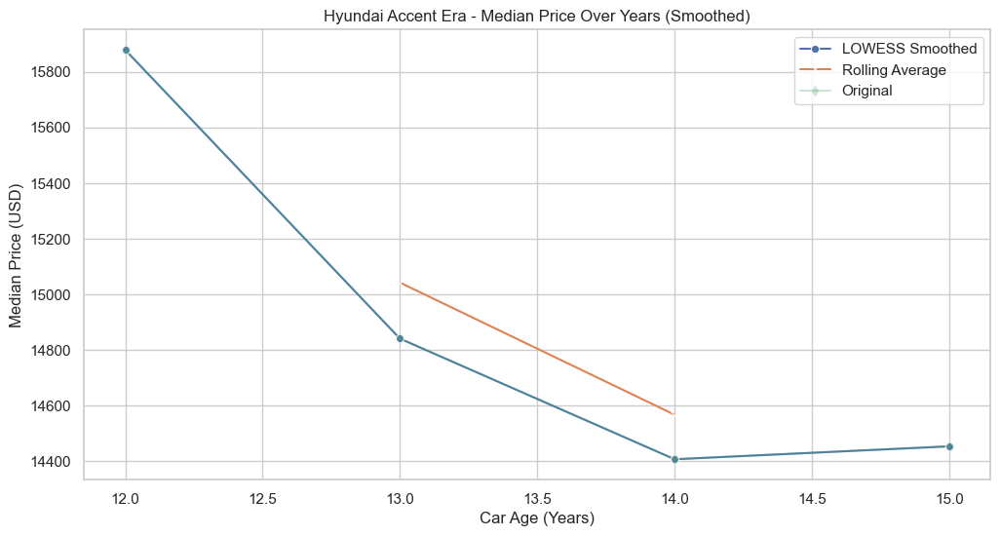

Hyundai Accent Era - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               12              NaN         30      15878.84
1               13            -6.54         65      14840.91
2               14            -2.92         80      14407.14
3               15             0.32         64      14453.62
Processing Renault 1.5 dCi Touch
Columns in median_prices for Renault 1.5 dCi Touch: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


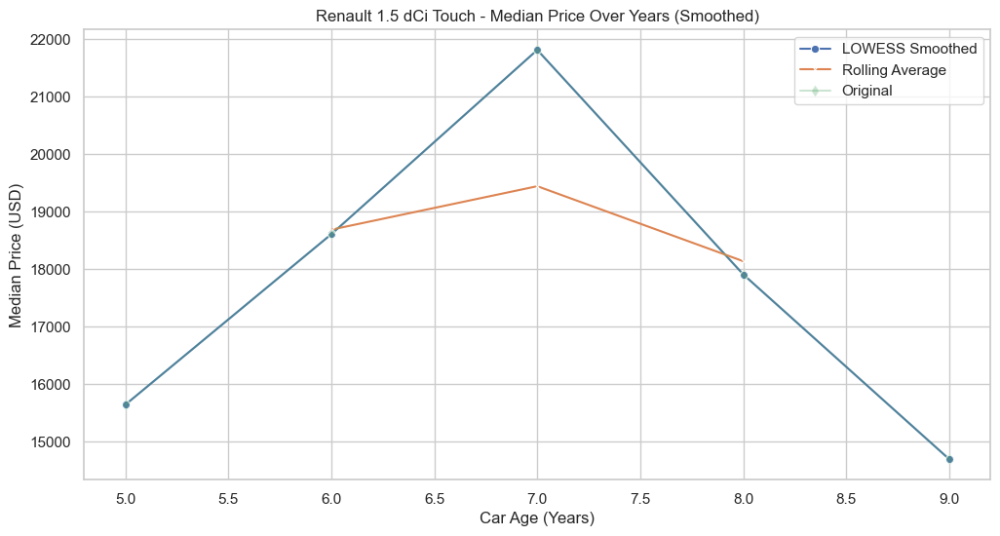

Renault 1.5 dCi Touch - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                5              NaN          6      15645.42
1                6            18.95         13      18609.59
2                7            17.21        207      21812.46
3                8           -17.89         25      17910.41
4                9           -17.93         13      14698.54
Processing Audi A6
Columns in median_prices for Audi A6: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


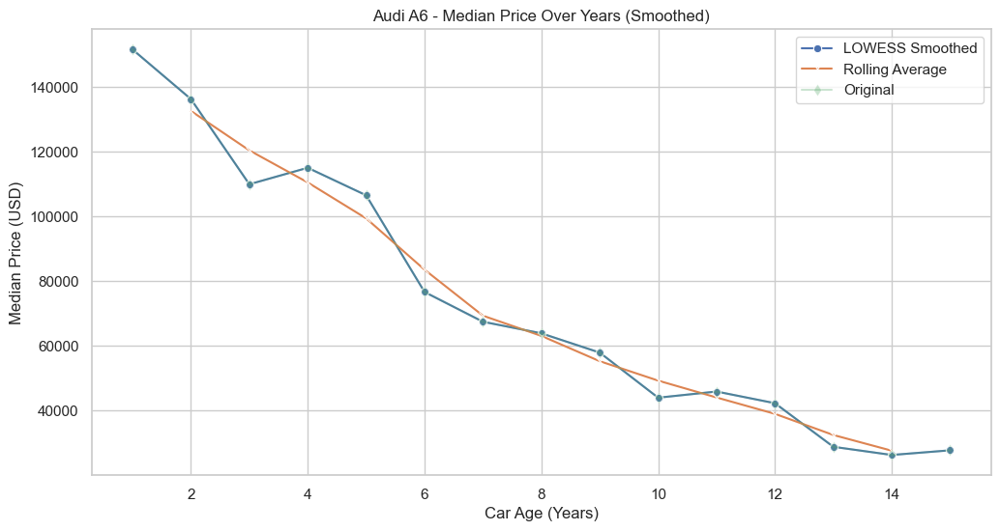

Audi A6 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 1              NaN         15     151662.28
2                 2           -10.11          6     136325.64
3                 3           -19.32          9     109990.01
4                 4             4.63         14     115086.73
5                 5            -7.39         11     106581.87
6                 6           -28.05         10      76683.17
7                 7           -12.00         23      67481.19
8                 8            -5.30         30      63902.65
9                 9            -9.33         16      57938.40
10               10           -24.06          9      43996.00
11               11             4.34         21      45904.83
12               12            -7.87         37      42291.93
13               13           -31.87         17      28814.28
14               14            -8.76         11      26289.16
15               15             5

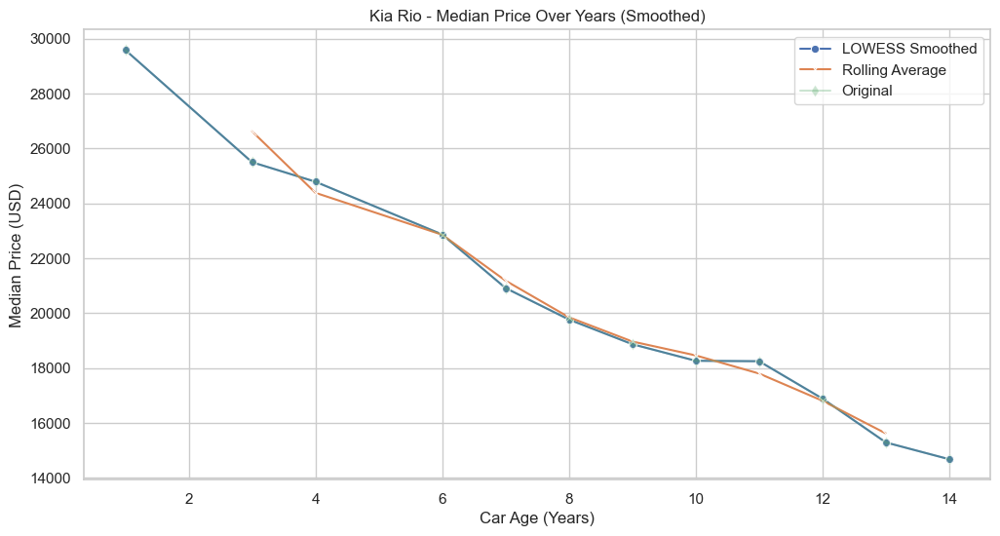

Kia Rio - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          5      29585.76
2                 3           -13.82         14      25497.54
3                 4            -2.79         21      24786.48
5                 6            -7.75         11      22865.53
6                 7            -8.54         23      20913.59
7                 8            -5.48         41      19767.22
8                 9            -4.55         16      18868.71
9                10            -3.20         29      18264.54
10               11            -0.09         22      18248.51
11               12            -7.47         16      16885.79
12               13            -9.45          6      15290.16
13               14            -4.00          8      14678.24
Processing Nissan Micra
Columns in median_prices for Nissan Micra: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Pr

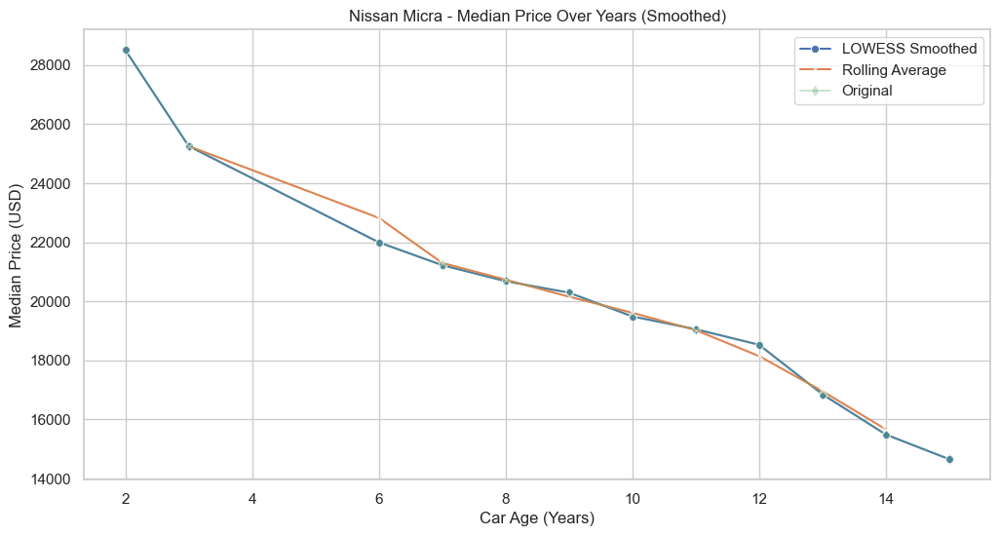

Nissan Micra - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 2              NaN          9      28504.45
1                 3           -11.41          5      25251.23
4                 6           -12.90         29      21994.90
5                 7            -3.51         28      21221.87
6                 8            -2.55         16      20681.22
7                 9            -1.88         24      20292.38
8                10            -3.96         15      19488.37
9                11            -2.23          7      19054.61
10               12            -2.76         10      18527.89
11               13            -9.05         16      16850.93
12               14            -8.07          9      15491.55
13               15            -5.40          6      14654.98
Processing Dacia Logan
Columns in median_prices for Dacia Logan: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS

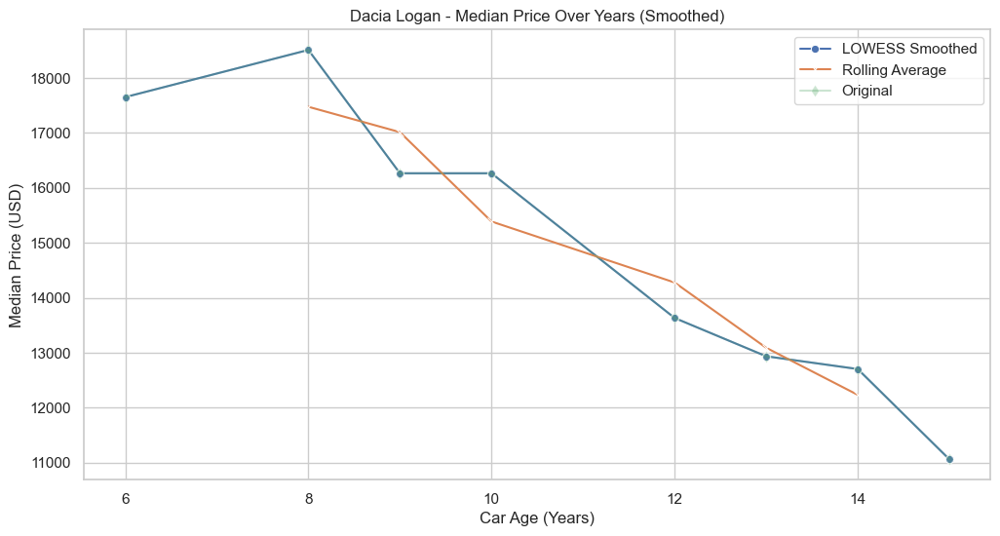

Dacia Logan - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
3                 6              NaN          5      17652.62
5                 8             4.86          8      18510.85
6                 9           -12.13         11      16266.13
7                10             0.00         15      16266.13
9                12           -16.19         24      13632.56
10               13            -5.11         38      12935.44
11               14            -1.80          8      12703.07
12               15           -12.93         10      11060.97
Processing Hyundai Getz
Columns in median_prices for Hyundai Getz: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


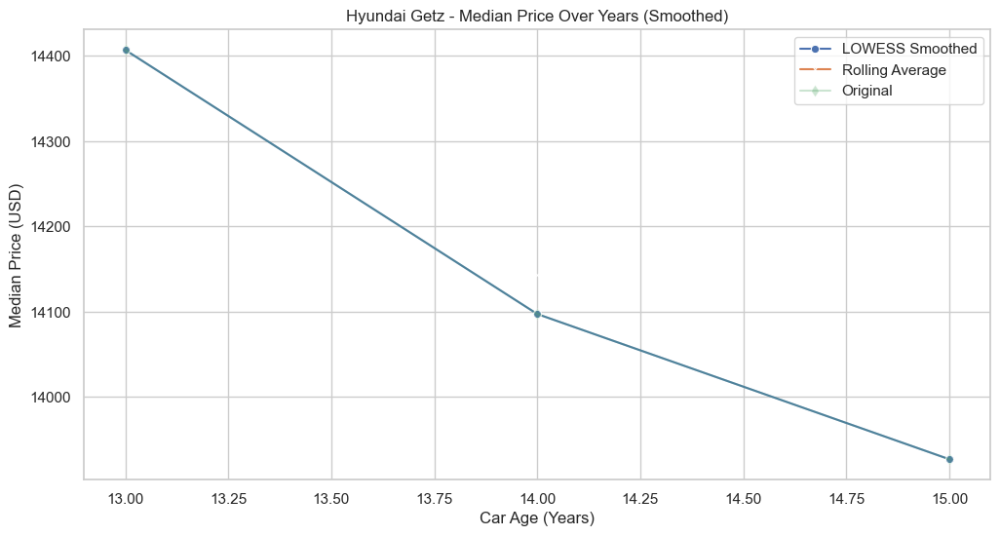

Hyundai Getz - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               13              NaN         22      14407.14
1               14            -2.15         29      14097.31
2               15            -1.21         28      13926.90
Processing Tofaş Kartal
No data available for Tofaş Kartal after applying filters.
Processing Peugeot 308
Columns in median_prices for Peugeot 308: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


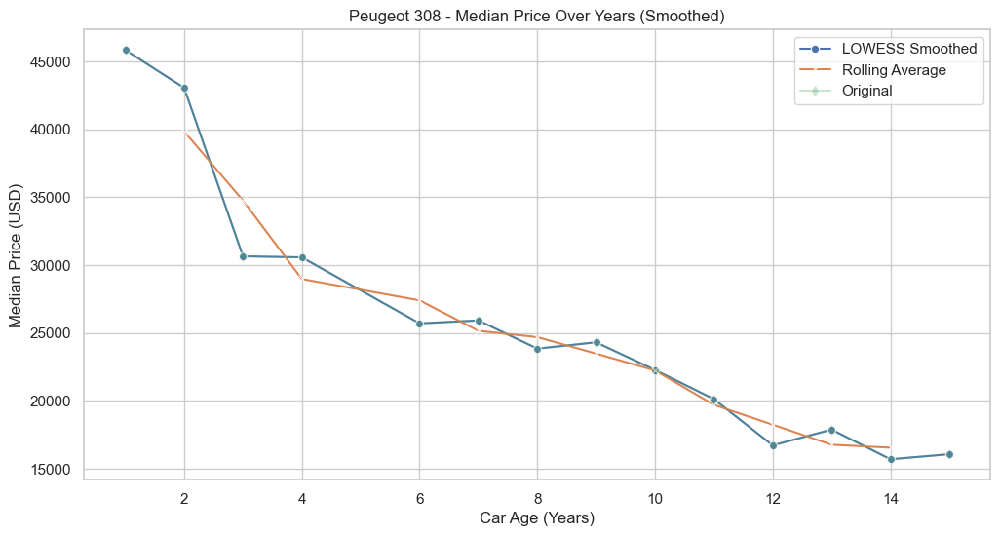

Peugeot 308 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         11      45854.99
1                 2            -6.08         10      43066.51
2                 3           -28.81         12      30657.78
3                 4            -0.25         13      30580.32
5                 6           -15.91          5      25715.97
6                 7             0.84         12      25932.86
7                 8            -8.00         20      23856.99
8                 9             1.95         19      24321.73
9                10            -8.36         12      22288.47
10               11            -9.64         11      20139.02
11               12           -16.92          7      16730.87
12               13             6.94         26      17892.74
13               14           -12.21         14      15708.43
14               15             2.37         16      16080.23
Processing Toyota Auris
Colum

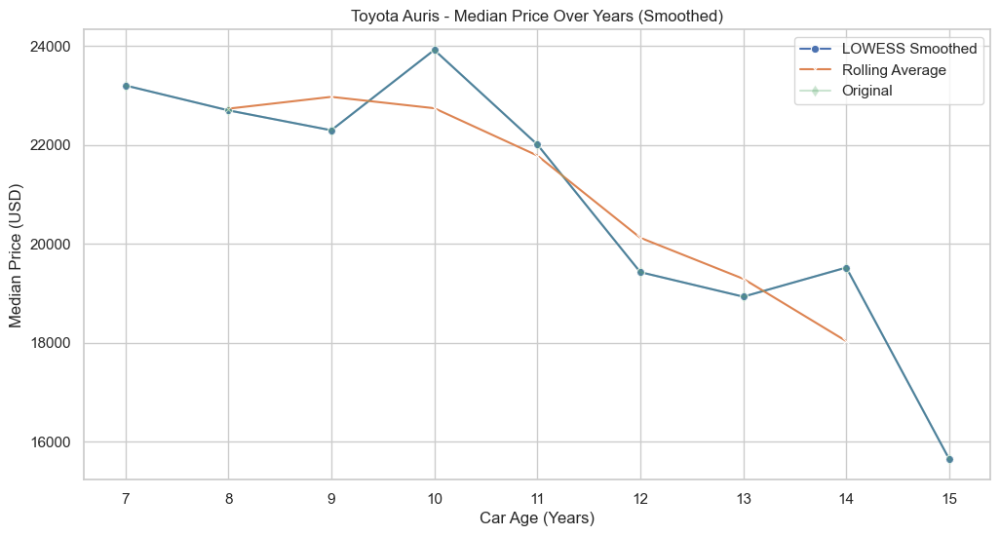

Toyota Auris - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN          9      23198.60
1                8            -2.17         16      22695.12
2                9            -1.77         18      22292.34
3               10             7.28         14      23915.08
4               11            -7.98         32      22005.75
5               12           -11.72         38      19426.40
6               13            -2.55         33      18930.67
7               14             3.11          7      19519.35
8               15           -19.84          5      15646.47
Processing Volvo S40
Columns in median_prices for Volvo S40: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


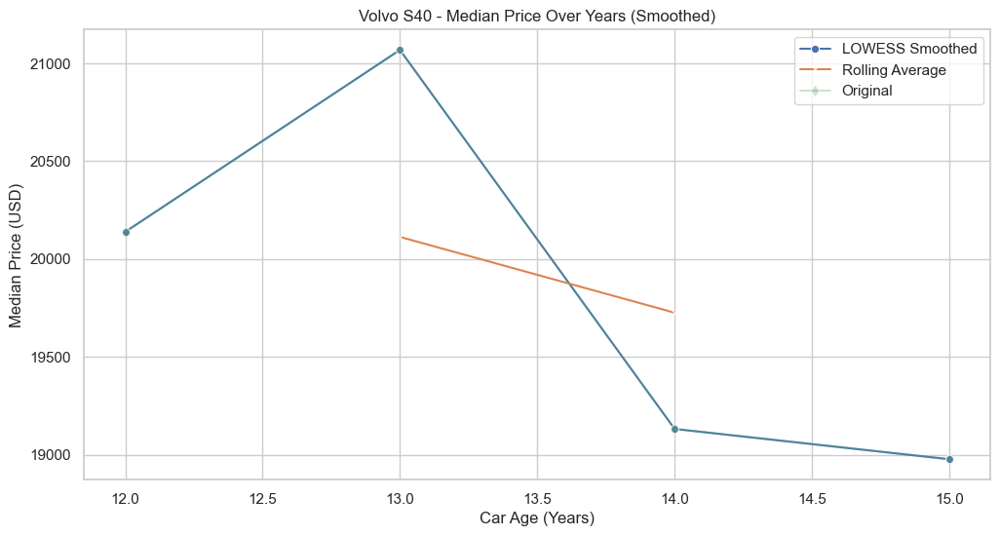

Volvo S40 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               12              NaN         17      20139.02
1               13             4.62         19      21068.51
2               14            -9.19         17      19132.06
3               15            -0.81         20      18977.15
Processing Peugeot 207
Columns in median_prices for Peugeot 207: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


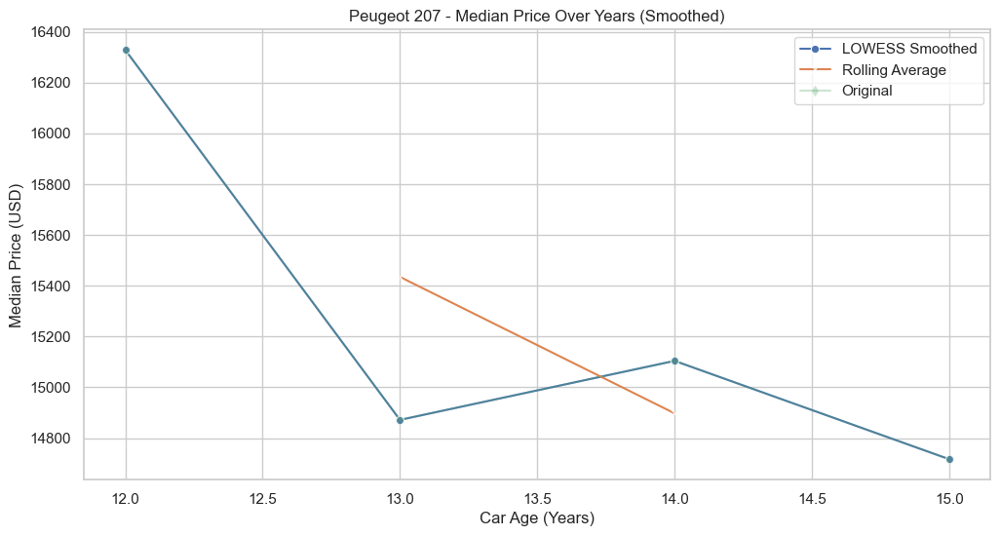

Peugeot 207 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               12              NaN          7      16328.09
1               13            -8.92         35      14871.89
2               14             1.56         27      15104.26
3               15            -2.56         33      14716.97
Processing Citroen C5
Columns in median_prices for Citroen C5: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


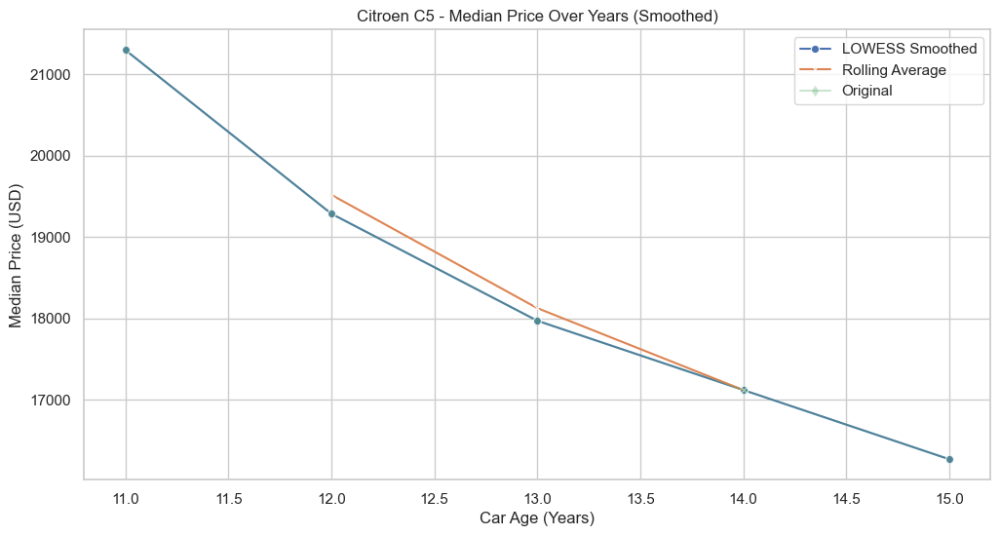

Citroen C5 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2               11              NaN         12      21300.88
3               12            -9.45         38      19286.98
4               13            -6.83         54      17970.20
5               14            -4.74         26      17118.16
6               15            -4.98         17      16266.13
Processing Volvo S60
Columns in median_prices for Volvo S60: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


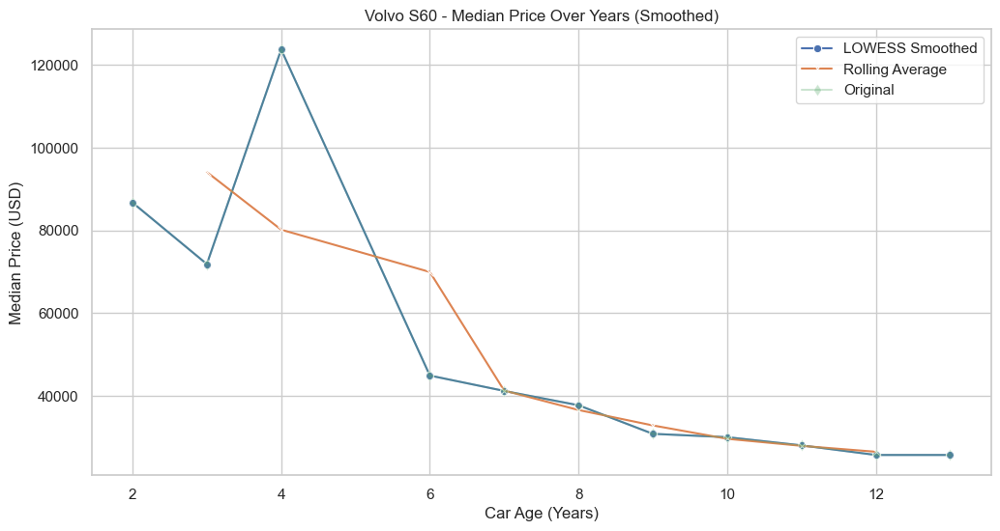

Volvo S60 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 2              NaN          7      86749.58
2                 3           -17.14          5      71880.79
3                 4            72.20          7     123777.49
5                 6           -63.71         21      44922.40
6                 7            -8.27          5      41207.52
7                 8            -8.42          9      37737.42
8                 9           -18.31         28      30828.19
9                10            -2.61         25      30022.62
10               11            -6.61         16      28038.16
11               12            -8.28         17      25715.97
12               13             0.00         20      25715.97
Processing Toyota Yaris
Columns in median_prices for Toyota Yaris: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


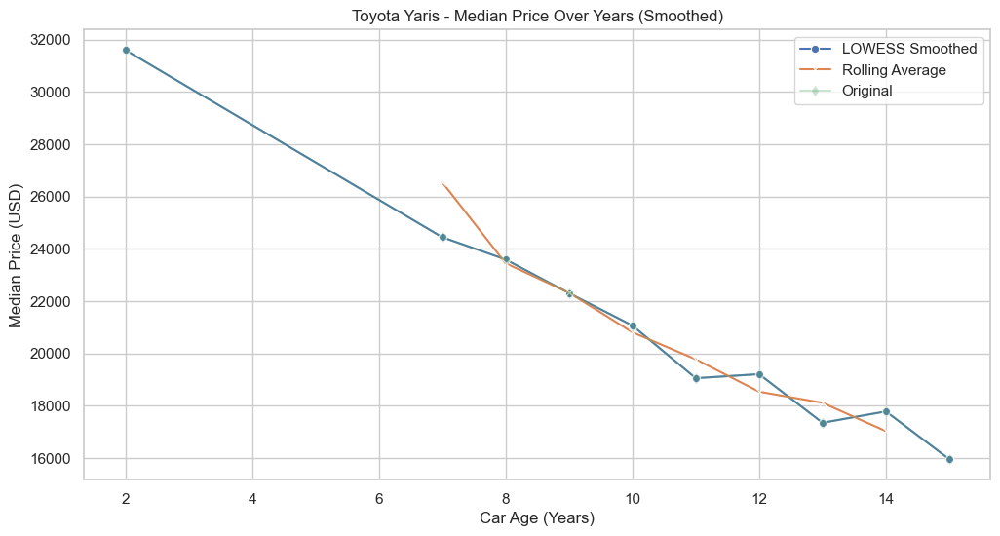

Toyota Yaris - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 2              NaN          6      31602.76
6                 7           -22.65          7      24445.67
7                 8            -3.49         12      23593.63
8                 9            -5.45          5      22307.83
9                10            -5.56          9      21068.51
10               11            -9.56         17      19054.61
11               12             0.81         12      19209.52
12               13            -9.68         16      17350.54
13               14             2.50          5      17784.30
14               15           -10.28         10      15956.30
Processing Kia Ceed
Columns in median_prices for Kia Ceed: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


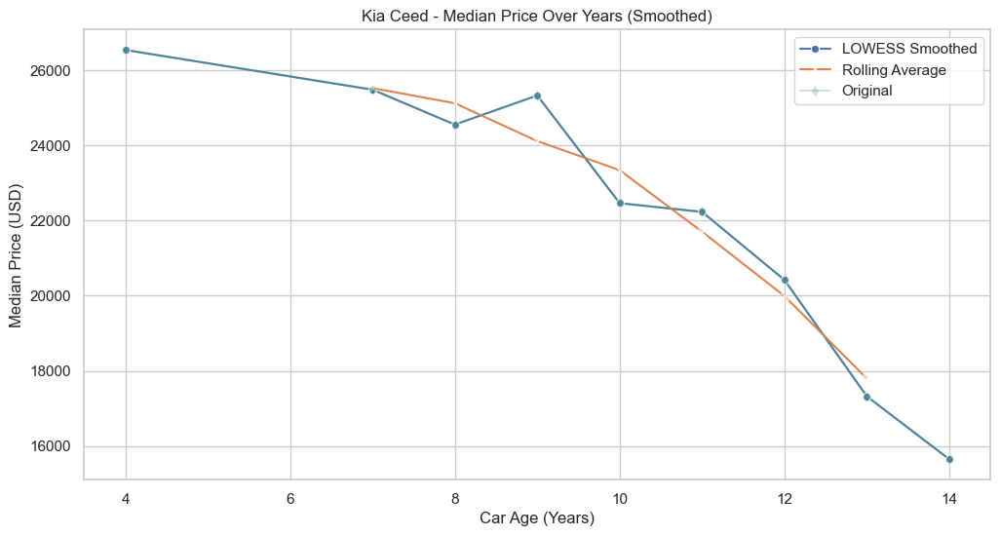

Kia Ceed - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
3                 4              NaN         16      26540.63
6                 7            -3.98          6      25483.60
7                 8            -3.65          8      24554.11
8                 9             3.15         14      25328.68
9                10           -11.31          6      22462.75
10               11            -1.03         32      22230.37
11               12            -8.15         36      20417.86
12               13           -15.17         27      17319.55
13               14            -9.66          9      15646.47
Processing Seat Toledo
Columns in median_prices for Seat Toledo: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


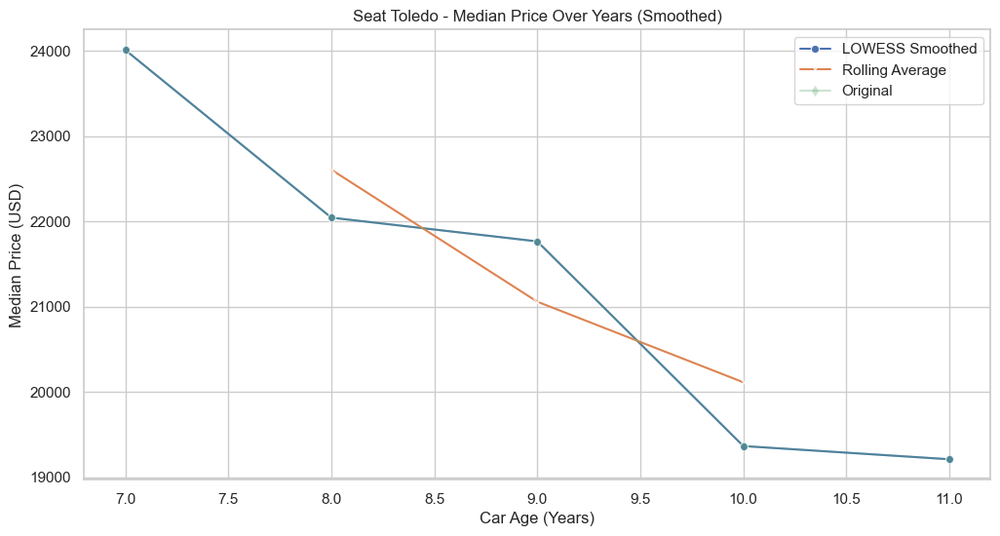

Seat Toledo - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN         12      24011.90
1                8            -8.19         22      22044.48
2                9            -1.26         26      21765.63
3               10           -11.03         22      19364.44
4               11            -0.80         16      19209.52
Processing Seat Cordoba
No data available for Seat Cordoba after filtering for car count.
Processing Renault 1.5 dCi Icon
Columns in median_prices for Renault 1.5 dCi Icon: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


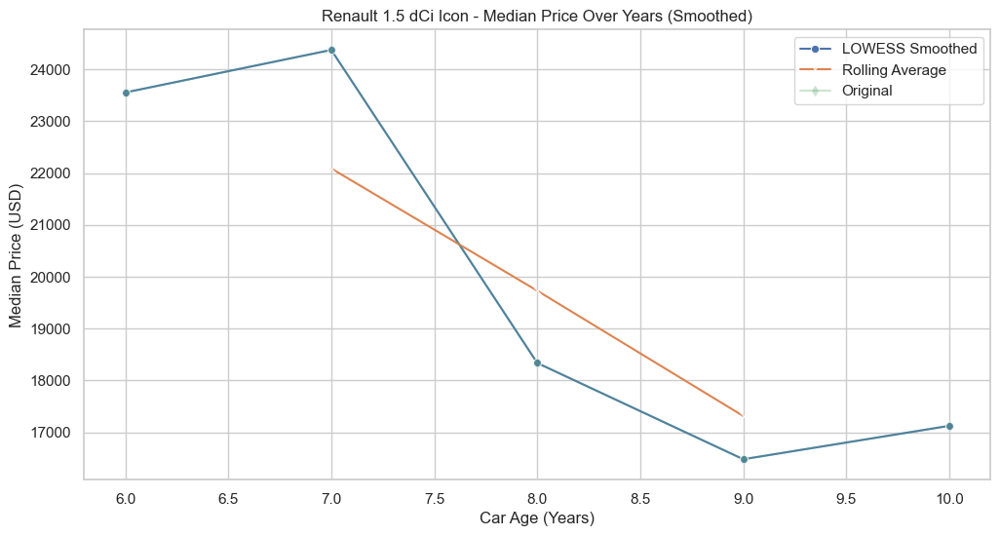

Renault 1.5 dCi Icon - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN         98      23554.45
2                7             3.48         13      24374.71
3                8           -24.77         17      18337.91
4                9           -10.12         10      16481.84
5               10             3.91          6      17126.54
Processing Mercedes A
Columns in median_prices for Mercedes A: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


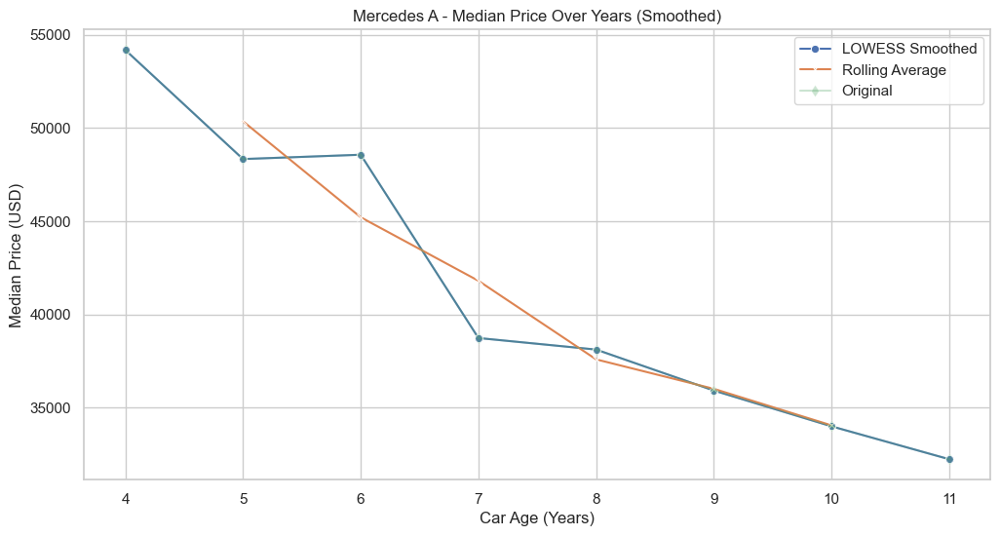

Mercedes A - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
3                 4              NaN         13      54189.44
4                 5           -10.81          5      48333.64
5                 6             0.48         12      48566.01
6                 7           -20.26         19      38728.88
7                 8            -1.60         19      38109.21
8                 9            -5.77         10      35909.41
9                10            -5.35         18      33988.46
10               11            -5.20         17      32222.42
Processing Lada Vega
No data available for Lada Vega after applying filters.
Processing Lada Samara
No data available for Lada Samara after applying filters.
Processing Peugeot 208
Columns in median_prices for Peugeot 208: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


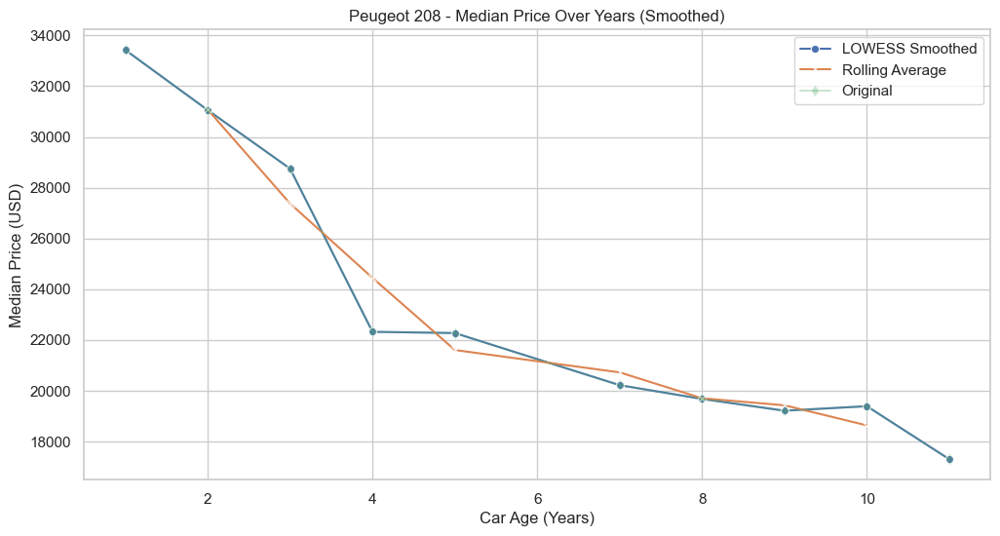

Peugeot 208 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         12      33430.77
1                 2            -7.09          8      31060.56
2                 3            -7.43         17      28752.32
3                 4           -22.37         10      22319.45
4                 5            -0.22          6      22270.65
6                 7            -9.22         12      20216.47
7                 8            -2.68          9      19674.27
8                 9            -2.36         17      19209.52
9                10             0.93         17      19387.68
10               11           -10.79         12      17296.32
Processing Chevrolet Lacetti
Columns in median_prices for Chevrolet Lacetti: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


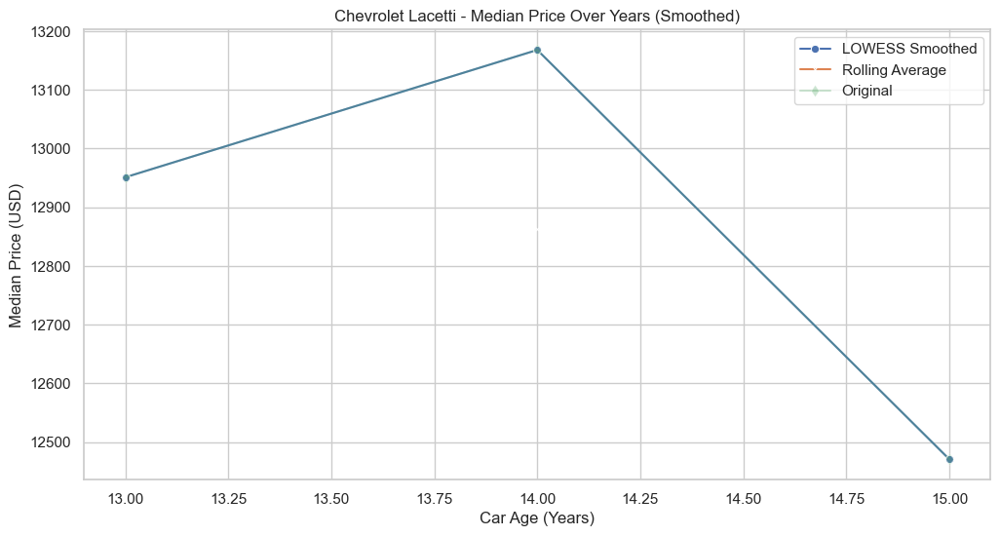

Chevrolet Lacetti - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               13              NaN         25      12950.94
1               14             1.67          7      13167.82
2               15            -5.29         14      12470.70
Processing Mercedes CLA
Columns in median_prices for Mercedes CLA: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


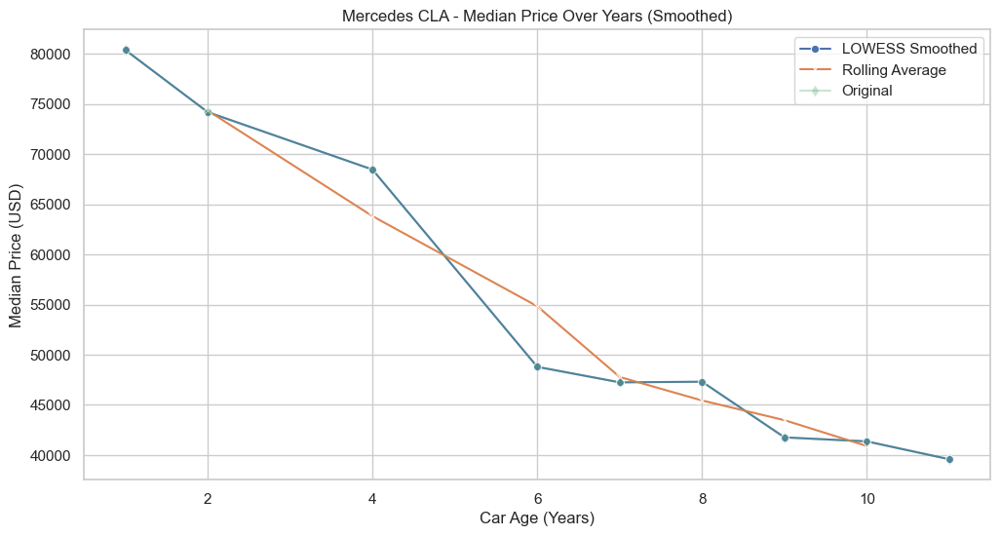

Mercedes CLA - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          8      80401.15
1                 2            -7.71          6      74204.53
3                 4            -7.72          8      68472.65
5                 6           -28.73          5      48798.38
6                 7            -3.17         12      47249.23
7                 8             0.13         14      47311.19
8                 9           -11.73         25      41762.12
9                10            -0.96         23      41362.44
10               11            -4.31         16      39580.91
Processing Fiat Albea
Columns in median_prices for Fiat Albea: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


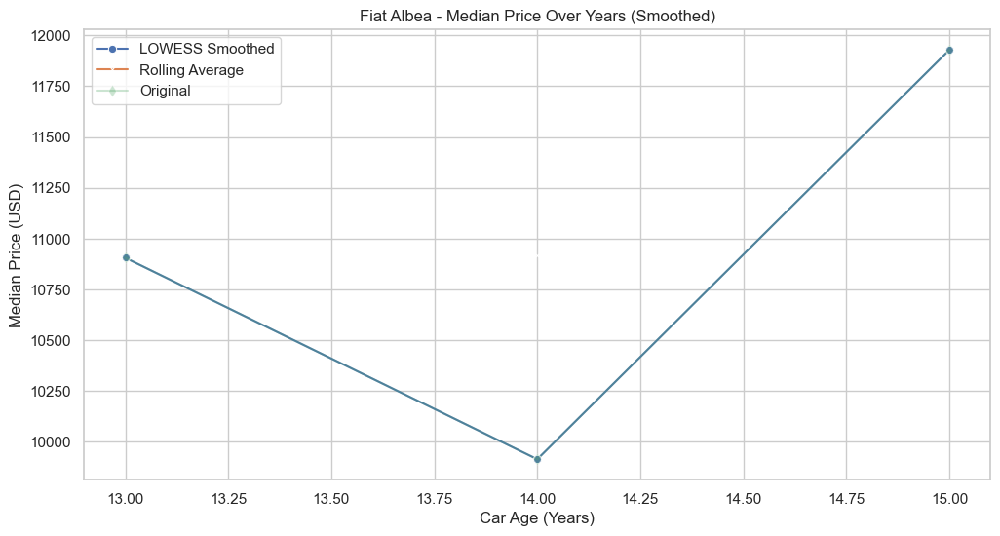

Fiat Albea - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1               13              NaN         14      10906.05
2               14            -9.09         13       9914.59
3               15            20.31         12      11928.49
Processing Audi A5
Columns in median_prices for Audi A5: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


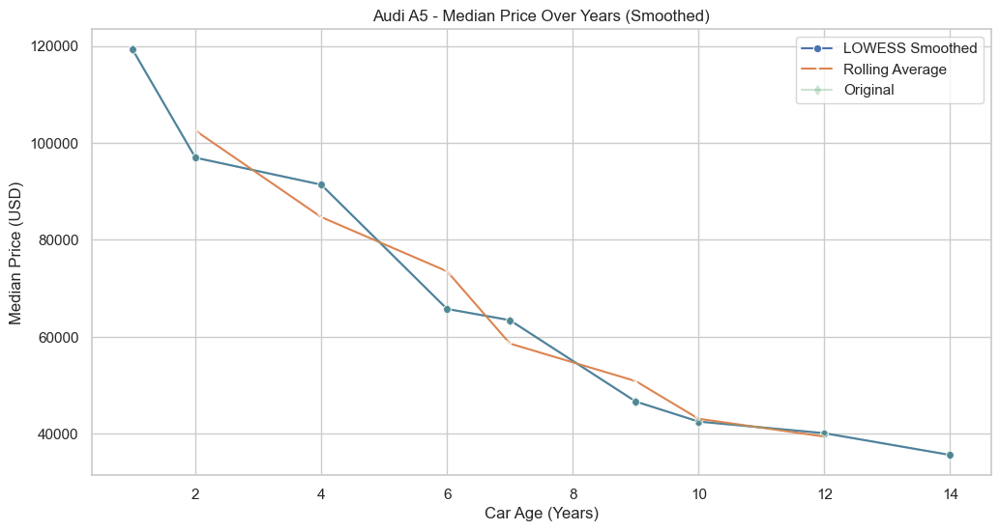

Audi A5 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          8     119284.94
1                 2           -18.71          5      96961.61
3                 4            -5.74          5      91400.15
5                 6           -28.05         10      65761.63
6                 7            -3.53         30      63437.90
8                 9           -26.45         19      46657.37
9                10            -8.87          6      42519.34
11               12            -5.64          7      40123.12
13               14           -11.20          5      35630.57
Processing Mazda 3
Columns in median_prices for Mazda 3: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


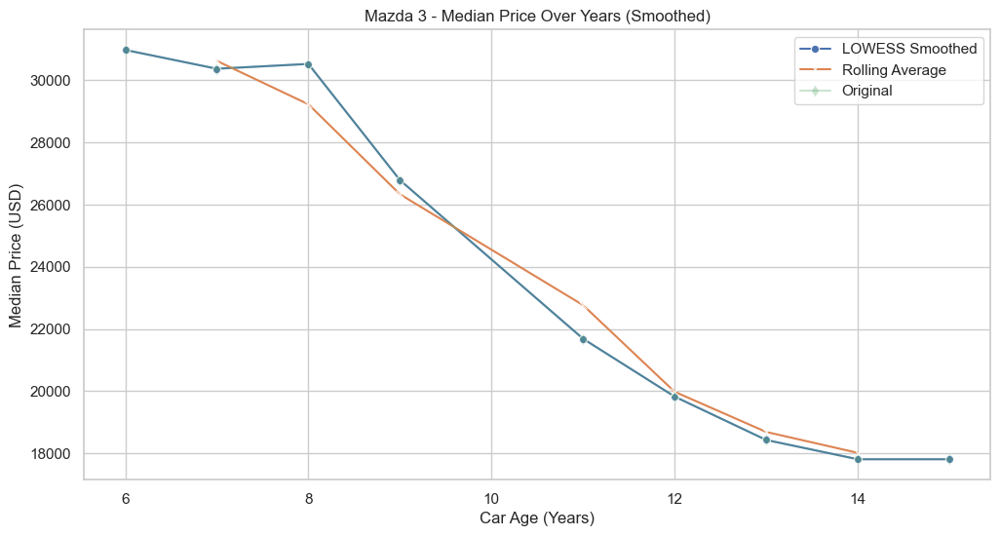

Mazda 3 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                6              NaN          5      30967.61
1                7            -1.95          7      30363.44
2                8             0.51          5      30518.35
3                9           -12.23         12      26784.89
5               11           -19.03          5      21688.17
6               12            -8.57         19      19829.18
7               13            -7.03         16      18434.94
8               14            -3.36         19      17815.28
9               15             0.00          9      17815.28
Processing Kia Cerato
Columns in median_prices for Kia Cerato: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


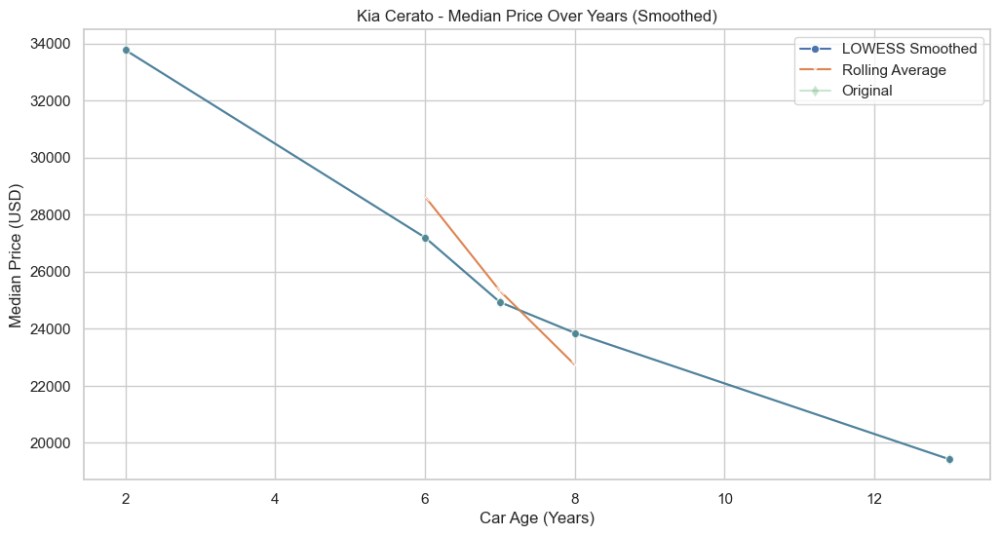

Kia Cerato - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 2              NaN          5      33771.58
5                 6           -19.45          7      27203.16
6                 7            -8.33         24      24935.87
7                 8            -4.33         25      23856.99
12               13           -18.57         12      19427.62
Processing Honda Jazz
Columns in median_prices for Honda Jazz: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


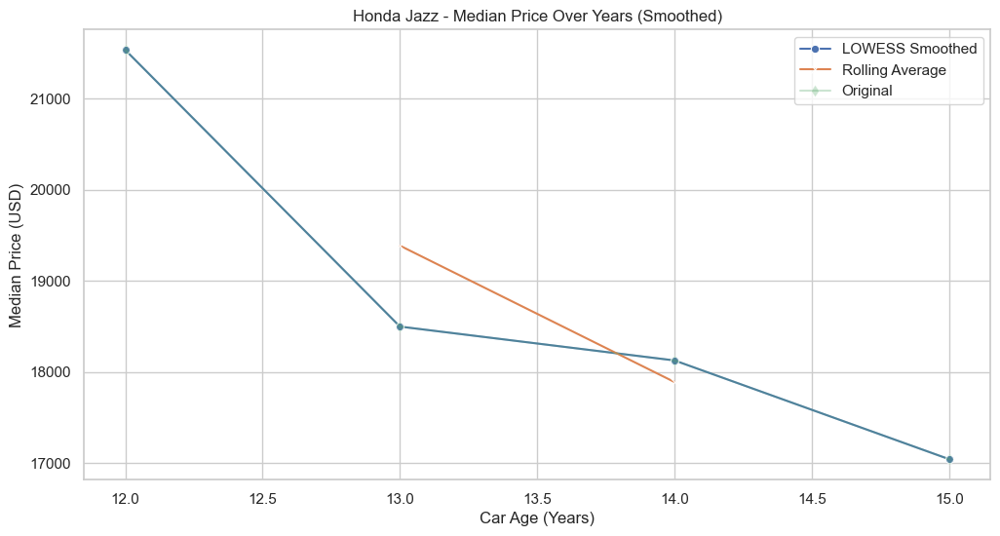

Honda Jazz - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
9                12              NaN          9      21533.26
10               13           -14.10         17      18496.91
11               14            -2.01          5      18125.11
12               15            -5.98         17      17040.71
Processing Mercedes AMG
Columns in median_prices for Mercedes AMG: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


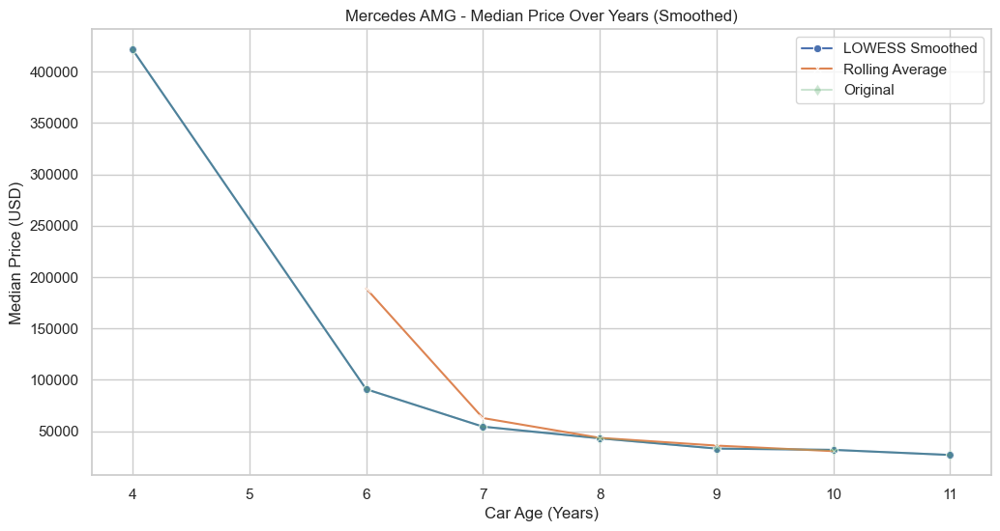

Mercedes AMG - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                4              NaN          8     421421.42
2                6           -78.42          7      90947.12
3                7           -40.09         23      54483.77
4                8           -20.86         22      43120.44
5                9           -23.14         14      33141.78
6               10            -3.75         14      31900.10
7               11           -15.59          9      26925.82
Processing Skoda Felicia
No data available for Skoda Felicia after applying filters.
Processing Honda City
Columns in median_prices for Honda City: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


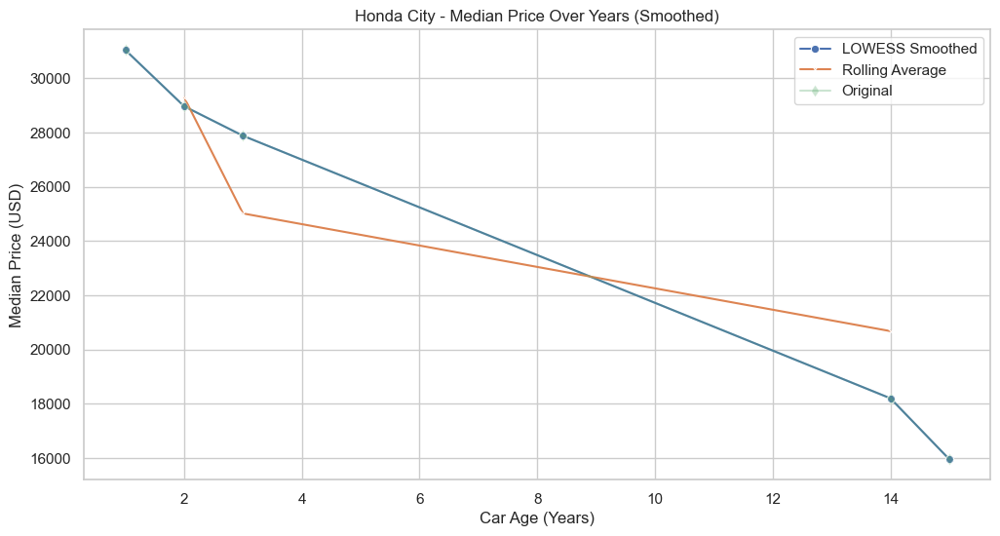

Honda City - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          8      31045.07
1                 2            -6.69         25      28969.20
2                 3            -3.75         15      27881.69
13               14           -34.71          6      18202.57
14               15           -12.34          9      15956.30
Processing Nissan Primera
No data available for Nissan Primera after applying filters.
Processing Hyundai Elantra
Columns in median_prices for Hyundai Elantra: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


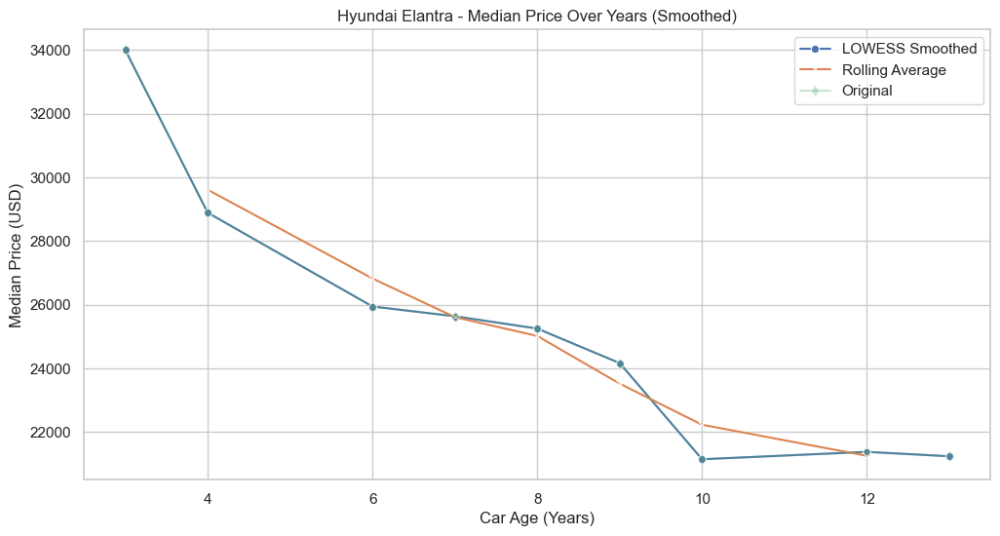

Hyundai Elantra - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                 3              NaN          8      34003.95
2                 4           -15.03          6      28891.74
4                 6           -10.20          8      25944.47
5                 7            -1.18         16      25638.52
6                 8            -1.51         12      25251.23
7                 9            -4.29          9      24166.82
8                10           -12.50          6      21145.97
10               12             1.10         10      21378.34
11               13            -0.65          8      21238.92
Processing Suzuki Swift
Columns in median_prices for Suzuki Swift: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


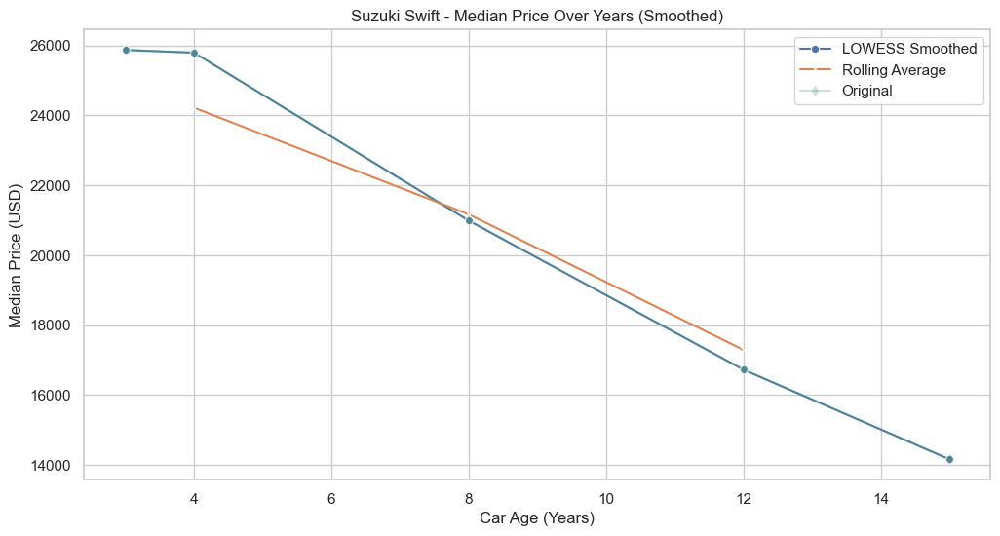

Suzuki Swift - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2                 3              NaN          5      25870.89
3                 4            -0.30          8      25793.43
7                 8           -18.62          8      20991.05
11               12           -20.30          7      16730.87
14               15           -15.33          8      14165.47
Processing Skoda Rapid
Columns in median_prices for Skoda Rapid: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


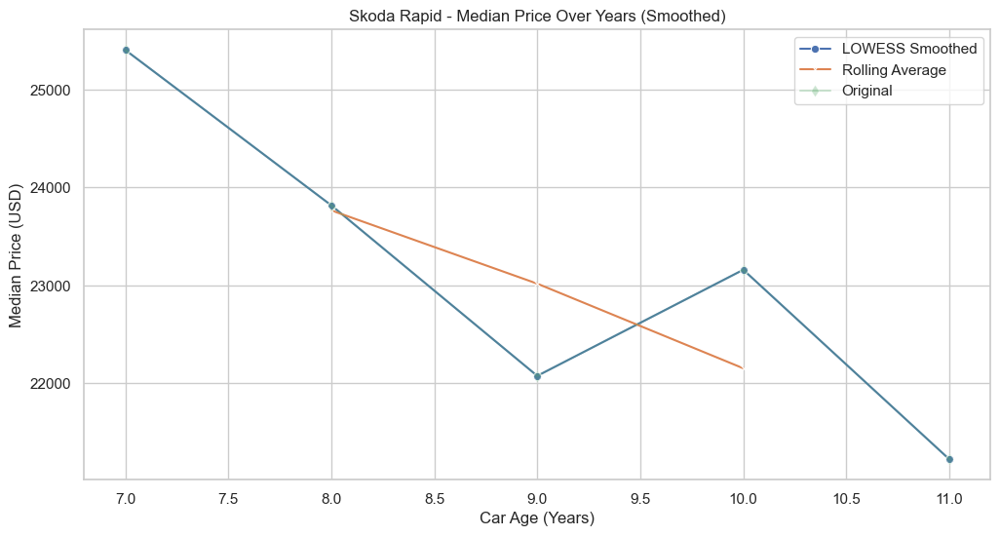

Skoda Rapid - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                7              NaN         13      25406.14
2                8            -6.25         30      23818.26
3                9            -7.32         26      22075.46
4               10             4.91         16      23159.87
5               11            -8.36          6      21223.42
Processing Hyundai i30
Columns in median_prices for Hyundai i30: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


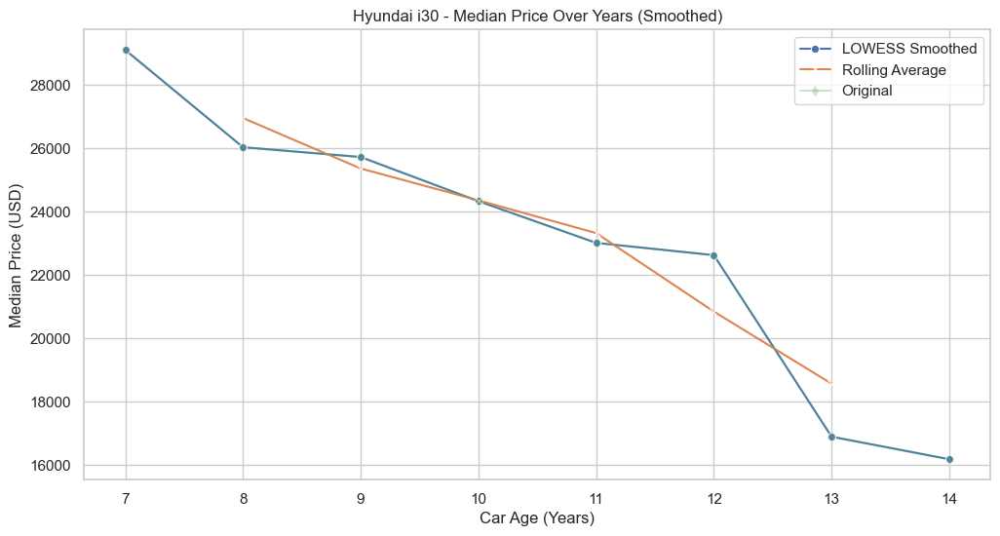

Hyundai i30 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN          8      29097.00
1                8           -10.56          5      26025.80
2                9            -1.19         17      25715.97
3               10            -5.42         13      24321.73
4               11            -5.41         22      23004.95
5               12            -1.68         16      22617.66
6               13           -25.34          5      16885.79
7               14            -4.22          7      16173.18
Processing Mazda 323
No data available for Mazda 323 after applying filters.
Processing Skoda Favorit
No data available for Skoda Favorit after applying filters.
Processing Dacia Lodgy
Columns in median_prices for Dacia Lodgy: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


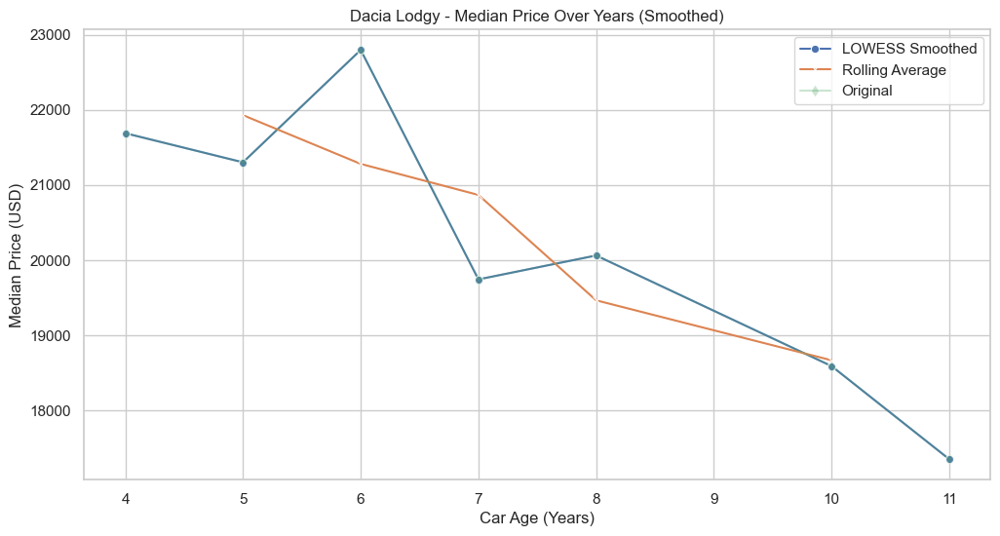

Dacia Lodgy - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2                4              NaN         10      21688.17
3                5            -1.79          8      21300.88
4                6             7.02          7      22795.82
5                7           -13.39         20      19743.21
6                8             1.61         12      20061.56
8               10            -7.34         11      18589.86
9               11            -6.67         14      17350.54
Processing MINI Cooper
Columns in median_prices for MINI Cooper: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


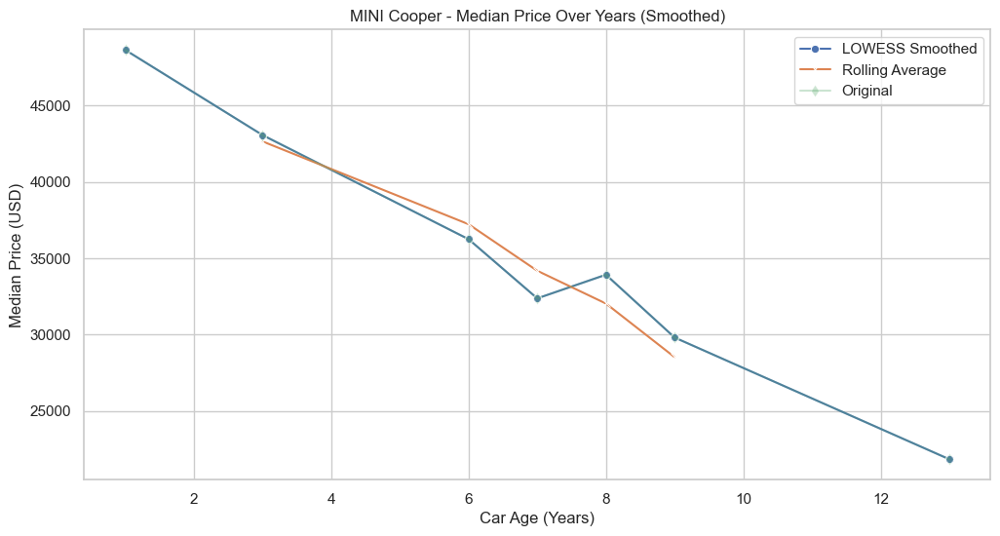

MINI Cooper - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         13      48643.47
2                 3           -11.46          6      43066.51
5                 6           -15.83          6      36250.23
6                 7           -10.68         11      32377.34
7                 8             4.78         10      33926.50
8                 9           -12.12          6      29813.49
12               13           -26.73          5      21843.09
Processing Dacia 1.5 dCi Ambiance

Columns in median_prices for Dacia 1.5 dCi Ambiance
: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Dacia 1.5 dCi Ambiance
: 'y'
Processing Renault R 9
No data available for Renault R 9 after applying filters.
Processing Peugeot 508
Columns in median_prices for Peugeot 508: Index(['Car Age (Years)', 'USD Absolute', 'C

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


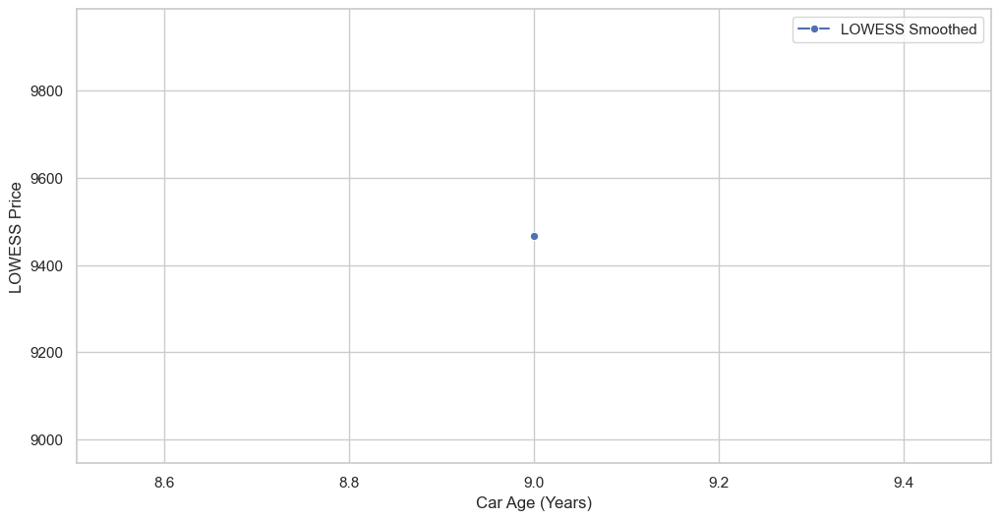

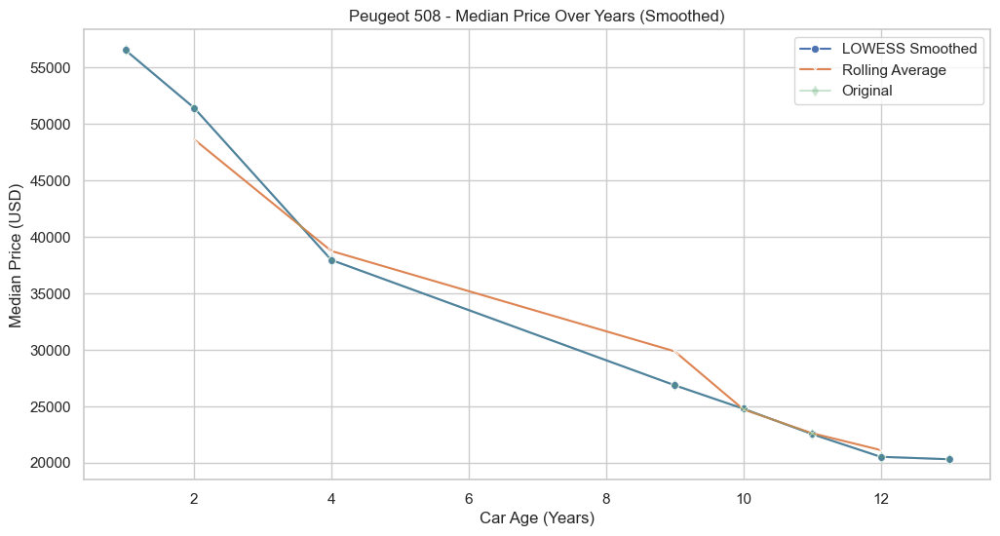

Peugeot 508 - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN          5      56544.16
1                 2            -9.04          5      51431.95
3                 4           -26.20         14      37954.30
8                 9           -29.22          8      26862.35
9                10            -7.73          6      24786.48
10               11            -9.06          6      22540.19
11               12            -8.93         18      20526.30
12               13            -1.06         10      20309.42
Processing Mitsubishi Lancer
Columns in median_prices for Mitsubishi Lancer: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


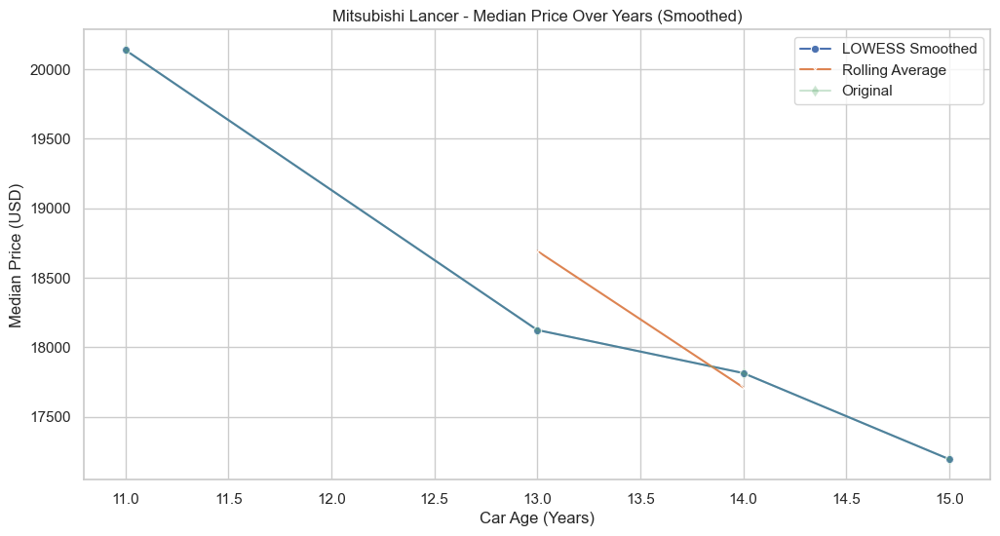

Mitsubishi Lancer - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2               11              NaN          5      20139.02
4               13           -10.00         18      18125.11
5               14            -1.71         13      17815.28
6               15            -3.48         12      17195.62
Processing Ford Escort
No data available for Ford Escort after applying filters.
Processing Kia Picanto
Columns in median_prices for Kia Picanto: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


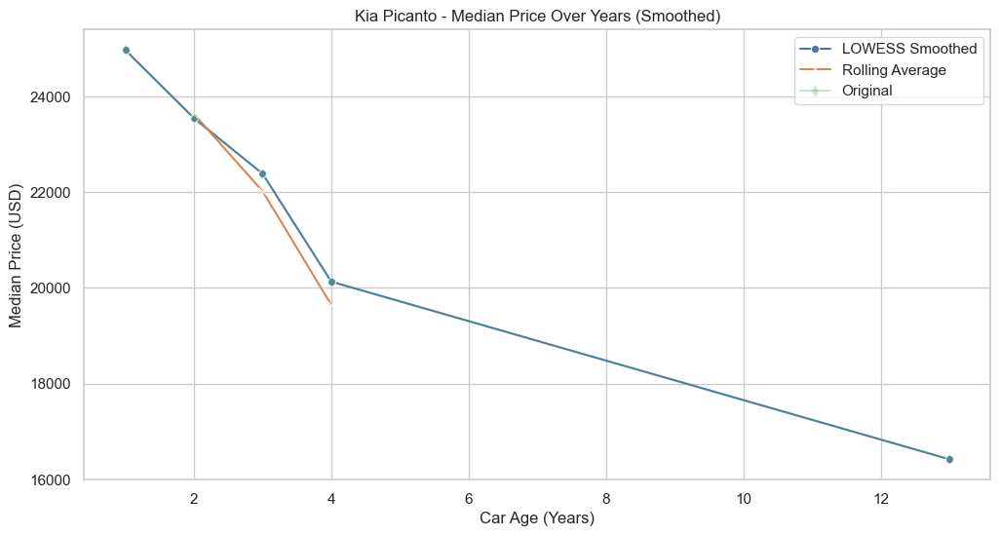

Kia Picanto - Percentage Loss Over Years
    Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                 1              NaN         13      24972.38
1                 2            -5.71         12      23547.16
2                 3            -4.93          8      22385.29
3                 4           -10.07         16      20131.27
12               13           -18.44          6      16419.49
Processing Renault 1.5 dCi SportTourer Joy
Columns in median_prices for Renault 1.5 dCi SportTourer Joy: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Renault 1.5 dCi SportTourer Joy: 'y'
Processing Renault 1.5 dCi Extreme Edition
Columns in median_prices for Renault 1.5 dCi Extreme Edition: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Renault 1.5 dCi Extreme Editio

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


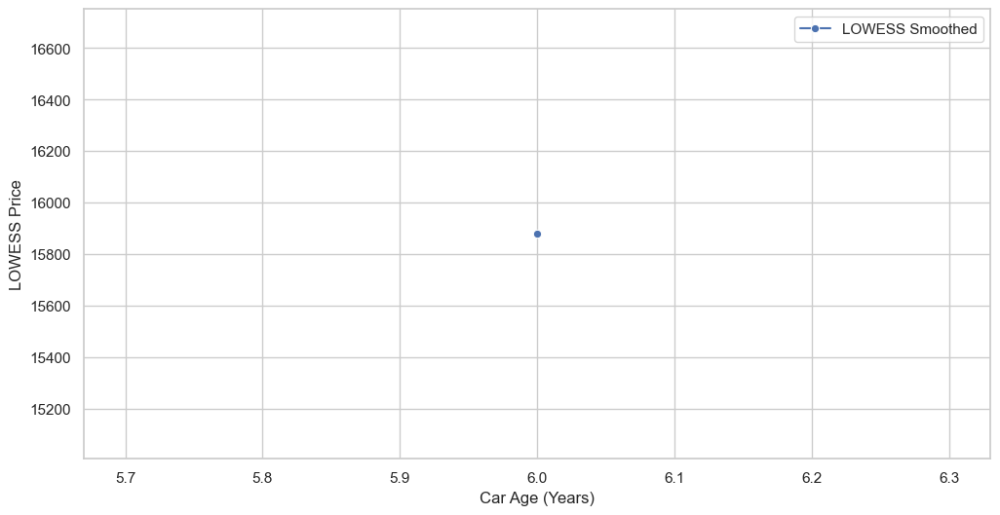

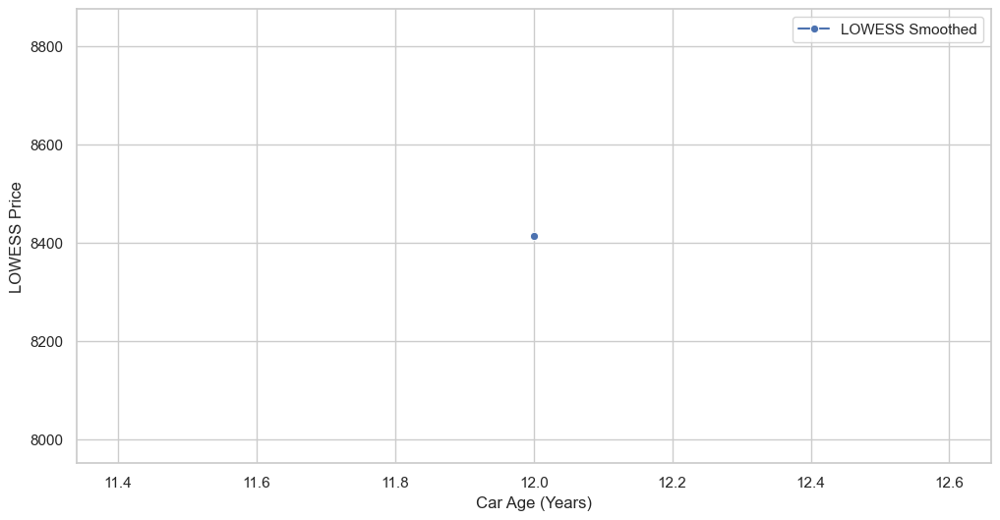

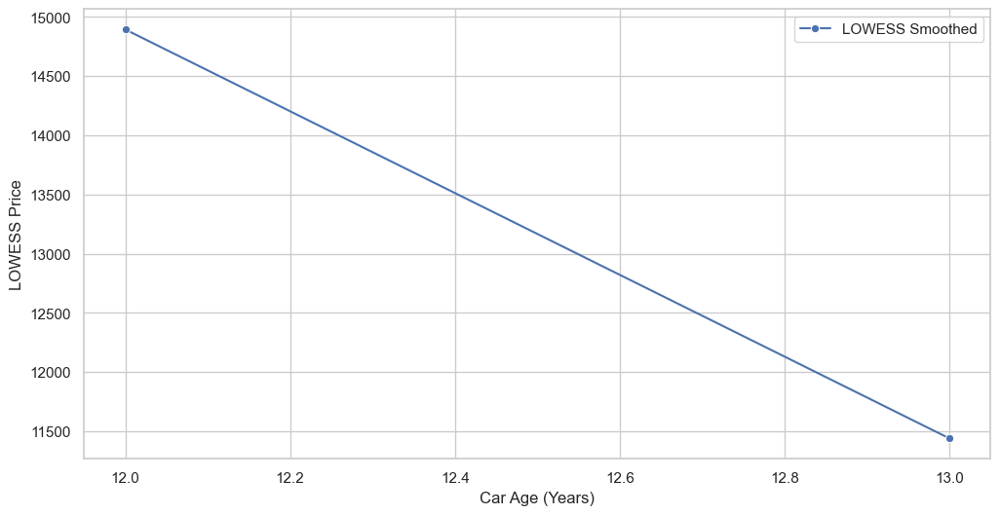

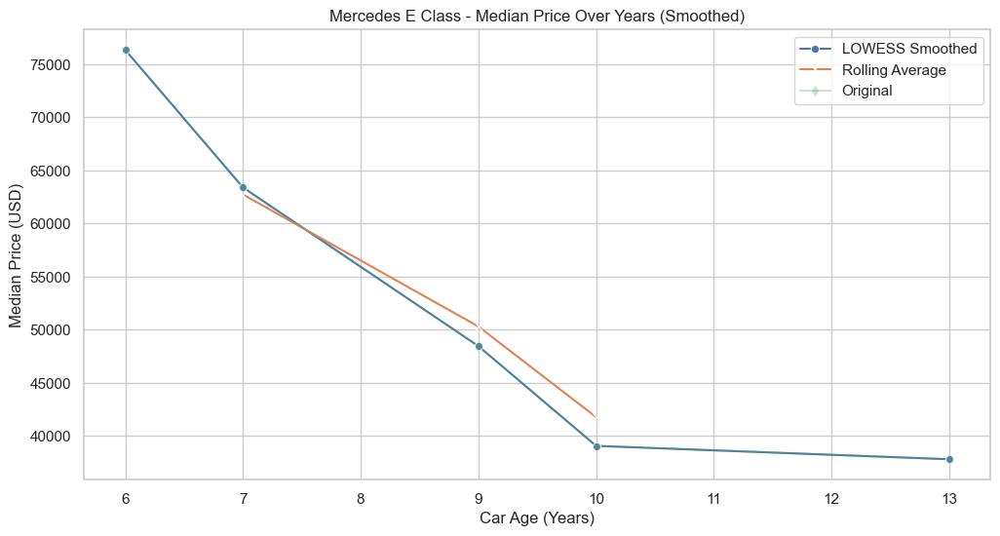

Mercedes E Class - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                6              NaN          8      76345.01
1                7           -16.95         14      63401.35
3                9           -23.56         15      48463.46
4               10           -19.37          8      39075.55
7               13            -3.23          6      37815.05
Processing Peugeot 407
No data available for Peugeot 407 after filtering for car count.
Processing Ford 1.6 TDCi Trend X
Columns in median_prices for Ford 1.6 TDCi Trend X: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


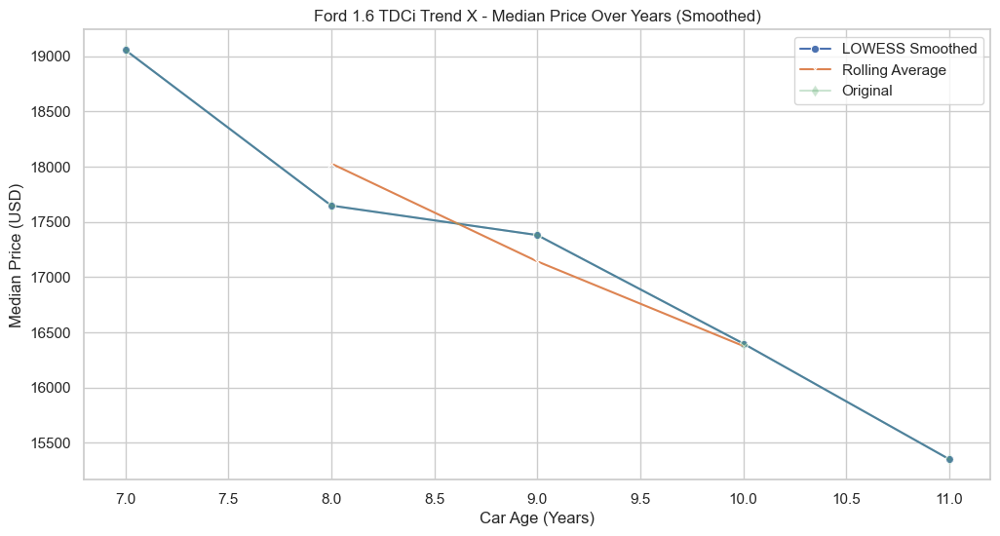

Ford 1.6 TDCi Trend X - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN         28      19058.03
1                8            -7.39         14      17648.83
2                9            -1.51         10      17381.69
3               10            -5.65          8      16399.53
4               11            -6.39          5      15351.78
Processing Fiat Uno
No data available for Fiat Uno after applying filters.
Processing Renault 1.5 dCi Expression
Columns in median_prices for Renault 1.5 dCi Expression: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Renault 1.5 dCi Expression: 'y'
Processing Fiat 1.3 Multijet Easy
Columns in median_prices for Fiat 1.3 Multijet Easy: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


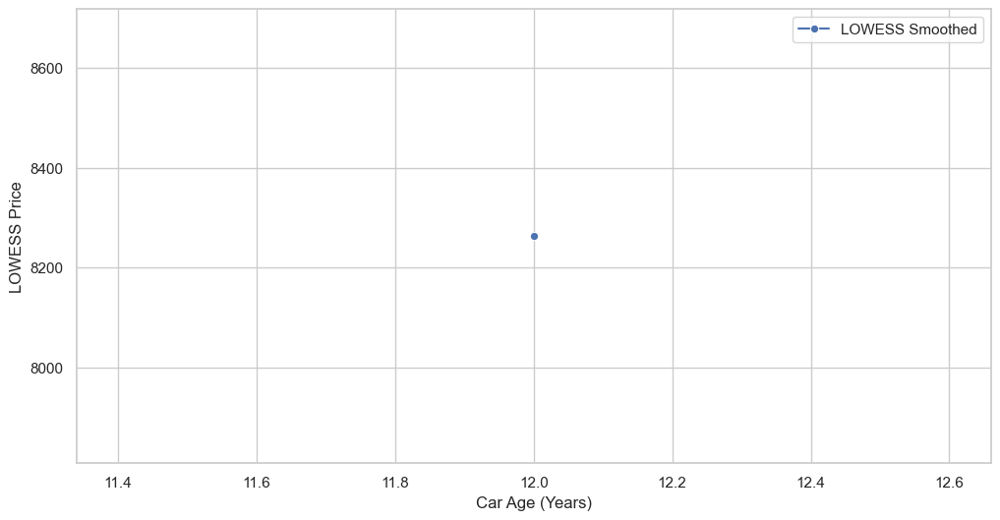

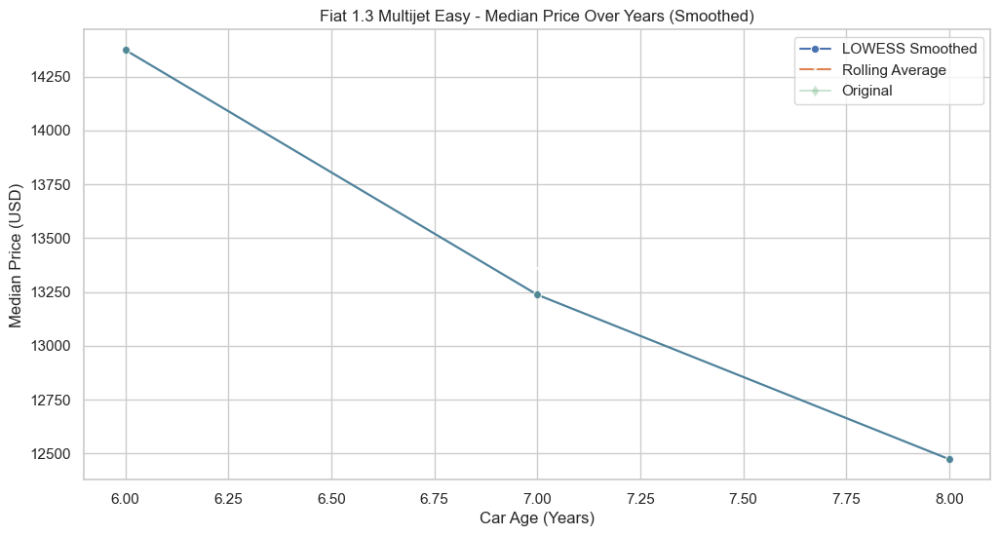

Fiat 1.3 Multijet Easy - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN         11      14373.48
2                7            -7.91         44      13237.15
3                8            -5.77         18      12473.32
Processing Nissan Almera
No data available for Nissan Almera after filtering for car count.
Processing Citroen Xsara
No data available for Citroen Xsara after applying filters.
Processing Toyota Avensis
Columns in median_prices for Toyota Avensis: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


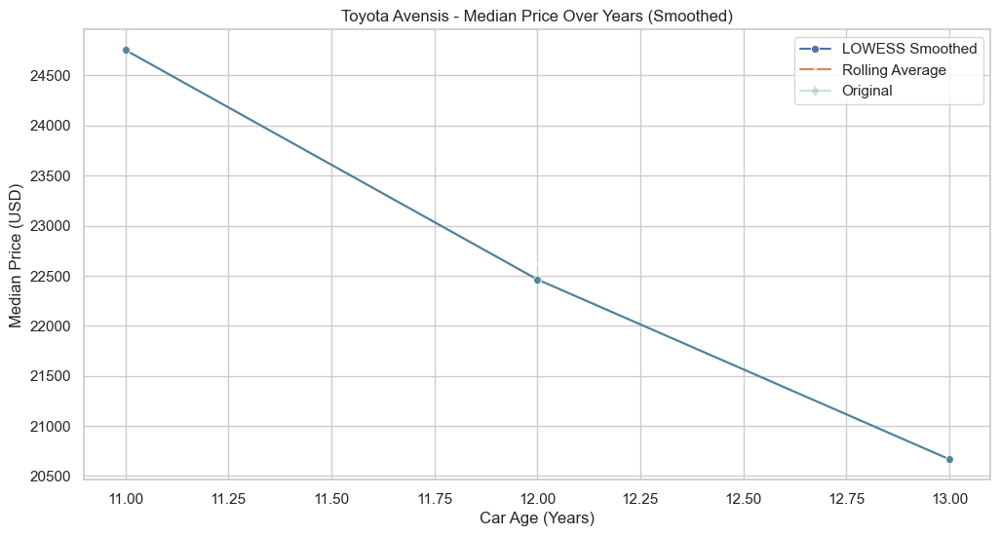

Toyota Avensis - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
4               11              NaN          9      24755.50
5               12            -9.26          9      22462.75
6               13            -8.00          8      20665.73
Processing Renault 1.5 dCi Dynamique
Columns in median_prices for Renault 1.5 dCi Dynamique: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Renault 1.5 dCi Dynamique: 'y'
Processing Mercedes S
Columns in median_prices for Mercedes S: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


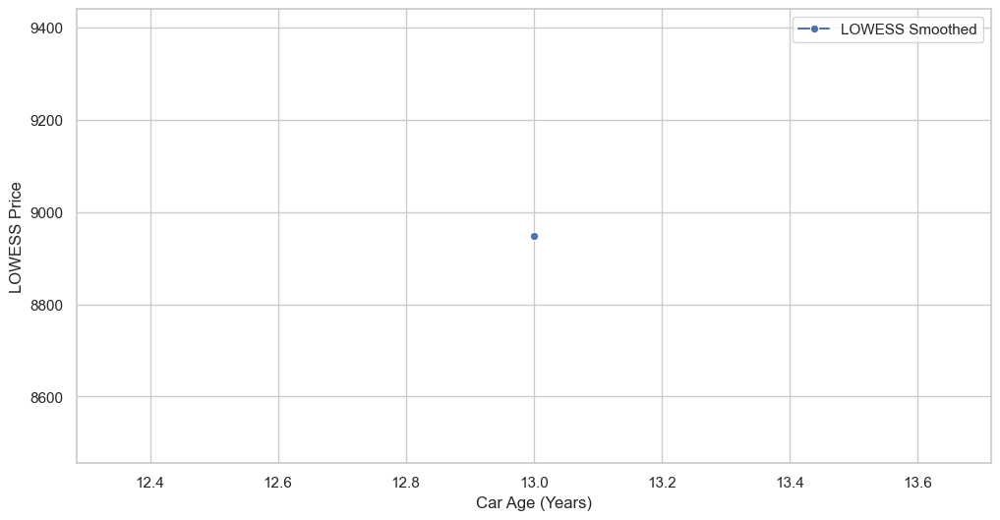

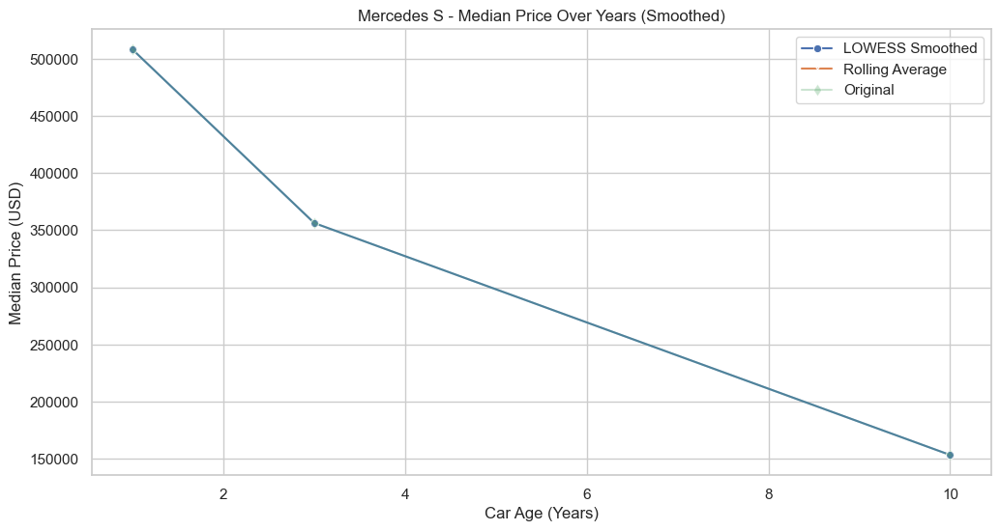

Mercedes S - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                1              NaN          8     508122.85
2                3           -29.88         11     356305.66
9               10           -56.96          5     153366.35
Processing Mercedes 200
No data available for Mercedes 200 after filtering for car count.
Processing Volkswagen Bora
No data available for Volkswagen Bora after applying filters.
Processing Mercedes B
Columns in median_prices for Mercedes B: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


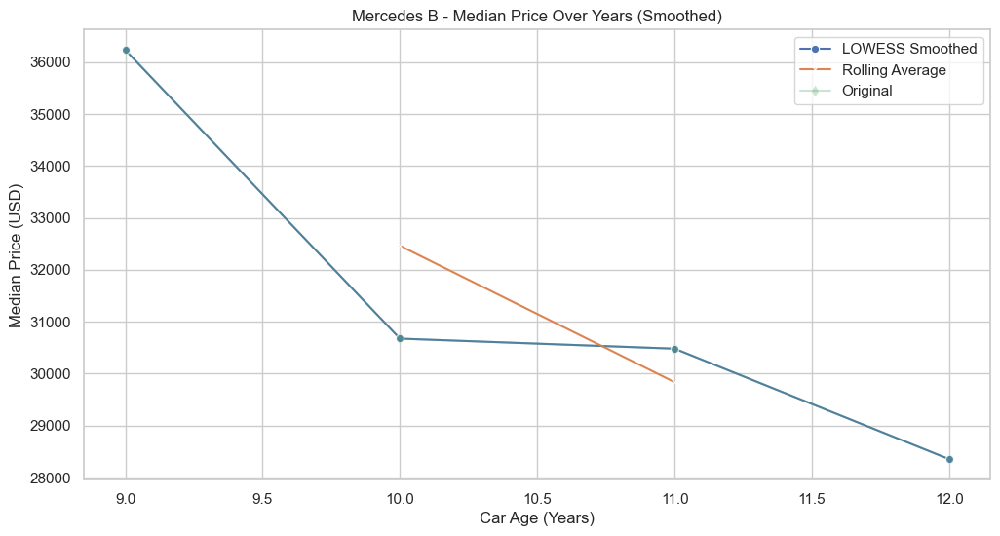

Mercedes B - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
5                9              NaN          7      36234.74
6               10           -15.35          9      30673.27
7               11            -0.63         10      30479.63
8               12            -6.99          7      28349.54
Processing Alfa Romeo Giulietta
Columns in median_prices for Alfa Romeo Giulietta: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


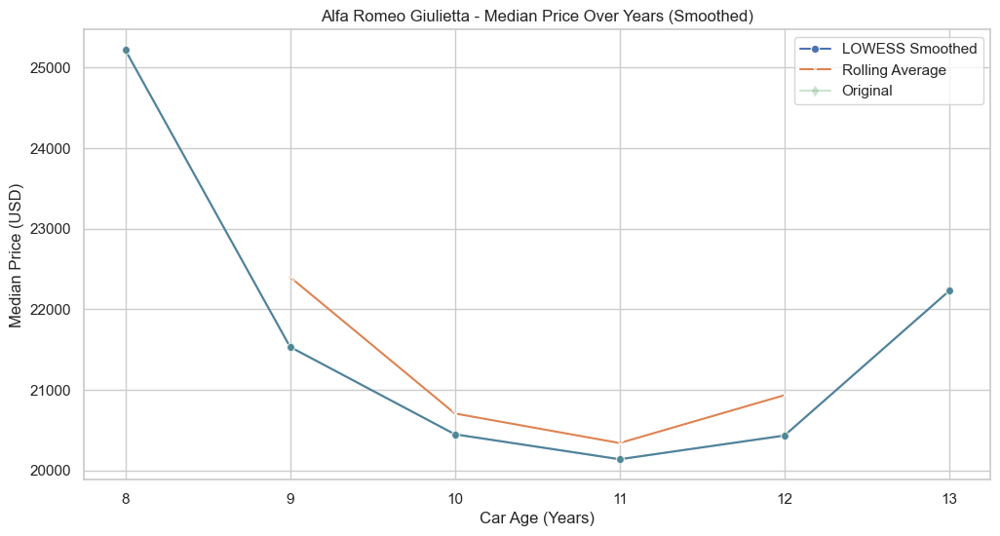

Alfa Romeo Giulietta - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
4                8              NaN          6      25218.69
5                9           -14.61          7      21533.26
6               10            -5.04         15      20448.85
7               11            -1.52          7      20139.02
8               12             1.46         14      20433.35
9               13             8.79         10      22230.37
Processing Peugeot 206+
Columns in median_prices for Peugeot 206+: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


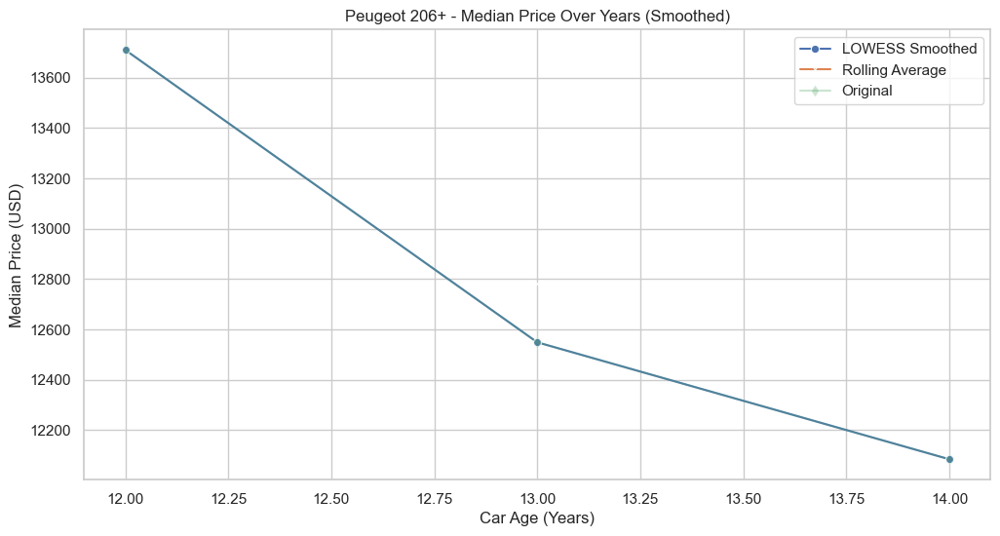

Peugeot 206+ - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0               12              NaN         14      13710.02
1               13            -8.47         35      12548.16
2               14            -3.70         15      12083.41
Processing Honda Accord
Columns in median_prices for Honda Accord: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Honda Accord: 'y'
Processing Fiat Tipo
No data available for Fiat Tipo after applying filters.
Processing Mazda 626
No data available for Mazda 626 after applying filters.
Processing Nissan Note
Columns in median_prices for Nissan Note: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


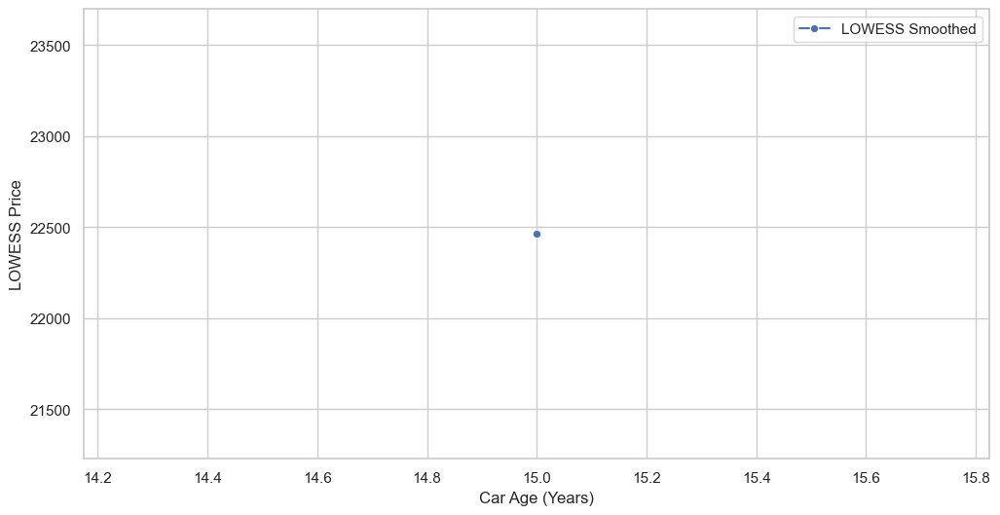

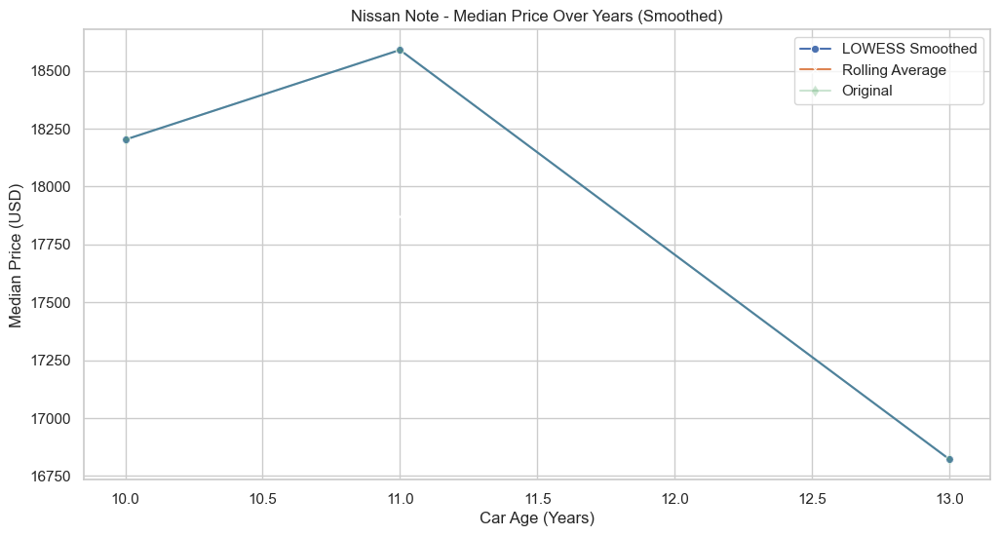

Nissan Note - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2               10              NaN         10      18202.57
3               11             2.13          9      18589.86
5               13            -9.51          8      16822.27
Processing Peugeot 306
No data available for Peugeot 306 after applying filters.
Processing Hyundai 1.6 CRDI Mode Plus
Columns in median_prices for Hyundai 1.6 CRDI Mode Plus: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


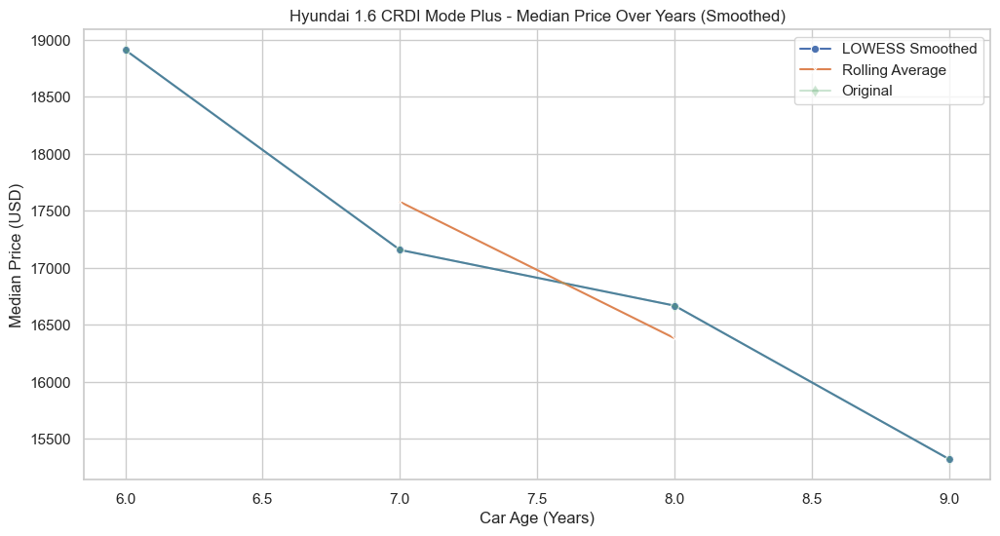

Hyundai 1.6 CRDI Mode Plus - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                6              NaN          6      18911.29
1                7            -9.27         25      17157.87
2                8            -2.85         12      16668.72
3                9            -8.08          6      15321.68
Processing Mitsubishi Carisma
No data available for Mitsubishi Carisma after applying filters.
Processing Citroen Saxo
No data available for Citroen Saxo after applying filters.
Processing Peugeot 1.6 HDi Active
Columns in median_prices for Peugeot 1.6 HDi Active: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


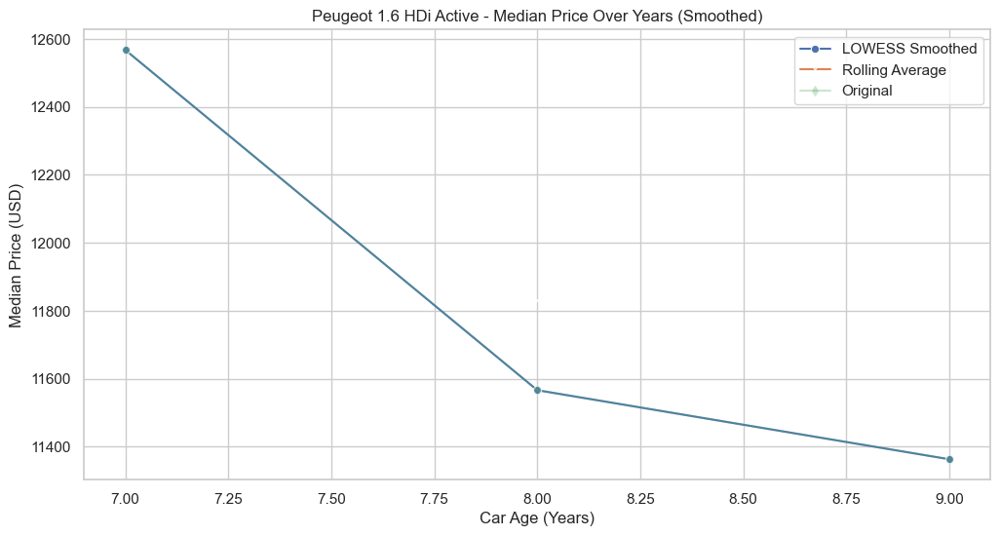

Peugeot 1.6 HDi Active - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                7              NaN         31      12567.39
2                8            -7.96         11      11566.51
3                9            -1.76          7      11363.33
Processing Skoda Scala
Columns in median_prices for Skoda Scala: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


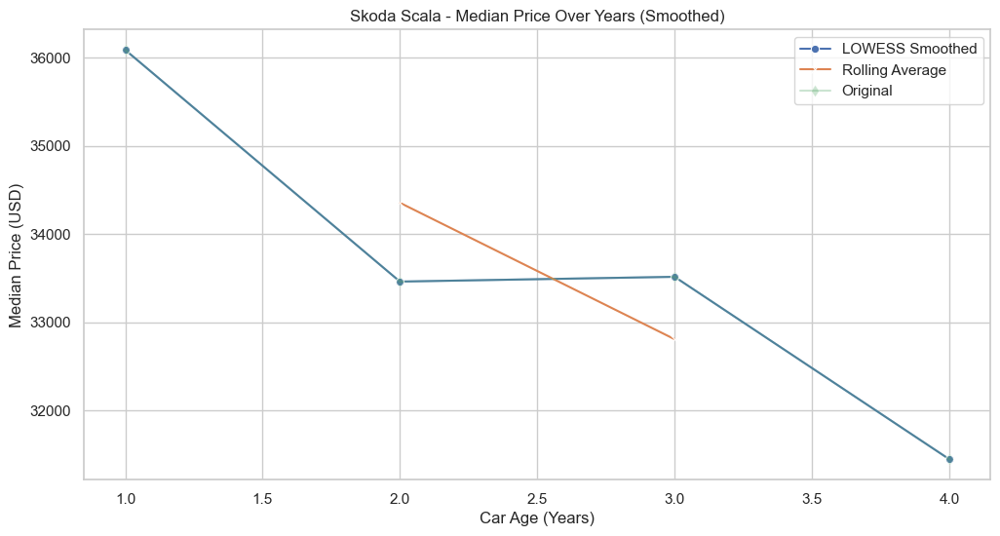

Skoda Scala - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                1              NaN          8      36087.57
1                2            -7.28          9      33461.75
2                3             0.16          8      33515.97
3                4            -6.17         20      31447.85
Processing Mitsubishi Colt
Columns in median_prices for Mitsubishi Colt: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Mitsubishi Colt: 'y'
Processing Ford C-Max
Columns in median_prices for Ford C-Max: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


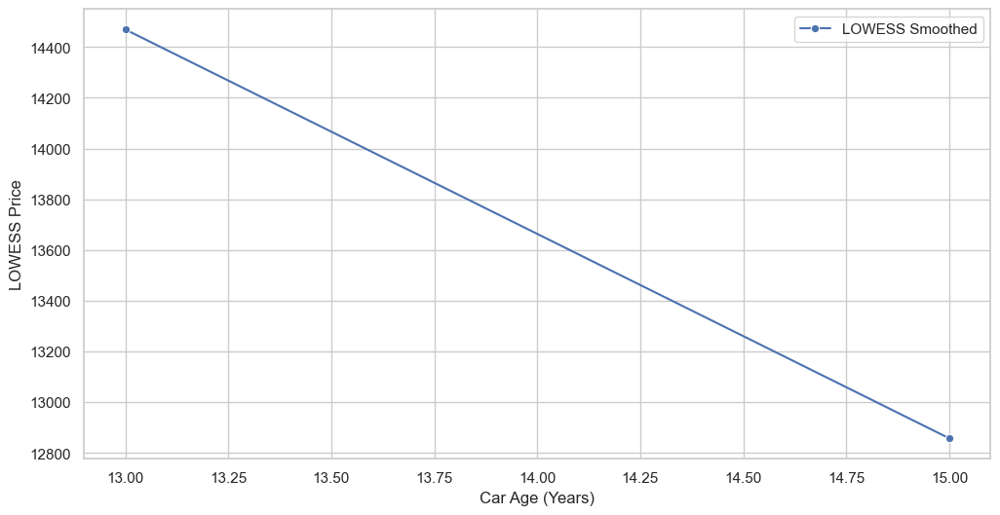

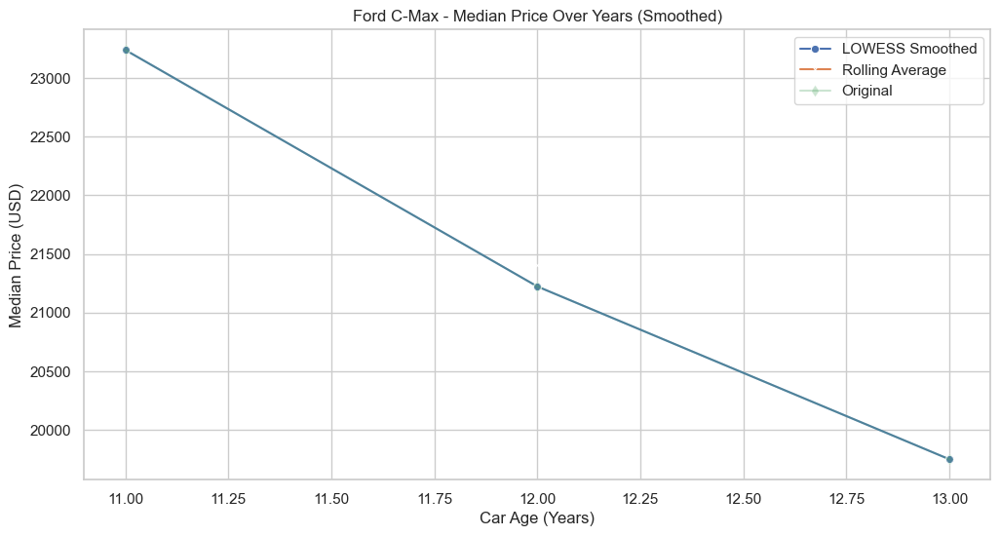

Ford C-Max - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
4               11              NaN          6      23237.33
5               12            -8.67         12      21223.42
6               13            -6.93          6      19751.73
Processing Tofaş Murat
No data available for Tofaş Murat after applying filters.
Processing Ford 1.5 TDCi Trend X
Columns in median_prices for Ford 1.5 TDCi Trend X: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


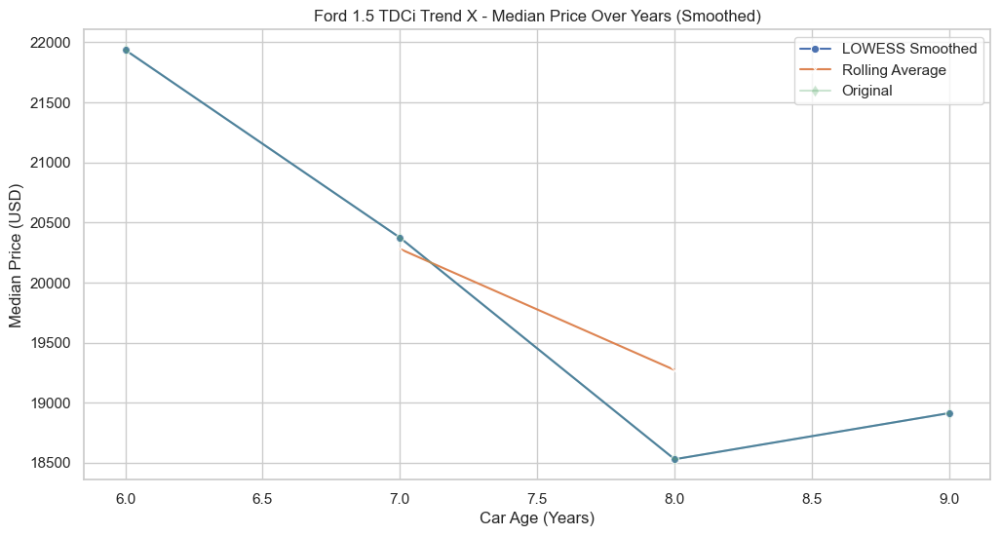

Ford 1.5 TDCi Trend X - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN         10      21936.49
2                7            -7.12          6      20373.68
3                8            -9.05         14      18529.01
4                9             2.07         18      18913.40
Processing Fiat Tempra
No data available for Fiat Tempra after applying filters.
Processing Renault R 12
No data available for Renault R 12 after applying filters.
Processing Renault R 19
No data available for Renault R 19 after applying filters.
Processing Fiat 1.3 Multijet Pop
Columns in median_prices for Fiat 1.3 Multijet Pop: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


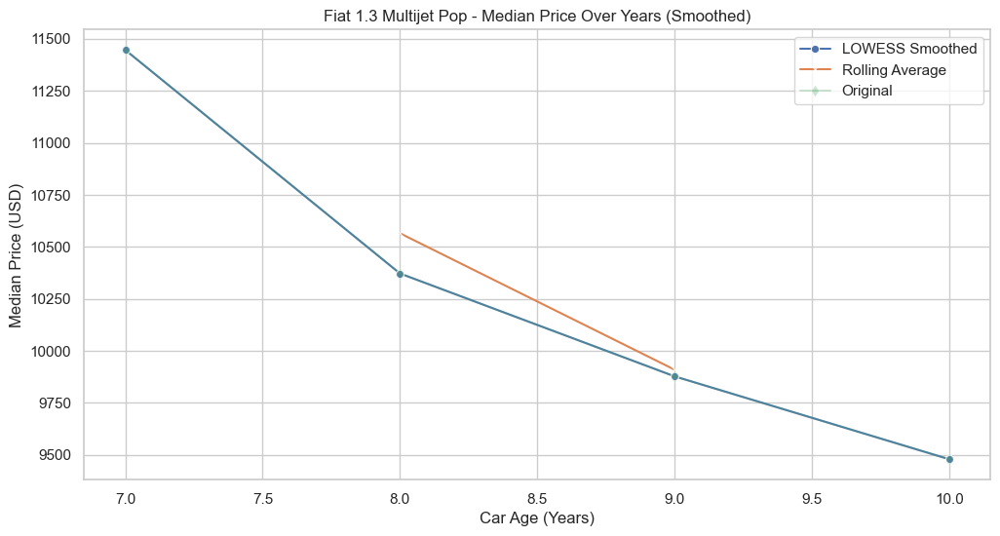

Fiat 1.3 Multijet Pop - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN          8      11446.24
1                8            -9.39         17      10371.68
2                9            -4.77         28       9877.06
3               10            -4.03          6       9478.58
Processing Volvo V40
Columns in median_prices for Volvo V40: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


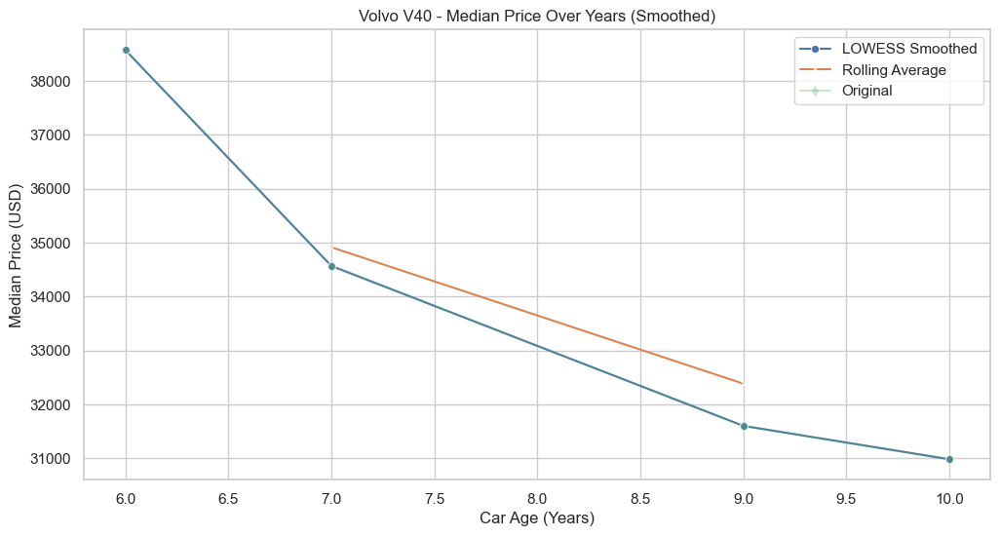

Volvo V40 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN          7      38573.96
2                7           -10.38          7      34569.39
4                9            -8.58          7      31602.76
5               10            -1.96          5      30983.10
Processing Dacia 1.5 dCi Laureate
Columns in median_prices for Dacia 1.5 dCi Laureate: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


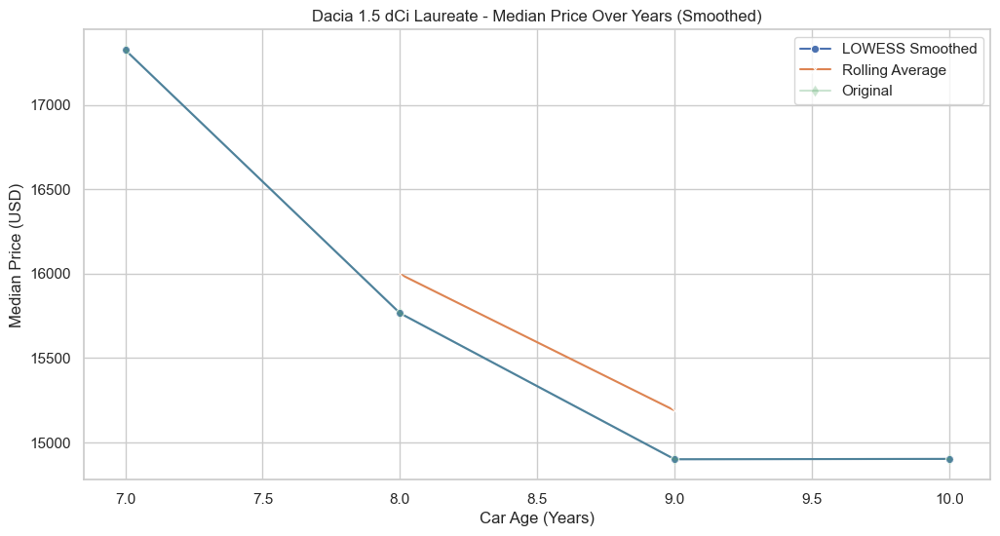

Dacia 1.5 dCi Laureate - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                7              NaN         15      17324.90
1                8            -9.00          6      15765.68
2                9            -5.49         12      14900.26
3               10             0.01          5      14902.35
Processing Volvo S80
Columns in median_prices for Volvo S80: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


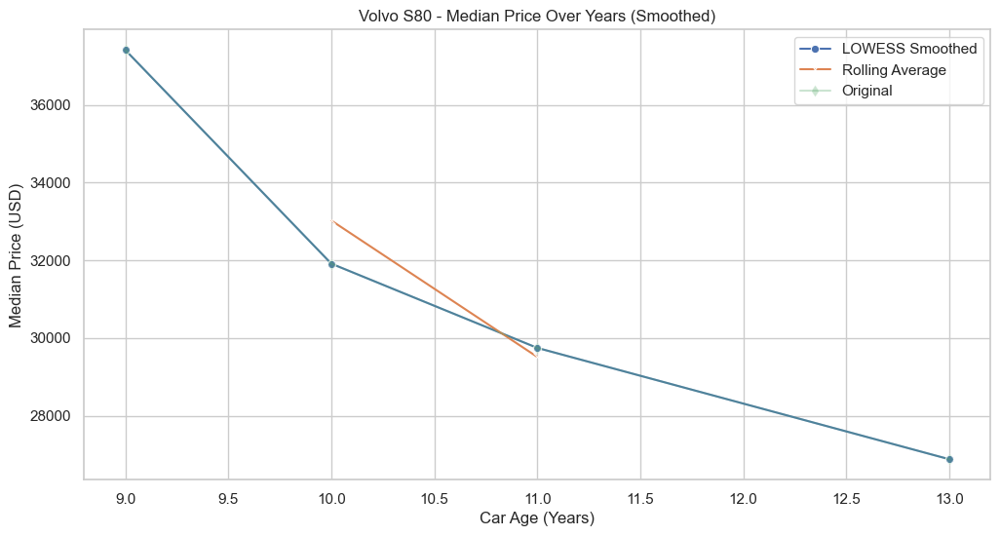

Volvo S80 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                9              NaN          6      37412.09
2               10           -14.70          6      31912.59
3               11            -6.80          5      29743.78
5               13            -9.64          6      26877.82
Processing Opel Insignia
Columns in median_prices for Opel Insignia: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


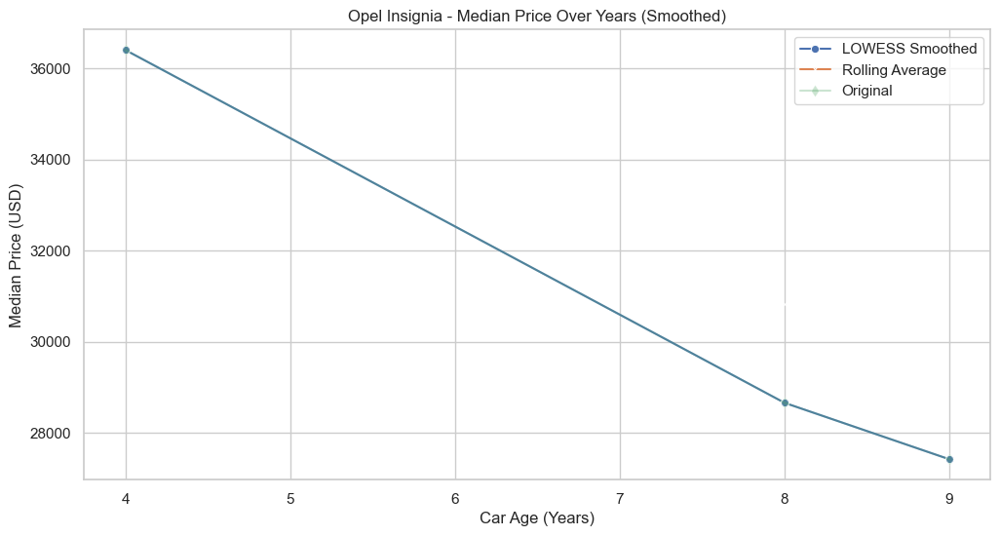

Opel Insignia - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                4              NaN          7      36405.14
4                8           -21.28          9      28659.37
5                9            -4.32          9      27420.04
Processing Ford Fusion
No data available for Ford Fusion after filtering for car count.
Processing Volkswagen VW CC
Columns in median_prices for Volkswagen VW CC: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


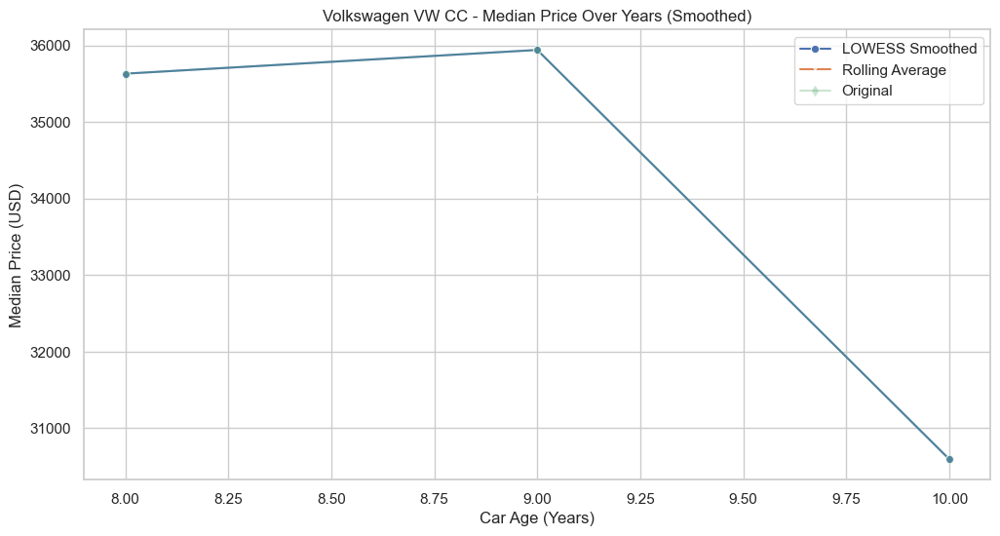

Volkswagen VW CC - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                8              NaN          9      35630.57
1                9             0.87         13      35940.40
2               10           -14.87         10      30595.81
Processing Skoda Forman
No data available for Skoda Forman after filtering for car count.
Processing Citroen C4 Grand Picasso
Columns in median_prices for Citroen C4 Grand Picasso: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Citroen C4 Grand Picasso: 'y'
Processing Peugeot 106
No data available for Peugeot 106 after applying filters.
Processing Opel 1.6 CDTI Design
Columns in median_prices for Opel 1.6 CDTI Design: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


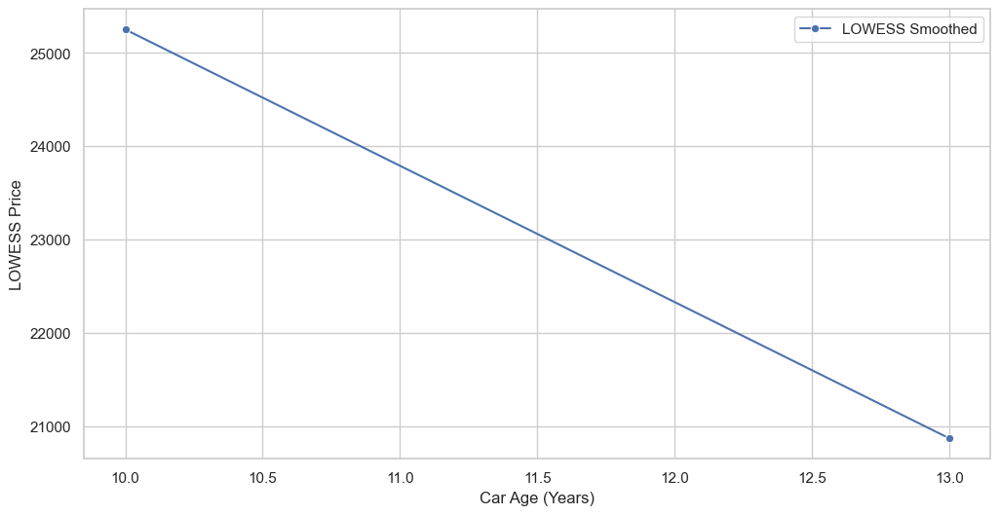

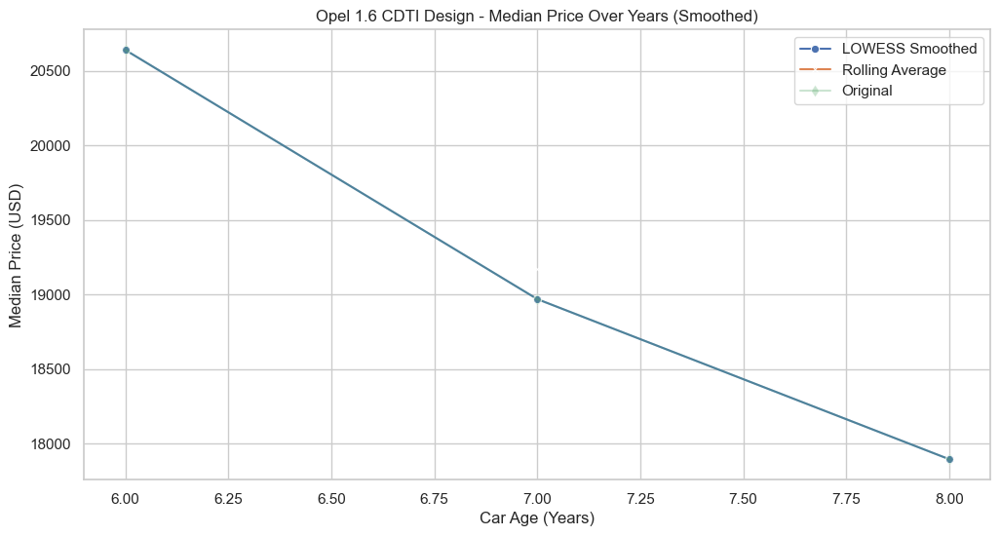

Opel 1.6 CDTI Design - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                6              NaN          5      20639.43
1                7            -8.09         21      18968.97
2                8            -5.66         11      17895.36
Processing BMW 7 Series
Columns in median_prices for BMW 7 Series: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing BMW 7 Series: 'y'
Processing Mercedes 190
No data available for Mercedes 190 after applying filters.
Processing Alfa Romeo 156
No data available for Alfa Romeo 156 after applying filters.
Processing Dacia 1.5 dCi Stepway
Columns in median_prices for Dacia 1.5 dCi Stepway: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


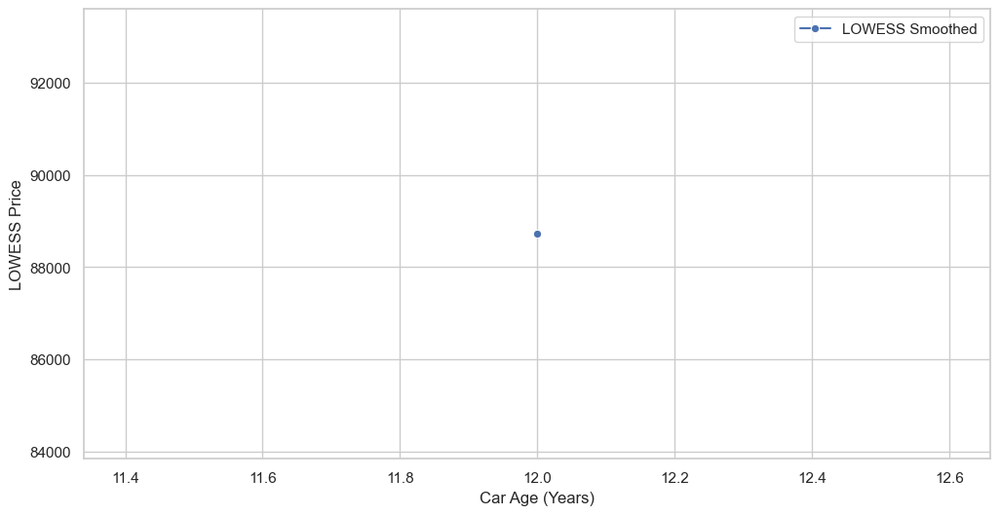

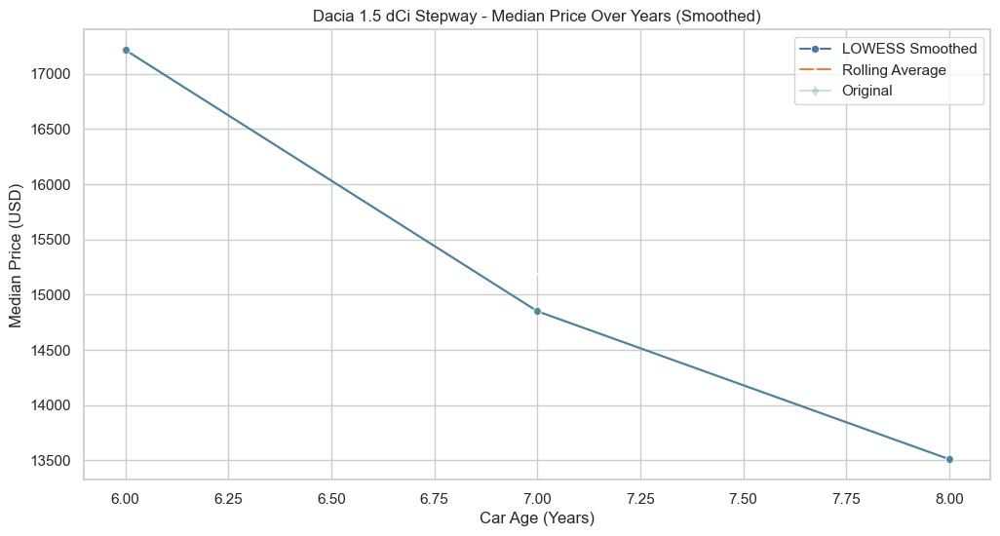

Dacia 1.5 dCi Stepway - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN          6      17214.31
2                7           -13.74         13      14848.51
3                8            -9.03          7      13508.06
Processing Kia Sephia
No data available for Kia Sephia after applying filters.
Processing Fiat 500
Columns in median_prices for Fiat 500: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Fiat 500: 'y'
Processing Tofaş Serçe
No data available for Tofaş Serçe after applying filters.
Processing Hyundai i10
Columns in median_prices for Hyundai i10: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Hyundai i10: 'y'
Processing Fiat Fiorino
Columns in median_prices for Fiat Fiorino: Index(['Car A

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


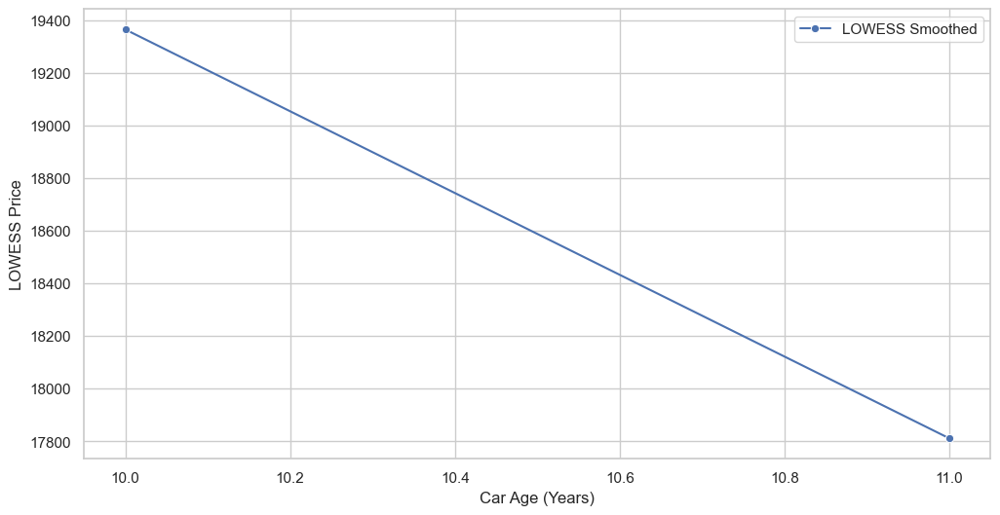

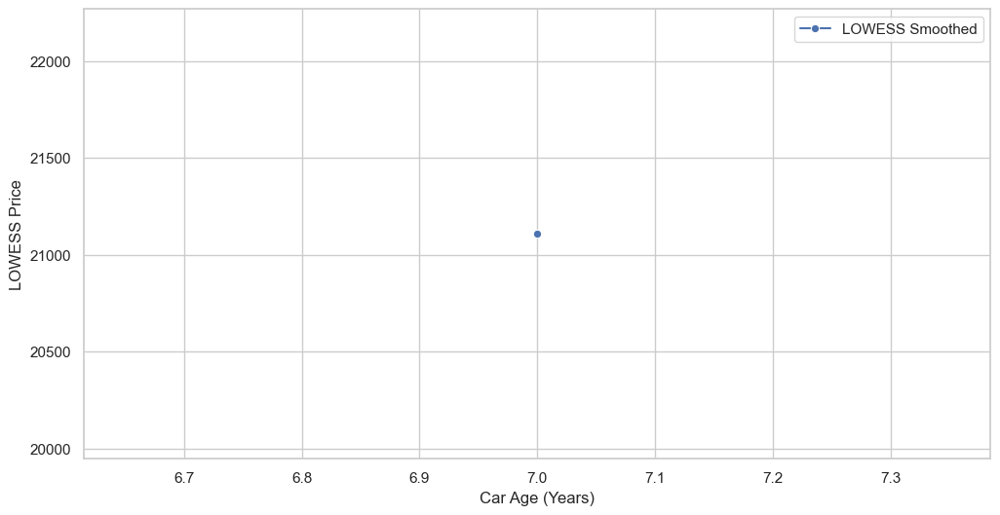

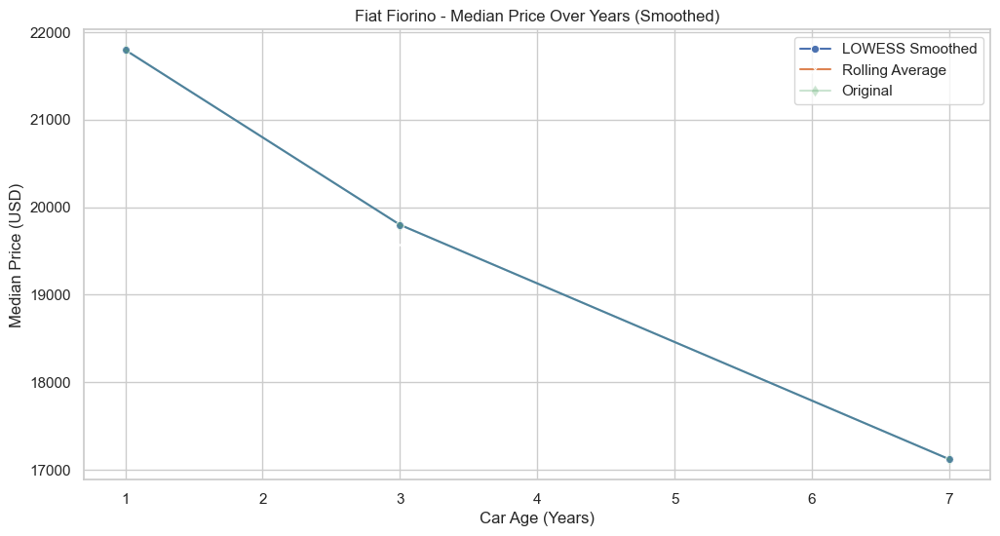

Fiat Fiorino - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                1              NaN          6      21796.61
3                3            -9.17          5      19798.20
7                7           -13.54          5      17118.16
Processing Fiat Marea
No data available for Fiat Marea after applying filters.
Processing Dacia Solenza
No data available for Dacia Solenza after applying filters.
Processing Fiat Siena
No data available for Fiat Siena after applying filters.
Processing Seat 1.6 TDI Style
Columns in median_prices for Seat 1.6 TDI Style: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


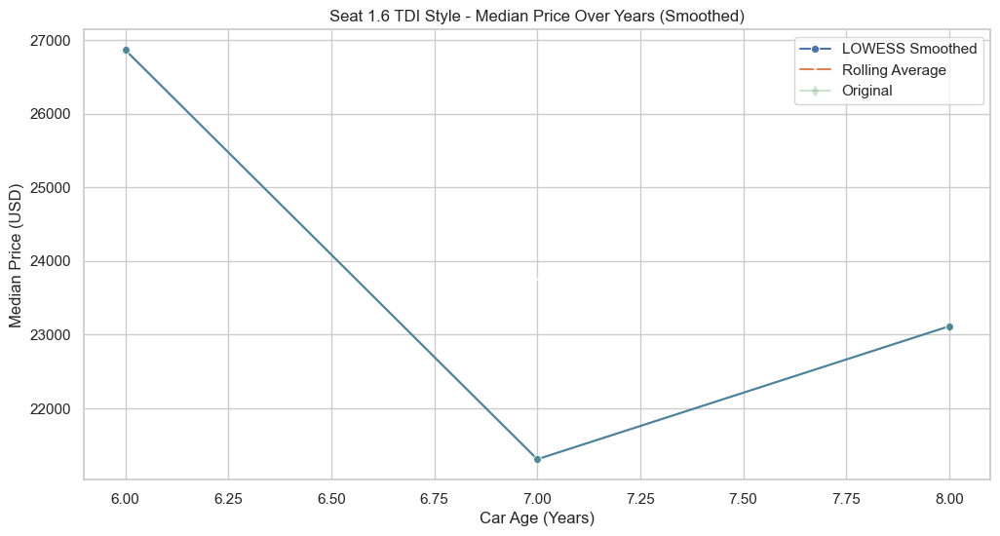

Seat 1.6 TDI Style - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
1                6              NaN          6      26865.62
2                7           -20.69          5      21307.61
3                8             8.48         12      23114.21
Processing Alfa Romeo 147
No data available for Alfa Romeo 147 after filtering for car count.
Processing Audi 3.0 TDI Quattro
No data available for Audi 3.0 TDI Quattro after filtering for car count.
Processing BMW 2 Series
Columns in median_prices for BMW 2 Series: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing BMW 2 Series: 'y'
Processing Seat Altea
Columns in median_prices for Seat Altea: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Seat Altea: 'y'
Processing Tata Indica
No data ava

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


Error processing Fiat Doblo: 'y'
Processing Porsche Panamera
Columns in median_prices for Porsche Panamera: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Porsche Panamera: 'y'
Processing Ford Taunus
No data available for Ford Taunus after applying filters.
Processing Toyota Verso
Columns in median_prices for Toyota Verso: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Toyota Verso: 'y'
Processing Peugeot 406
No data available for Peugeot 406 after applying filters.
Processing Hyundai 1.6 GDI Style
Columns in median_prices for Hyundai 1.6 GDI Style: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Hyundai 1.6 GDI Style: 'y'
Processing BMW 4 Series
Columns in median_pric

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


Columns in median_prices for Tata Indigo: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Tata Indigo: 'y'
Processing Volvo S90
Columns in median_prices for Volvo S90: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


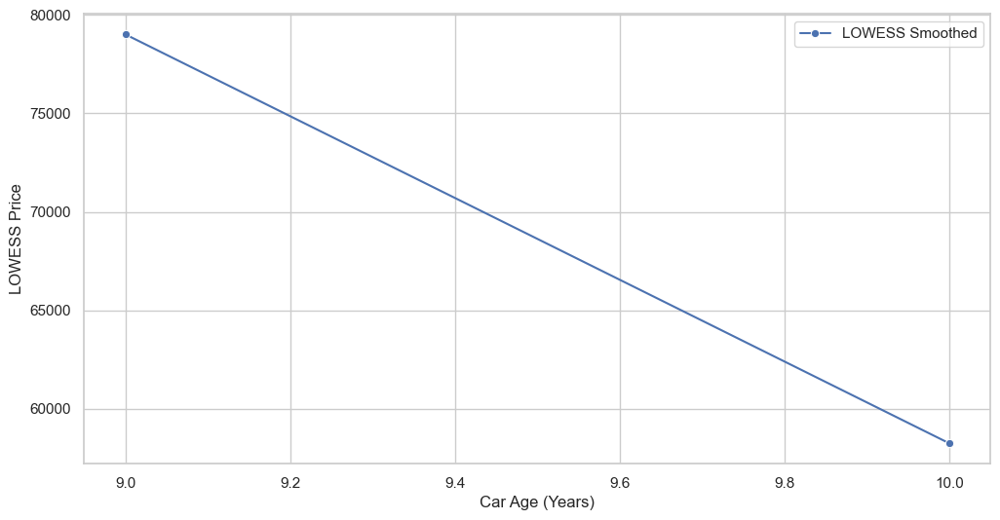

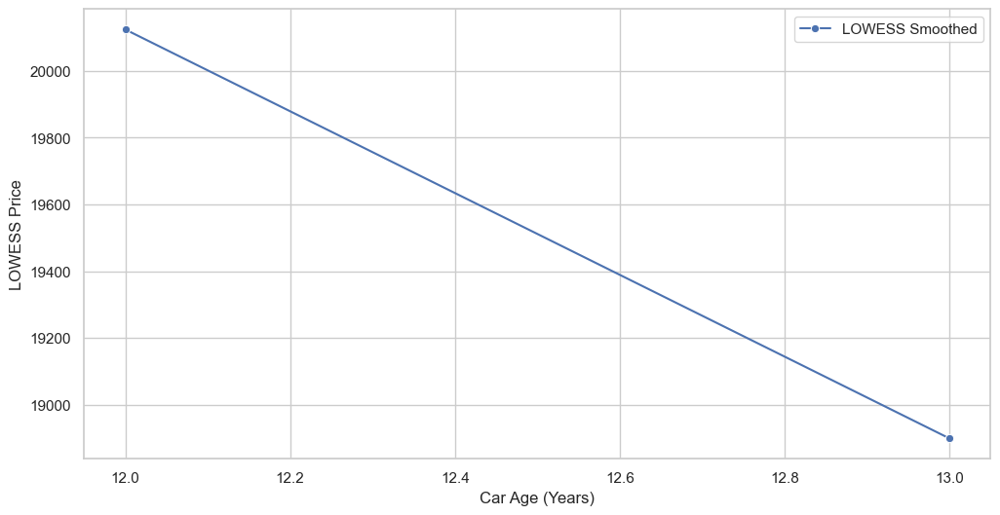

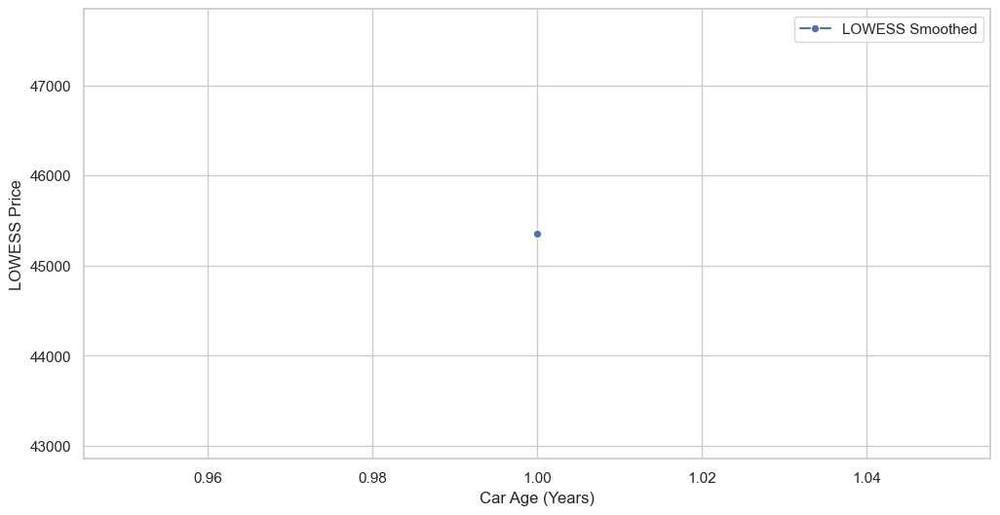

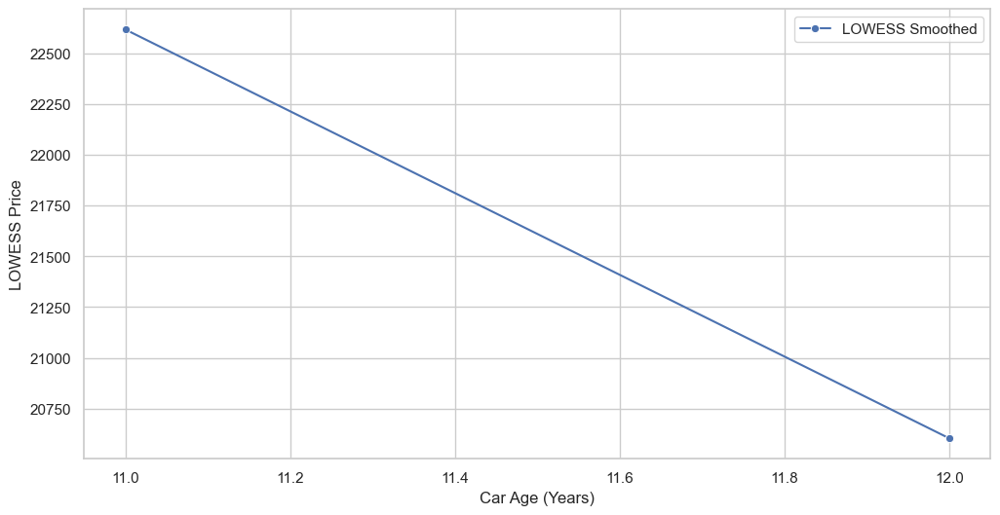

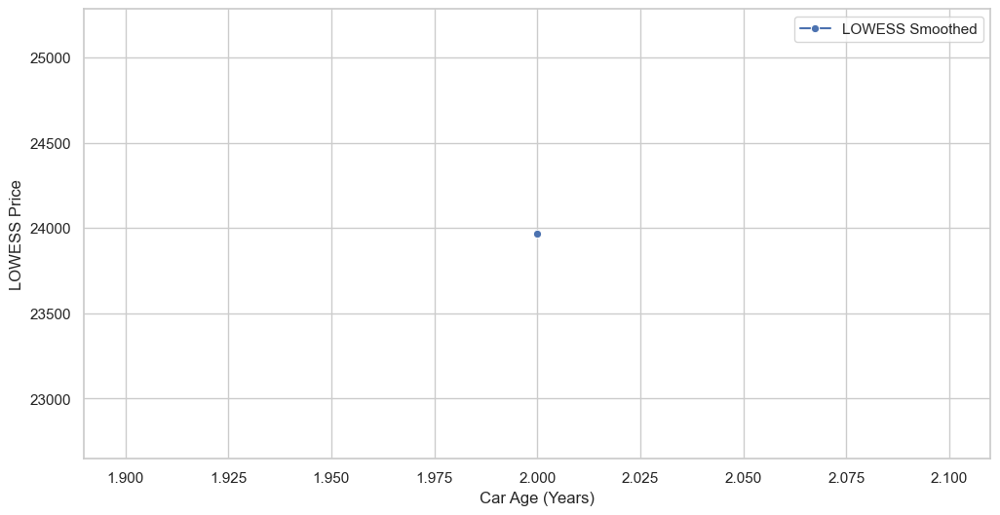

...

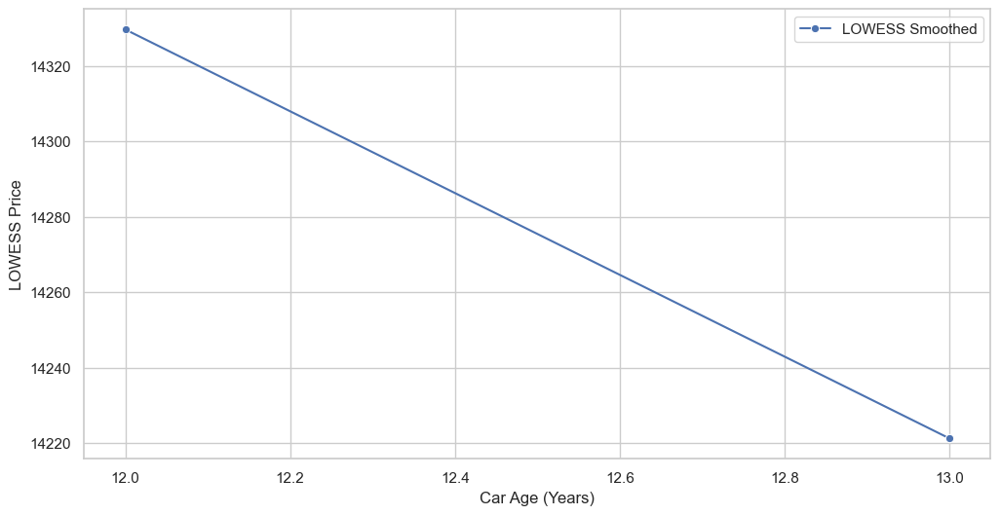

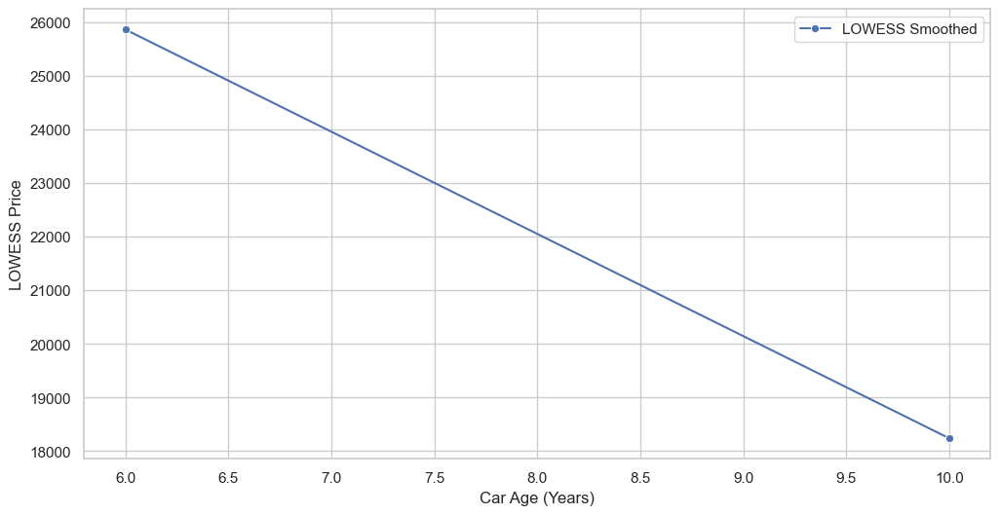

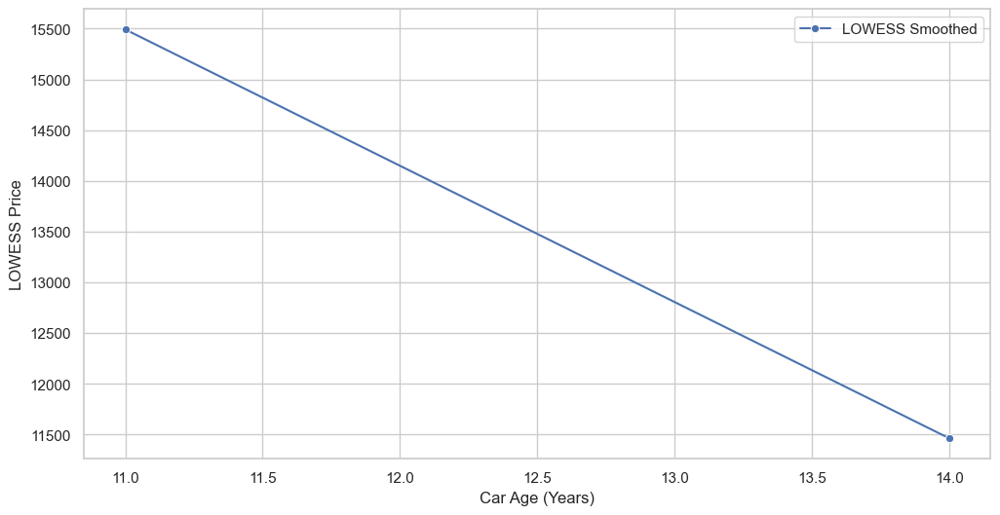

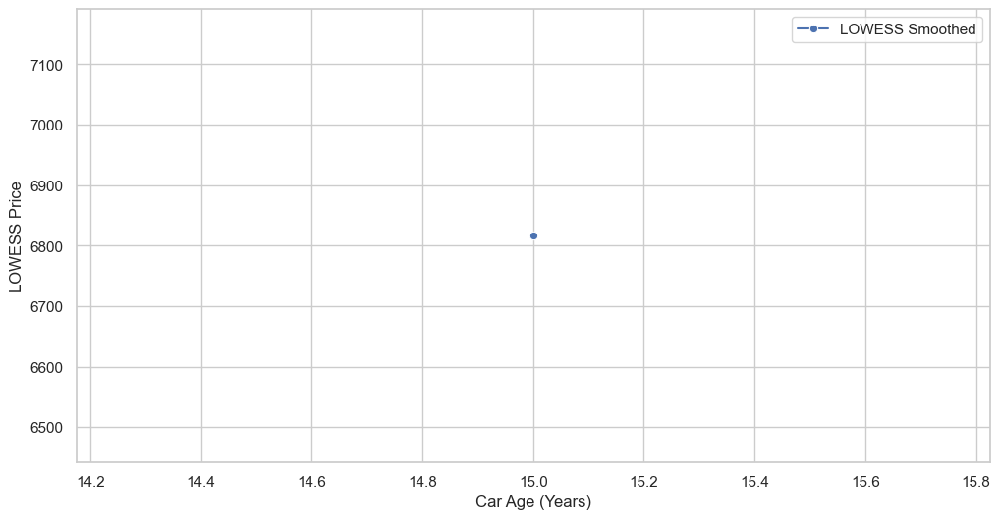

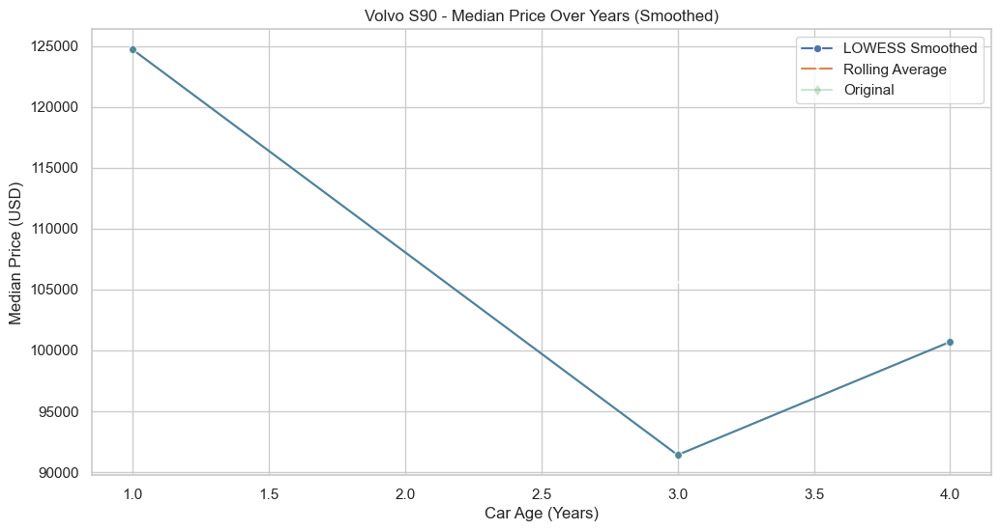

Volvo S90 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
0                1              NaN          5     124706.98
2                3           -26.71          5      91400.15
3                4            10.17          5     100695.08
Processing Mercedes A Class
Columns in median_prices for Mercedes A Class: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Mercedes A Class: 'y'
Processing Suzuki SX4
Columns in median_prices for Suzuki SX4: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')


/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


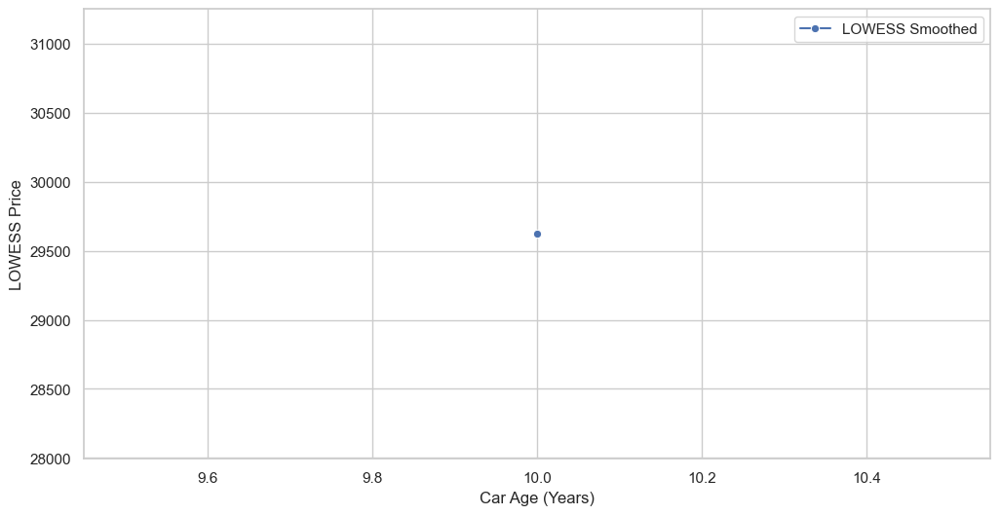

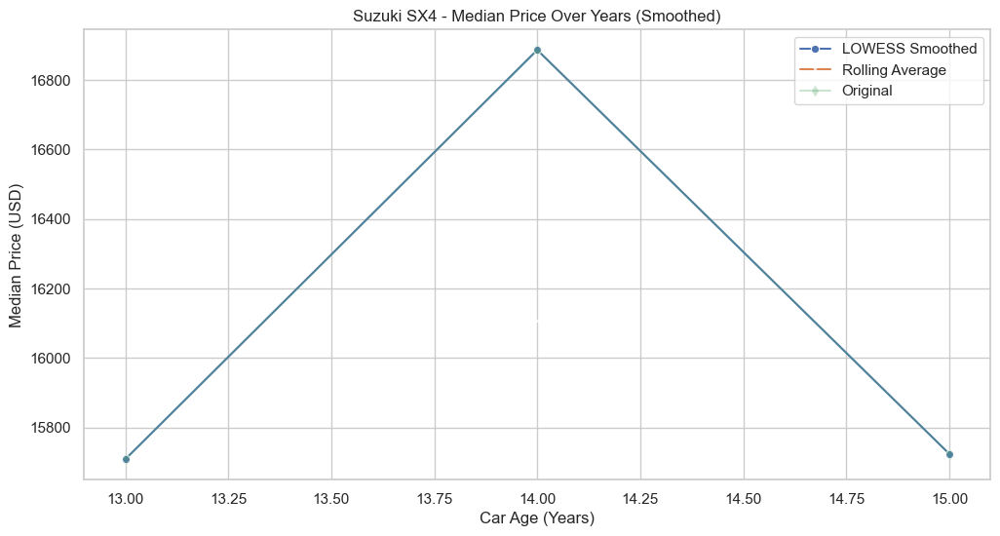

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


Suzuki SX4 - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2               13              NaN          7      15708.43
3               14             7.50          5      16885.79
4               15            -6.88          6      15723.92
Processing Tata Marina
Columns in median_prices for Tata Marina: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Tata Marina: 'y'
Processing Dacia 1.5 dCi Ambiance
Columns in median_prices for Dacia 1.5 dCi Ambiance: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Dacia 1.5 dCi Ambiance: 'y'
Processing Ford 1.6 TDCi Titanium
Columns in median_prices for Ford 1.6 TDCi Titanium: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res

Columns in median_prices for Fiat 1.3 Multijet Active Plus
: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Fiat 1.3 Multijet Active Plus
: 'y'
Processing Mercedes 250
No data available for Mercedes 250 after applying filters.
Processing Suzuki Alto
Columns in median_prices for Suzuki Alto: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Suzuki Alto: 'y'
Processing Fiat 1.3 Multijet Urban
Columns in median_prices for Fiat 1.3 Multijet Urban: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Fiat 1.3 Multijet Urban: 'y'
Processing Fiat Bravo
Columns in median_prices for Fiat Bravo: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Pric

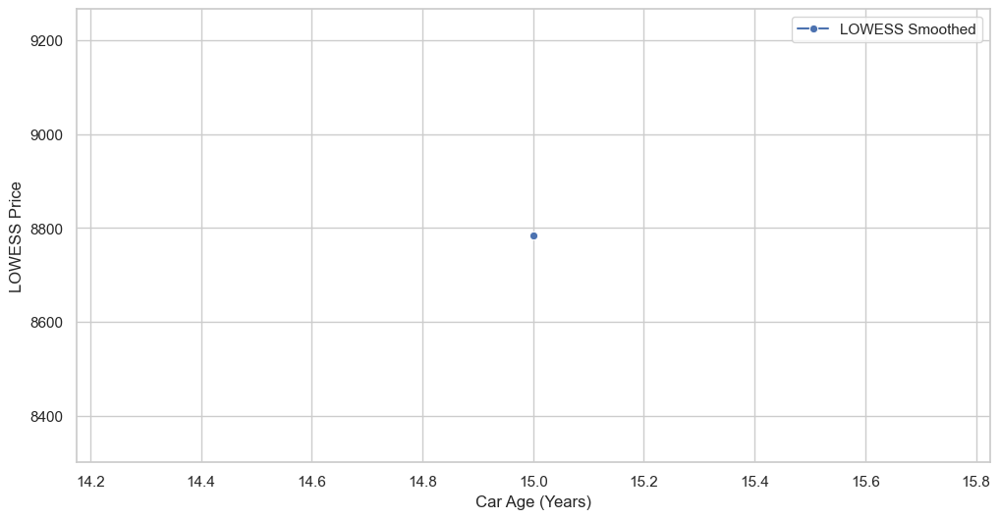

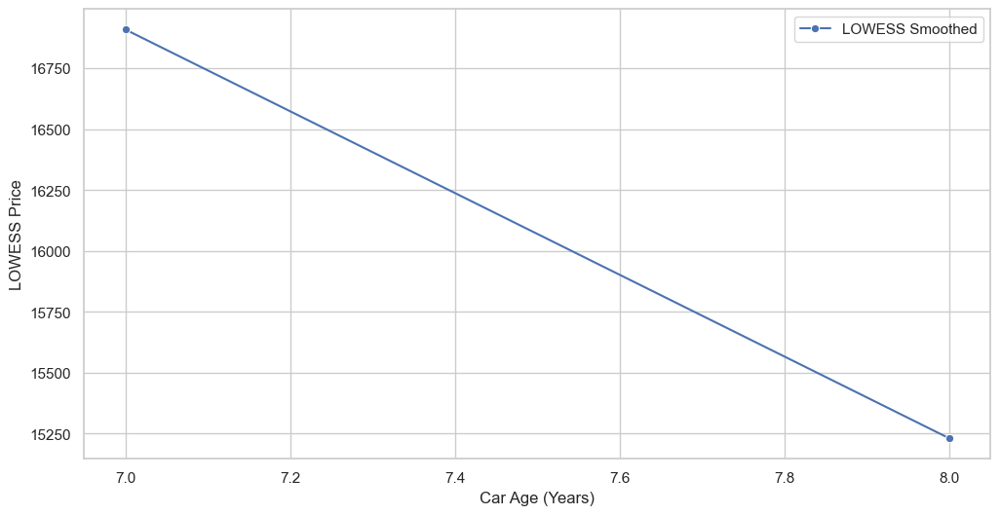

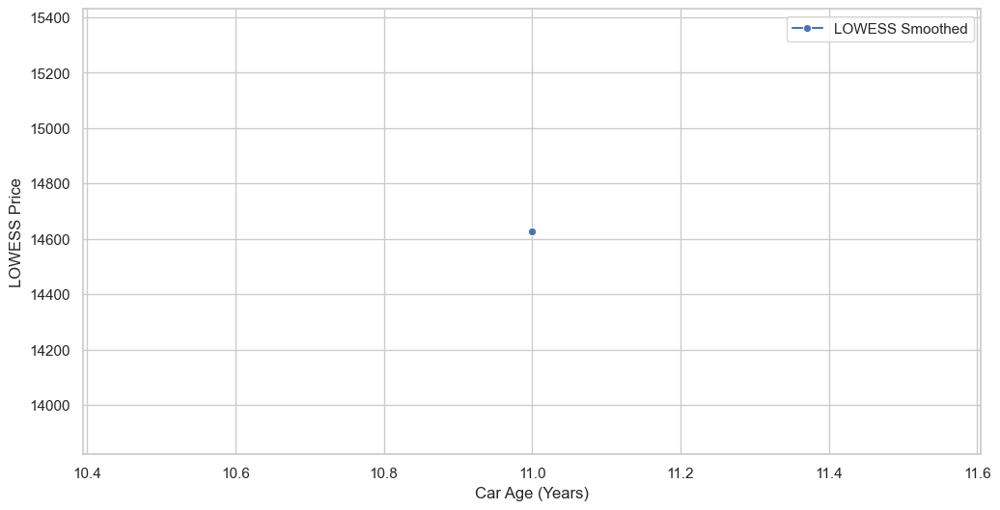

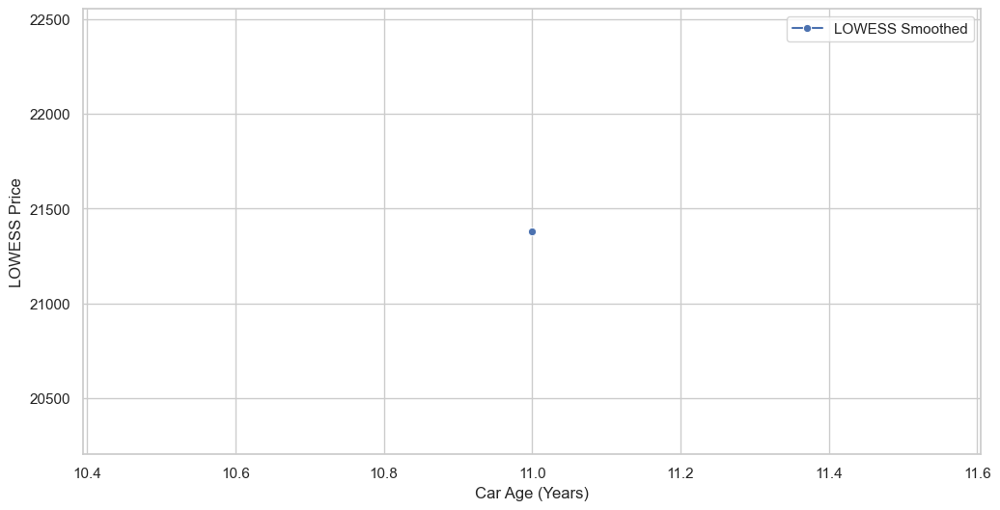

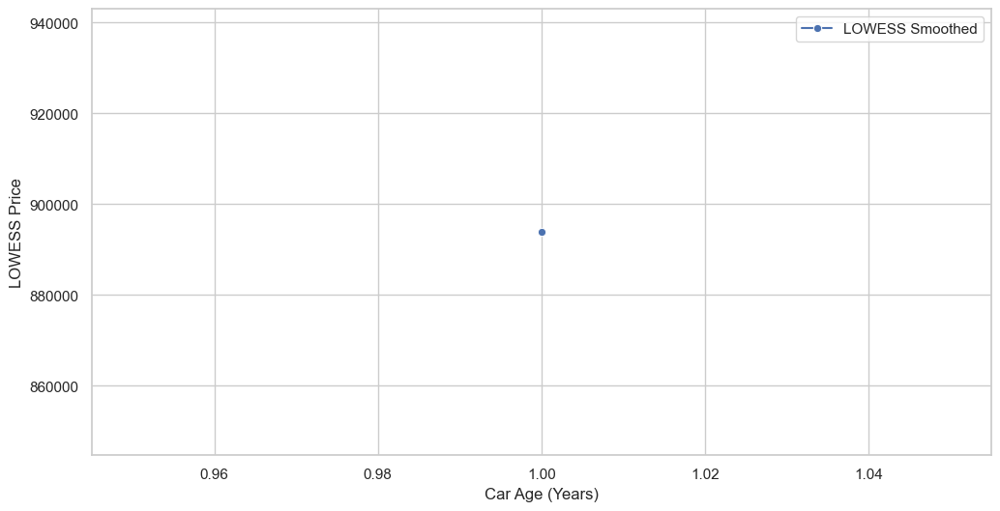

...

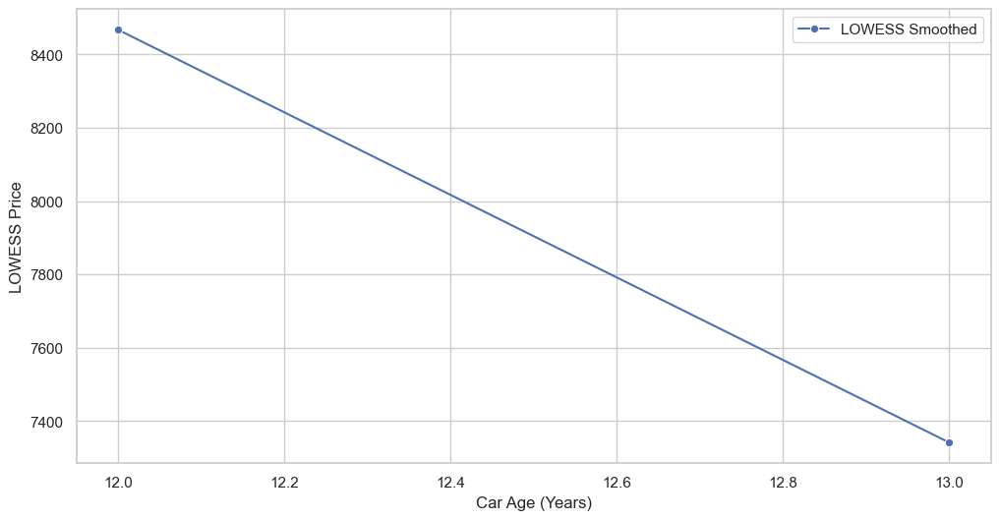

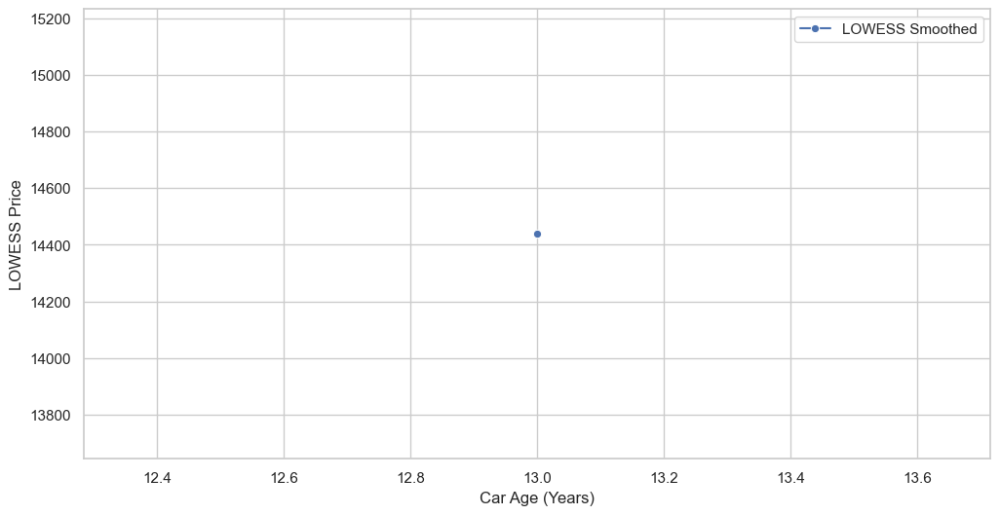

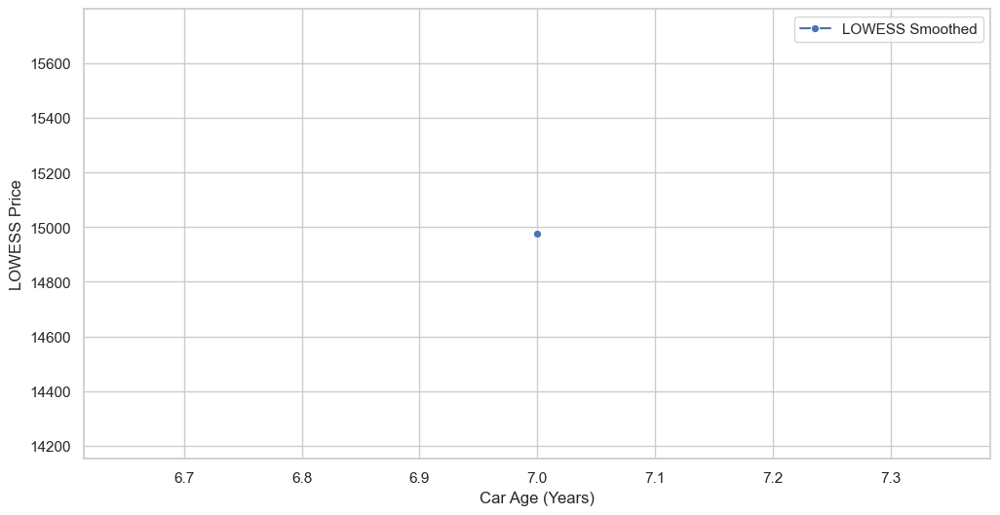

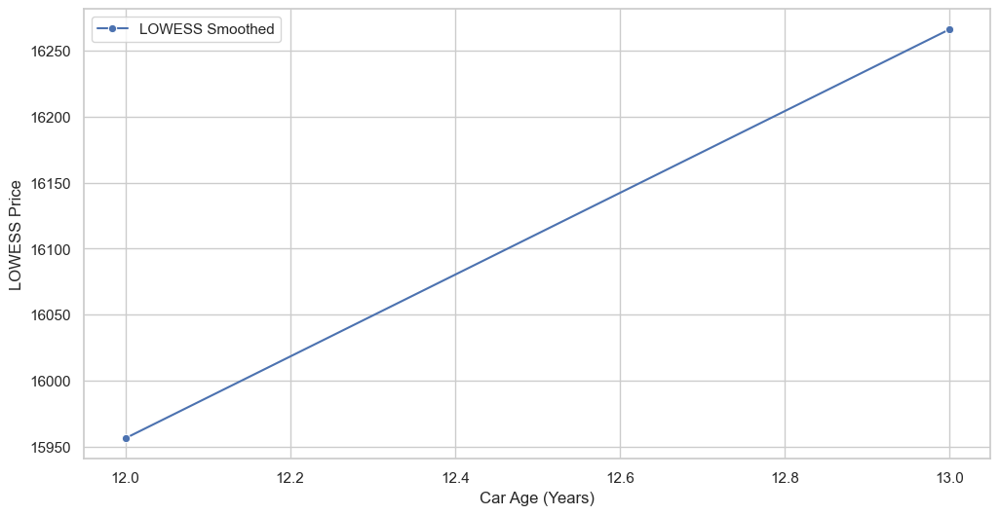

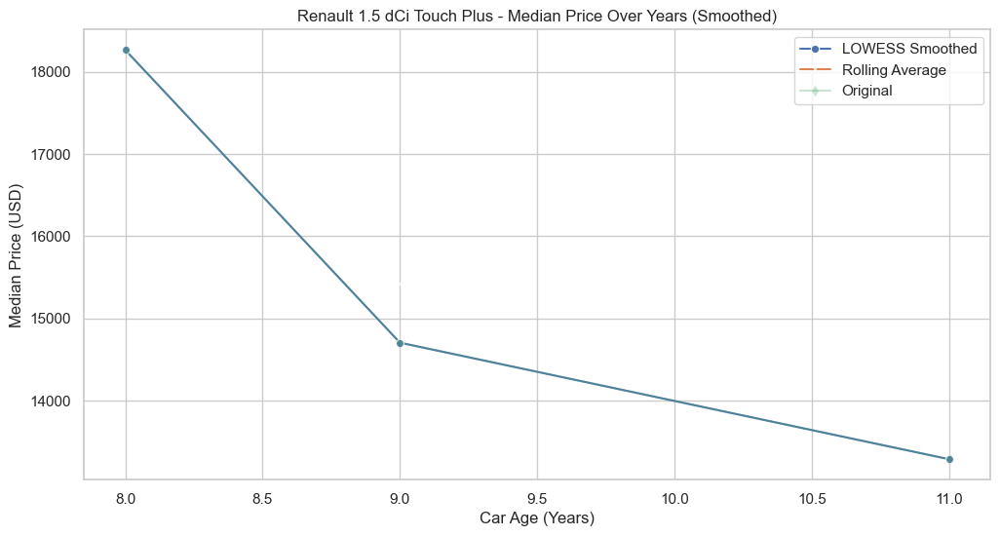

Renault 1.5 dCi Touch Plus - Percentage Loss Over Years
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute
2                8              NaN          5      18263.67
3                9           -19.49          6      14704.65
5               11            -9.64          6      13287.32
Processing Ford 1.6 TDCi Trend
No data available for Ford 1.6 TDCi Trend after filtering for car count.
Processing Peugeot 1.2 PureTech GT Line
Columns in median_prices for Peugeot 1.2 PureTech GT Line: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Peugeot 1.2 PureTech GT Line: 'y'
Processing Skoda Roomster
Columns in median_prices for Skoda Roomster: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Skoda Roomster: 'y'
Processing Mazda 6
No data available for Mazda 6 after filteri

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res

Columns in median_prices for Chevrolet Epica: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Chevrolet Epica: 'y'
Processing Audi A8
No data available for Audi A8 after filtering for car count.
Processing Citroen C2
No data available for Citroen C2 after applying filters.
Processing Toyota Corona
No data available for Toyota Corona after applying filters.
Processing Rover 216
No data available for Rover 216 after applying filters.
Processing Chevrolet Rezzo
No data available for Chevrolet Rezzo after applying filters.
Processing Citroen AMİ
Columns in median_prices for Citroen AMİ: Index(['Car Age (Years)', 'USD Absolute', 'Car Count', 'Smoothed Price',
       'LOWESS Price', 'Percentage Loss'],
      dtype='object')
Error processing Citroen AMİ: 'y'
Processing Jaguar 2.0 D Prestige Plus
Columns in median_prices for Jaguar 2.0 D Prestige Plus: Index(['Car Age (Years)', 'USD Absol

/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
/Users/soringrigoras/anaconda3/lib/python3.11/site-packages/statsmodels/nonparametric/smoothers_lowess.py:227: RuntimeWarning: invalid value encountered in divide
  res

    Car Age (Years)  USD Absolute  Car Count  Smoothed Price  LOWESS Price  \
1                 1      47481.60         30             NaN      47481.60   
2                 2      40092.13         33        43236.92      40092.13   
3                 3      42137.02         29        38150.52      42137.02   
4                 4      32222.42         30        36353.50      32222.42   
5                 5      34701.07         56        33487.57      34701.07   
6                 6      33539.21         76        33487.57      33539.21   
7                 7      32222.42        129        31422.03      32222.42   
8                 8      28504.45        201        29227.39      28504.45   
9                 9      26955.30        209        27011.46      26955.30   
10               10      25574.63         99        25772.14      25574.63   
11               11      24786.48        154        23861.51      24786.48   
12               12      21223.42        134        22251.03    

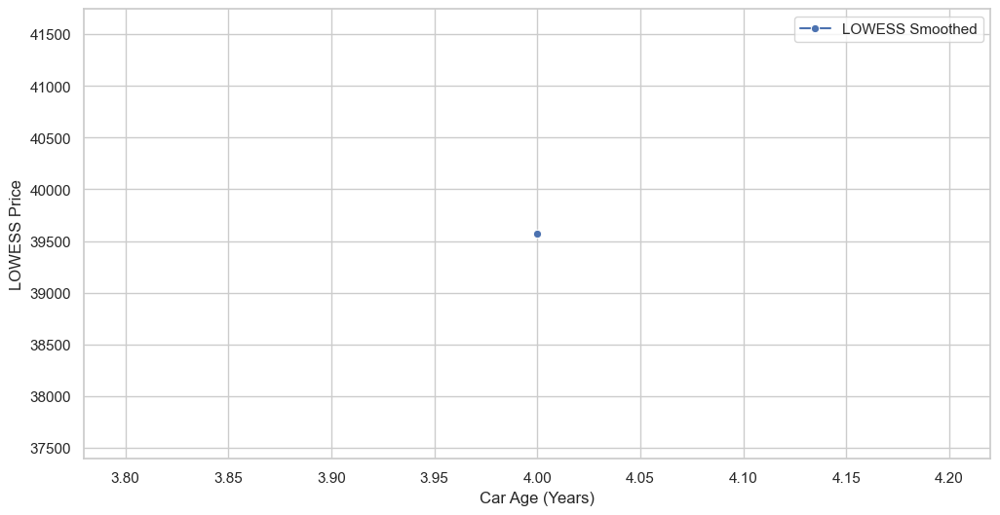

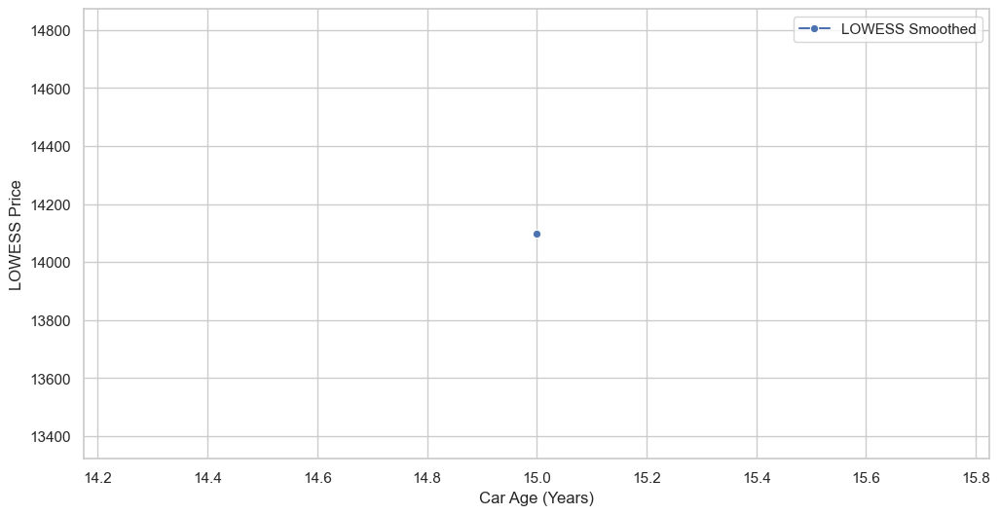

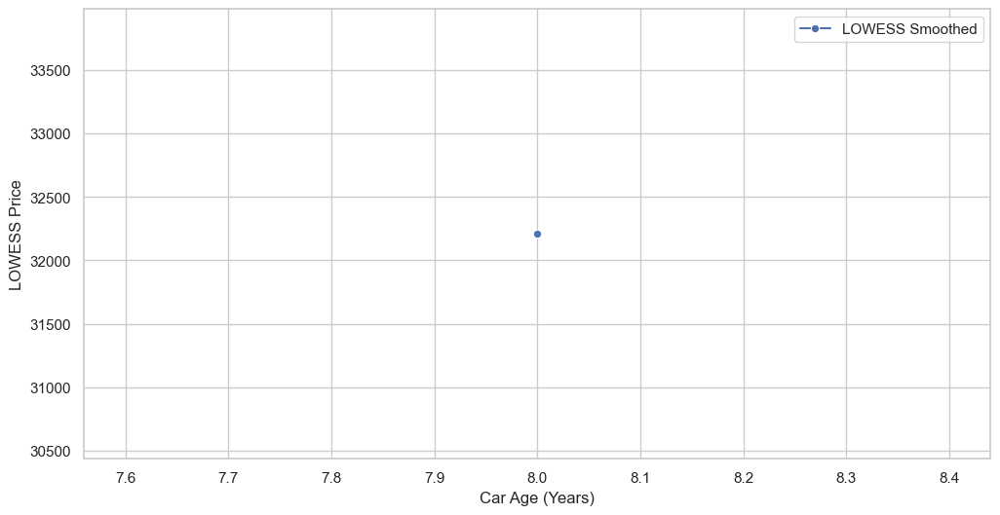

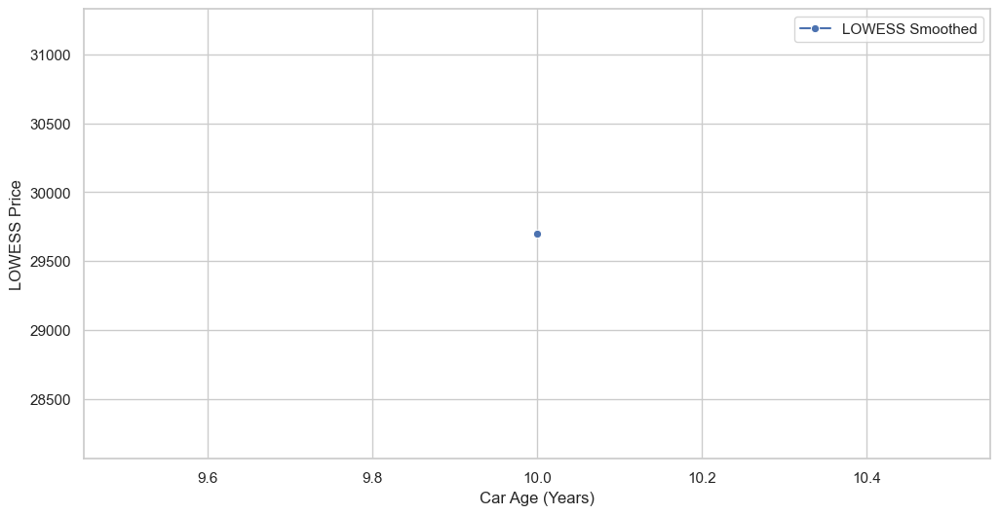

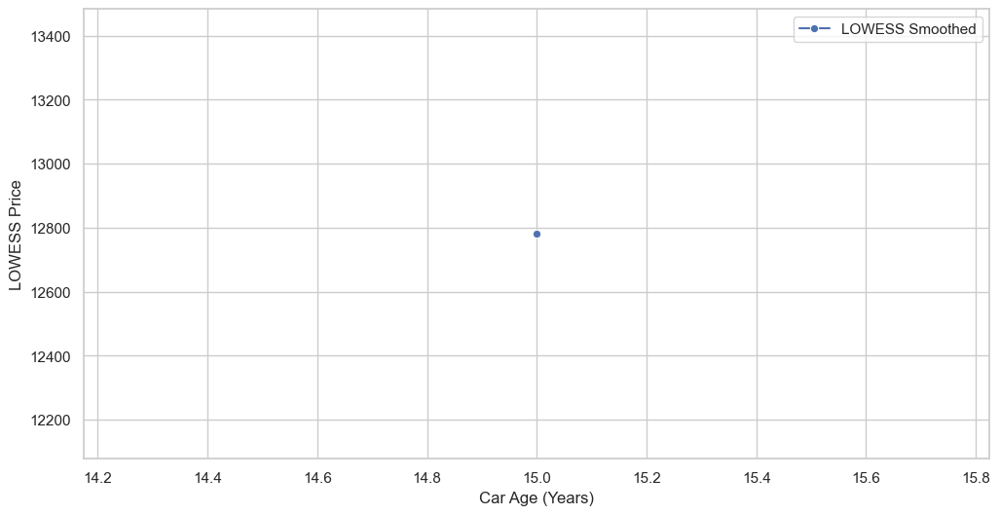

...

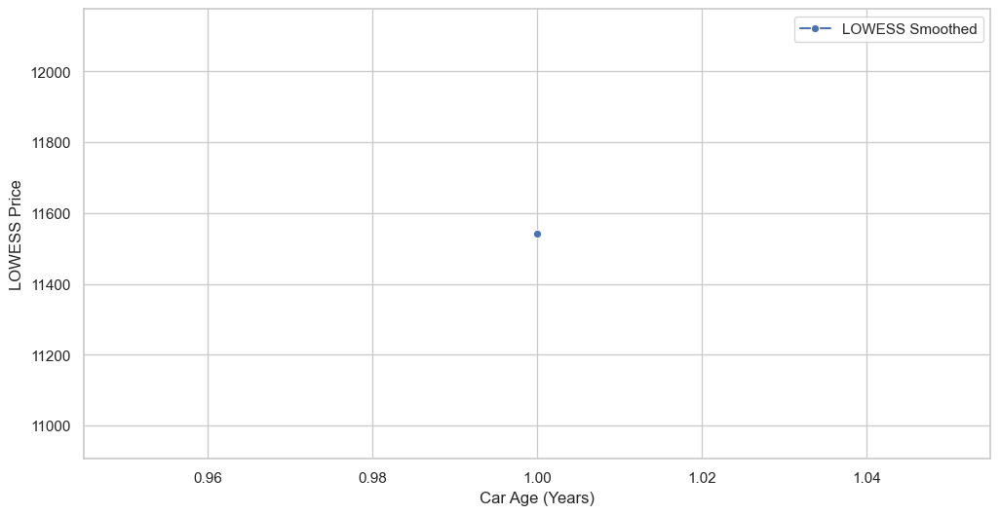

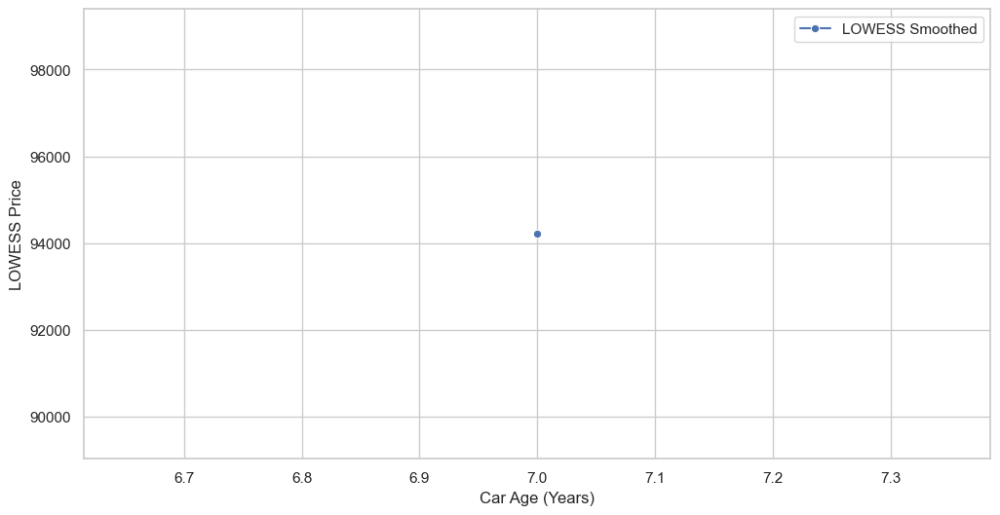

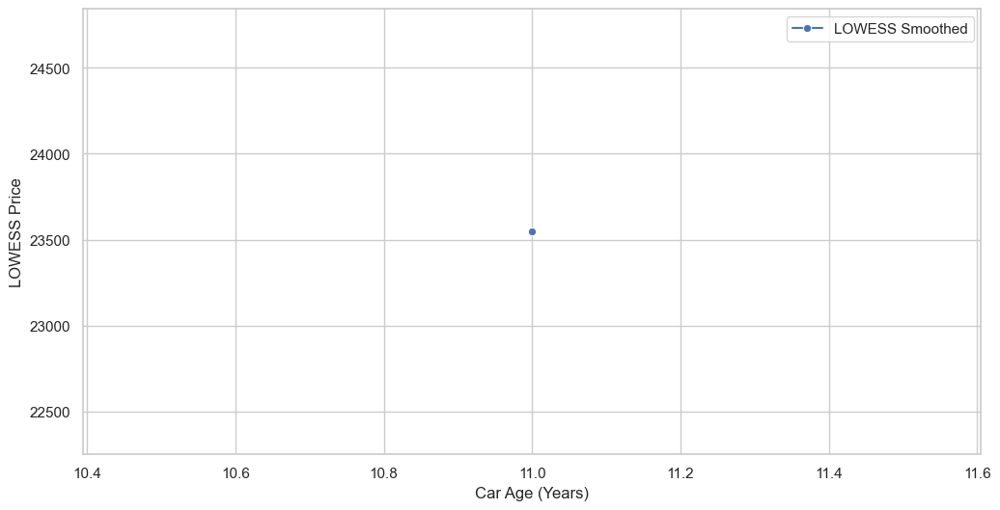

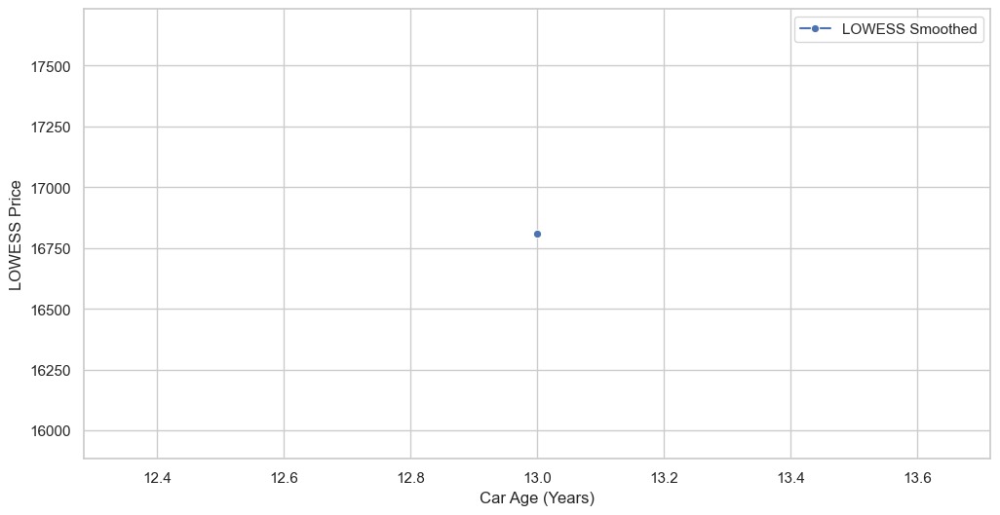

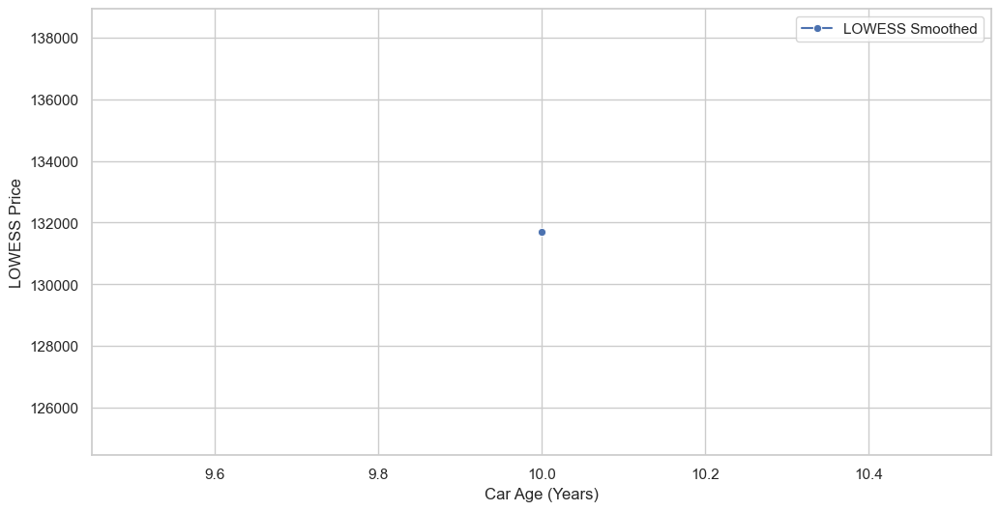

In [48]:
# Identify all Make-Model combinations and count their occurrences
make_model_counts = df_4yr.groupby(['Make', 'Model']).size().reset_index(name='counts')

# Filter out Make-Model combinations with fewer than 20 entries
make_model_filtered = make_model_counts[make_model_counts['counts'] >= 20]

# Remove specific models(Diger in Turkish means "Other")
make_model_filtered = make_model_filtered[~((make_model_filtered['Make'] == 'BMW') & (make_model_filtered['Model'] == 'Diğer'))]
make_model_filtered = make_model_filtered[~((make_model_filtered['Make'] == 'Chevrolet') & (make_model_filtered['Model'] == 'Kalos'))]
make_model_filtered = make_model_filtered[~(make_model_filtered['Model'] == 'Diğer')]

# Sort the Make-Model combinations by total counts in descending order
make_model_filtered = make_model_filtered.sort_values(by='counts', ascending=False)

# Prepare a dictionary to store results
results = {}
percentage_losses = []

# Process each Make-Model combination
for _, row in make_model_filtered.iterrows():
    make, model = row['Make'], row['Model']
    print(f"Processing {make} {model}")
    
    try:
        df_make_model = df_4yr[(df_4yr['Make'] == make) & (df_4yr['Model'] == model)]
        
        # Filter based on kilometers
        median_km = df_make_model['Kilometers (km)'].median()
        df_make_model = df_make_model[df_make_model['Kilometers (km)'] <= median_km * 1.3]
        
        # Filter out cars older than 15 years
        df_make_model = df_make_model[df_make_model['Car Age (Years)'] <= 15]

        # Ensure there are still rows left after filtering
        if df_make_model.empty:
            print(f"No data available for {make} {model} after applying filters.")
            continue

        # Group by "Car Age (Years)" and calculate the median price for each age
        median_prices = df_make_model.groupby('Car Age (Years)')['USD Absolute'].median().reset_index()

        # Ensure we have a complete range of years
        min_year = int(median_prices['Car Age (Years)'].min())
        max_year = int(median_prices['Car Age (Years)'].max())
        all_years = pd.DataFrame({'Car Age (Years)': range(min_year, max_year + 1)})
        median_prices = pd.merge(all_years, median_prices, on='Car Age (Years)', how='left')
        median_prices['USD Absolute'].interpolate(method='linear', inplace=True)

        # Add the count of cars used to calculate the median price for each year
        car_counts = df_make_model.groupby('Car Age (Years)').size().reindex(all_years['Car Age (Years)'], fill_value=0).reset_index(name='Car Count')
        median_prices = pd.merge(median_prices, car_counts, on='Car Age (Years)', how='left')

        # Filter out entries with fewer than 5 cars
        median_prices = median_prices[median_prices['Car Count'] >= 5]

        if median_prices.empty:
            print(f"No data available for {make} {model} after filtering for car count.")
            continue

        # Apply rolling average for smoothing
        median_prices['Smoothed Price'] = median_prices['USD Absolute'].rolling(window=3, center=True).mean()

        # Apply LOWESS for further smoothing
        lowess_smoothed = lowess(median_prices['USD Absolute'], median_prices['Car Age (Years)'], frac=0.2)
        median_prices['LOWESS Price'] = lowess_smoothed[:, 1]

        # Calculate the percentage loss for each year-to-year step
        median_prices['Percentage Loss'] = median_prices['LOWESS Price'].pct_change() * 100

        # Calculate the percentage loss over every possible 3-year period
        for start_year in range(min_year, max_year - 2):
            end_year = start_year + 3
            if end_year <= max_year:
                start_price = median_prices.loc[median_prices['Car Age (Years)'] == start_year, 'LOWESS Price'].values
                end_price = median_prices.loc[median_prices['Car Age (Years)'] == end_year, 'LOWESS Price'].values
                if len(start_price) > 0 and len(end_price) > 0:
                    percentage_loss_3yr = ((end_price[0] - start_price[0]) / start_price[0]) * 100
                    percentage_losses.append((make, model, start_year, end_year, percentage_loss_3yr))

        # Store the median prices in the results dictionary
        results[(make, model)] = median_prices

        # Print the columns of median_prices to ensure correct column names
        print(f'Columns in median_prices for {make} {model}: {median_prices.columns}')

        # Skip problematic entries
        if 'Smoothed Price' not in median_prices.columns or 'LOWESS Price' not in median_prices.columns:
            print(f"Skipping {make} {model} due to missing columns.")
            continue

        # Plot the results
        plt.figure(figsize=(12, 6))
        sns.lineplot(data=median_prices, x='Car Age (Years)', y='LOWESS Price', marker='o', label='LOWESS Smoothed')
        sns.lineplot(data=median_prices, x='Car Age (Years)', y='Smoothed Price', marker='x', label='Rolling Average')
        sns.lineplot(data=median_prices, x='Car Age (Years)', y='USD Absolute', marker='d', label='Original', alpha=0.3)
        plt.title(f'{make} {model} - Median Price Over Years (Smoothed)')
        plt.xlabel('Car Age (Years)')
        plt.ylabel('Median Price (USD)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Display the percentage loss along with Car Count and USD Absolute
        print(f'{make} {model} - Percentage Loss Over Years')
        print(median_prices[['Car Age (Years)', 'Percentage Loss', 'Car Count', 'USD Absolute']])

    except Exception as e:
        print(f"Error processing {make} {model}: {e}")
        continue

# Identify the top 20 Make-Model combinations with the least percentage loss over any 3-year period
top_20_make_models = sorted(percentage_losses, key=lambda x: x[4], reverse=True)[:20]

# Print the results dictionary for inspection
for key, value in results.items():
    make, model = key
    print(f"\nResults for {make} {model}:")
    print(value)

# Print the top 20 Make-Model combinations with the least percentage loss over any 3-year period
print("\nTop 20 Make-Model combinations with the least percentage loss over any 3-year period:")
for make, model, start_year, end_year, percentage_loss_3yr in top_20_make_models:
    print(f"{make} {model} ({start_year}-{end_year}) - 3-Year Percentage Loss: {percentage_loss_3yr:.2f}%")

# At the bottom the function presents the Top20 Make-Model-Year combinations; I choose 4 of them:

# Top 20 Make-Model combinations with the least percentage loss over any 3-year period:
# Renault 1.5 dCi Touch (5-8) - 3-Year Percentage Loss: 14.48%
# Alfa Romeo Giulietta (10-13) - 3-Year Percentage Loss: 8.71%
# Seat Ibiza (3-6) - 3-Year Percentage Loss: 5.06%
# Fiat Egea (6-9) - 3-Year Percentage Loss: 4.37%
# Toyota Auris (7-10) - 3-Year Percentage Loss: 3.09%
# Hyundai Elantra (10-13) - 3-Year Percentage Loss: 0.44%
# Volkswagen Golf (4-7) - 3-Year Percentage Loss: 0.00%
# Renault Symbol (12-15) - 3-Year Percentage Loss: -1.38%
# Dacia Sandero (4-7) - 3-Year Percentage Loss: -1.69%
# Fiat Egea (5-8) - 3-Year Percentage Loss: -1.70%
# Toyota Auris (8-11) - 3-Year Percentage Loss: -3.04%
# Citroen C-Elysee (9-12) - 3-Year Percentage Loss: -3.08%
# Mercedes E Class (10-13) - 3-Year Percentage Loss: -3.23%
# Hyundai i20 (2-5) - 3-Year Percentage Loss: -3.42%
# Hyundai Accent Blue (10-13) - 3-Year Percentage Loss: -3.57%
# Volkswagen Polo (11-14) - 3-Year Percentage Loss: -3.69%
# Peugeot 308 (12-15) - 3-Year Percentage Loss: -3.89%
# Dacia Sandero (3-6) - 3-Year Percentage Loss: -3.97%
# Kia Ceed (4-7) - 3-Year Percentage Loss: -3.98%
# Peugeot 208 (7-10) - 3-Year Percentage Loss: -4.10%

In [49]:
# Look fourther into these specific makes and models and choose the ones worth investing into

# List of top 20 Make-Model combinations with the least percentage loss over any 3-year period
top_20_make_models = [
    ("Alfa Romeo", "Giulietta", 10, 13, 8.71),
    ("Seat", "Ibiza", 3, 6, 5.06),
    ("Fiat", "Egea", 6, 9, 4.37),
    ("Toyota", "Auris", 7, 10, 3.09),
    ("Hyundai", "Elantra", 10, 13, 0.44),
    ("Volkswagen", "Golf", 4, 7, 0.00),
    ("Renault", "Symbol", 12, 15, -1.38),
    ("Dacia", "Sandero", 4, 7, -1.69),
    ("Fiat", "Egea", 5, 8, -1.70),
    ("Toyota", "Auris", 8, 11, -3.04),
    ("Citroen", "C-Elysee", 9, 12, -3.08),
    ("Hyundai", "i20", 2, 5, -3.42),
    ("Hyundai", "Accent Blue", 10, 13, -3.57),
    ("Volkswagen", "Polo", 11, 14, -3.69),
    ("Peugeot", "308", 12, 15, -3.89),
    ("Dacia", "Sandero", 3, 6, -3.97),
    ("Kia", "Ceed", 4, 7, -3.98),
    ("Peugeot", "208", 7, 10, -4.10),
    ("Renault", "Clio", 5, 8, -4.32),
    ("Peugeot", "301", 4, 7, -4.80)
]

# Print the summary statistics for each Make-Model combination
for make, model, start_year, end_year, _ in top_20_make_models:
    key = (make, model)
    if key in results:
        median_prices = results[key]
        print(f"\nSummary statistics for {make} {model} ({start_year}-{end_year}):")
        
        # Filter based on the specified year range
        filtered_prices = median_prices[(median_prices['Car Age (Years)'] >= start_year) & (median_prices['Car Age (Years)'] <= end_year)]
        
        # Calculate median km for each car age in the range
        km_median = df_4yr[(df_4yr['Make'] == make) & (df_4yr['Model'] == model)]
        km_median = km_median.groupby('Car Age (Years)')['Kilometers (km)'].median().reset_index()
        filtered_prices = pd.merge(filtered_prices, km_median, on='Car Age (Years)', how='left')
        
        print(filtered_prices[['Car Age (Years)', 'Percentage Loss', 'Car Count', 'USD Absolute', 'Kilometers (km)']])
    else:
        print(f"\nNo data available for {make} {model}.")
        
##################################################################################################################
##################################################################################################################
# Based on the below I chose the 4 Make-Model combinations I am interested in:
######## Fiat Egea (6-9) - 3-Year Percentage Loss: 4.37%
######## Volkswagen Golf (4-7) - 3-Year Percentage Loss: 0.00%
######## Dacia Sandero (4-7) - 3-Year Percentage Loss: -1.69%
######## Hyundai i20 (2-5) - 3-Year Percentage Loss: -3.42%
##################################################################################################################
##################################################################################################################


Summary statistics for Alfa Romeo Giulietta (10-13):
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute  Kilometers (km)
0               10            -5.04         15      20448.85        162250.00
1               11            -1.52          7      20139.02        154000.00
2               12             1.46         14      20433.35        171000.00
3               13             8.79         10      22230.37        182000.00

Summary statistics for Seat Ibiza (3-6):
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute  Kilometers (km)
0                3            -7.14         24      23592.86         34000.00
1                4            -3.38         11      22795.82         39850.00
2                6             8.73          9      24786.48         59000.00

Summary statistics for Fiat Egea (6-9):
   Car Age (Years)  Percentage Loss  Car Count  USD Absolute  Kilometers (km)
0                6            -0.74         61      20758.68        140000.00
1    

## For the 4 winning Make-Models - Based on the Random Forest Model, calculate Predicted Price and compare to Actual Price; then look at the importance of smaller factors to pick the best: Color, Body Type, Fuel etc


Processing Fiat Egea
NaN counts before imputing for Fiat Egea:
Year                                              0
Kilometers (km)                                   0
Engine Size (cc)                                 54
Engine Power (hp)                                52
Fuel Tank Size (L)                                0
Transmission_Manual                            2325
Transmission_Semi-Automatic                    2325
Fuel Type_Electric                             2325
Fuel Type_Gasoline                             2325
Fuel Type_Hybrid                               2325
Fuel Type_LPG and Gasoline                     2325
Body Type_Cabrio                               2325
Body Type_Coupe                                2325
Body Type_Crossover                            2325
Body Type_MPV                                  2325
Body Type_Other                                2325
Body Type_SUV                                  2325
Body Type_Station Wagon                        2325


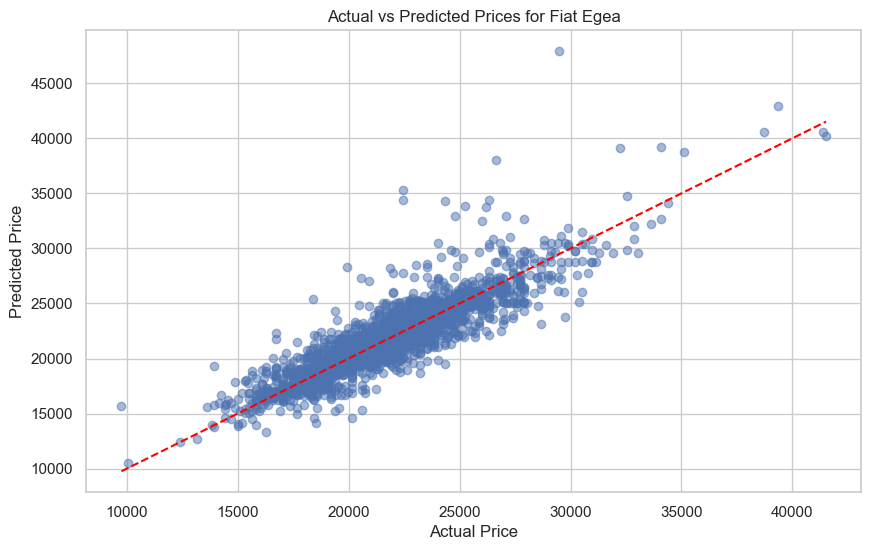

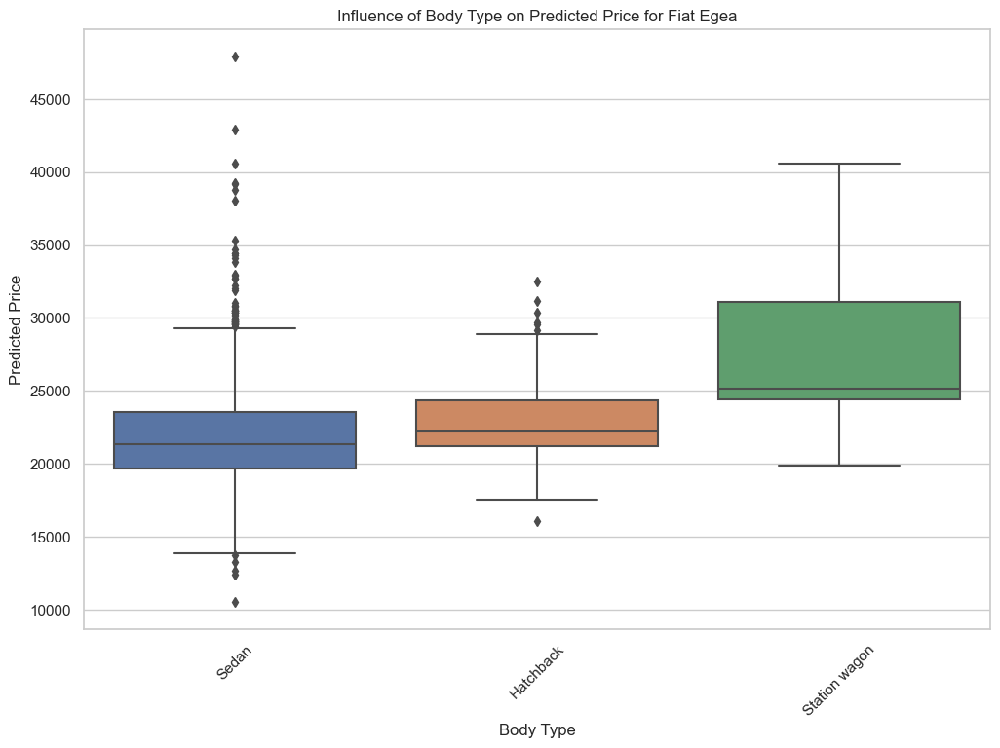

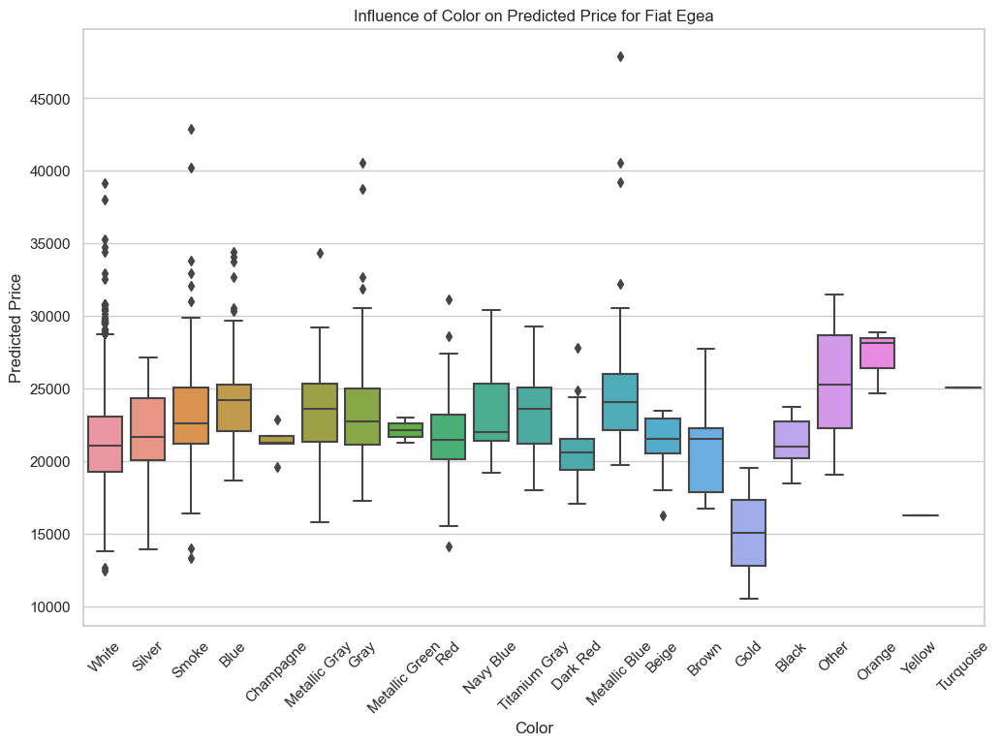

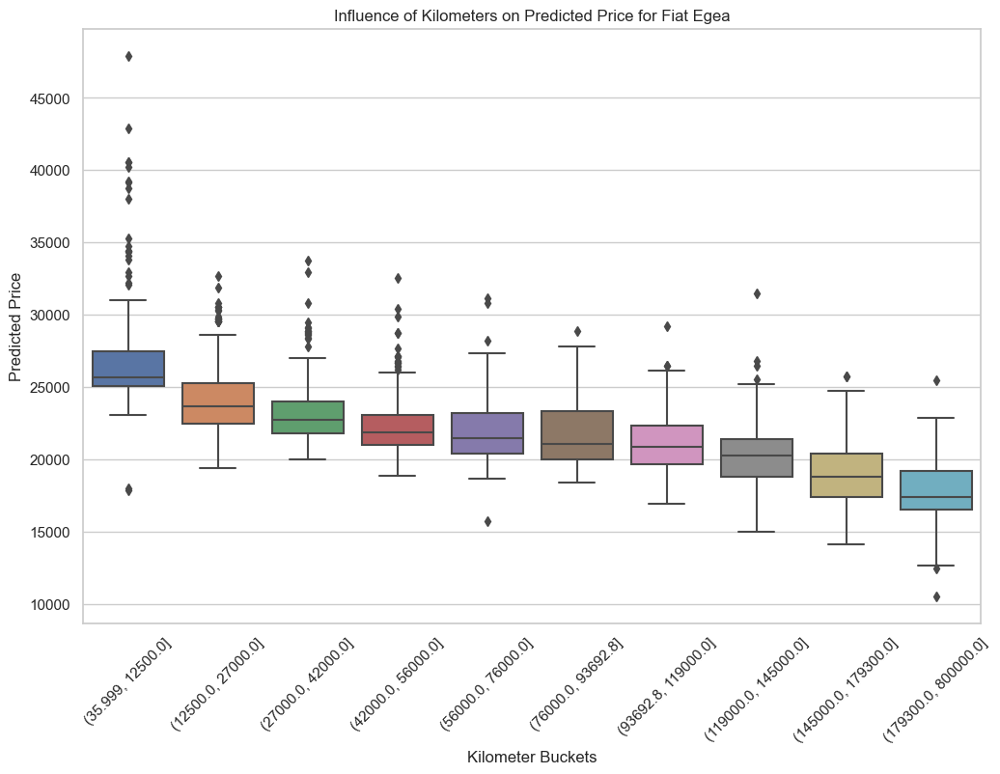

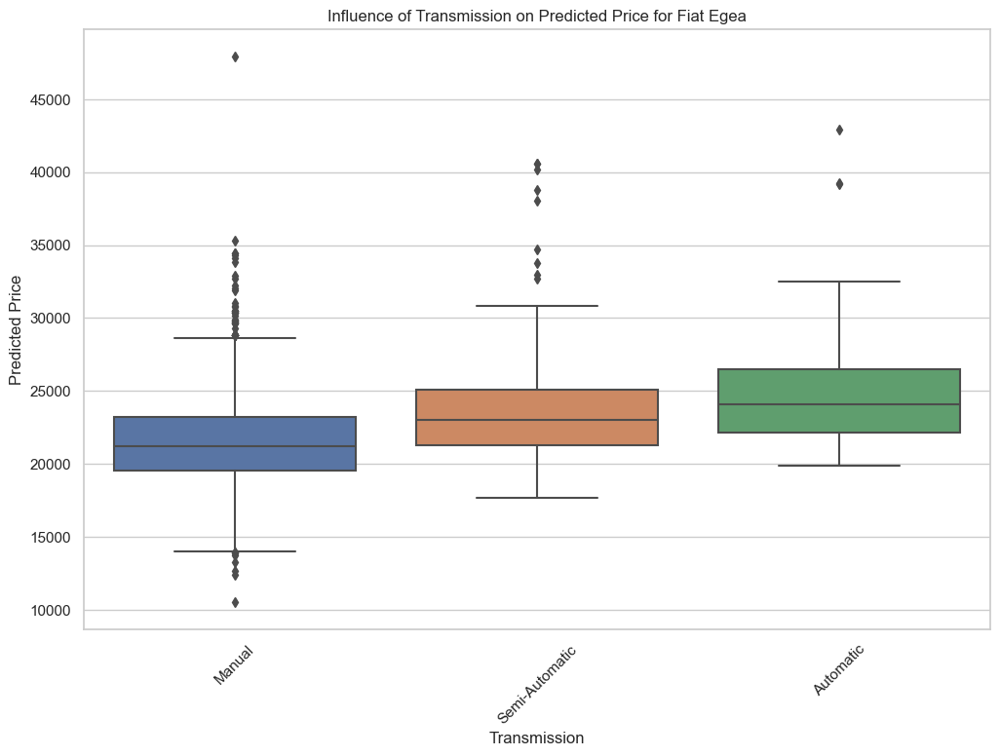

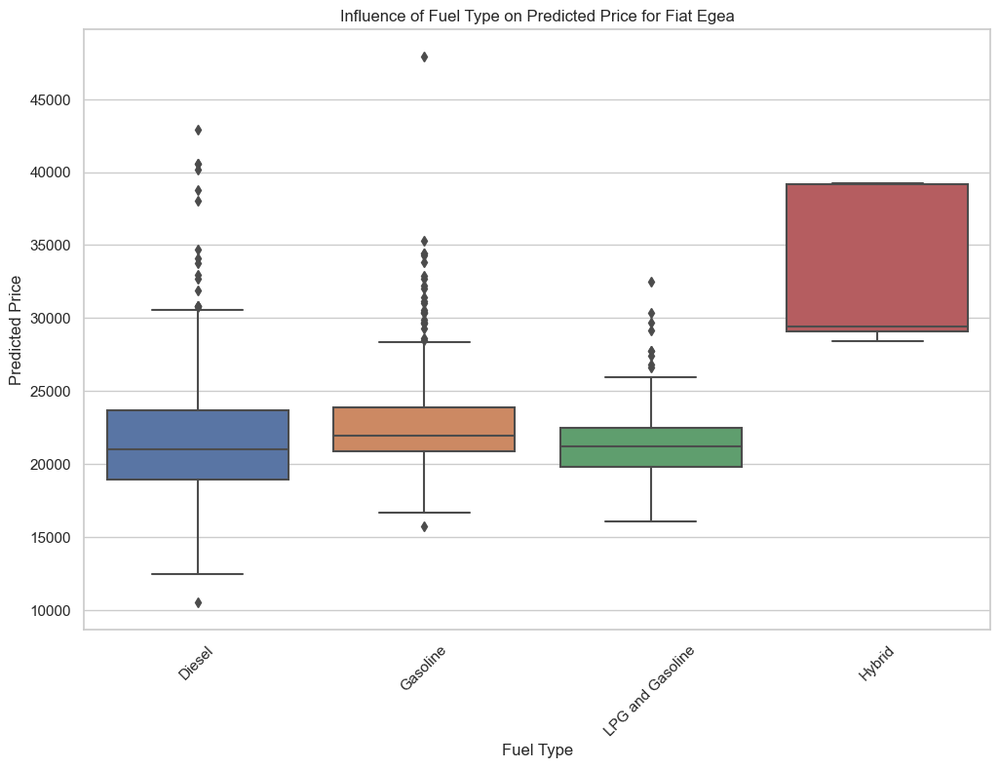

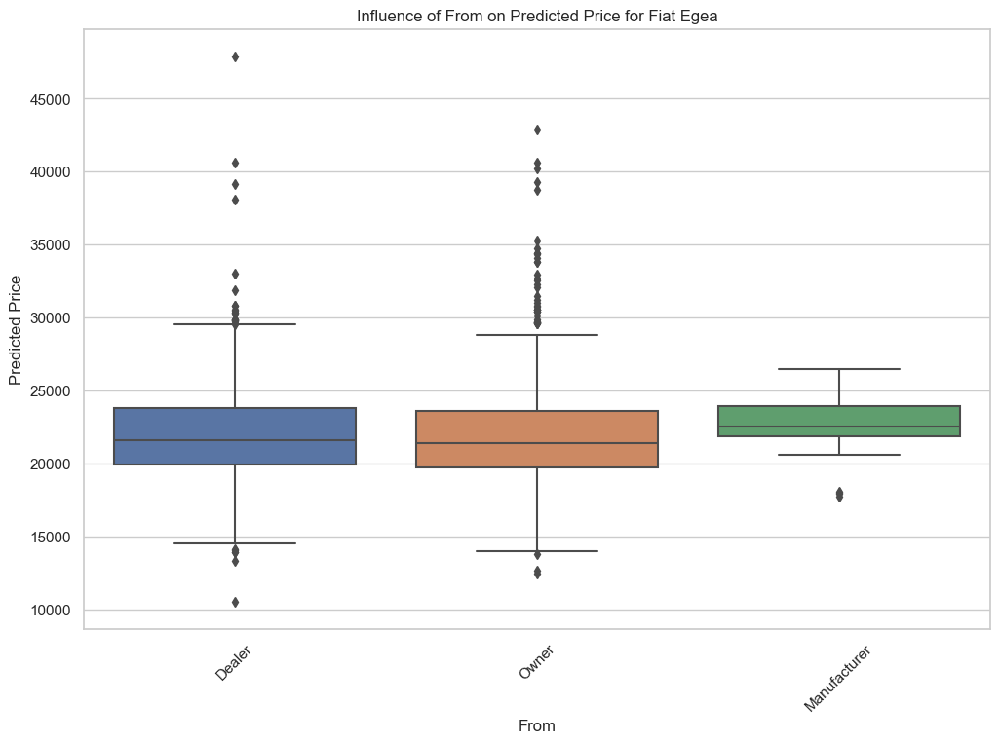


Processing Volkswagen Golf
NaN counts before imputing for Volkswagen Golf:
Year                                              0
Kilometers (km)                                   0
Engine Size (cc)                                 25
Engine Power (hp)                                39
Fuel Tank Size (L)                                0
Transmission_Manual                            2226
Transmission_Semi-Automatic                    2226
Fuel Type_Electric                             2226
Fuel Type_Gasoline                             2226
Fuel Type_Hybrid                               2226
Fuel Type_LPG and Gasoline                     2226
Body Type_Cabrio                               2226
Body Type_Coupe                                2226
Body Type_Crossover                            2226
Body Type_MPV                                  2226
Body Type_Other                                2226
Body Type_SUV                                  2226
Body Type_Station Wagon                 

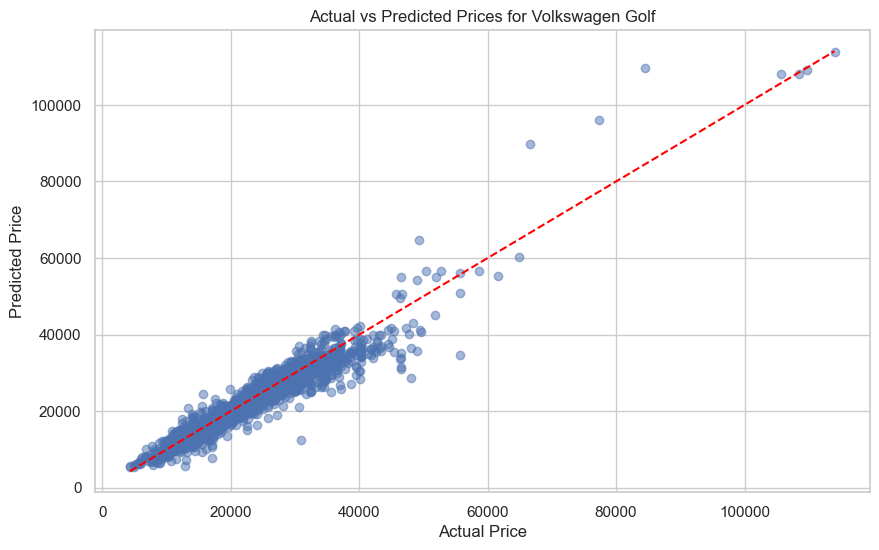

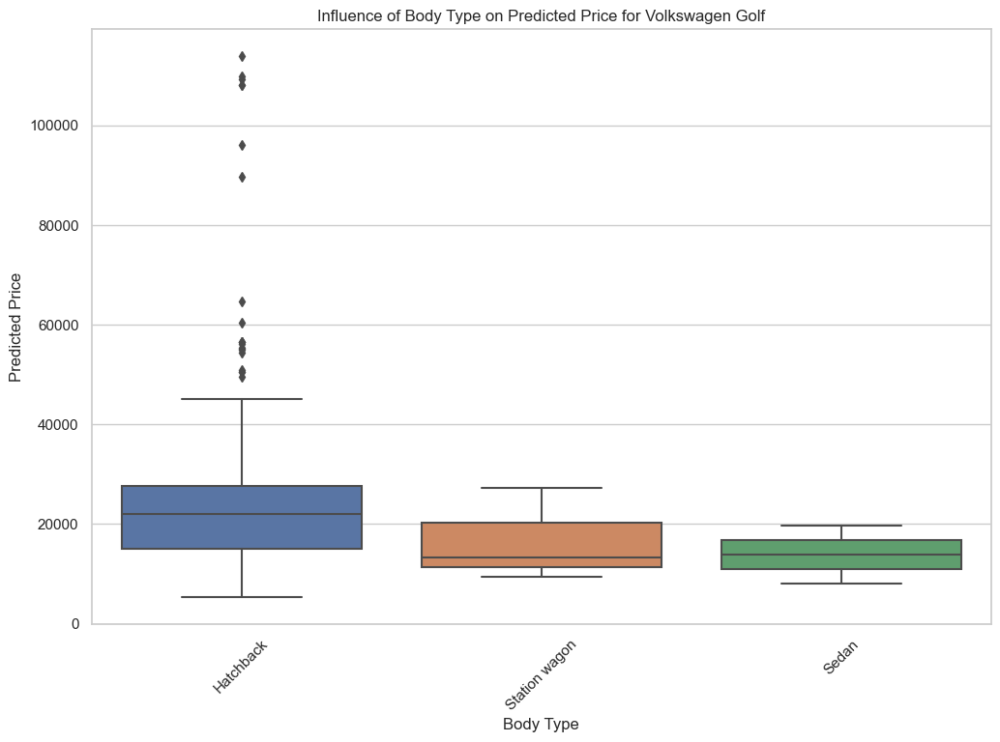

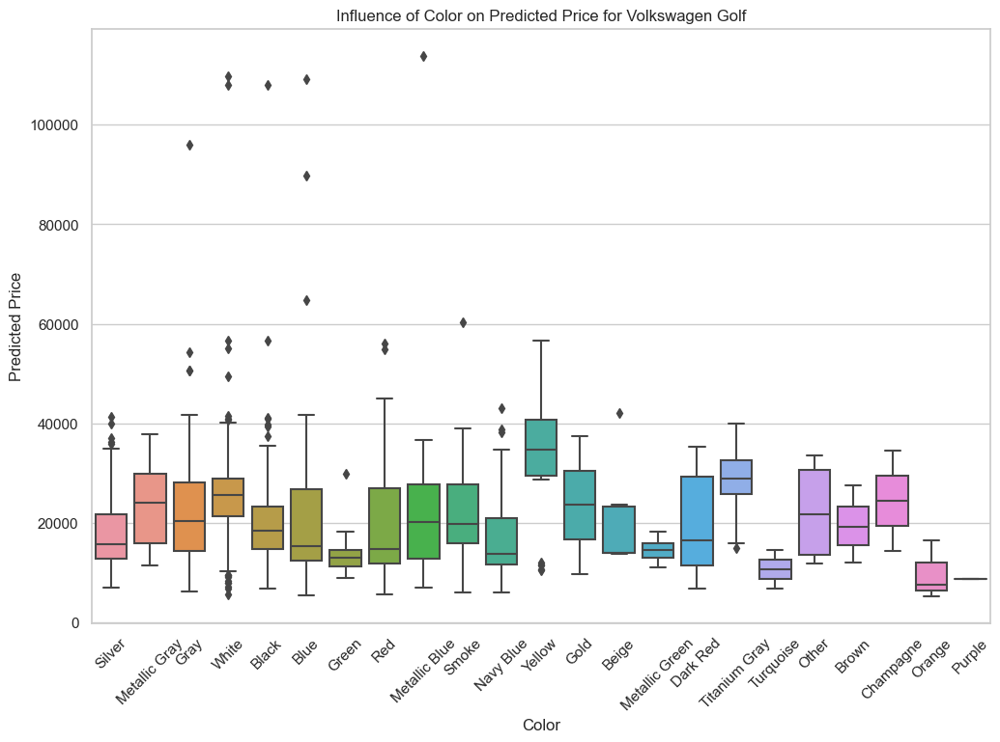

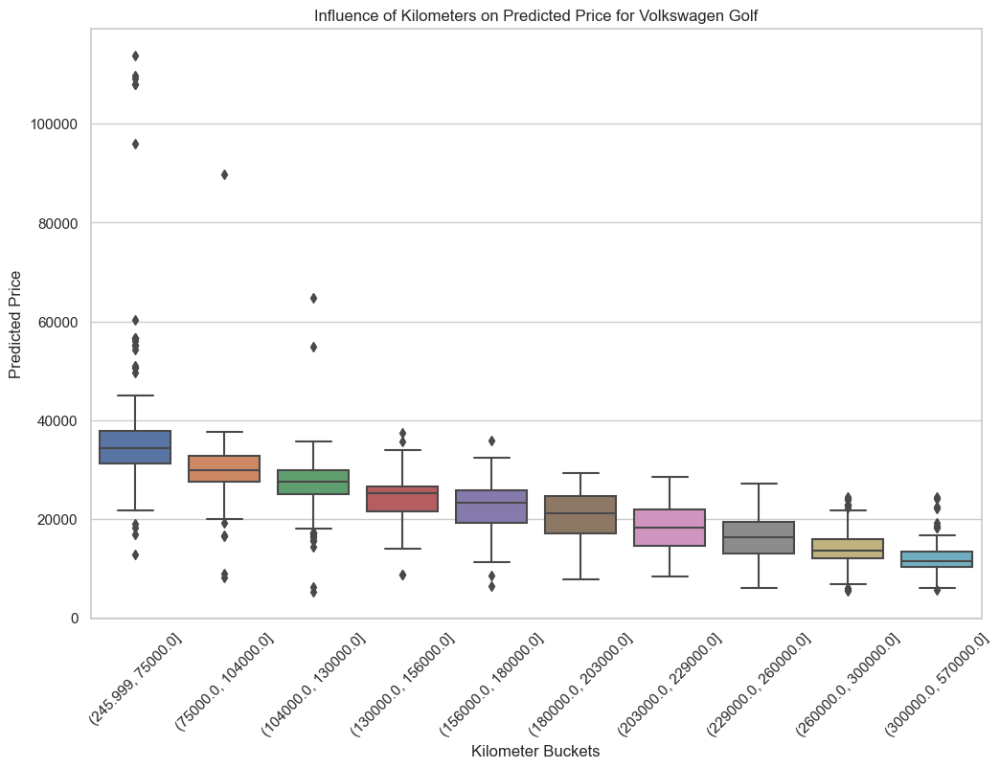

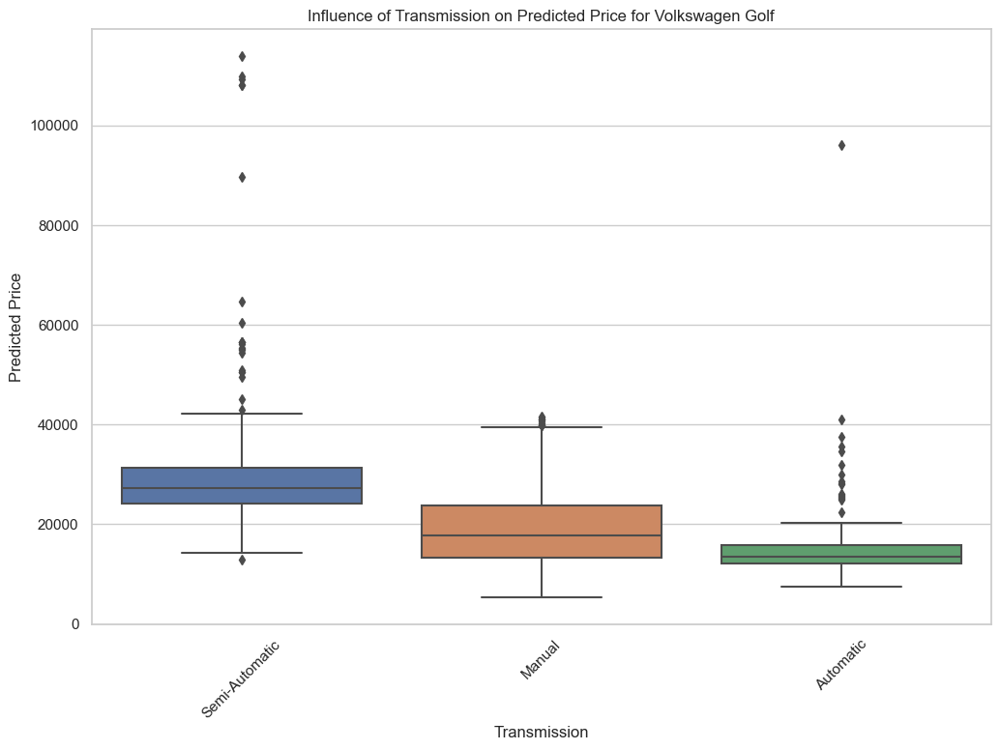

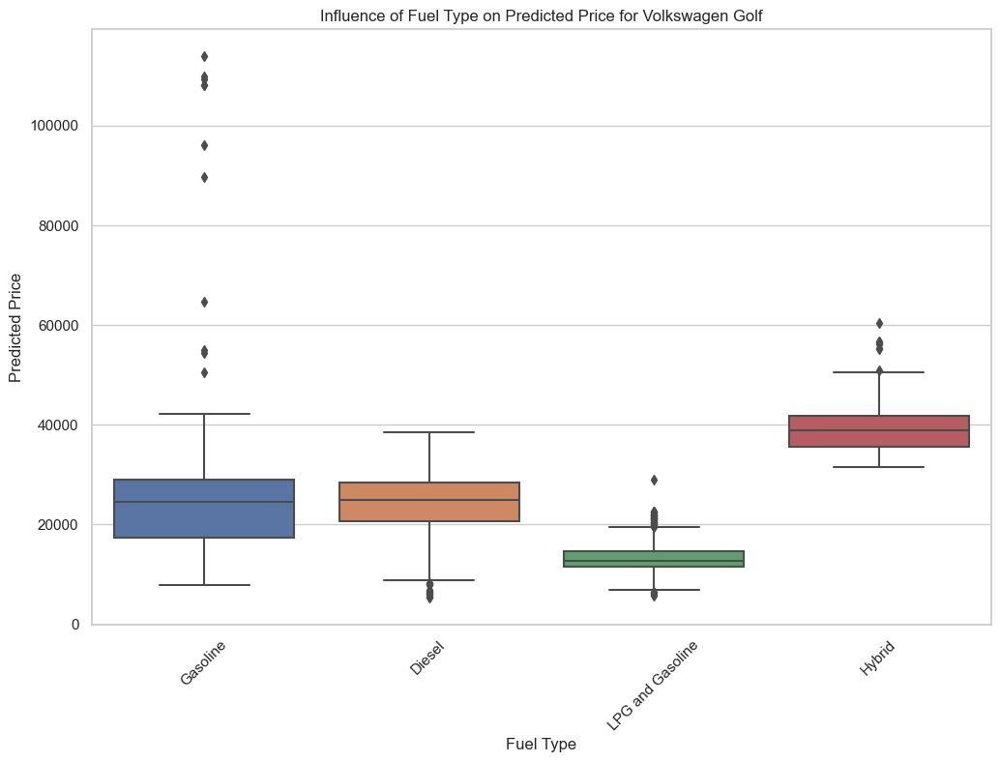

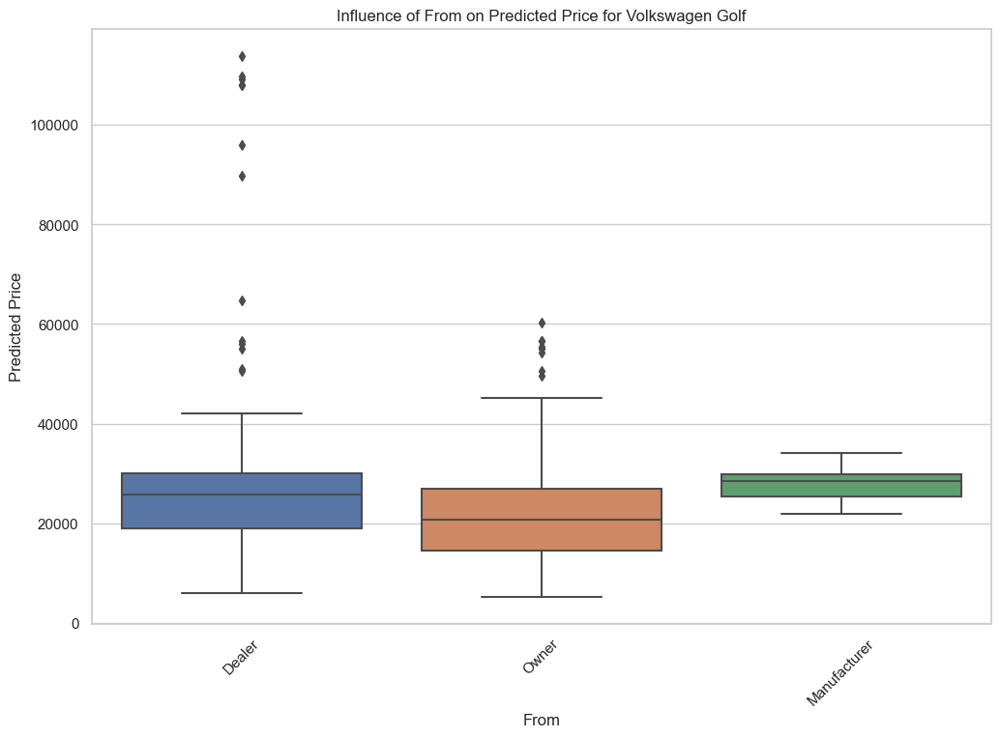


Processing Dacia Sandero
NaN counts before imputing for Dacia Sandero:
Year                                             0
Kilometers (km)                                  0
Engine Size (cc)                                13
Engine Power (hp)                               14
Fuel Tank Size (L)                               0
Transmission_Manual                            601
Transmission_Semi-Automatic                    601
Fuel Type_Electric                             601
Fuel Type_Gasoline                             601
Fuel Type_Hybrid                               601
Fuel Type_LPG and Gasoline                     601
Body Type_Cabrio                               601
Body Type_Coupe                                601
Body Type_Crossover                            601
Body Type_MPV                                  601
Body Type_Other                                601
Body Type_SUV                                  601
Body Type_Station Wagon                        601
Body Type_

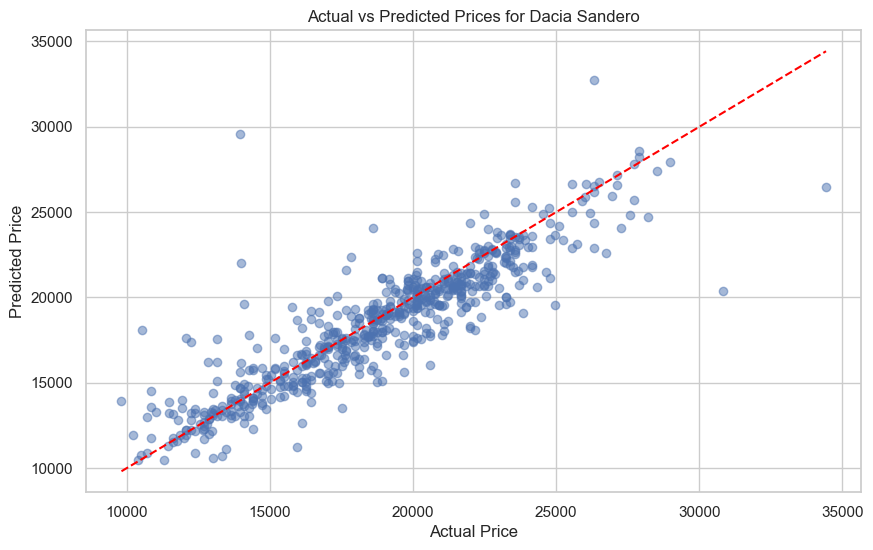

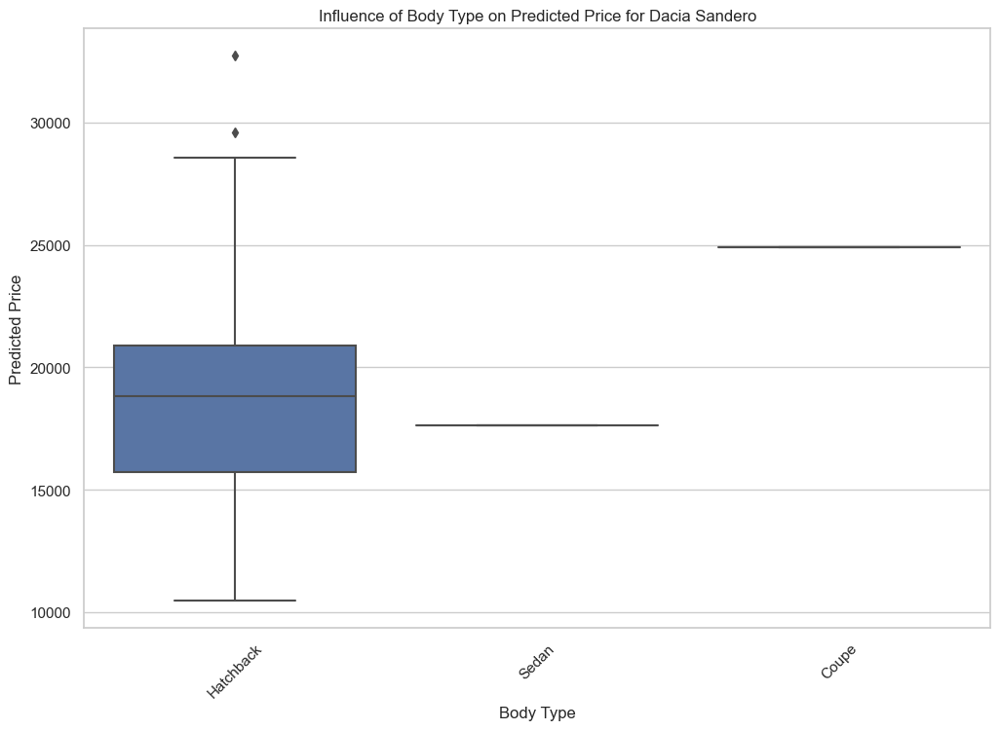

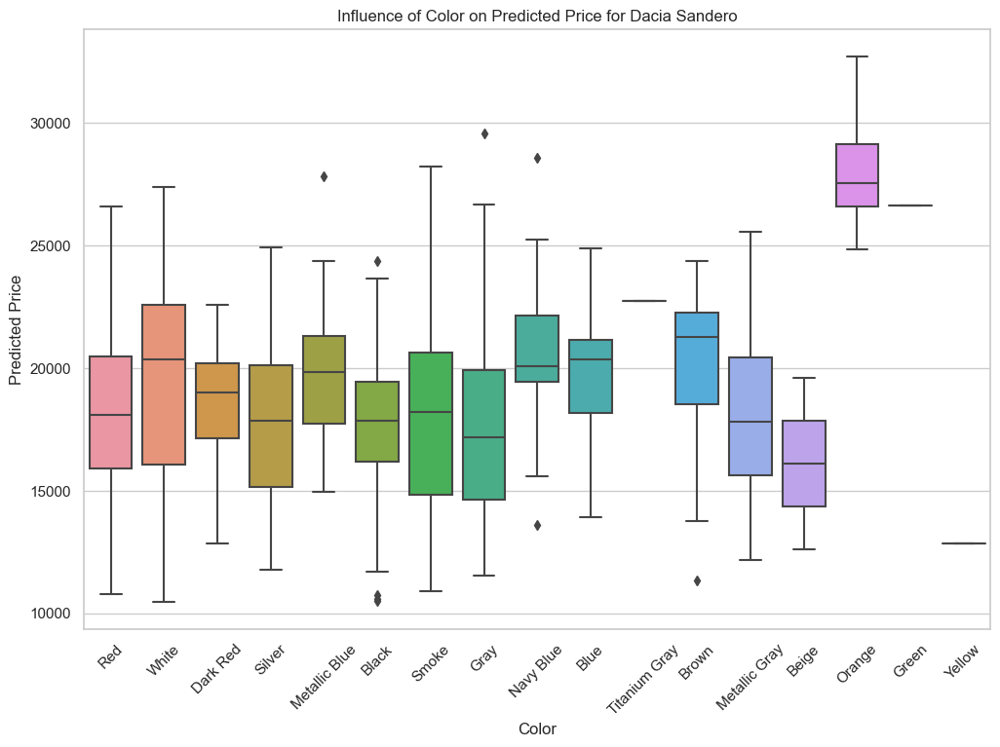

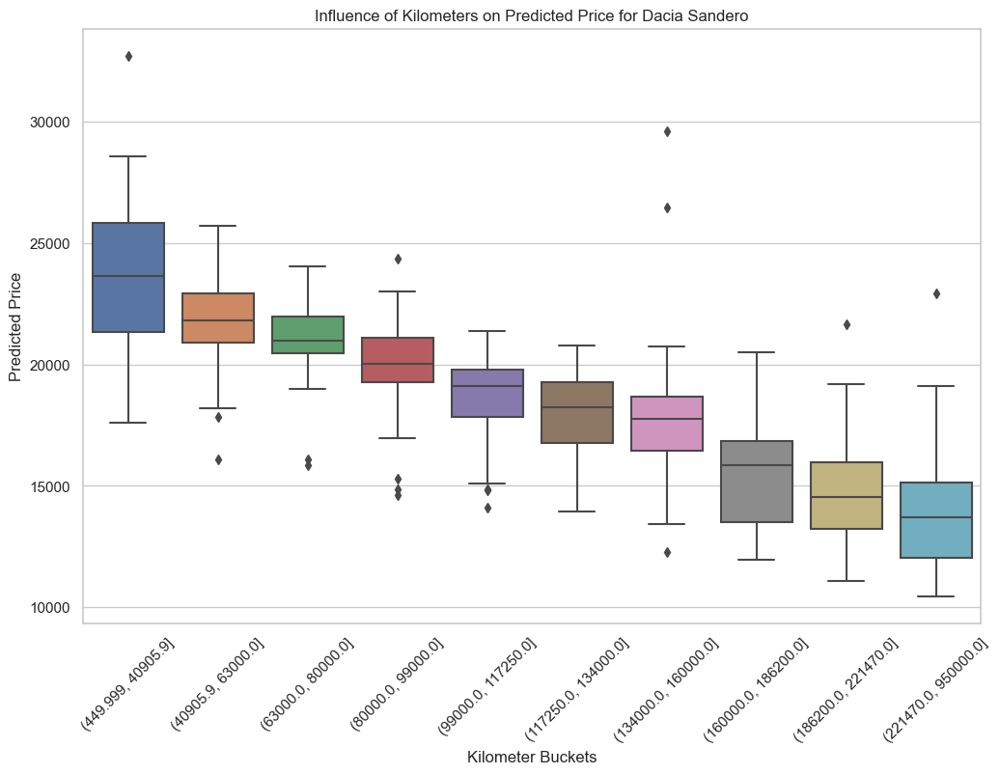

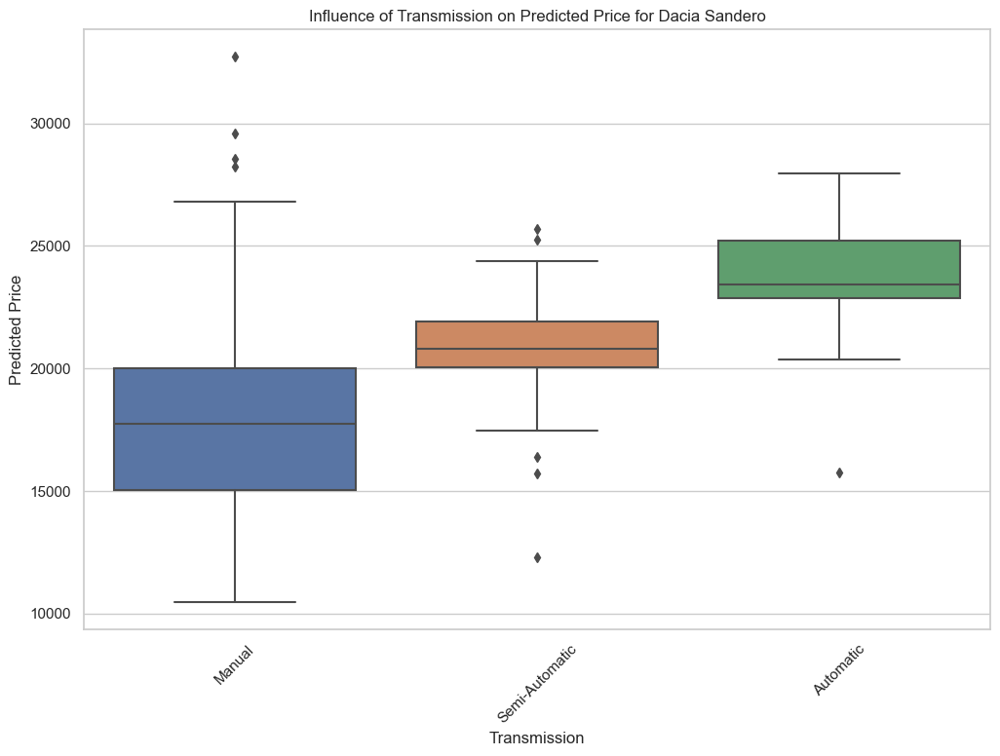

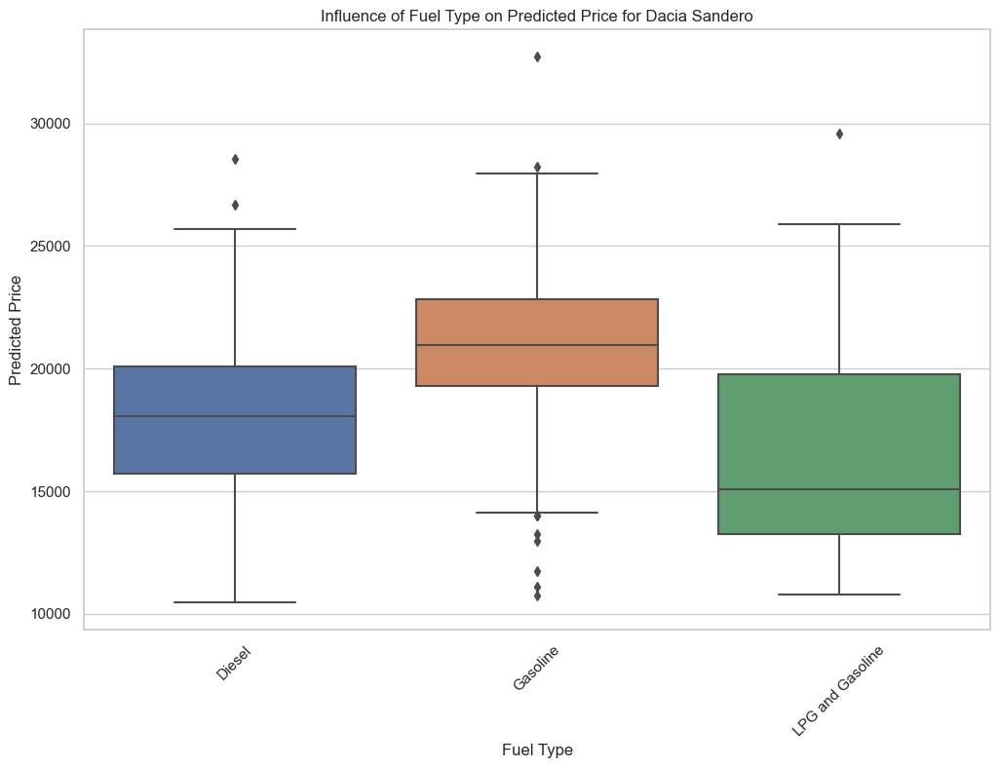

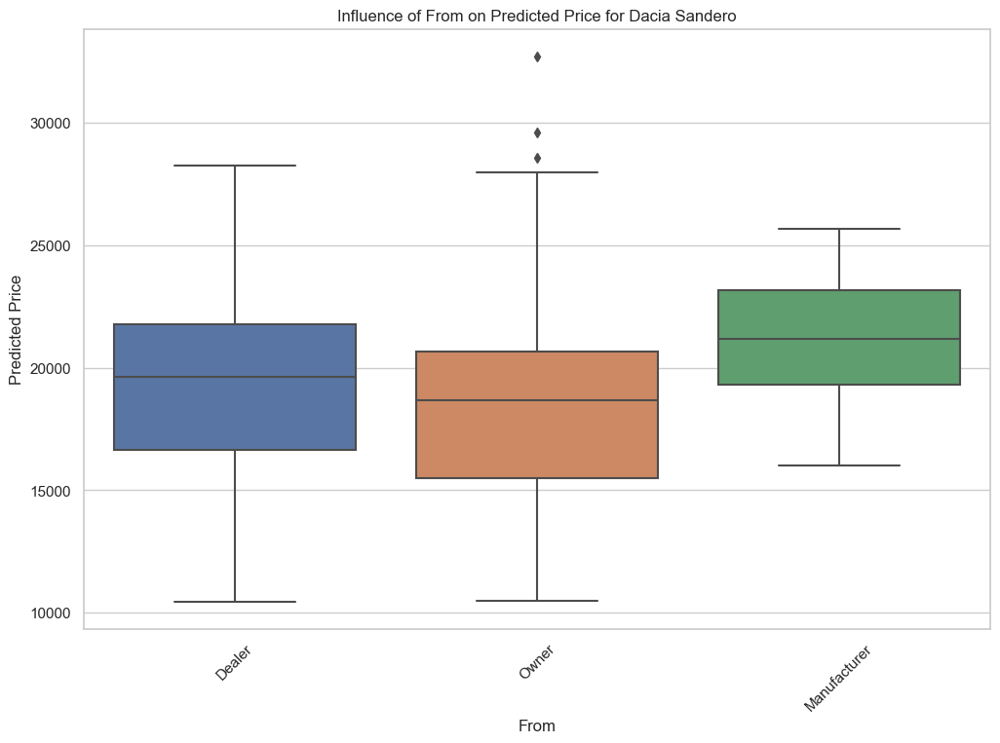


Processing Hyundai i20
NaN counts before imputing for Hyundai i20:
Year                                              0
Kilometers (km)                                   0
Engine Size (cc)                                 23
Engine Power (hp)                                23
Fuel Tank Size (L)                                0
Transmission_Manual                            1177
Transmission_Semi-Automatic                    1177
Fuel Type_Electric                             1177
Fuel Type_Gasoline                             1177
Fuel Type_Hybrid                               1177
Fuel Type_LPG and Gasoline                     1177
Body Type_Cabrio                               1177
Body Type_Coupe                                1177
Body Type_Crossover                            1177
Body Type_MPV                                  1177
Body Type_Other                                1177
Body Type_SUV                                  1177
Body Type_Station Wagon                        1

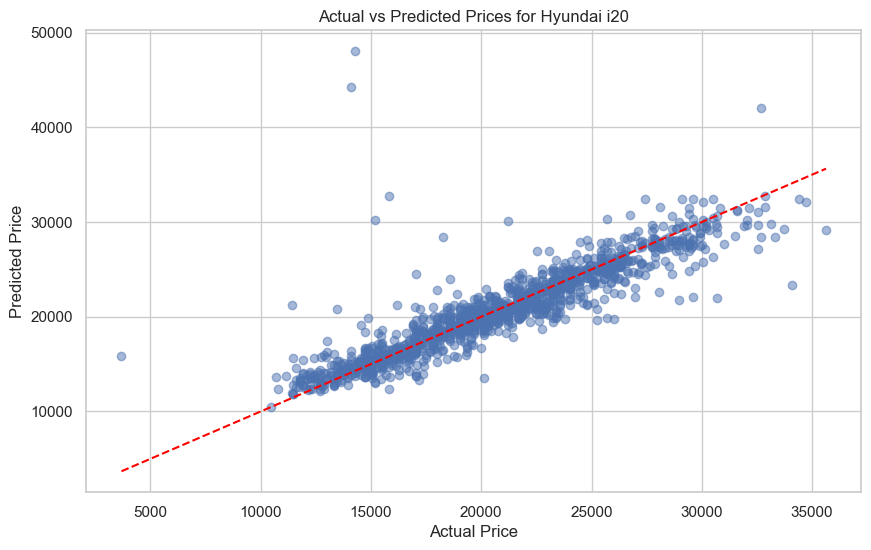

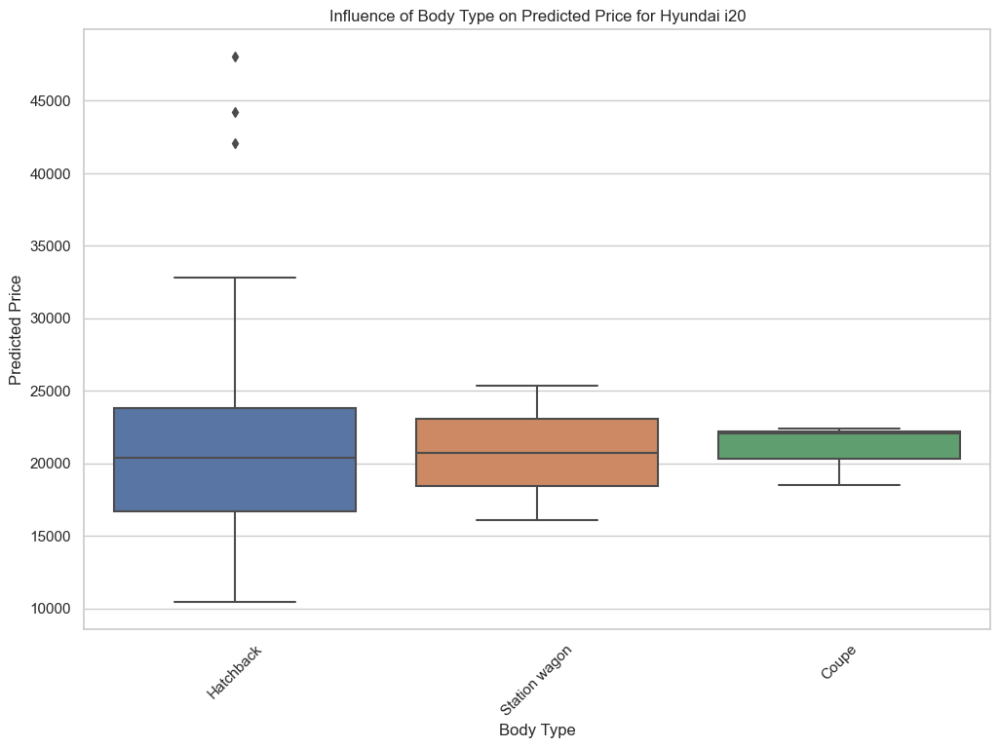

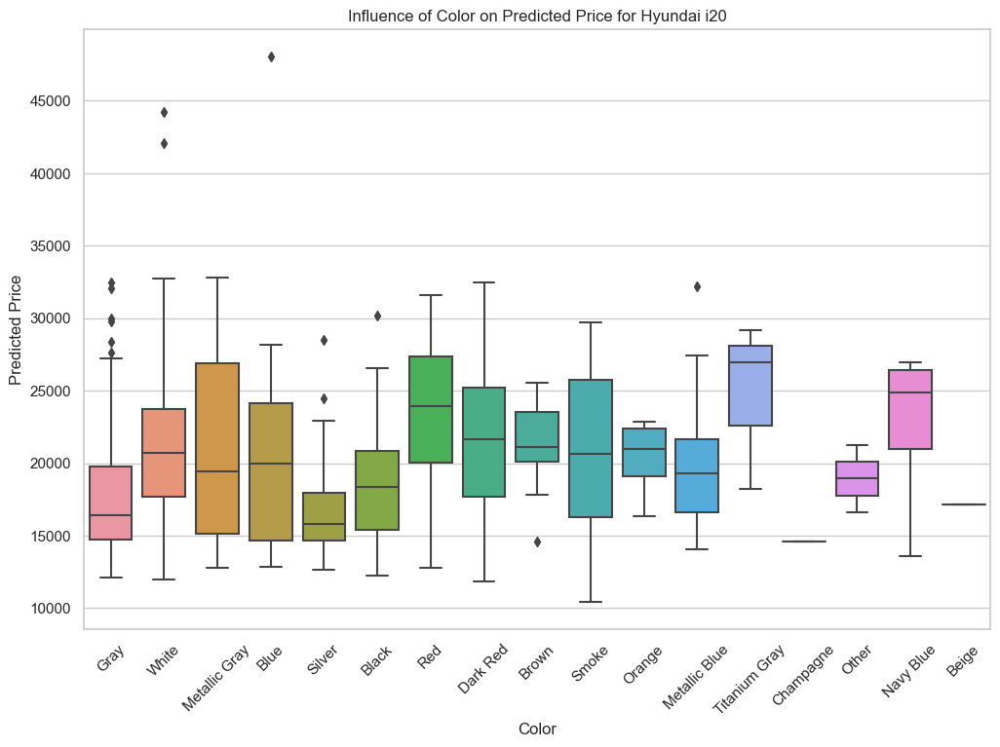

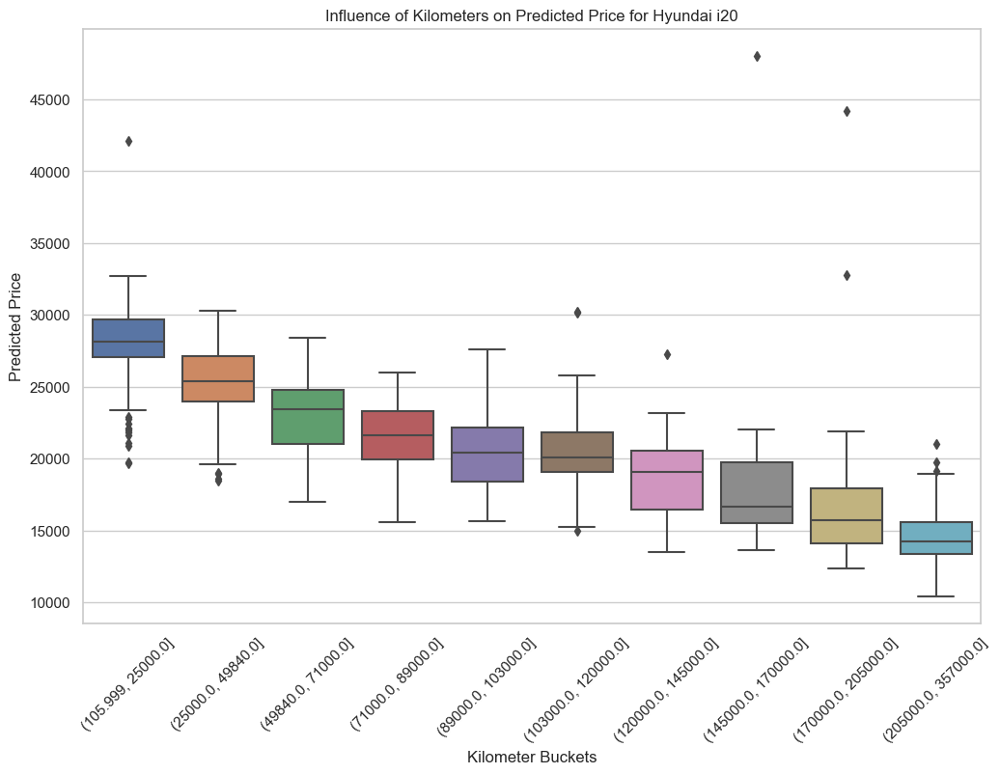

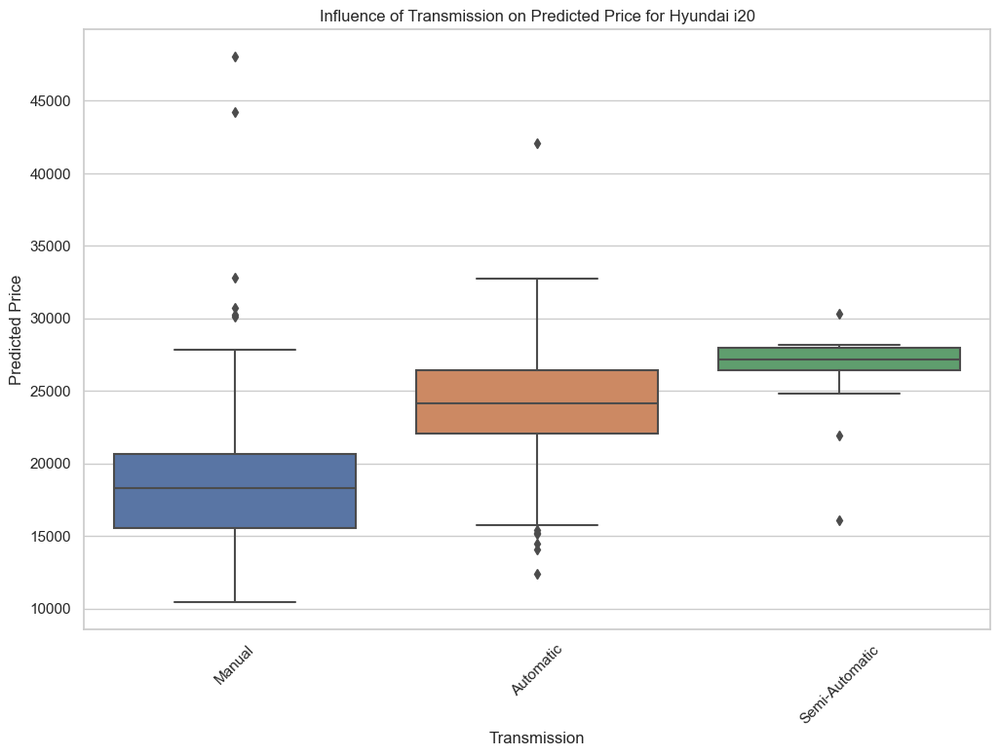

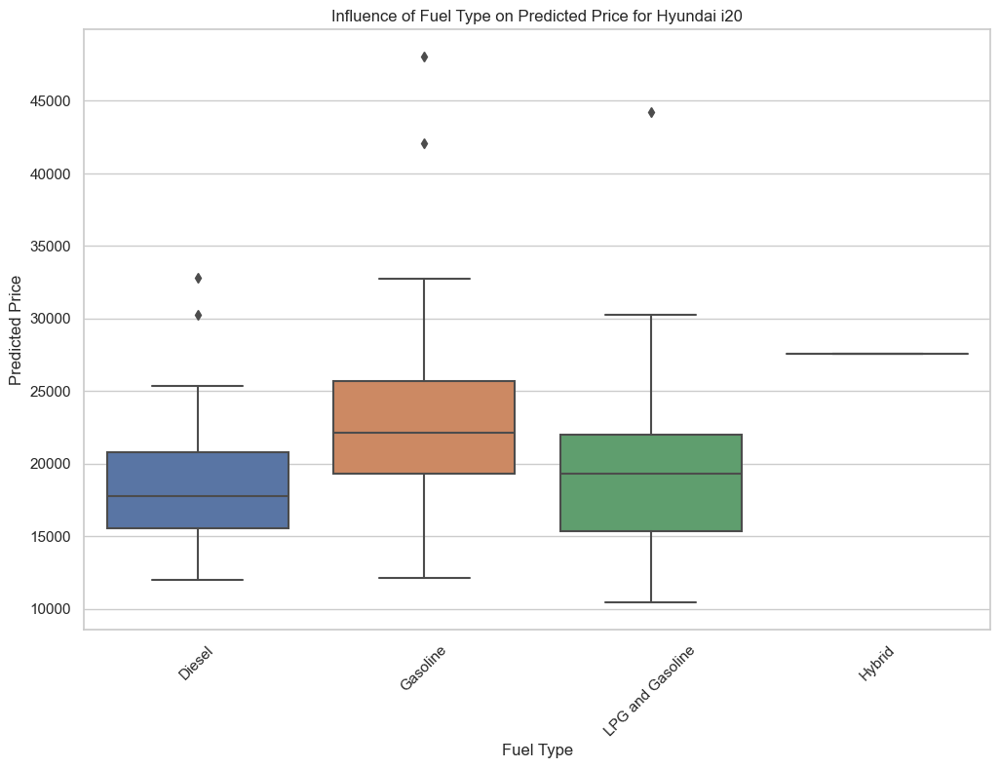

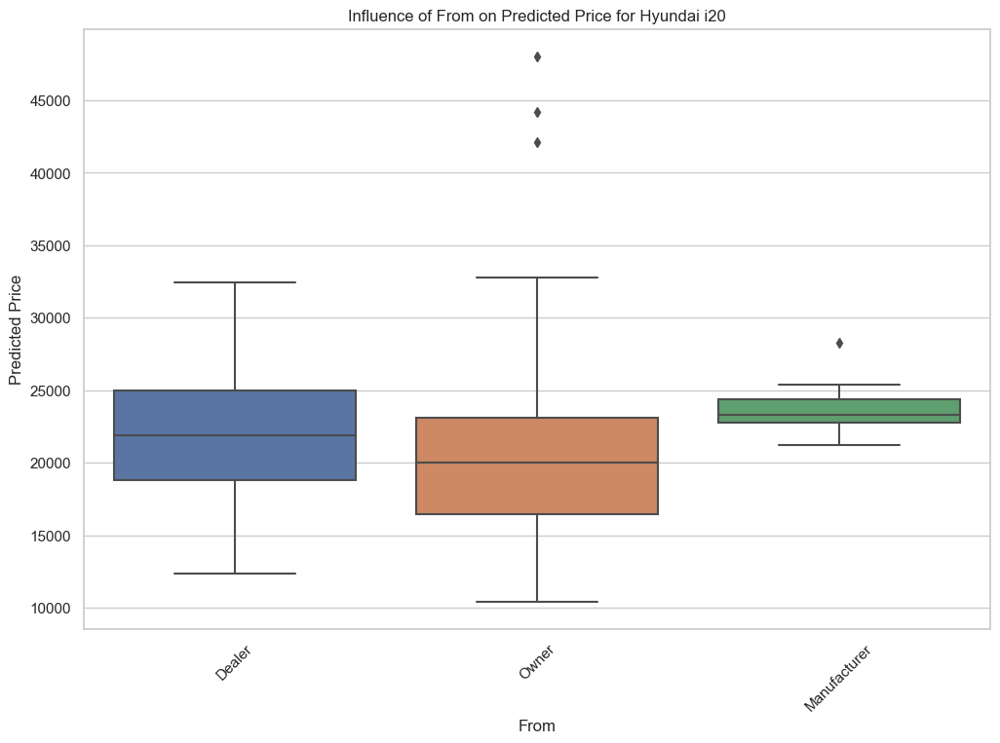

In [50]:
# Function to process and analyze a specific Make-Model combination
def analyze_make_model(make, model):
    print(f"\nProcessing {make} {model}")
    
    data = df_4yr[(df_4yr['Make'] == make) & (df_4yr['Model'] == model)].copy()
    
    if len(data) < 5:  # Skip make-model combinations with fewer than 5 entries
        print(f"Skipping {make} {model} due to insufficient data")
        return

    data['log_USD_Absolute'] = np.log(data['USD Absolute'])

    # Ensure the same columns as used during initial encoding
    categorical_cols_initial = ['Transmission', 'Fuel Type', 'Body Type', 'Vehicle Condition', 'From', 'Traction']
    categorical_cols = data.select_dtypes(include=['object']).columns.intersection(categorical_cols_initial)
    data_encoded = data.drop(columns=categorical_cols)

    # Encode the categorical columns
    encoded_cols = pd.DataFrame(encoder.transform(data[categorical_cols]), columns=encoder.get_feature_names_out(categorical_cols))
    data_encoded = data_encoded.join(encoded_cols)

    # Align the columns of the data with the original training columns (excluding 'log_USD_Absolute')
    columns_to_keep = X_train.columns.intersection(data_encoded.columns)
    X = data_encoded[columns_to_keep]
    y = data_encoded['log_USD_Absolute']

    # Ensure all necessary columns are present in X
    missing_columns = set(X_train.columns) - set(X.columns)
    for col in missing_columns:
        X[col] = 0  # Add the missing columns with zero values

    # Ensure the columns order matches the training set
    X = X[X_train.columns]

    # Drop columns with all missing values before imputing
    X = X.dropna(axis=1, how='all')

    # Summarize NaNs before imputing
    print(f"NaN counts before imputing for {make} {model}:")
    print(X.isna().sum())

    # Impute missing values
    imputer = SimpleImputer(strategy='mean')
    X = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)

    # Reset indices for both X and y
    X.reset_index(drop=True, inplace=True)
    y.reset_index(drop=True, inplace=True)

    # Summarize NaNs after imputing
    print(f"NaN counts after imputing for {make} {model}:")
    print(X.isna().sum())

    # Check shapes after imputing
    if X.shape[0] == 0:
        print(f"Skipping {make} {model} due to insufficient data after imputing")
        return

    print(f"Shape of X after imputing: {X.shape}")
    print(f"Shape of y after imputing: {y.shape}")

    # Fit a new scaler specifically for the data
    scaler = StandardScaler()
    scaler.fit(X_train)

    # Transform X including 'log_USD_Absolute'
    X_scaled = scaler.transform(X)

    print(f"Scaled X shape: {X_scaled.shape}")
    print(f"First few rows of scaled X: {X_scaled[:5]}")

    # Ensure the scaled X has the same number of features as expected by the model
    if X_scaled.shape[1] != X_train_scaled.shape[1]:
        raise ValueError(f"X_scaled has {X_scaled.shape[1]} features, but the model expects {X_train_scaled.shape[1]} features.")

    print(f"Final scaled X shape: {X_scaled.shape}")

    # Predict prices for the subset
    y_pred = random_forest.predict(X_scaled)

    # Create a DataFrame to compare actual and predicted prices
    results = pd.DataFrame({
        'Actual Price': np.exp(y),
        'Predicted Price': np.exp(y_pred)
    })

    # Calculate the difference between actual and predicted prices
    results['Difference'] = results['Actual Price'] - results['Predicted Price']

    # Display a sample of the results
    print(results.head(10))

    # Visualize the results
    plt.figure(figsize=(10, 6))
    plt.scatter(results['Actual Price'], results['Predicted Price'], alpha=0.5)
    plt.plot([results['Actual Price'].min(), results['Actual Price'].max()], 
             [results['Actual Price'].min(), results['Actual Price'].max()], 
             color='red', linestyle='--')
    plt.xlabel('Actual Price')
    plt.ylabel('Predicted Price')
    plt.title(f'Actual vs Predicted Prices for {make} {model}')
    plt.show()

    # Ensure the predicted values and the corresponding DataFrame rows align
    data_filtered = data.iloc[X.index].copy()
    data_filtered['Predicted Price'] = np.exp(y_pred)

    # Plotting function with data check
    def plot_boxplot(data, x_col, y_col, title):
        if data[x_col].nunique() > 1:  # Ensure there's more than one unique value for plotting
            plt.figure(figsize=(12, 8))
            sns.boxplot(x=x_col, y=y_col, data=data)
            plt.title(title)
            plt.xticks(rotation=45)
            plt.show()
        else:
            print(f"Skipping plot for {title} due to insufficient data")

    # Create box plots to see the influence of various features on Predicted Price
    plot_boxplot(data_filtered, 'Body Type', 'Predicted Price', f'Influence of Body Type on Predicted Price for {make} {model}')
    plot_boxplot(data_filtered, 'Color', 'Predicted Price', f'Influence of Color on Predicted Price for {make} {model}')
    
    data_filtered['Kilometer Buckets'] = pd.qcut(data_filtered['Kilometers (km)'], 10, duplicates='drop')
    plot_boxplot(data_filtered, 'Kilometer Buckets', 'Predicted Price', f'Influence of Kilometers on Predicted Price for {make} {model}')
    plot_boxplot(data_filtered, 'Transmission', 'Predicted Price', f'Influence of Transmission on Predicted Price for {make} {model}')
    plot_boxplot(data_filtered, 'Fuel Type', 'Predicted Price', f'Influence of Fuel Type on Predicted Price for {make} {model}')
    plot_boxplot(data_filtered, 'From', 'Predicted Price', f'Influence of From on Predicted Price for {make} {model}')

# Analyze the specified make-model combinations
analyze_make_model('Fiat', 'Egea')
analyze_make_model('Volkswagen', 'Golf')
analyze_make_model('Dacia', 'Sandero')
analyze_make_model('Hyundai', 'i20')

# List the 3 best deals from the 4 x chosen Make / Model / Year, with links to the actual cars

In [51]:
# Function to find and print the best 3 deals for a specified car make, model, and age
def find_best_deals(make, model, year):
    filtered_data = df_4yr[(df_4yr['Make'] == make) & 
                           (df_4yr['Model'] == model) & 
                           (df_4yr['Year'] == year)]

    # Check if filtered data is empty
    if filtered_data.empty:
        print(f"No {year}-year-old {make} {model} found.")
    else:
        # Step 2: Preprocess the filtered data
        X_filtered = filtered_data.drop(columns=['USD Absolute', 'Link'])  # Drop columns that are not features
        y_filtered = filtered_data['USD Absolute']

        # Separate numeric and categorical columns
        numeric_cols = X_filtered.select_dtypes(include=['number']).columns
        categorical_cols = X_filtered.select_dtypes(exclude=['number']).columns

        # Impute missing values for numeric data
        imputer_numeric = SimpleImputer(strategy='mean')
        X_filtered[numeric_cols] = imputer_numeric.fit_transform(X_filtered[numeric_cols])

        # Impute missing values for categorical data
        imputer_categorical = SimpleImputer(strategy='most_frequent')
        X_filtered[categorical_cols] = imputer_categorical.fit_transform(X_filtered[categorical_cols])

        # Encode categorical variables
        X_filtered = pd.get_dummies(X_filtered)

        # Ensure that the feature set of the filtered data matches the training data
        missing_cols = set(X.columns) - set(X_filtered.columns)
        for c in missing_cols:
            X_filtered[c] = 0
        X_filtered = X_filtered[X.columns]

        # Scale the independent variables
        X_filtered_scaled = scaler.transform(X_filtered)

        # Step 3: Predict prices
        y_pred_filtered = random_forest.predict(X_filtered_scaled)

        # Calculate the difference between actual prices and predicted prices
        filtered_data = filtered_data.copy()  # Create a copy to avoid SettingWithCopyWarning
        filtered_data.loc[:, 'Predicted Price'] = np.exp(y_pred_filtered)  # Inverse of log transformation
        filtered_data.loc[:, 'Difference'] = filtered_data['USD Absolute'] - filtered_data['Predicted Price']

        # Find the best 3 deals (minimum difference)
        best_deals = filtered_data.nsmallest(3, 'Difference')

        # Set pandas option to display full string
        pd.set_option('display.max_colwidth', None)

        # Print the best 3 deals
        print(f"Best deals for {year}-year-old {make} {model}:")
        print(best_deals[['Link', 'USD Absolute', 'Predicted Price', 'Difference']])
        print("\n")

# Assuming df_4yr is your DataFrame and the model has been trained

# Run the function for each specified car
find_best_deals('Fiat', 'Egea', 2018)
find_best_deals('Volkswagen', 'Golf', 2020)
find_best_deals('Dacia', 'Sandero', 2020)
find_best_deals('Hyundai', 'i20', 2022)

Best deals for 2018-year-old Fiat Egea:
                                                                                                                                                      Link  \
57284                                              https://www.arabam.com/ilan/sahibinden-satilik-fiat-egea-1-6-e-torq-easy-plus/sahibinden-temiz/25351132   
70348  https://www.arabam.com/ilan/sahibinden-satilik-fiat-egea-1-6-multijet-lounge-plus/sahibinden-fiat-egea-1-6-multijet-lounge-plus-2018-model/25241339   
71999                https://www.arabam.com/ilan/sahibinden-satilik-fiat-egea-1-6-e-torq-mirror/sahibinden-fiat-egea-1-6-e-torq-mirror-2018-model/25220385   

       USD Absolute  Predicted Price  Difference  
57284      22462.75         36570.45   -14107.70  
70348      26180.72         36414.36   -10233.64  
71999      26320.14         36098.42    -9778.28  


Best deals for 2020-year-old Volkswagen Golf:
                                                                           